In [2]:
import sys
sys.path.append('/mnt/shared/users/wessim.omezzine/ClimaX/src/climax')
sys.path.append('/mnt/shared/users/wessim.omezzine/ClimaX/src/')
sys.path.append('/mnt/shared/users/wessim.omezzine/ClimaX/')
sys.path.append('/s3/scratch/wessim.omezzine/ClimaX/src')
sys.path.append('/s3/scratch/wessim.omezzine/ClimaX/')


import torch 
import os
import random
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
from datetime import datetime
from torchvision.transforms import transforms
import torch.nn.functional as F
from prettytable import PrettyTable
from scipy import stats
from skimage.metrics import structural_similarity as ssim


from src.climax.climate_downscaling.module import ClimateDownscalingModule
from src.climax.climate_downscaling.datamodule import ClimateDownscalingDataModule
from pytorch_lightning.cli import LightningCLI
from pytorch_lightning import Trainer
from src.climax.arch import ClimaX
from climax.utils.downscaling_methods import (climax_downscale,
                                              bilinear_interpolate,
                                             Downscale_Weight,
                                             mean_bias,
                                             lat_weighted_mse_val,
                                             lat_weighted_rmse,
                                             pearson, spearman)

/envs/user/fix_hdc/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
def compare_results(gt, forecast, pred, bilinear_interp, weighted_mask, lat,t,member,denormalize_out):
    
    # Check if GPU is available
    if torch.cuda.is_available():
        device = torch.device('cuda:0')
    else:
        device = torch.device('cpu')

    print("Selected device:", device)
    
    # Create a table with three columns
    table = PrettyTable(["","Coarse", "ClimaX", "Bilinear Interpolation", "Weighted Mask"])
    
    transform = denormalize_out
    
    
    for method in [lat_weighted_mse_val, lat_weighted_rmse, spearman,mean_bias, pearson]:
        
        coarse = method(torch.tensor(forecast.isel(time=t, ensemble=member).values),torch.tensor(gt.isel(time=t, ensemble=member).values), transform, lat).item()
        climax = method(torch.tensor(pred.isel(time=t, ensemble=member).values),torch.tensor(gt.isel(time=t, ensemble=member).values), transform, lat).item()
        bilinear = method(torch.tensor(bilinear_interp.isel(time=t, ensemble=member).values),torch.tensor(gt.isel(time=t, ensemble=member).values), transform, lat).item()
        mask= method(torch.tensor(weighted_mask.isel(time=t, ensemble=member).values),torch.tensor(gt.isel(time=t, ensemble=member).values), transform, lat).item()
        
      
        table.add_row([method.__name__,coarse, climax, bilinear, mask])
        


    # Set the style of the table (optional)
    table.border = True  # Add a border around the table
    table.align = "l"    # Align columns to the left

    # Print the table
    print(table)

def plot_compare(gt,coarse, pred, bilinear_inter, weighted_mask,t,member,denormalize_out ):
    print("time", t)
    fig, axes = plt.subplots(2, 5, figsize=(12, 6))

    
    
    # Plot the first figure on the left subplot
    im1 = axes[0,0].imshow(coarse.isel(time=t, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,0].set_title('Forecast')
    
    im2 = axes[0,1].imshow(pred.isel(time=t, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,1].set_title('ClimaX')

    # Plot the second figure on the right subplot
    im3 = axes[0,2].imshow(bilinear_inter.isel(time=t, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,2].set_title('Bilinear Interpolation')
    
    im4 = axes[0,3].imshow(weighted_mask.isel(time=t, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,3].set_title('Weighted Mask')
    
    im5 = axes[0,4].imshow(gt.isel(time=t, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,4].set_title('Original')
    
    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)
    fig.colorbar(im5)
    
    axes[1,0].hist((forecast.isel(time=t, ensemble=member) - gt.isel(time=t, ensemble=member)).values.ravel(), bins=50, color='b', alpha=0.7) # You can change the colormap as needed
    axes[1,0].set_title('Coarse')

    # Plot the second figure on the right subplot
    axes[1,1].hist((pred.isel(time=t, ensemble=member) - gt.isel(time=t, ensemble=member)).values.ravel(), bins=50, color='g', alpha=0.7)
    axes[1,1].set_title('ClimaX')
    
    axes[1,2].hist((bilinear_inter.isel(time=t, ensemble=member) - gt.isel(time=t, ensemble=member)).values.ravel(), bins=50, color='r', alpha=0.7)
    axes[1,2].set_title('Bilinear Interpolation')
    
    
    axes[1,3].hist((weighted_mask.isel(time=t, ensemble=member) - gt.isel(time=t, ensemble=member)).values.ravel(), bins=50, color='r', alpha=0.7)
    axes[1,3].set_title('Weighted mask')
    

    
   

    # Adjust spacing between subplots
    plt.tight_layout()

    # Show the plot
    plt.show()

   
    

In [4]:
def visualize_climax(forecast, lta, gt, prediction, bilinear_inter,weighted_mask,time_index,member):

    fig = plt.figure(figsize=(15, 10))
    gs = fig.add_gridspec(3, 3)

    # Extract the numpy arrays from the xarray DataArrays for plotting
    forecast_np = forecast.isel(time=time_index, ensemble=member).values
    lta_np = lta.isel(time=time_index, ensemble=member).values
    gt_np = gt.isel(time=time_index, ensemble=member).values
    prediction_np = prediction.isel(time=time_index, ensemble=member).values
    bilinear_inter_np = bilinear_inter.isel(time=time_index, ensemble=member).values
    weighted_mask_np = weighted_mask.isel(time=time_index, ensemble=member).values

    # Determine global min and max for consistent color scale across plots
    global_min = min(np.min(forecast_np), np.min(prediction_np))
    global_max = max(np.max(forecast_np), np.max(prediction_np))

#     ax1 = fig.add_subplot(gs[0, 0])
#     im1 = ax1.imshow(forecast_np, cmap=plt.cm.RdBu)
#     ax1.set_title("Forecast")
#     fig.colorbar(im1, ax=ax1)

#     ax2 = fig.add_subplot(gs[0, 2])
#     im2 = ax2.imshow(lta_np, cmap=plt.cm.RdBu)
#     ax2.set_title("LTA")
#     fig.colorbar(im2, ax=ax2)
    
    ax1 = fig.add_subplot(gs[0, 0])
    forecast.isel(time=time_index,ensemble=member).plot.imshow(ax=ax1, cmap=plt.cm.RdBu)
    ax1.set_title(f"{ ax1.get_title()} - Forecast")
    
    ax2 = fig.add_subplot(gs[0, 2])
    lta.isel(time=time_index,ensemble=member).plot.imshow(ax=ax2, cmap=plt.cm.RdBu)
    ax2.set_title(f"{ ax2.get_title()} - LTA")

    
    ax3 = fig.add_subplot(gs[1, 0])
    im3 = ax3.imshow(gt_np, cmap=plt.cm.RdBu)
    ax3.set_title("Ground Truth")
    fig.colorbar(im3, ax=ax3)

    ax4 = fig.add_subplot(gs[1, 1])
    im4 = ax4.imshow(prediction_np, vmin=global_min, vmax=global_max, cmap=plt.cm.RdBu)
    ax4.set_title("ClimaX Prediction")
    fig.colorbar(im4, ax=ax4)

    ax5 = fig.add_subplot(gs[1, 2])
    bias_np = gt_np - prediction_np
    im5 = ax5.imshow(bias_np, cmap=plt.cm.RdBu)
    ax5.set_title("Prediction Bias")
    fig.colorbar(im5, ax=ax5)


    plt.tight_layout()
    plt.show()

    
    fig, axes = plt.subplots(2, 5, figsize=(12, 6))

    
    
    # Plot the first figure on the left subplot
    im1 = axes[0,0].imshow(forecast.isel(time=time_index, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,0].set_title('Forecast')
    
    im2 = axes[0,1].imshow(prediction.isel(time=time_index, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,1].set_title('ClimaX')

    # Plot the second figure on the right subplot
    im3 = axes[0,2].imshow(bilinear_inter.isel(time=time_index, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,2].set_title('Bilinear Interpolation')
    
    im4 = axes[0,3].imshow(weighted_mask.isel(time=time_index, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,3].set_title('Weighted Mask')
    
    im5 = axes[0,4].imshow(gt.isel(time=time_index, ensemble=member), cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,4].set_title('Original')
    
    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)
    fig.colorbar(im5)
    
    axes[1,0].hist((forecast.isel(time=time_index, ensemble=member) - gt.isel(time=time_index, ensemble=member)).values.ravel(), bins=50, color='b', alpha=0.7) # You can change the colormap as needed
    axes[1,0].set_title('Coarse')

    # Plot the second figure on the right subplot
    axes[1,1].hist((prediction.isel(time=time_index, ensemble=member) - gt.isel(time=time_index, ensemble=member)).values.ravel(), bins=50, color='g', alpha=0.7)
    axes[1,1].set_title('ClimaX')
    
    axes[1,2].hist((bilinear_inter.isel(time=time_index, ensemble=member) - gt.isel(time=time_index, ensemble=member)).values.ravel(), bins=50, color='r', alpha=0.7)
    axes[1,2].set_title('Bilinear Interpolation')
    
    
    axes[1,3].hist((weighted_mask.isel(time=time_index, ensemble=member) - gt.isel(time=time_index, ensemble=member)).values.ravel(), bins=50, color='r', alpha=0.7)
    axes[1,3].set_title('Weighted mask')
    

  
    
   

    # Adjust spacing between subplots
    plt.tight_layout()

    # Show the plot
    plt.show()
    


<h1>Mozambique</h1>

define the model and the dataset of test. The test dataset is between 1st of January 2020 and 2023

In [4]:
batch_size=360
task = "10 days"
pred_range = 0

net_args = {
    'default_vars': [
        'forecast', 'rfh_lta', 'rfh']
    ,"img_size" :  [32, 32],
      "patch_size" :  2,
      "embed_dim":   2048,
      "depth" : 8,
      "decoder_depth" :  2,
      "num_heads": 16,
    "mlp_ratio": 2,
    "drop_path": 0.5,
    "drop_rate": 0.5,
    
}
net = ClimaX(**net_args)

# model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_002-v7.ckpt') #Malysia
model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_001-v1.ckpt') # Mozamnique
# model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_006-v1.ckpt')
# model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_003-v3.ckpt')

datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Mozambique/Regions/region_{1}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )
normalization = datamodule.transforms
print(normalization)
mean_norm, std_norm = normalization.mean, normalization.std
mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
model.set_denormalization(mean_denorm, std_denorm)
model.set_lat_lon(*datamodule.get_lat_lon())

denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)
datamodule.setup()


Loading pre-trained checkpoint from: ClimaX/exps/downscale/checkpoints/epoch_001-v1.ckpt
<All keys matched successfully>
Normalize(mean=[88.55359048 70.8184175 ], std=[69.1416717  34.53293019])


In [ ]:
for i in range(4,7):
    print(i)
    datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Mozambique/Regions/region_{i}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )
    normalization = datamodule.transforms
    print(normalization)
    mean_norm, std_norm = normalization.mean, normalization.std
    mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
    model.set_denormalization(mean_denorm, std_denorm)
    model.set_lat_lon(*datamodule.get_lat_lon())

    denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)
    datamodule.setup()

    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2020)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2020.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2020.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2020.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2020.pt'))
    
    
    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2021)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2021.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2021.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2021.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2021.pt'))
    
    


In [12]:
for i in range(1, 7):
    save_path = f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{i}"

    # Construct the variable names
    gt_var_name = f"gt_{i}_2020"
    pred_var_name = f"pred_{i}_2020"
    tensors_var_name = f"tensors_{i}_2020"
    tensors_pred_var_name = f"tensors_pred_{i}_2020"

    # Load the saved tensors and assign them to the constructed variable names
    globals()[gt_var_name] = torch.load(os.path.join(save_path, 'ground_truth_2020.pt'))
    globals()[pred_var_name] = torch.load(os.path.join(save_path, 'pred_2020.pt'))
    globals()[tensors_var_name] = torch.load(os.path.join(save_path, 'tensors_2020.pt'))
    globals()[tensors_pred_var_name] = torch.load(os.path.join(save_path, 'tensors_pred_2020.pt'))
    
     # Construct the variable names
    gt_var_name = f"gt_{i}_2021"
    pred_var_name = f"pred_{i}_2021"
    tensors_var_name = f"tensors_{i}_2021"
    tensors_pred_var_name = f"tensors_pred_{i}_2021"

    # Load the saved tensors and assign them to the constructed variable names
    globals()[gt_var_name] = torch.load(os.path.join(save_path, 'ground_truth_2021.pt'))
    globals()[pred_var_name] = torch.load(os.path.join(save_path, 'pred_2021.pt'))
    globals()[tensors_var_name] = torch.load(os.path.join(save_path, 'tensors_2021.pt'))
    globals()[tensors_pred_var_name] = torch.load(os.path.join(save_path, 'tensors_pred_2021.pt'))


In [13]:
gt_2020 = torch.cat([torch.cat([gt_1_2020, gt_2_2020, gt_3_2020], dim=3), torch.cat([gt_4_2020, gt_5_2020, gt_6_2020], dim=3)], dim=2)
gt_2021 = torch.cat([torch.cat([gt_1_2021, gt_2_2021, gt_3_2021], dim=3), torch.cat([gt_4_2021, gt_5_2021, gt_6_2021], dim=3)], dim=2)

pred_2020 = torch.cat([torch.cat([pred_1_2020, pred_2_2020, pred_3_2020], dim=3), torch.cat([pred_4_2020, pred_5_2020, pred_6_2020], dim=3)], dim=2)
pred_2021 = torch.cat([torch.cat([pred_1_2021, pred_2_2021, pred_3_2021], dim=3), torch.cat([pred_4_2021, pred_5_2021, pred_6_2021], dim=3)], dim=2)

forecast_2020 = torch.cat([torch.cat([tensors_1_2020[0], tensors_2_2020[0], tensors_3_2020[0]], dim=2), torch.cat([tensors_4_2020[0], tensors_5_2020[0], tensors_6_2020[0]], dim=2)], dim=1).unsqueeze(1)
forecast_2021 = torch.cat([torch.cat([tensors_1_2021[0], tensors_2_2021[0], tensors_3_2021[0]], dim=2), torch.cat([tensors_4_2021[0], tensors_5_2021[0], tensors_6_2021[0]], dim=2)], dim=1).unsqueeze(1)

lta_2020 = torch.cat([torch.cat([tensors_1_2020[1], tensors_2_2020[1], tensors_3_2020[1]], dim=2), torch.cat([tensors_4_2020[1], tensors_5_2020[1], tensors_6_2020[1]], dim=2)], dim=1).unsqueeze(1)
lta_2021 = torch.cat([torch.cat([tensors_1_2021[1], tensors_2_2021[1], tensors_3_2021[1]], dim=2), torch.cat([tensors_4_2021[1], tensors_5_2021[1], tensors_6_2021[1]], dim=2)], dim=1).unsqueeze(1)


In [14]:
gt = torch.cat([gt_2020,gt_2021],dim=0)
pred = torch.cat([pred_2020,pred_2021],dim=0)
forecast = torch.cat([forecast_2020,forecast_2021],dim=0)
lta = torch.cat([lta_2020,lta_2021],dim=0)


In [18]:
def bilinear_interpolate (forecast,t,verbose=False):
    new_height = forecast.shape[1]
    new_width = forecast.shape[2]
    forecast_resample=forecast[t]
    image_tensor  = forecast_resample[:30:5,:30:5]
    
    rescaled_image = F.interpolate(image_tensor.unsqueeze(0).unsqueeze(0), size=(new_height, new_width), mode='bilinear', align_corners=False)[0]
    
    if verbose:
        
        plt.imshow(rescaled_image)
        plt.show()
    
    
    
    return rescaled_image

In [19]:
bilinear = torch.clone(forecast)
weighted= torch.clone(forecast)
for i in range(2):
    for j in range(3):        
        for t in range(gt.shape[0]):
            bilinear[t:t+1,0,32*(i):32*(i+1), 32*(j):32*(j+1)] = bilinear_interpolate(forecast[:,0,32*(i):32*(i+1), 32*(j):32*(j+1)],t)
            weighted[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)] = torch.tensor(Downscale_Weight(lta[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)].cpu().numpy(),forecast[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)].cpu().numpy()))

/home/u/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/u/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


In [16]:
def tensor_to_xarray(tensor, ensemble,batch_size, path_to_data,lat_shape=96, long_shape=64, element_per_year=18, start_year=2020, end_year=2020):
    time = xr.open_dataset(os.path.join(path_to_data,"data/r1h_lta.nc")).time
    time_sorted = time['time'].sortby('time')
    time_axis = time_sorted
    time_axis = np.unique(time_axis.time.values)
    time_axis = time_axis[np.logical_and(time_axis >= np.datetime64(f'{start_year}-01-01'), time_axis < np.datetime64(f'{end_year}-12-31'))]
    
    latitude = np.arange(lat_shape)
    longitude = np.arange(long_shape)
    ensemble_indices =np.arange(ensemble)

    # Create an empty DataArray with the desired dimensions and coordinates
    tensor_xarray = xr.DataArray(
        np.empty((batch_size//ensemble, ensemble, lat_shape, long_shape)),  # Empty array with the desired shape
        coords={
            'time': time_axis,
            'latitude': latitude,
            'longitude': longitude,
            'ensemble': ensemble_indices,
        },
        dims=['time', 'ensemble', 'latitude', 'longitude'],
        name='band'
    )

    # Loop over ensembles and assign the corresponding data from gt
    for i in range(ensemble):
        start_index = i * element_per_year
        end_index = (i + 1) * element_per_year

        data = np.concatenate([tensor[start_index:end_index], tensor[start_index + element_per_year*ensemble:end_index + element_per_year*ensemble]], axis=0)

        # print(start_index, end_index,"        ",  start_index + 180, end_index + 180, "     ", start_index + 360, end_index + 360)
        # data = np.concatenate([gt[start_index:end_index], gt[start_index + 180:end_index + 180], gt[start_index + 360:end_index + 360]], axis=0)
        if len(data.shape) ==4:
            tensor_xarray[:,i] = data[:,0,:,:]
        else:
            tensor_xarray[:,i] = data[:,:,:]
            
    return tensor_xarray

In [20]:
ensemble=20
region = 2
gt2020_xarray = tensor_to_xarray(gt[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2020, end_year=2020)
pred2020_xarray = tensor_to_xarray(pred[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2020, end_year=2020)
forecast2020_xarray = tensor_to_xarray(forecast[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2020, end_year=2020)
lta2020_xarray = tensor_to_xarray(lta[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2020, end_year=2020)
bilinear2020_xarray = tensor_to_xarray(bilinear[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2020, end_year=2020)
weighted2020_xarray = tensor_to_xarray(weighted[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2020, end_year=2020)



gt2021_xarray = tensor_to_xarray(gt[360:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2021, end_year=2021)
pred2021_xarray = tensor_to_xarray(pred[360:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2021, end_year=2021)
forecast2021_xarray = tensor_to_xarray(forecast[360:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2021, end_year=2021)
lta2021_xarray = tensor_to_xarray(lta[360:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2021, end_year=2021)
bilinear2021_xarray = tensor_to_xarray(bilinear[360:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2021, end_year=2021)
weighted2021_xarray = tensor_to_xarray(weighted[360:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=64, long_shape=96, start_year=2021, end_year=2021)


In [21]:
gt_xarray = xr.concat([gt2020_xarray, gt2021_xarray], dim='time')
pred_xarray = xr.concat([pred2020_xarray, pred2021_xarray], dim='time')

forecast_xarray = xr.concat([forecast2020_xarray, forecast2021_xarray], dim='time')
lta_xarray = xr.concat([lta2020_xarray, lta2021_xarray], dim='time')
bilinear_xarray = xr.concat([bilinear2020_xarray, bilinear2021_xarray], dim='time')
weighted_xarray = xr.concat([weighted2020_xarray, weighted2021_xarray], dim='time')


In [22]:
import shutil
# Define the directory where to save the files
save_dir = f"Data/Downscaling/Rainfall/Mozambique/Regions/All_regions_xarrays"

# Remove all files in the directory
for filename in os.listdir(save_dir):
    file_path = os.path.join(save_dir, filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
    except Exception as e:
        print(f'Failed to delete {file_path}. Reason: {e}')

# Ensure the directory exists
os.makedirs(save_dir, exist_ok=True)
gt_xarray.to_netcdf(os.path.join(save_dir, 'gt_xarray.nc'))
pred_xarray.to_netcdf(os.path.join(save_dir, 'pred_xarray.nc'))
forecast_xarray.to_netcdf(os.path.join(save_dir, 'forecast_xarray.nc'))
lta_xarray.to_netcdf(os.path.join(save_dir, 'lta_xarray.nc'))
bilinear_xarray.to_netcdf(os.path.join(save_dir, 'bilinear_xarray.nc'))
weighted_xarray.to_netcdf(os.path.join(save_dir, 'weighted_xarray.nc'))


In [23]:
import xarray as xr

# Define the directory where the files are saved
save_dir = "Data/Downscaling/Rainfall/Mozambique/Regions/All_regions_xarrays"

# Create a dictionary to hold the data
data_dict = {}

gt_xarray = xr.open_dataarray(os.path.join(save_dir, f'gt_xarray.nc'))
pred_xarray = xr.open_dataarray(os.path.join(save_dir, f'pred_xarray.nc'))
forecast_xarray = xr.open_dataarray(os.path.join(save_dir, f'forecast_xarray.nc'))
lta_xarray=xr.open_dataarray(os.path.join(save_dir, f'lta_xarray.nc'))
bilinear_xarray=xr.open_dataarray(os.path.join(save_dir, f'bilinear_xarray.nc'))
weighted_xarray = xr.open_dataarray(os.path.join(save_dir, f'weighted_xarray.nc'))



In [24]:
gt_xarray

<xarray.DataArray 'band' (time: 36, ensemble: 20, latitude: 64, longitude: 96)>
[4423680 values with dtype=float64]
Coordinates:
  * time       (time) datetime64[ns] 2020-01-01 2020-01-11 ... 2021-12-21
  * latitude   (latitude) int64 0 1 2 3 4 5 6 7 8 ... 55 56 57 58 59 60 61 62 63
  * longitude  (longitude) int64 0 1 2 3 4 5 6 7 8 ... 88 89 90 91 92 93 94 95
  * ensemble   (ensemble) int64 0 1 2 3 4 5 6 7 8 ... 11 12 13 14 15 16 17 18 19

In [25]:
datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Mozambique/Regions/region_{1}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )

datamodule2 = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Mozambique/Regions/region_{4}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )
lat = np.concatenate([datamodule.get_lat_lon()[0], datamodule2.get_lat_lon()[0]])

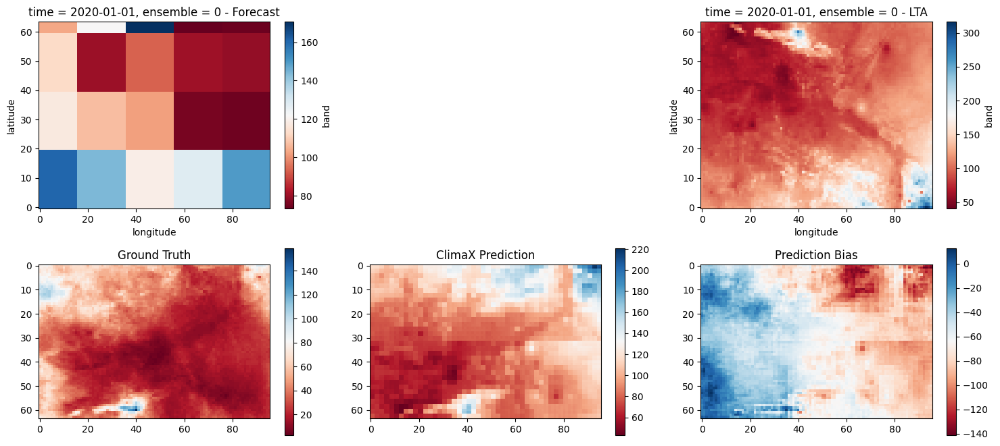

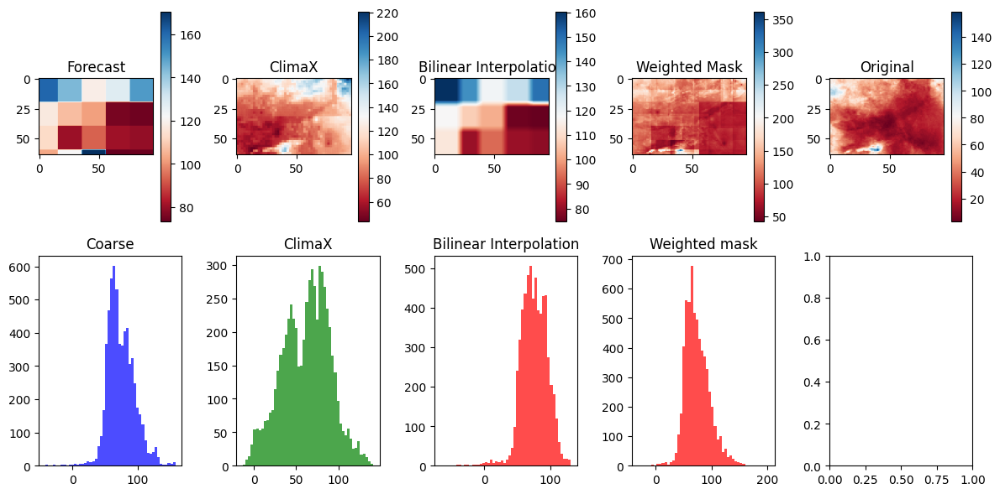

Selected device: cpu
+----------------------+--------------------+---------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 5988.372512638394  | 4665.49980254717    | 6108.665748070564      | 6053.915150444759  |
| lat_weighted_rmse    | 77.38457541809217  | 68.30446400160952   | 78.157953837537        | 77.80690940041738  |
| spearman             | 0.63254392274426   | 0.31727794094504513 | 0.6383699100145667     | 0.6770960373106772 |
| mean_bias            | 74.43482237122953  | 62.27289785631001   | 75.52451797636847      | 74.52495153993368  |
| pearson              | 0.6586438836047488 | 0.332386798772793   | 0.6553611628182738     | 0.7073778165367677 |
+----------------------+--------------------+---------------------+

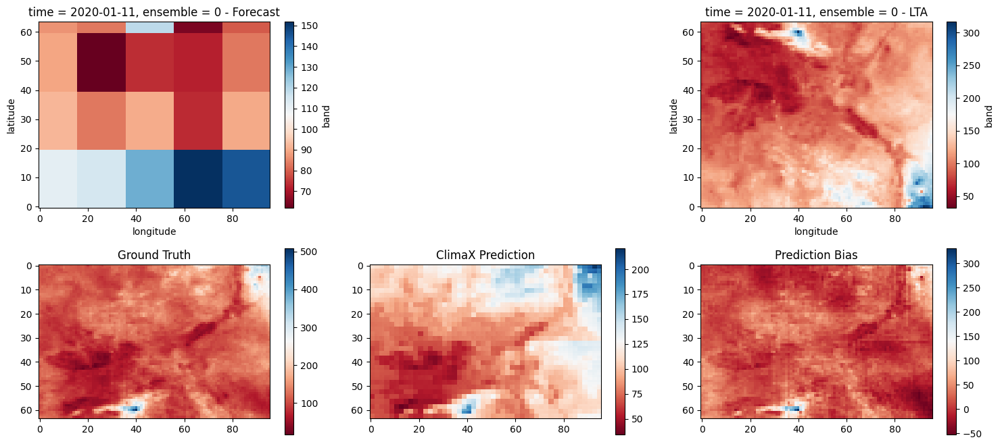

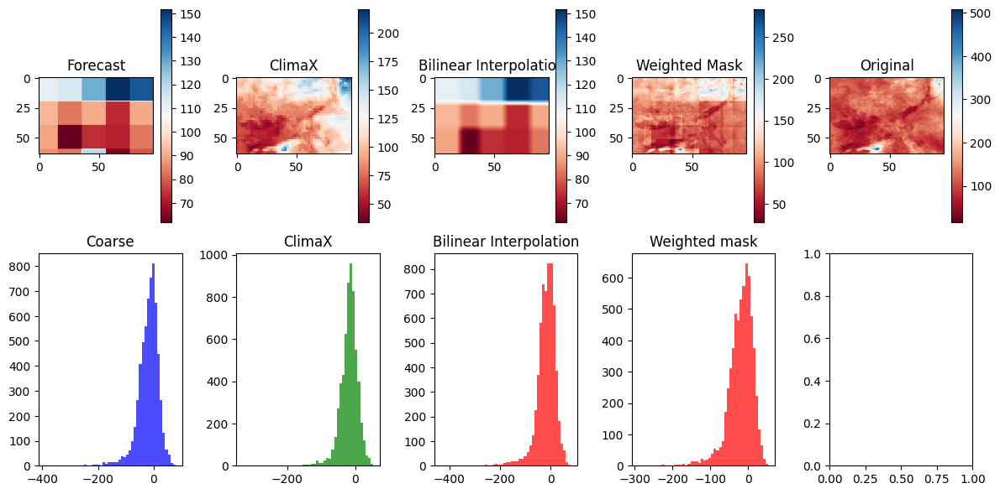

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1863.5332027637542  | 1105.5063314088447 | 1912.9234203267297     | 1508.0464183166223  |
| lat_weighted_rmse    | 43.16865996025073   | 33.24915534880314  | 43.73698000921794      | 38.83357333952958   |
| spearman             | 0.41333883293049467 | 0.7236386596644124 | 0.37878079837564127    | 0.5675785436499274  |
| mean_bias            | -19.448205889202654 | -19.10725455575934 | -18.642934113430485    | -19.312456427452474 |
| pearson              | 0.45253402656374464 | 0.7727749650817571 | 0.40843070561276495    | 0.6151367725241452  |
+----------------------+---------------------+-------------

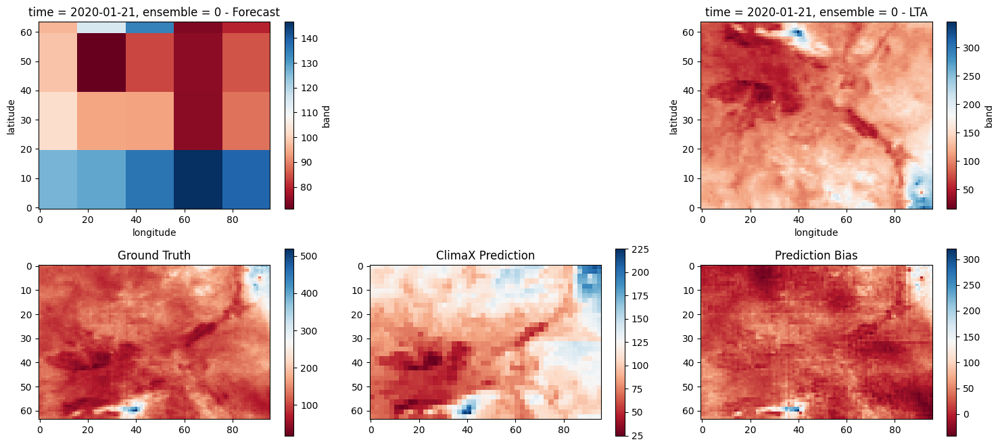

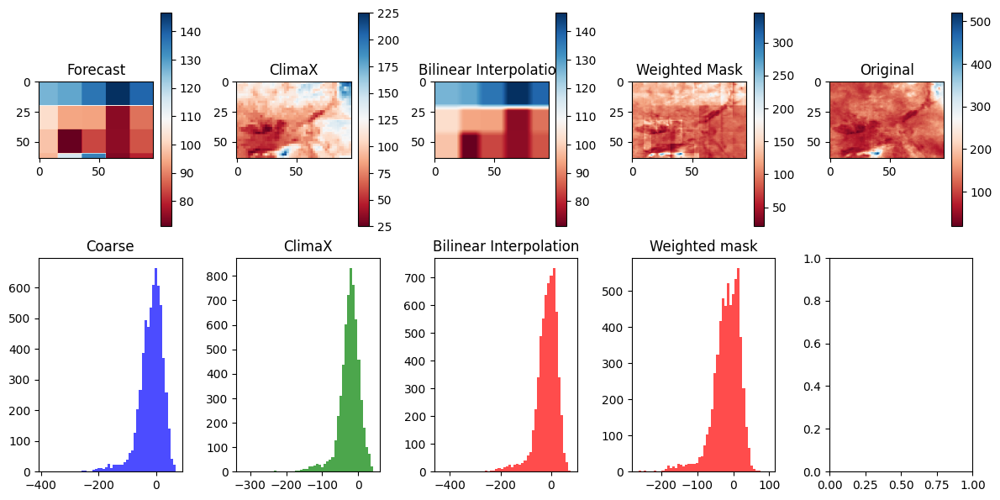

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2258.0128677738776  | 1550.2729772281643 | 2334.6517091401943     | 1829.868437332438   |
| lat_weighted_rmse    | 47.51855287962669   | 39.37350603169807  | 48.31823371295969      | 42.77696152524672   |
| spearman             | 0.380077602271965   | 0.7206262379127897 | 0.33145084491476096    | 0.5214260625757693  |
| mean_bias            | -18.510507131616265 | -24.8924069898203  | -17.8799829656879      | -18.254397426421434 |
| pearson              | 0.3984867978814574  | 0.7773267488660074 | 0.3488427856518973     | 0.580169032724476   |
+----------------------+---------------------+-------------

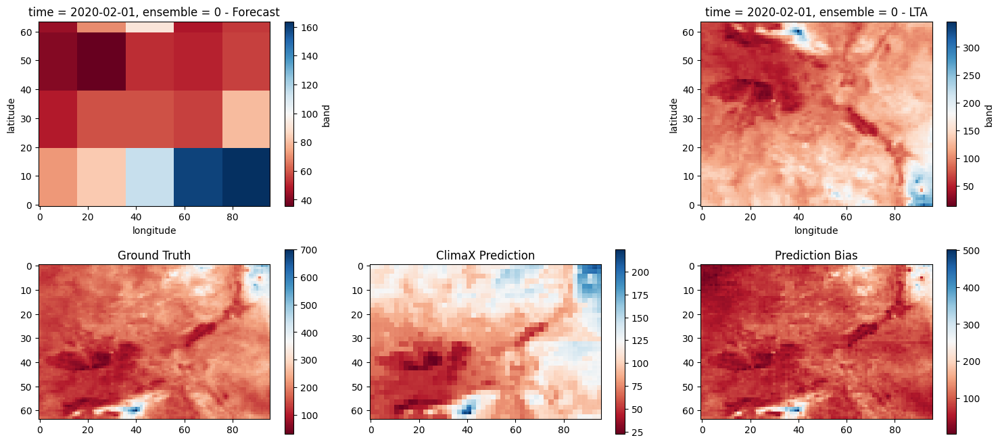

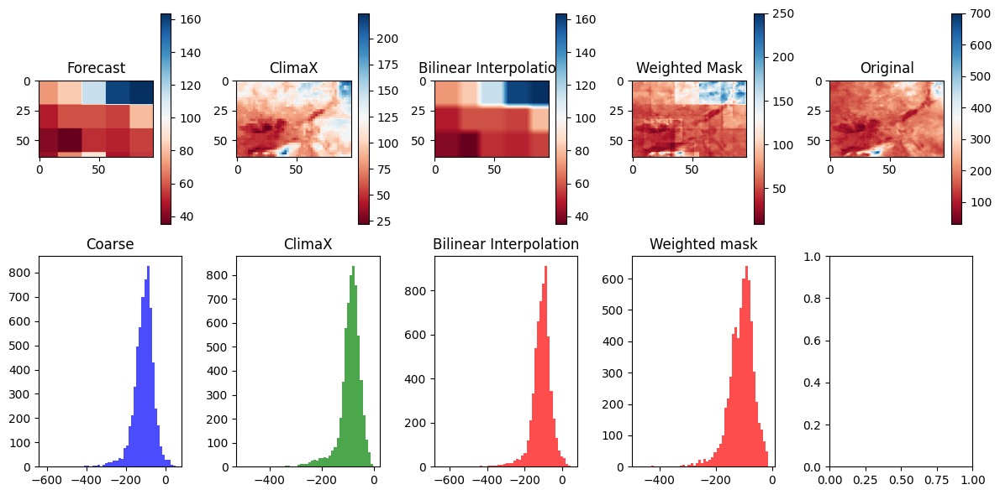

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 14899.723035452298  | 10163.055505085564 | 15060.314154891668     | 14177.209018469104 |
| lat_weighted_rmse    | 122.06442166107328  | 100.81198096003055 | 122.72047162104482     | 119.0680856420775  |
| spearman             | 0.5526632716073672  | 0.837637781461961  | 0.5668958550941797     | 0.6850794882510131 |
| mean_bias            | -109.83183425913253 | -91.19450399527946 | -110.30428132104376    | -109.5949211224603 |
| pearson              | 0.5880497558308703  | 0.8483147473449782 | 0.5762763014587218     | 0.713313482981194  |
+----------------------+---------------------+--------------------+

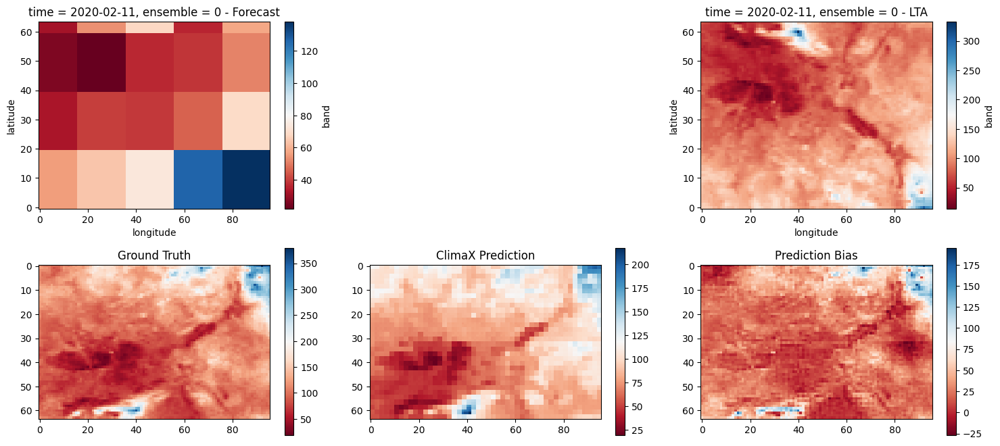

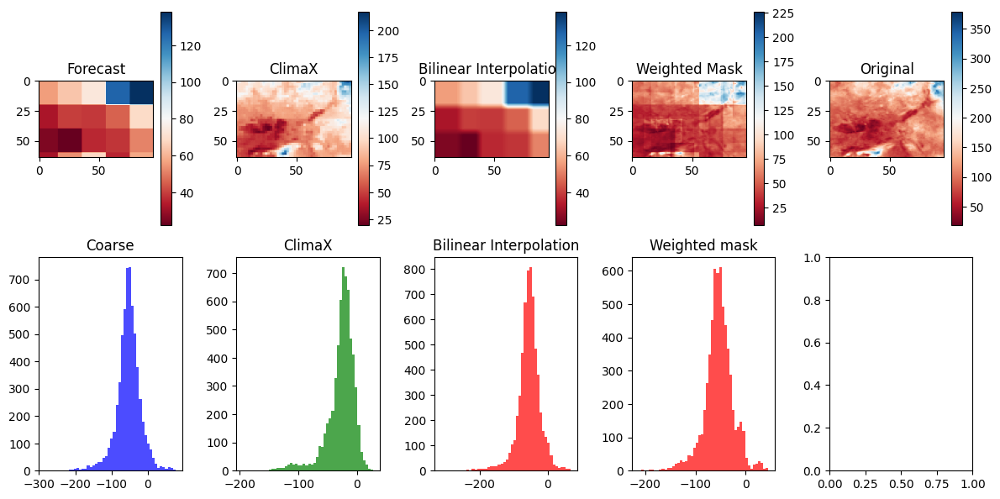

Selected device: cpu
+----------------------+--------------------+---------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4030.3531936079326 | 1385.9404418032254  | 4178.452434325762      | 3709.757970035817   |
| lat_weighted_rmse    | 63.48506275973847  | 37.2282210400017    | 64.64095013476954      | 60.90778250795063   |
| spearman             | 0.6934771929940694 | 0.8928700260876947  | 0.6812325622527832     | 0.786929783747432   |
| mean_bias            | -53.77460893522949 | -27.763523558154702 | -54.82135434479763     | -53.567257504599795 |
| pearson              | 0.6654723793385453 | 0.8804025727826321  | 0.6516113959315575     | 0.766146216480806   |
+----------------------+--------------------+--------------

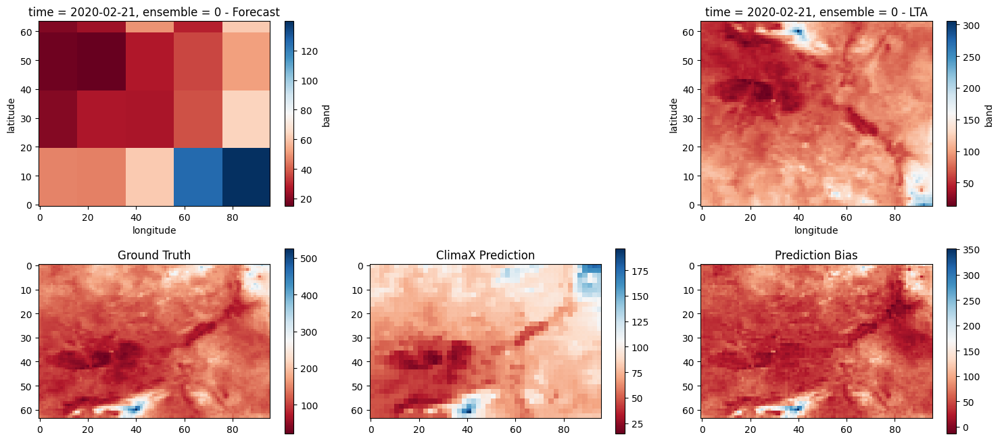

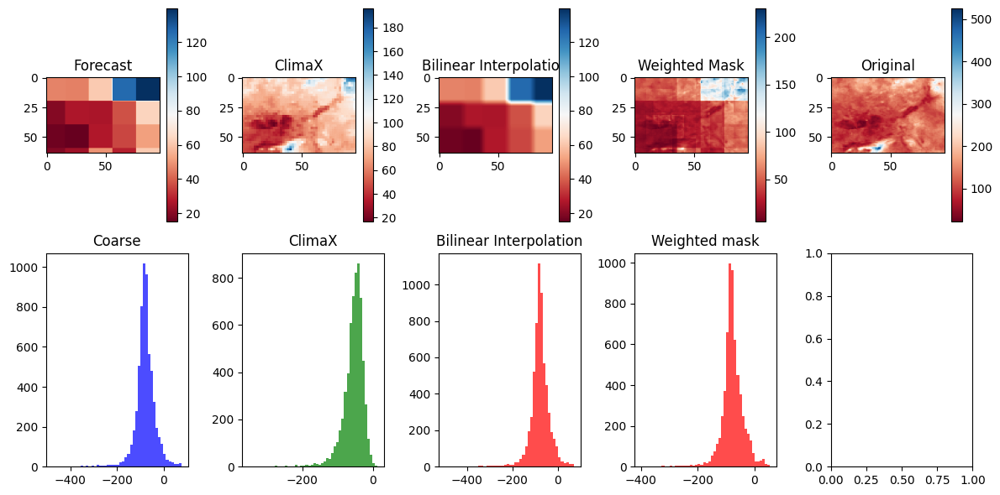

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 8078.174147447767  | 3902.15122498778   | 8271.937490221999      | 7745.4569494518    |
| lat_weighted_rmse    | 89.87866347163695  | 62.46720119380874  | 90.95019235945573      | 88.00827773256218  |
| spearman             | 0.6002684125101356 | 0.8456986004269429 | 0.5897247542266665     | 0.6875312355748568 |
| mean_bias            | -78.66367345551649 | -55.0106743608291  | -79.6071377665115      | -78.53744175285101 |
| pearson              | 0.4695348912692941 | 0.8590201427580404 | 0.4465271604334234     | 0.5700814453901094 |
+----------------------+--------------------+--------------------+---------

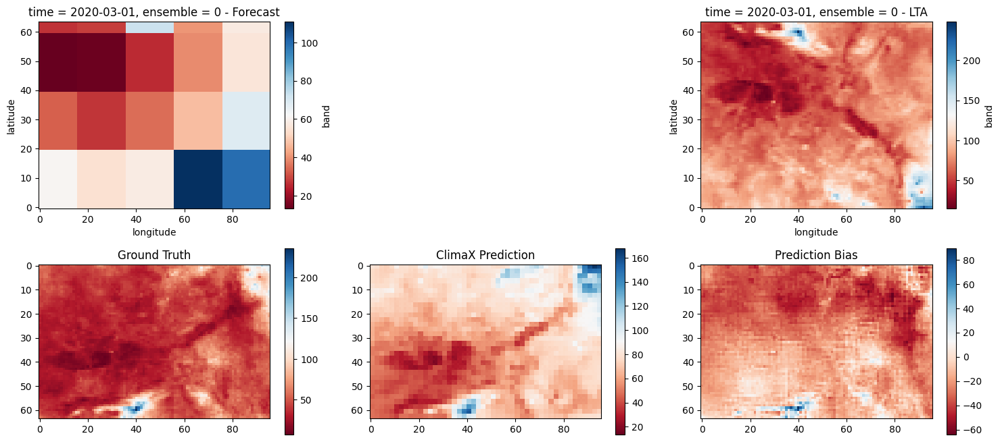

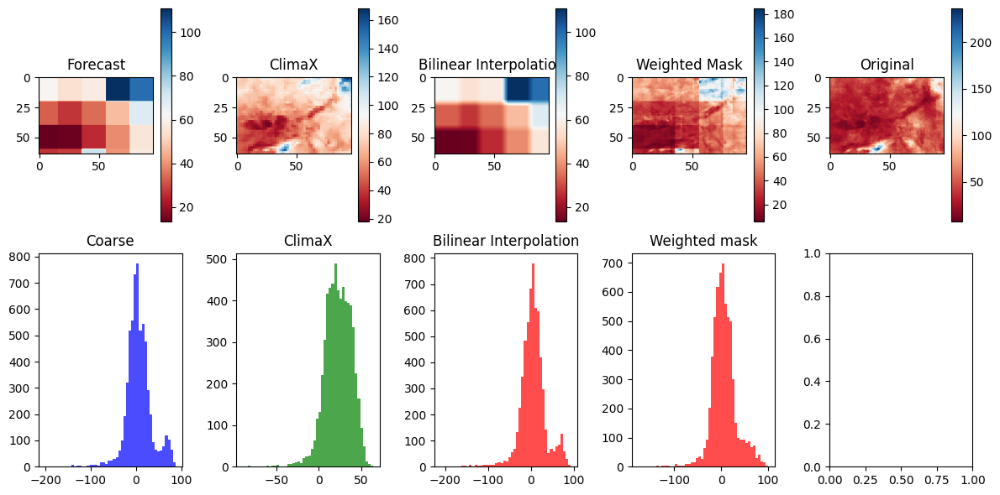

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 830.7875297650603   | 774.993615528998   | 905.253866700507       | 758.6608356715697   |
| lat_weighted_rmse    | 28.82338511981305   | 27.838707145429687 | 30.08743702445436      | 27.54379849751246   |
| spearman             | 0.43556120082916855 | 0.6467134049309047 | 0.3434831840173487     | 0.5168138679372427  |
| mean_bias            | 5.821397465964161   | 22.867348143210016 | 5.083740086760372      | 6.015014930317804   |
| pearson              | 0.3425751335812945  | 0.722254894029335  | 0.2580160238819833     | 0.45645165110988206 |
+----------------------+---------------------+-------------

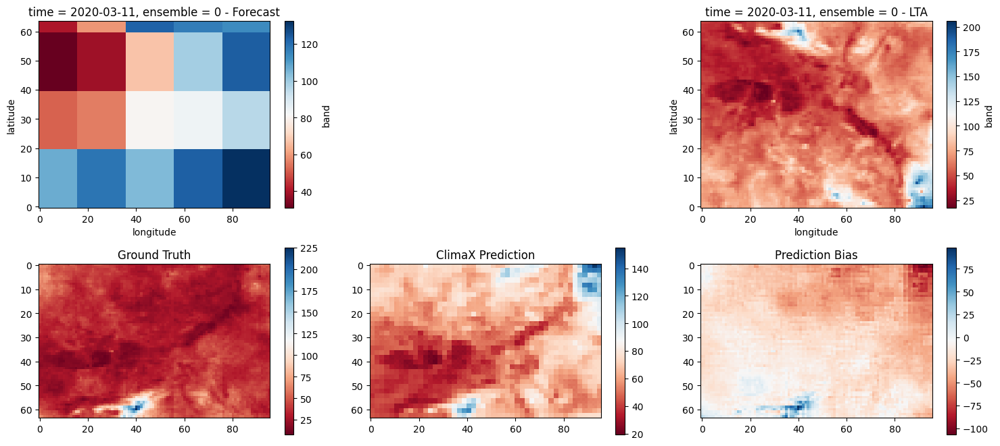

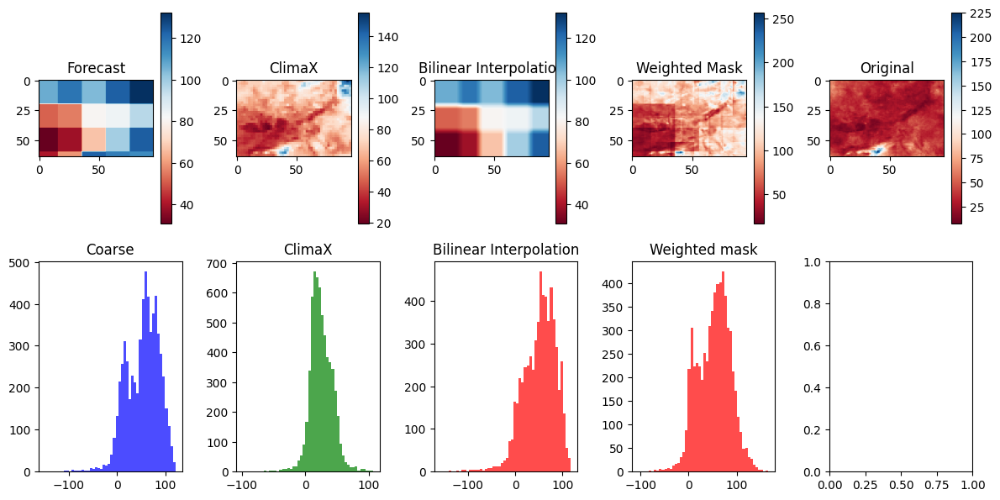

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3961.41630275152    | 942.1058735322695  | 3816.728539993566      | 4007.398648221449   |
| lat_weighted_rmse    | 62.93978314827213   | 30.693743231027874 | 61.77967740279619      | 63.30401763096438   |
| spearman             | 0.19737595470251076 | 0.4652855305010025 | 0.10942939214827781    | 0.3299687278597949  |
| mean_bias            | 53.08467940799892   | 24.692305739658572 | 51.07506716592859      | 53.250585683621466  |
| pearson              | 0.10880298158106501 | 0.4719613253963768 | -0.01173361013918422   | 0.27709783786587305 |
+----------------------+---------------------+-------------

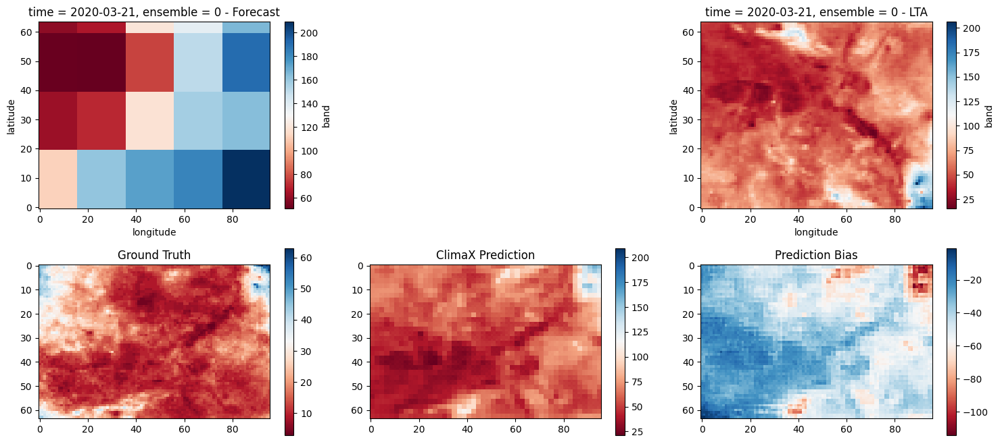

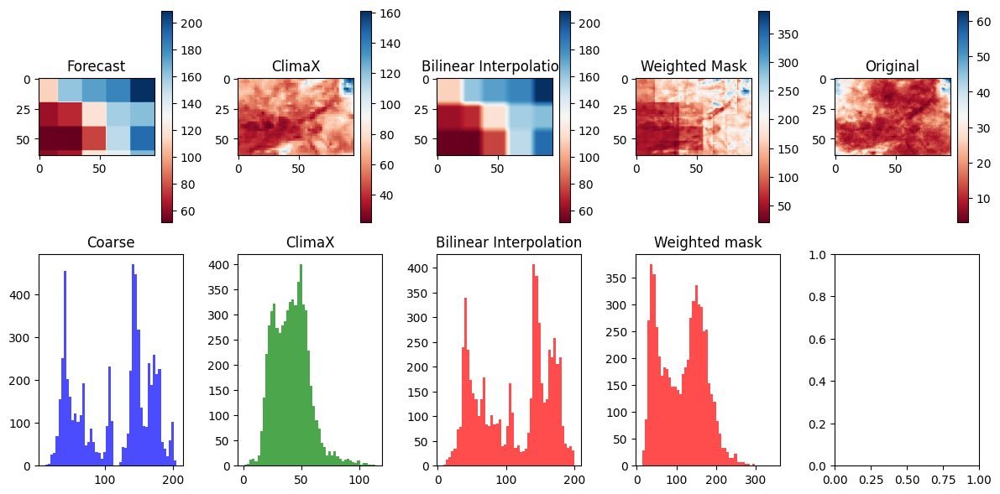

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 15893.605207837294   | 1954.1432331475064  | 15239.480435459505     | 16367.779954215     |
| lat_weighted_rmse    | 126.06984257877573   | 44.205692316120405  | 123.44829053275507     | 127.93662475700616  |
| spearman             | -0.08084888995587991 | 0.46255937867558605 | -0.10407060850152358   | 0.06187816235297295 |
| mean_bias            | 114.24853947386146   | 41.385237083149455  | 111.85464270661275     | 114.3040195517242   |
| pearson              | -0.0731190889405944  | 0.5296139825584883  | -0.07882705108013793   | 0.07391232892638722 |
+----------------------+-------------------

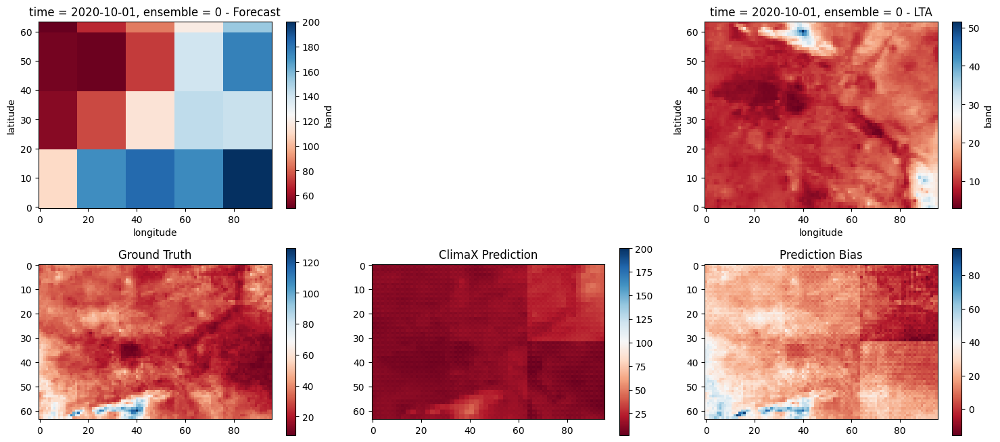

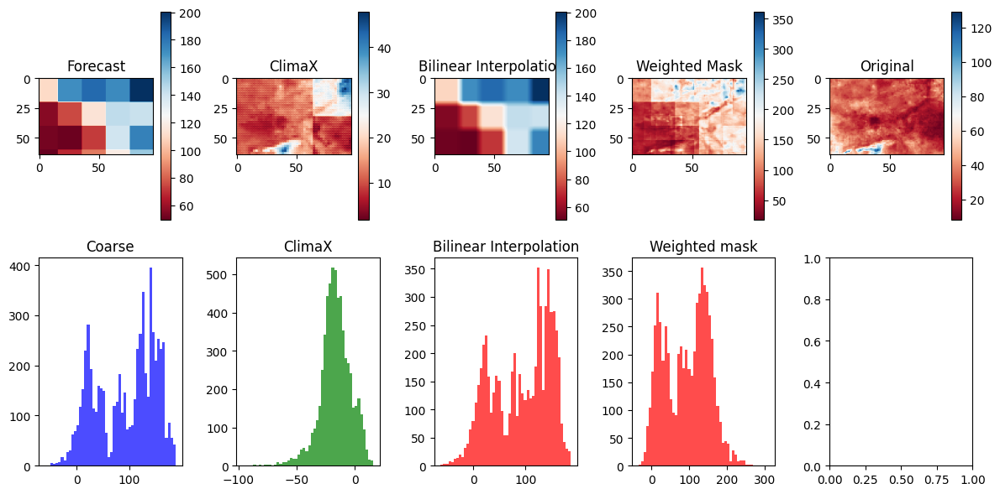

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 11932.70364816352    | 456.107742647192   | 11513.01017092607      | 12212.591856802277   |
| lat_weighted_rmse    | 109.23691522632595   | 21.356679110929022 | 107.2986960355347      | 110.51059612906934   |
| spearman             | -0.39765733555618954 | 0.1695000803819756 | -0.3976247439032293    | -0.2287715226925994  |
| mean_bias            | 93.46701438010982    | -16.83036843749384 | 91.85392637581876      | 93.49801077165952    |
| pearson              | -0.4120539027623963  | 0.2424838263986303 | -0.4202578230435435    | -0.22396878825160726 |
+----------------------+-------------------

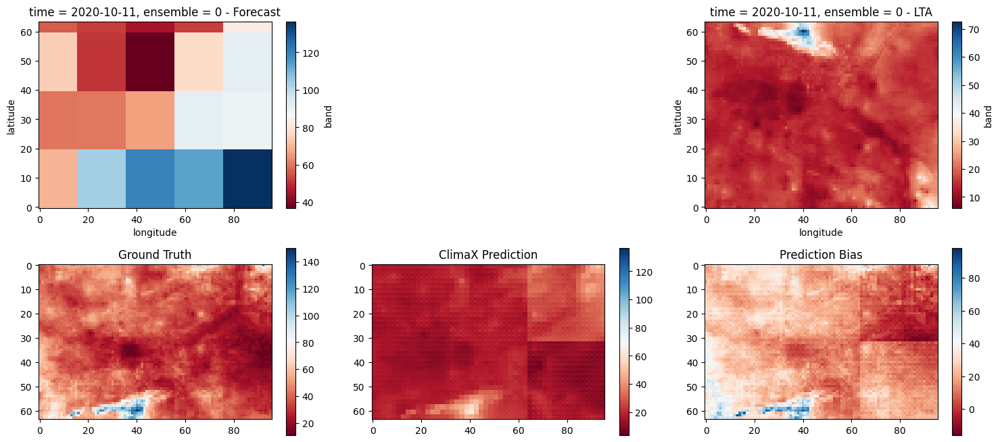

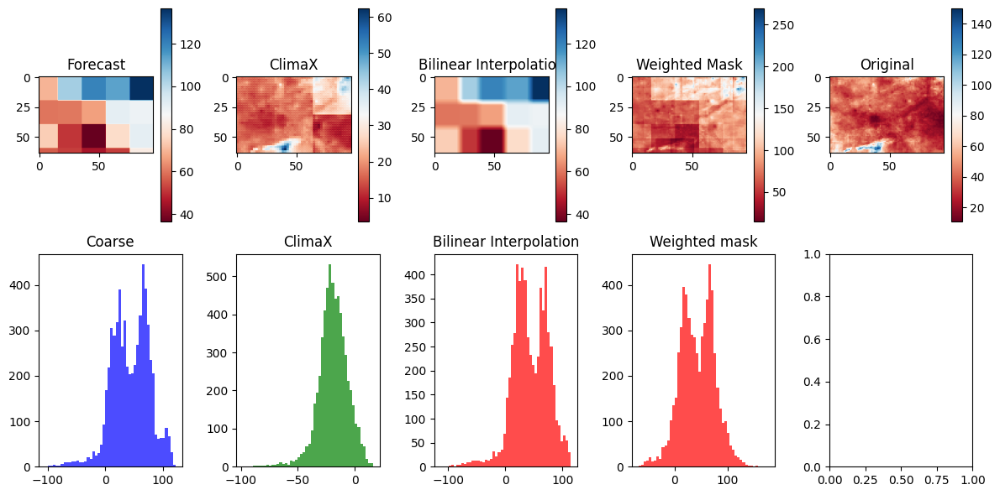

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+---------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 2974.7759534984143   | 534.7194126503547   | 2915.5956992356164     | 2957.8419552158734    |
| lat_weighted_rmse    | 54.54150670359606    | 23.124000792474355  | 53.996256344635746     | 54.38604559274257     |
| spearman             | -0.13745359776329158 | 0.3341163084493266  | -0.11576481285683304   | -0.014873006960718487 |
| mean_bias            | 43.50233327411115    | -19.195501152426004 | 43.825811609625816     | 43.429444035359964    |
| pearson              | -0.15911210351765484 | 0.4932767083171491  | -0.155217490397879     | 0.019310196907205028  |
+----------------------+---

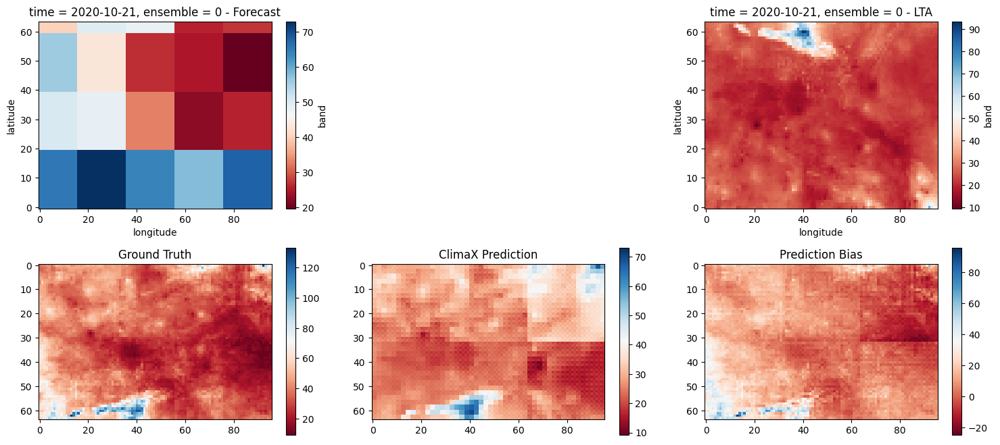

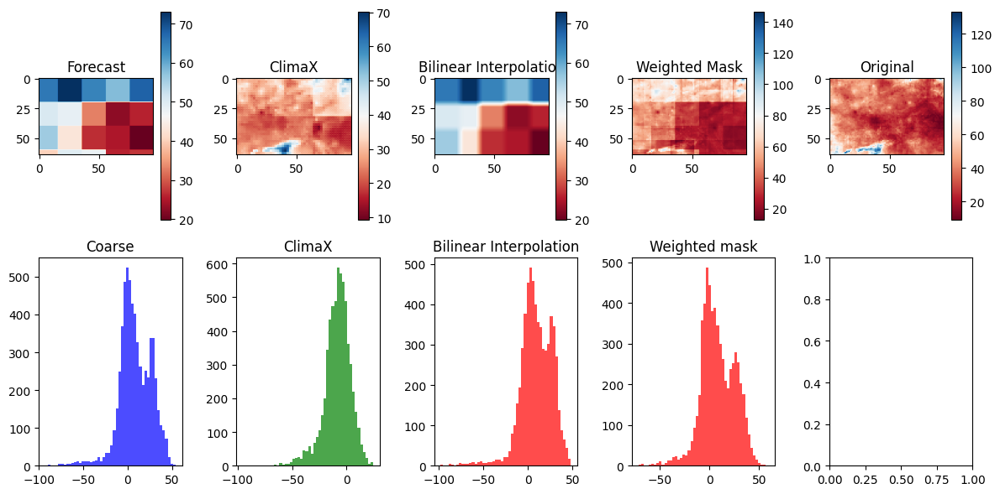

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 400.8970073011701   | 217.87925199897973 | 403.2285585825384      | 360.927074965219   |
| lat_weighted_rmse    | 20.022412624385957  | 14.760733450576897 | 20.08055174995295      | 18.998080823209985 |
| spearman             | 0.5195908484002981  | 0.4633052167903702 | 0.5264547241589238     | 0.5973499195992542 |
| mean_bias            | 8.385131187426545   | -8.334645528967183 | 9.178114558880523      | 8.393226902311042  |
| pearson              | 0.39470402283314787 | 0.5820048830919881 | 0.39320153961540655    | 0.51227911874217   |
+----------------------+---------------------+--------------------+

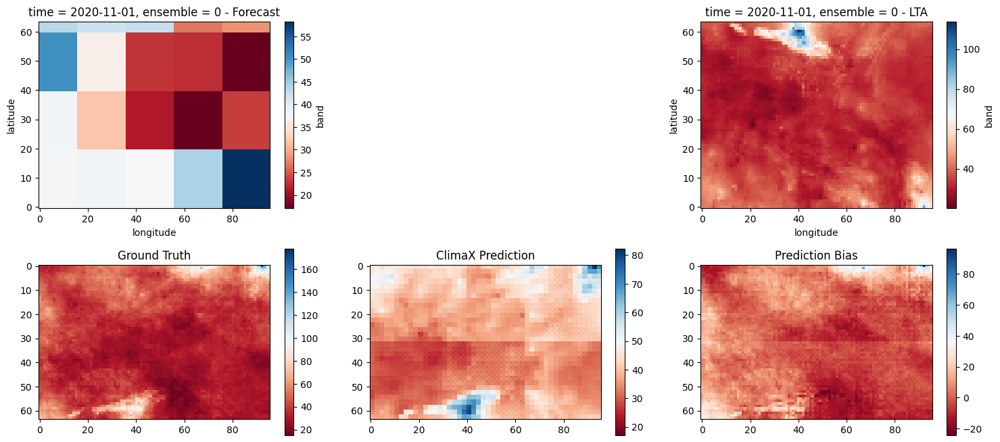

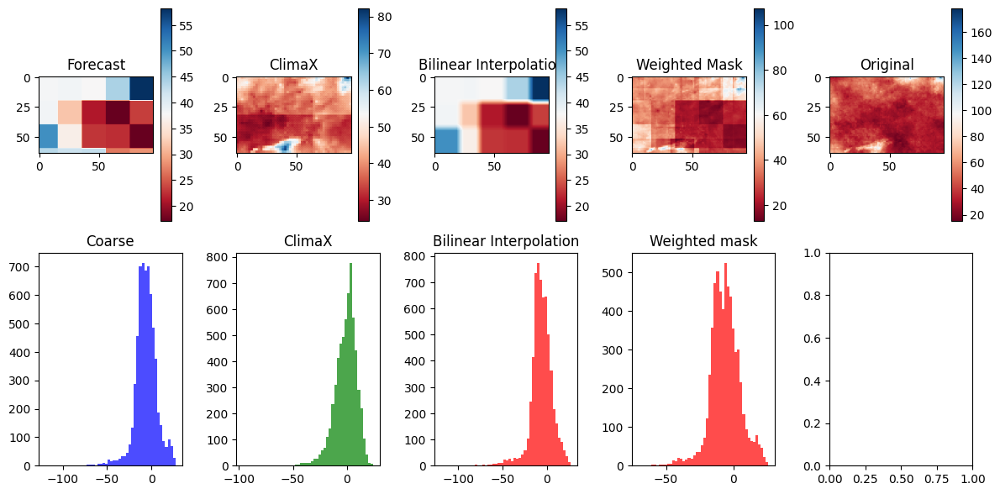

Selected device: cpu
+----------------------+--------------------+---------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 187.85970578748038 | 103.60671136935188  | 185.2370486890085      | 162.12555702054294 |
| lat_weighted_rmse    | 13.70619224246765  | 10.178738201238495  | 13.610181802202662     | 12.732853451624383 |
| spearman             | 0.6398351951169741 | 0.5416954349412515  | 0.6299143437455336     | 0.6669148732994162 |
| mean_bias            | -6.166864047137395 | -1.1483919673288838 | -6.136829177848995     | -6.168578412694231 |
| pearson              | 0.5416842341967472 | 0.6791297747883642  | 0.5382321055945061     | 0.6364091486214247 |
+----------------------+--------------------+---------------------+

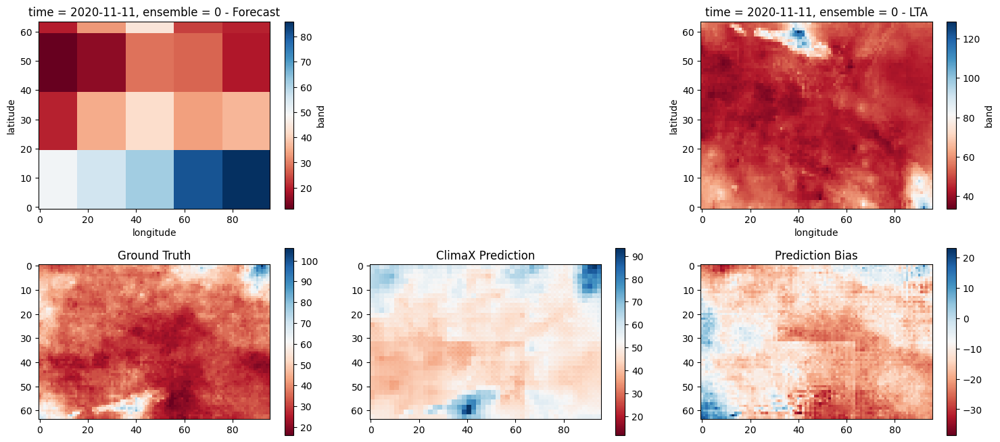

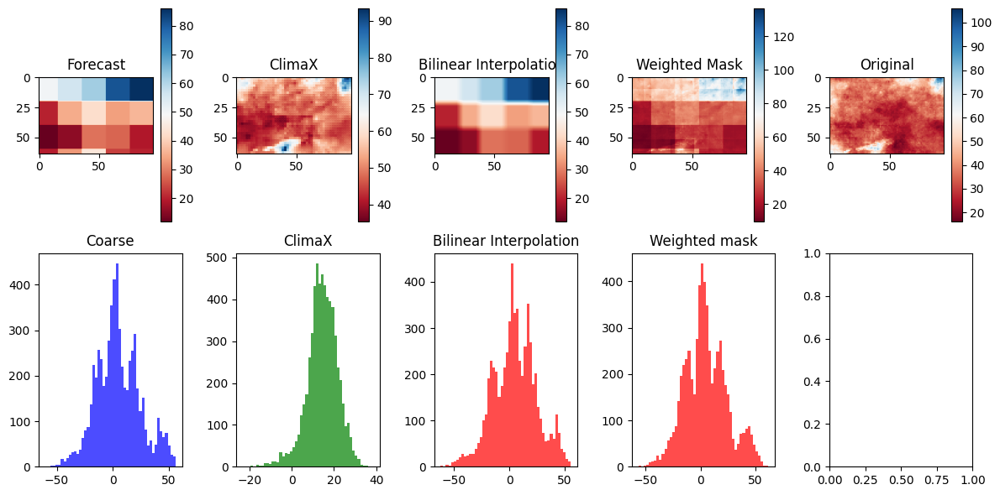

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 403.3247199828417  | 260.65405527180263 | 406.5818579161576      | 394.2566624803416   |
| lat_weighted_rmse    | 20.082945998603932 | 16.144784150672397 | 20.16387507192399      | 19.855897423192477  |
| spearman             | 0.4051075602528636 | 0.5483090945779403 | 0.33478869901033503    | 0.42829209520085754 |
| mean_bias            | 4.894557511433959  | 14.465988516807556 | 5.0086876953331085     | 4.9479370044233875  |
| pearson              | 0.4333163016572365 | 0.6998485551516751 | 0.39136983023424543    | 0.49033760704265783 |
+----------------------+--------------------+--------------------+-

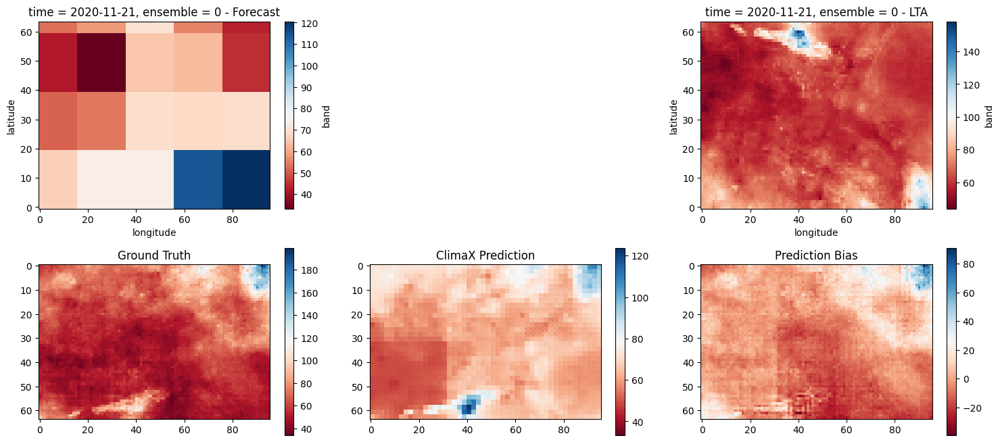

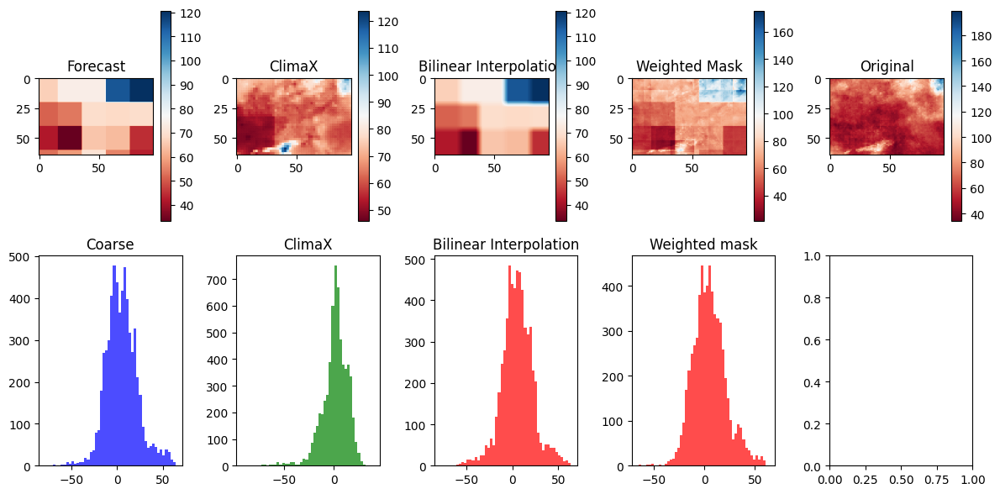

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 322.577623113273   | 169.83872821399072 | 316.87222622134306     | 293.3140770417578  |
| lat_weighted_rmse    | 17.96044607222418  | 13.0322188522903   | 17.80090520791971      | 17.126414599727457 |
| spearman             | 0.596307272255196  | 0.6298668266290487 | 0.5795107022433278     | 0.6676128153198861 |
| mean_bias            | 4.932333409786217  | 1.4149170629680157 | 5.231585104639329      | 5.025440660305314  |
| pearson              | 0.6634171515281557 | 0.7208402376402178 | 0.6476038292764223     | 0.7240710347535713 |
+----------------------+--------------------+--------------------+---------

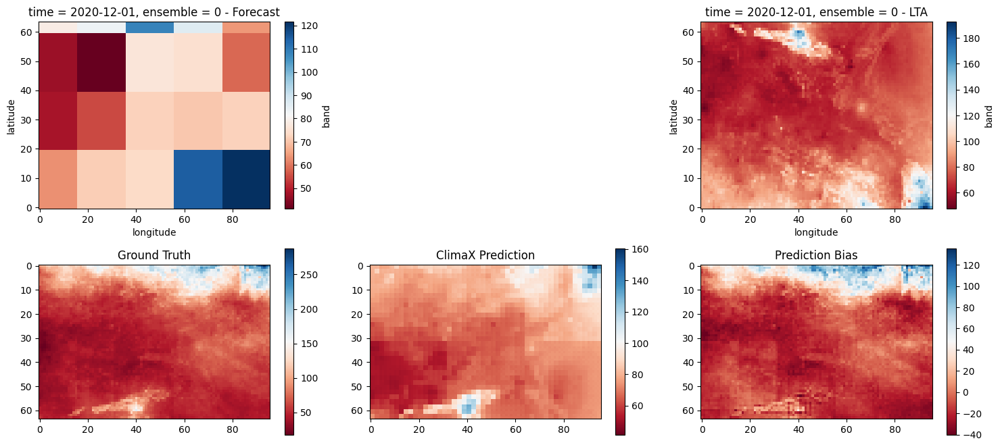

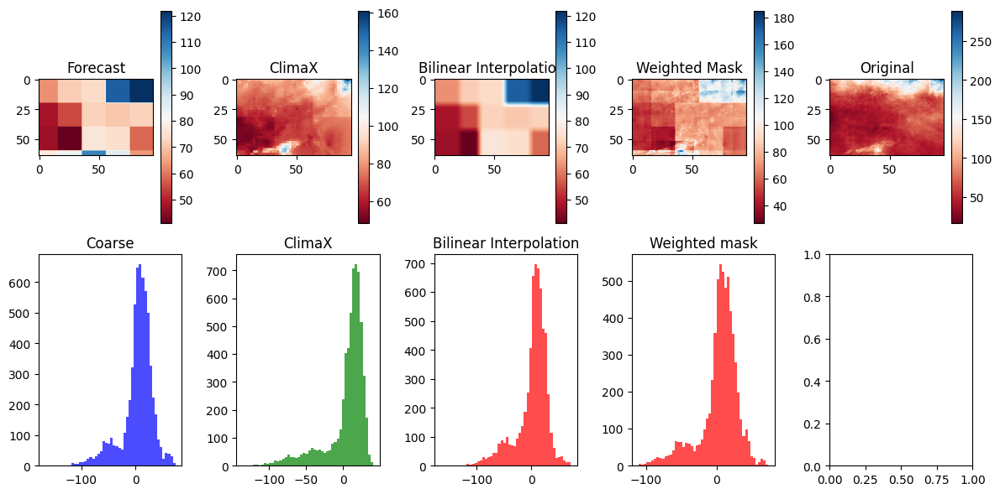

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 845.0820225753577  | 764.5634159328392  | 836.5470588872971      | 764.1331416129293  |
| lat_weighted_rmse    | 29.07029450444831  | 27.650739880387274 | 28.923123256095582     | 27.64295826450073  |
| spearman             | 0.5459564840041305 | 0.859346083444603  | 0.5569185220885151     | 0.6218264992844426 |
| mean_bias            | 3.712826771661639  | 4.145382946357131  | 2.246067031597093      | 3.830219516841069  |
| pearson              | 0.6261177165664831 | 0.8111983096749282 | 0.6290423769443618     | 0.6725849181358484 |
+----------------------+--------------------+--------------------+---------

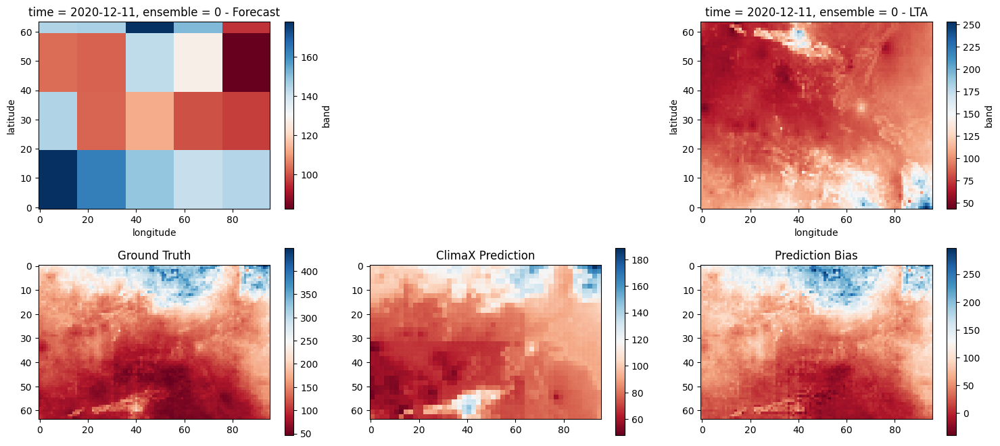

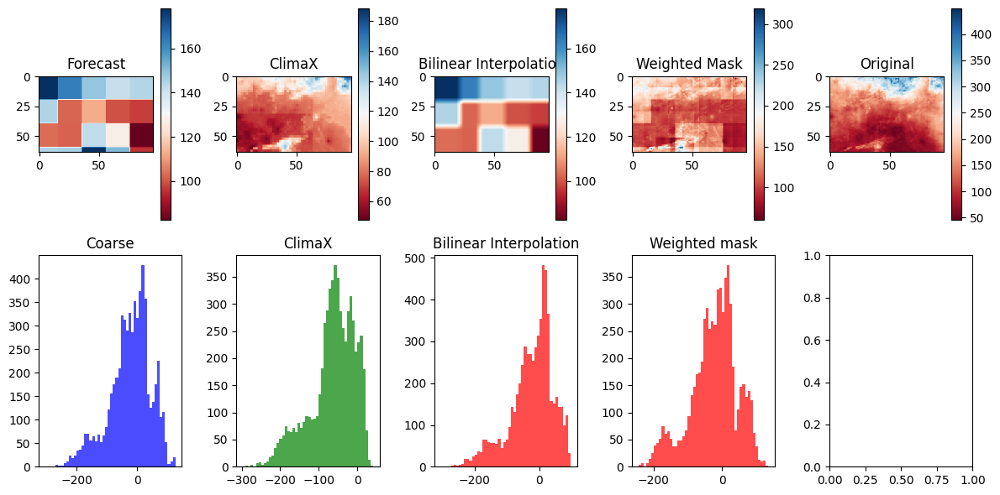

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 5310.287708070845   | 7628.831318781992  | 4947.892293282587      | 5067.196969866755   |
| lat_weighted_rmse    | 72.87172090784493   | 87.34318129529055  | 70.34125598311837      | 71.18424664114073   |
| spearman             | 0.31072049090593346 | 0.7832341489142672 | 0.4434736322744229     | 0.37779780857845113 |
| mean_bias            | -23.49337101231019  | -64.5993016405652  | -22.725832402706146    | -23.38334952977796  |
| pearson              | 0.3799858391271616  | 0.8352988364591781 | 0.4677052866277139     | 0.4324689819175478  |
+----------------------+---------------------+-------------

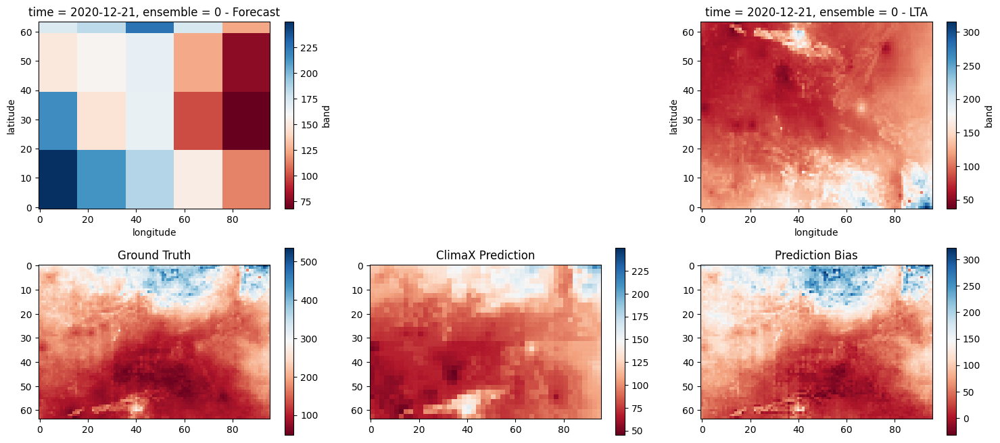

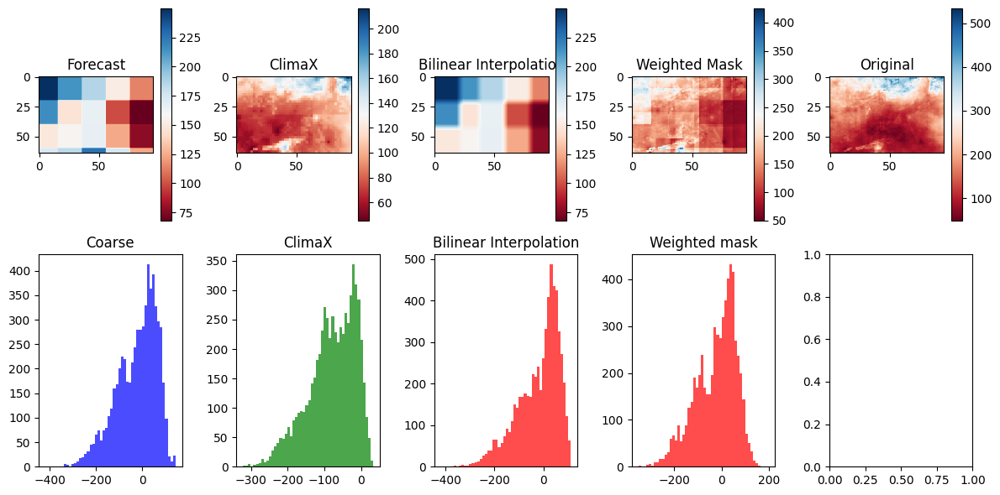

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 8223.845717656432   | 10518.02873794286  | 7665.981351268306      | 7836.2910650802705  |
| lat_weighted_rmse    | 90.6854217482415    | 102.55744116319819 | 87.55559006293262      | 88.52282793201012   |
| spearman             | 0.18488448117300513 | 0.7608197931727995 | 0.27995342450553057    | 0.2825989107671214  |
| mean_bias            | -22.45728394637507  | -79.6224879945318  | -19.317024388660997    | -22.469073353956162 |
| pearson              | 0.2251698838963528  | 0.8419736705475986 | 0.2749899215360935     | 0.2957579607094363  |
+----------------------+---------------------+-------------

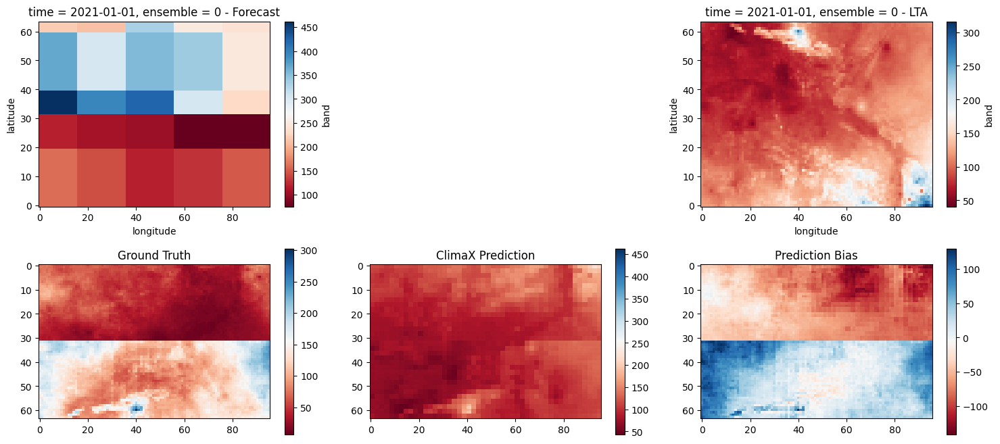

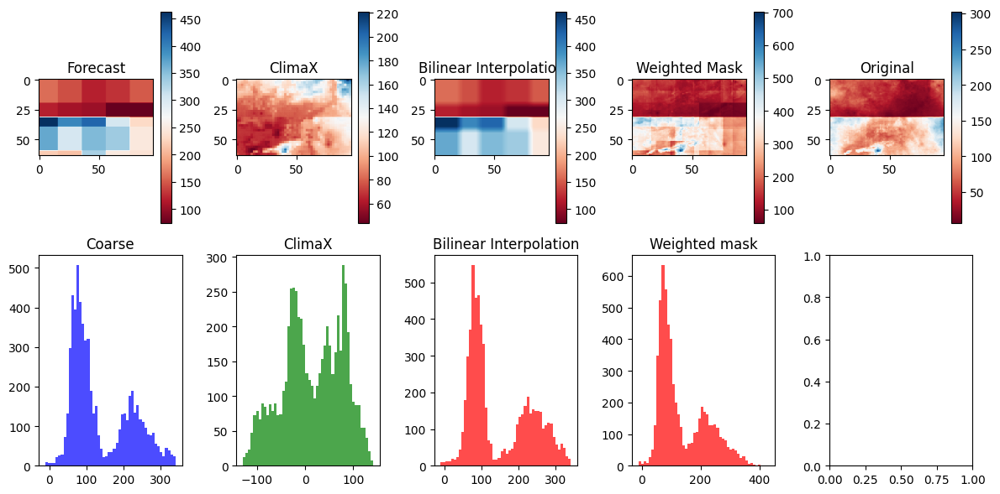

Selected device: cpu
+----------------------+--------------------+----------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX               | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+----------------------+------------------------+--------------------+
| lat_weighted_mse_val | 25278.72697492161  | 4003.126380489563    | 29177.662214172637     | 25560.932688030724 |
| lat_weighted_rmse    | 158.99285196172062 | 63.27026458368546    | 170.81470139941888     | 159.87786803691975 |
| spearman             | 0.8096006094264006 | -0.14865173604738205 | 0.8228359464282795     | 0.8354327595071397 |
| mean_bias            | 137.78447316835326 | 14.914896073440701   | 148.8264433729152      | 137.71468568220735 |
| pearson              | 0.7413713190519242 | -0.1042370451410205  | 0.7569077548255112     | 0.768523915137938  |
+----------------------+--------------------+--------------

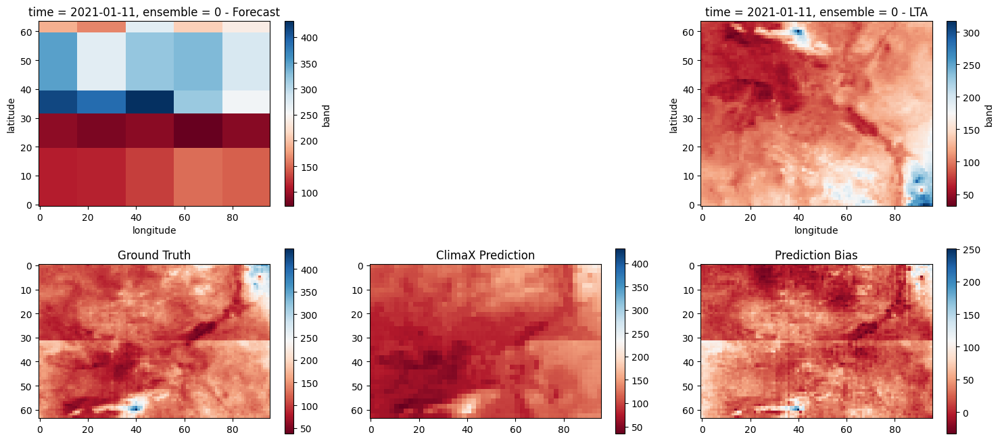

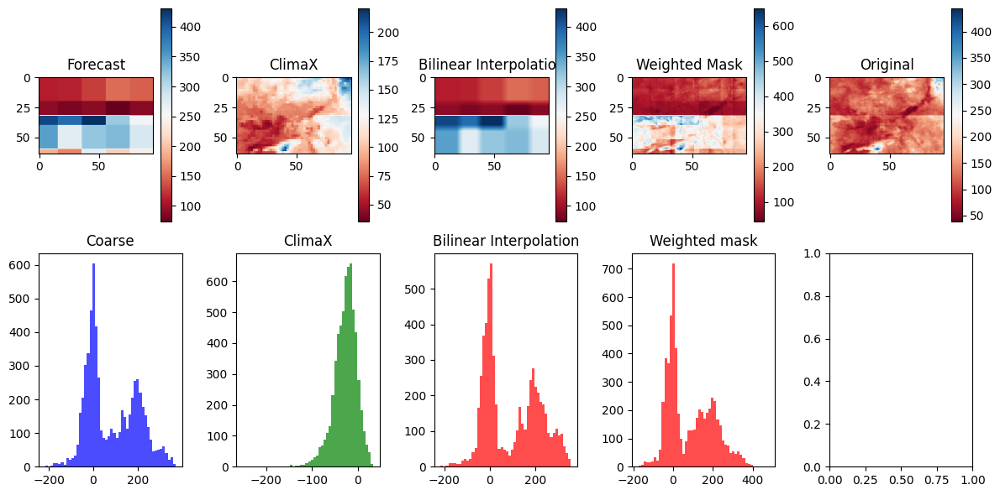

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 19813.435848861238  | 1384.6954655994039  | 23395.248413321242     | 19838.91157064577   |
| lat_weighted_rmse    | 140.760206908278    | 37.211496417094054  | 152.95505357235257     | 140.85067117570213  |
| spearman             | 0.13038183698552464 | 0.6991332372111687  | 0.10293906921304685    | 0.2388153495029355  |
| mean_bias            | 83.54831689285737   | -27.574723754078136 | 95.12764890926582      | 83.51379803257686   |
| pearson              | 0.0341630788589182  | 0.7656586864527057  | 0.01371617642997376    | 0.17380217966114772 |
+----------------------+---------------------+-----

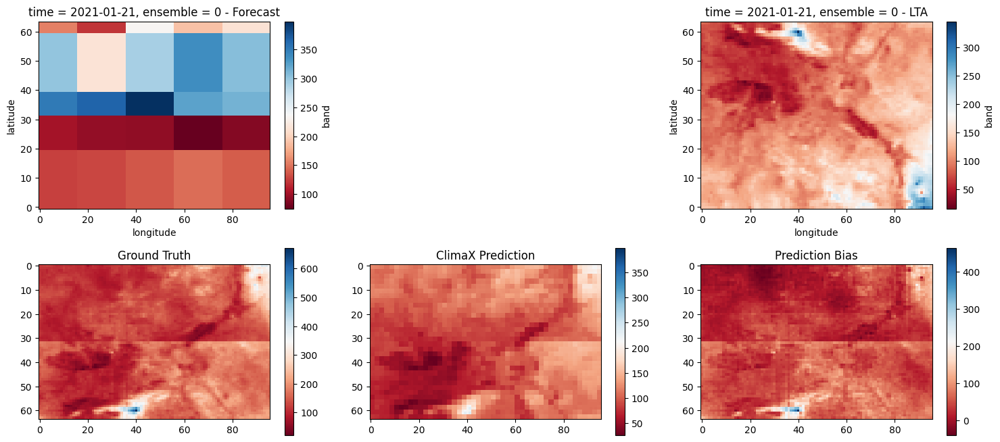

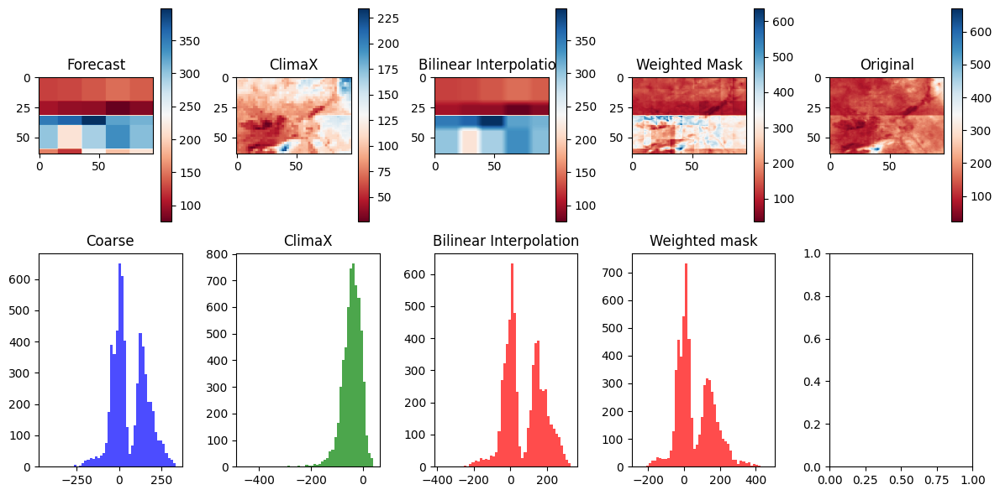

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 14072.435286323423  | 3382.5577040647936  | 16292.31345309956      | 13953.149292741116  |
| lat_weighted_rmse    | 118.62729570517665  | 58.15976017887964   | 127.64134695740076     | 118.1234493770865   |
| spearman             | 0.3372287193816783  | 0.6765158860857249  | 0.33618749348991056    | 0.44614742937872903 |
| mean_bias            | 61.534018280605466  | -44.109271971508875 | 73.05625224734345      | 61.7670771535486    |
| pearson              | 0.21428480648597067 | 0.7404696381758685  | 0.20483637122056064    | 0.37043055851286993 |
+----------------------+---------------------+-----

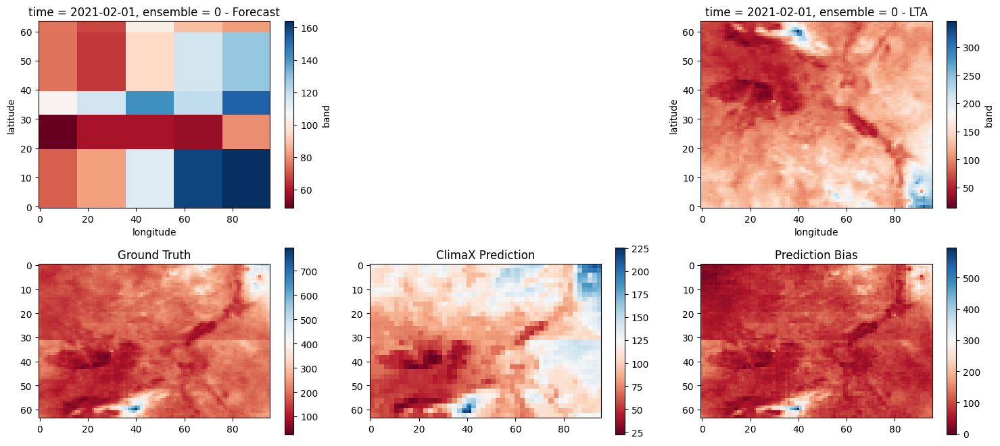

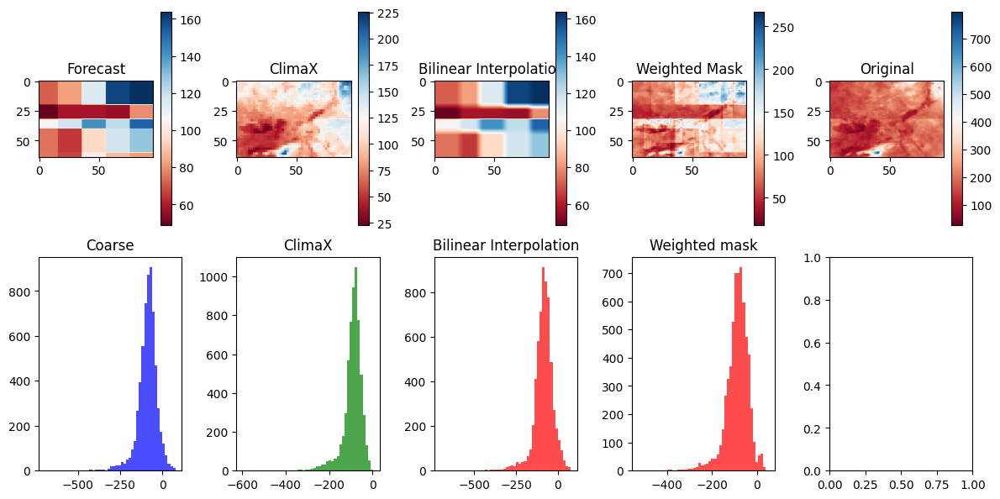

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 11234.420911865811  | 10640.258694661976 | 11002.950586187586     | 10345.5987659806   |
| lat_weighted_rmse    | 105.99255120934589  | 103.15162962678765 | 104.89495024159926     | 101.71331656170003 |
| spearman             | 0.47160540758181496 | 0.7999819379248618 | 0.48389864896701107    | 0.6237879322362551 |
| mean_bias            | -87.78485325444488  | -92.58712114579974 | -86.1078893955176      | -87.55899182520805 |
| pearson              | 0.4721870867062157  | 0.8163802071529547 | 0.45730800830449225    | 0.6417517968118658 |
+----------------------+---------------------+--------------------+

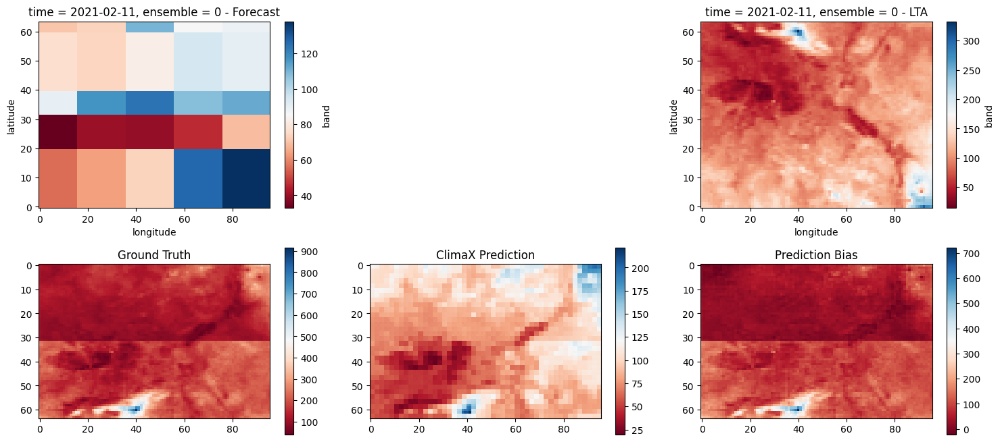

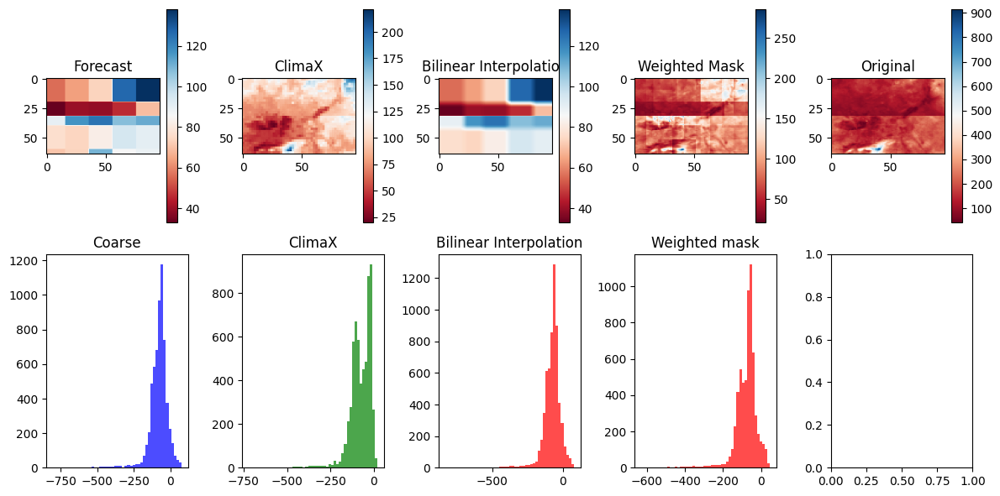

Selected device: cpu
+----------------------+--------------------+---------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 10383.683583830118 | 9684.083542041331   | 10415.2534941545       | 9494.9583231532    |
| lat_weighted_rmse    | 101.90036105838938 | 98.40774127090475   | 102.05514927799821     | 97.44207675923785  |
| spearman             | 0.5542985039146197 | 0.36665928298879824 | 0.5181147757698077     | 0.6696129239414014 |
| mean_bias            | -78.05012901003161 | -75.95020253770052  | -77.46580038095513     | -77.91157384216784 |
| pearson              | 0.3702835767242856 | 0.46493629748639026 | 0.3377557277672032     | 0.5637273126156646 |
+----------------------+--------------------+---------------------+

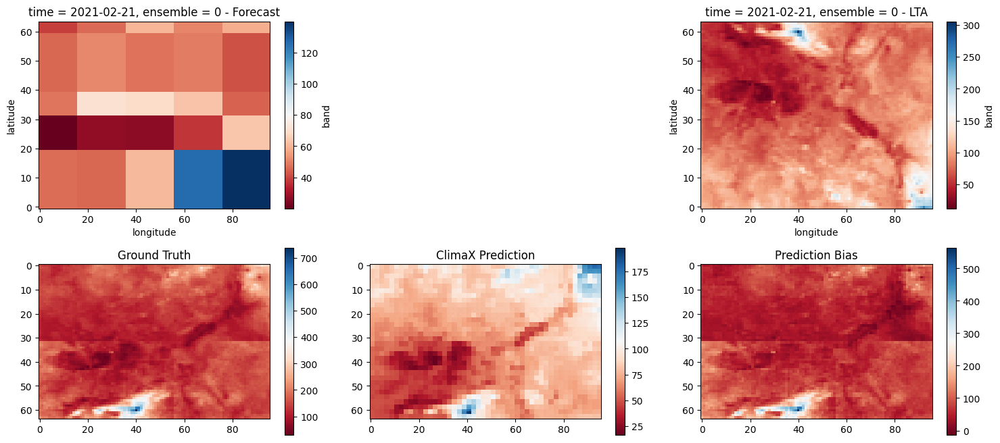

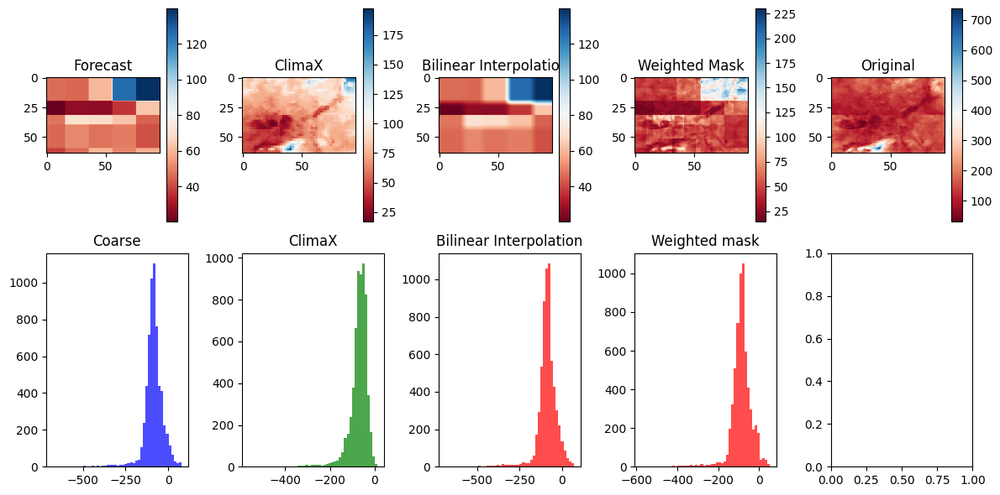

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 10868.82004035873   | 7201.609277821597  | 10838.032833155094     | 10329.161351114812  |
| lat_weighted_rmse    | 104.25363322378136  | 84.86229597307391  | 104.10587319241452     | 101.6324817718962   |
| spearman             | 0.13615169594841103 | 0.5831219857219381 | 0.14914517697619506    | 0.4155337672024779  |
| mean_bias            | -86.6227699344357   | -71.98353761962305 | -86.5015798797831      | -86.61057948165885  |
| pearson              | 0.19353460917439091 | 0.6230385460179368 | 0.17844664919218511    | 0.36480081073577364 |
+----------------------+---------------------+-------------

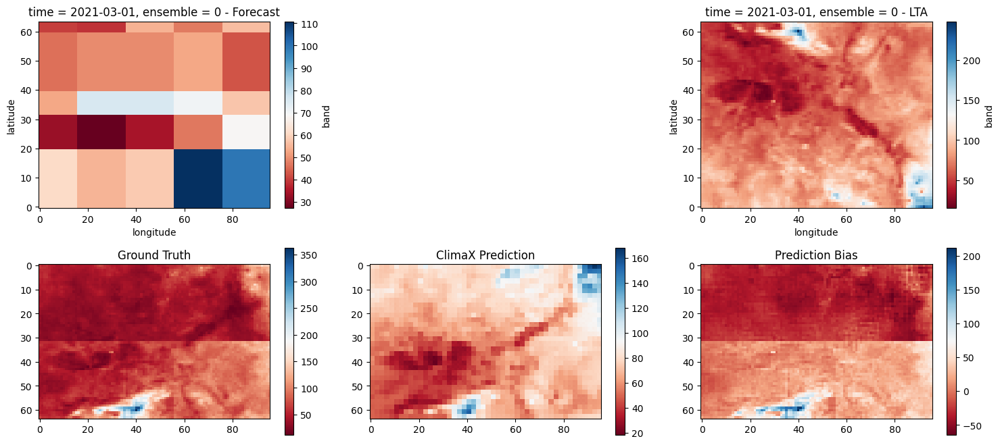

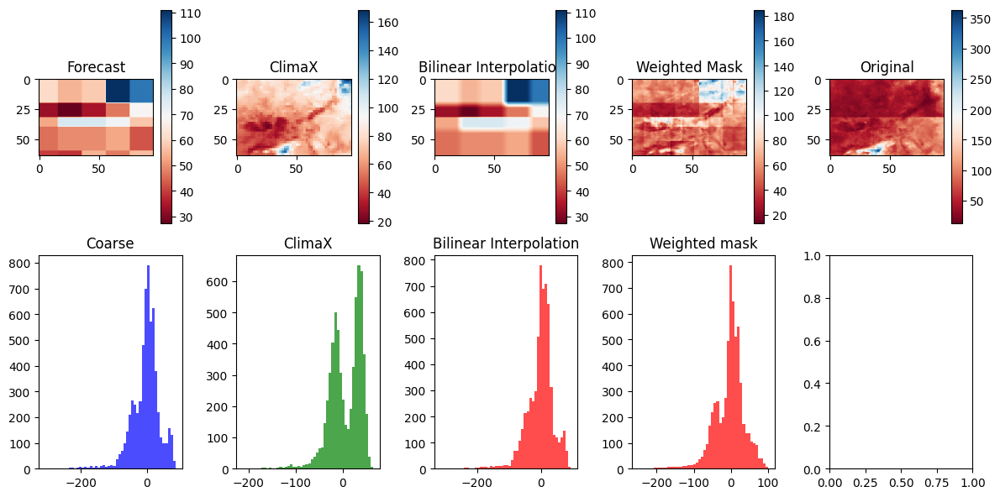

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1754.051225333581    | 1172.9861563888353  | 1716.3982041575644     | 1587.4372647200955  |
| lat_weighted_rmse    | 41.88139473959267    | 34.24888547659376   | 41.42943644508774      | 39.84265634618374   |
| spearman             | 0.03705243682564282  | 0.2067622530151289  | 0.03073355466107153    | 0.23716009286989226 |
| mean_bias            | -3.245549253808953   | 5.38052001285056    | -2.1481009128813895    | -3.1928638842267247 |
| pearson              | -0.01087857143879754 | 0.37953543414610086 | -0.019237995884295117  | 0.1618092510482952  |
+----------------------+-------------------

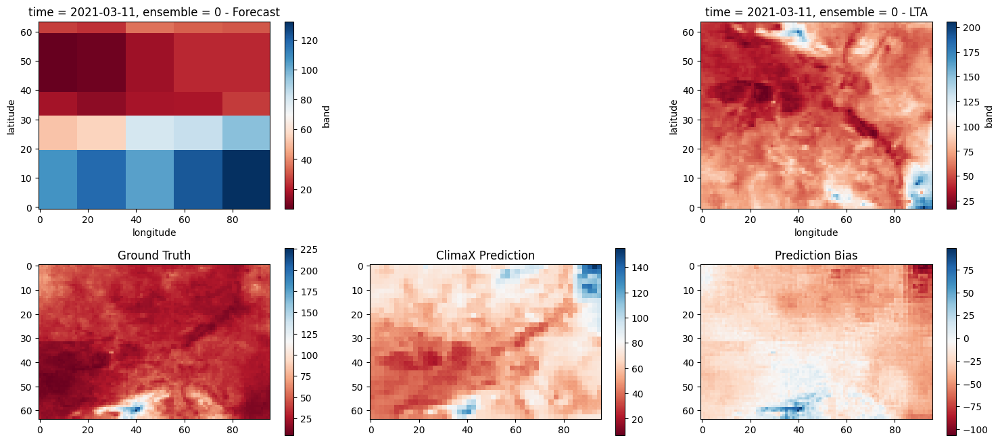

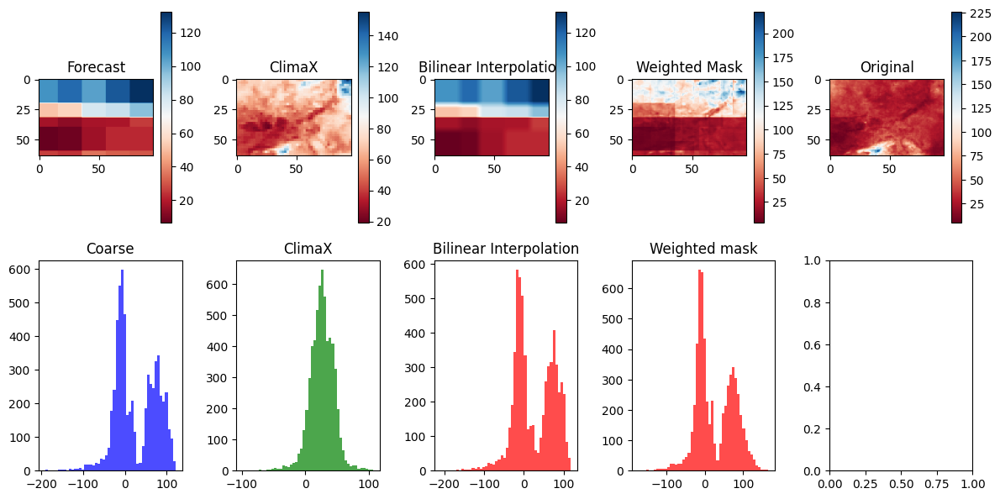

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 3120.186848332765    | 1035.838472021616   | 3171.406161167238      | 3156.9231243977333   |
| lat_weighted_rmse    | 55.85863271091376    | 32.18444456599517   | 56.31523915573153      | 56.18650304475029    |
| spearman             | 0.1717604763963859   | 0.46218115489802675 | 0.12987017440230467    | 0.22766969014230334  |
| mean_bias            | 25.861169298179448   | 25.736473206430674  | 25.215079201074936     | 25.93362903994663    |
| pearson              | -0.02103692500778382 | 0.45529621091570116 | -0.04899464662258616   | 0.039462415654375325 |
+----------------------+-----------

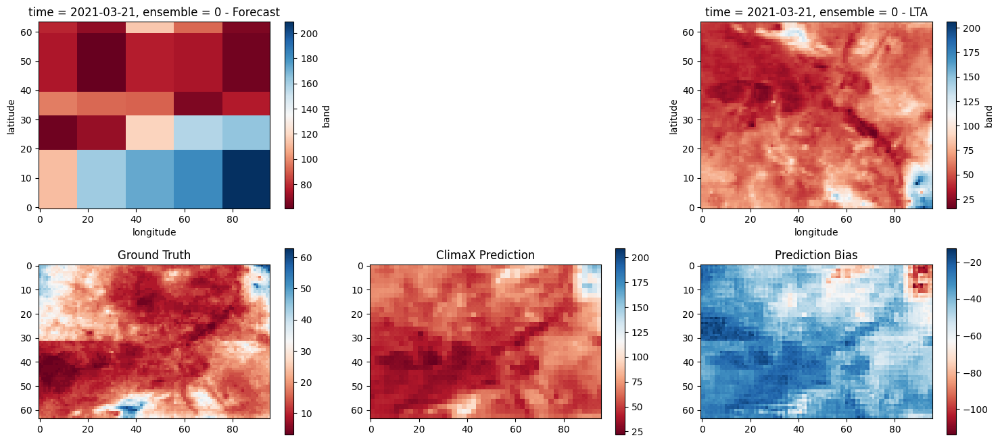

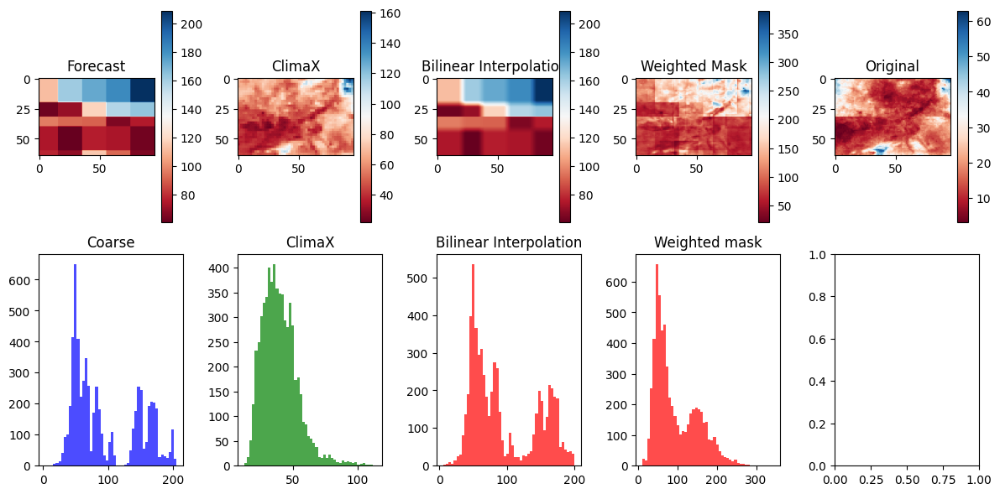

Selected device: cpu
+----------------------+-----------------------+-------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX            | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-------------------+------------------------+----------------------+
| lat_weighted_mse_val | 11776.827876835503    | 1800.991565971138 | 11530.625860320224     | 12198.445377793343   |
| lat_weighted_rmse    | 108.52109415609254    | 42.4380909793447  | 107.38075181483981     | 110.44657250360169   |
| spearman             | -0.11140968727222049  | 0.607171166749022 | -0.1850534872437259    | 0.034686168619023655 |
| mean_bias            | 95.8784188538169      | 40.01288303080946 | 95.30070833458255      | 95.95195094340792    |
| pearson              | -0.035994084827231675 | 0.648882218403774 | -0.0792964591874899    | 0.10128788443662273  |
+----------------------+-------------------

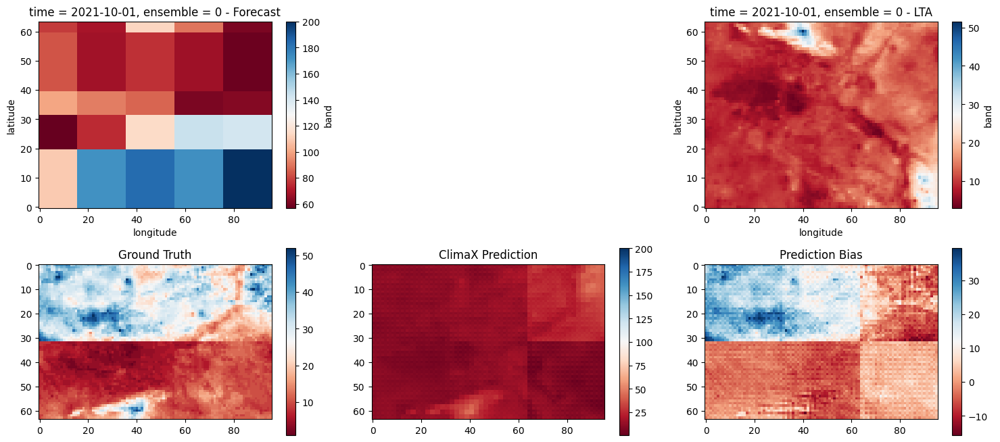

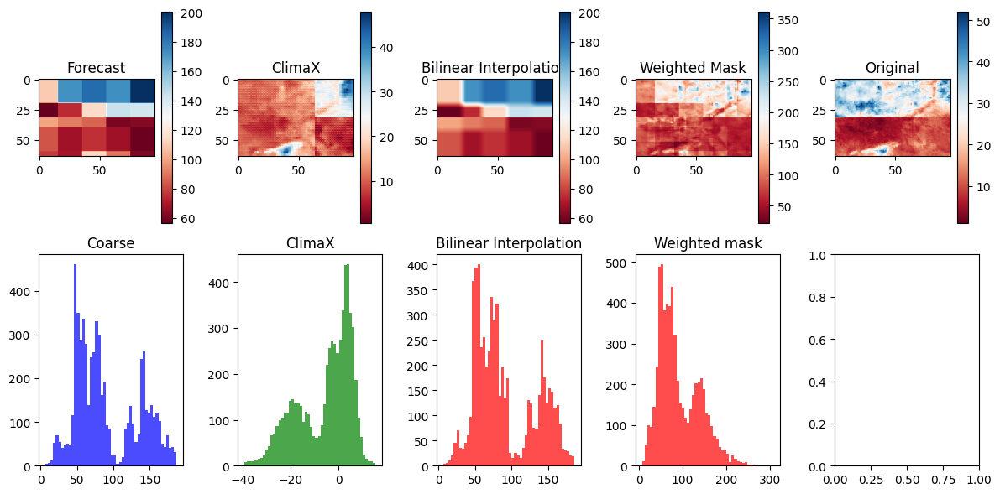

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 10147.631825429535  | 158.96312427968036  | 9966.317282982369      | 10512.784228268063 |
| lat_weighted_rmse    | 100.73545465936775  | 12.60805791070458   | 99.83144435989279      | 102.5318693298238  |
| spearman             | 0.47432238821182193 | 0.46864725970397547 | 0.47287366279774296    | 0.5728114153918719 |
| mean_bias            | 90.96282057898739   | -5.627796312173208  | 90.64910244879623      | 91.0242422039931   |
| pearson              | 0.5632325670984226  | 0.4213408659072855  | 0.5568883408086505     | 0.6145066422372504 |
+----------------------+---------------------+-------------

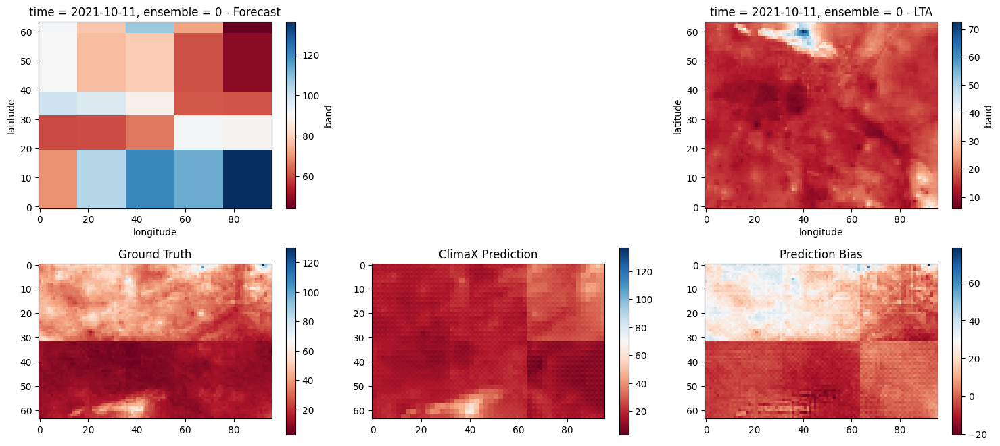

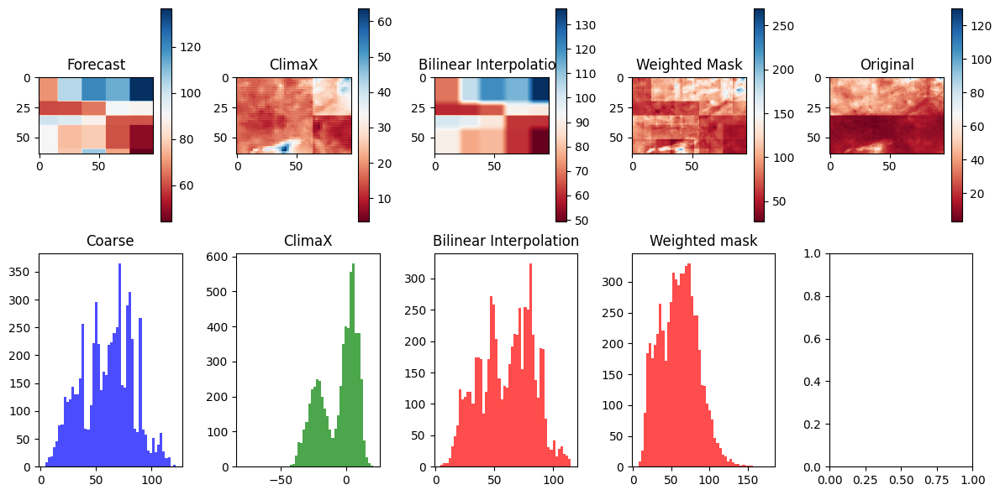

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4145.565307415112  | 237.6882714519327  | 4166.499677111489      | 4226.442947214096   |
| lat_weighted_rmse    | 64.38606454361931  | 15.417142129847955 | 64.54842892829762      | 65.0110986464165    |
| spearman             | 0.2983458783344313 | 0.4107150466696376 | 0.2595308440267154     | 0.3662353141925331  |
| mean_bias            | 60.04603066698958  | -6.191670463110011 | 60.425530965439975     | 60.0756194818144    |
| pearson              | 0.3955756667407114 | 0.4172732860852434 | 0.3568032846401922     | 0.47749332893904906 |
+----------------------+--------------------+--------------------+-

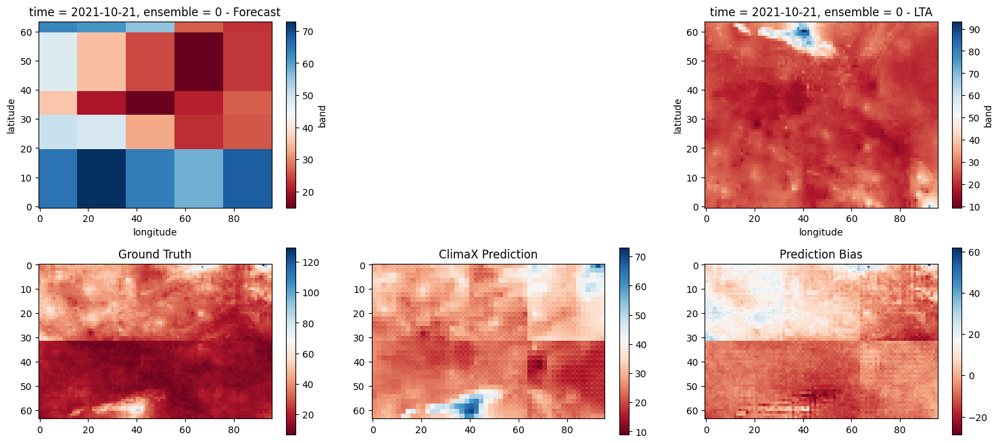

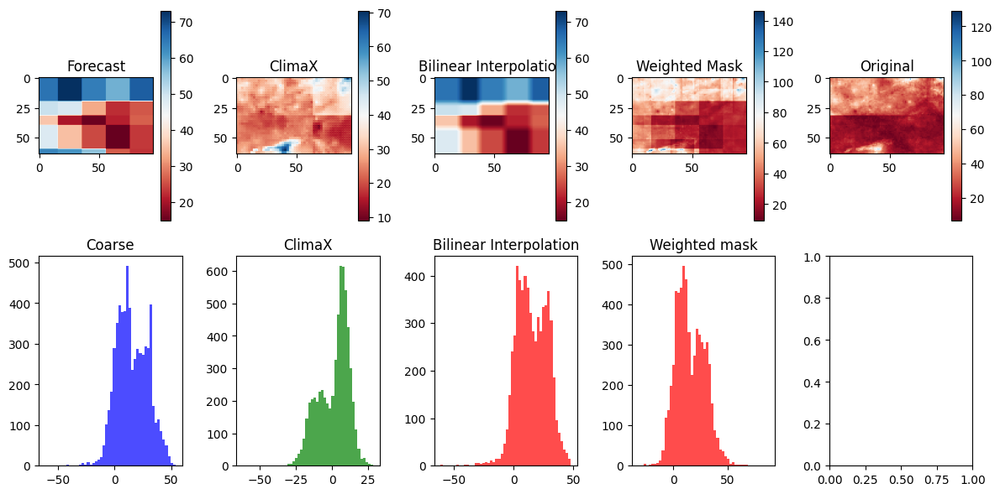

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 433.7336414745544  | 111.58943416979537 | 401.75744517103766     | 426.43964363091254 |
| lat_weighted_rmse    | 20.82627286565108  | 10.563590022799795 | 20.043887975416286     | 20.65041509585007  |
| spearman             | 0.7202375300599142 | 0.6633697986778005 | 0.7557122612877959     | 0.768456695935925  |
| mean_bias            | 15.639339714621507 | 1.5147245315213986 | 15.271802976572268     | 15.712255744729191 |
| pearson              | 0.7093834386426556 | 0.6285546448903401 | 0.7324628122921293     | 0.7703095356442767 |
+----------------------+--------------------+--------------------+---------

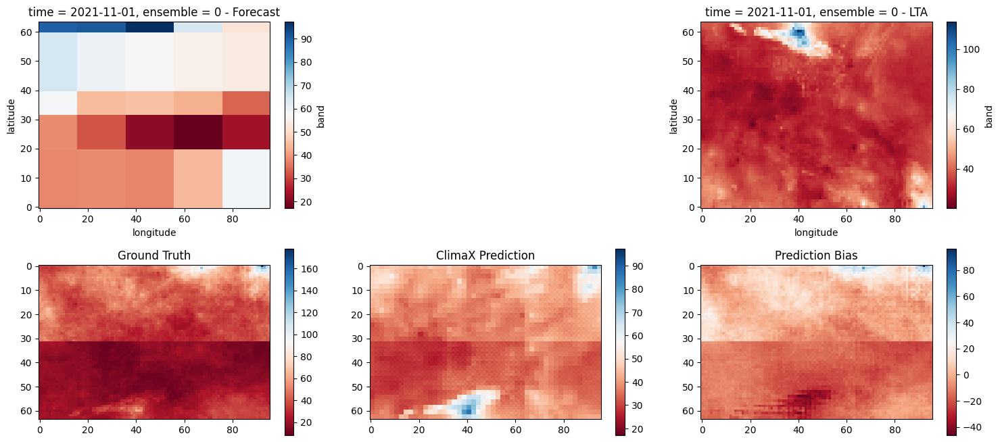

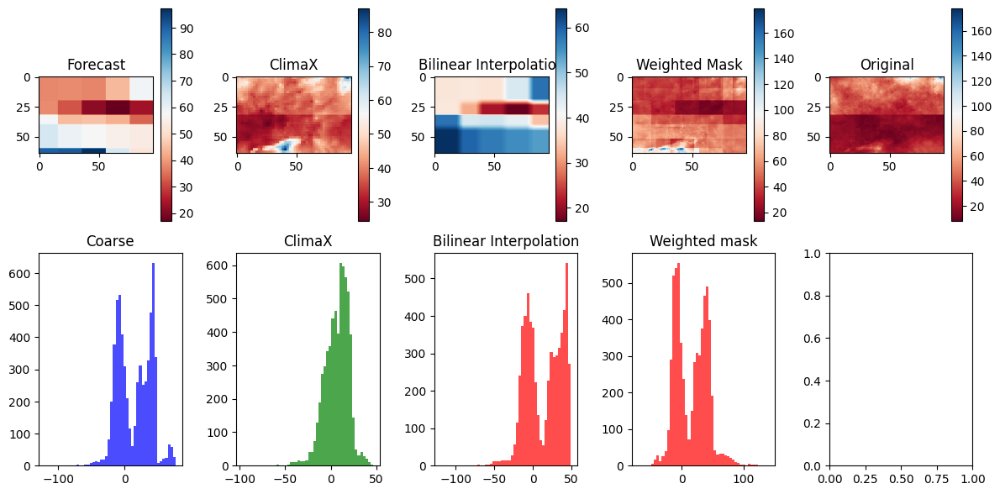

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 891.016981668089    | 217.57212690770132 | 739.1535691478372      | 910.5463503166852    |
| lat_weighted_rmse    | 29.849907565486514  | 14.75032633224436  | 27.187378857621365     | 30.17526056750273    |
| spearman             | -0.360875767509155  | 0.7016082734515233 | -0.37701713449182567   | -0.31165967858024785 |
| mean_bias            | 15.434909737668931  | 6.760462384981416  | 14.08833107445389      | 15.514587115185954   |
| pearson              | -0.2592214472817532 | 0.6305329809386349 | -0.28809756368241746   | -0.1587693506833316  |
+----------------------+---------------------+-----

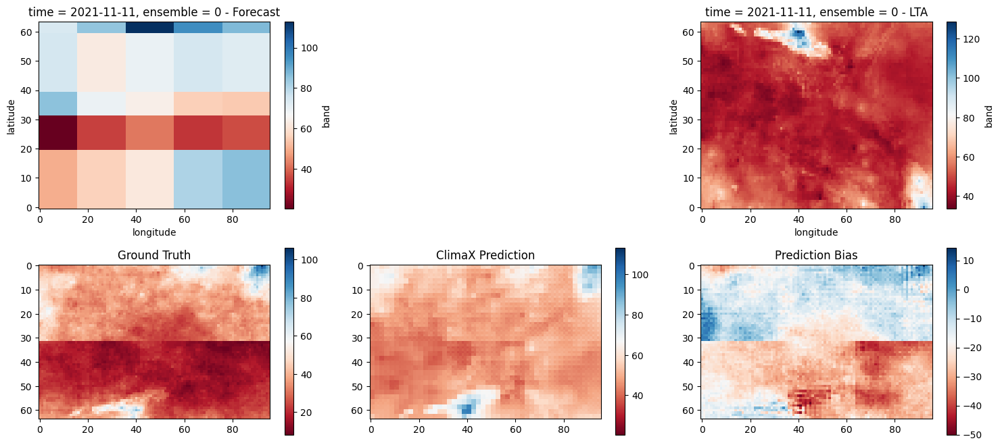

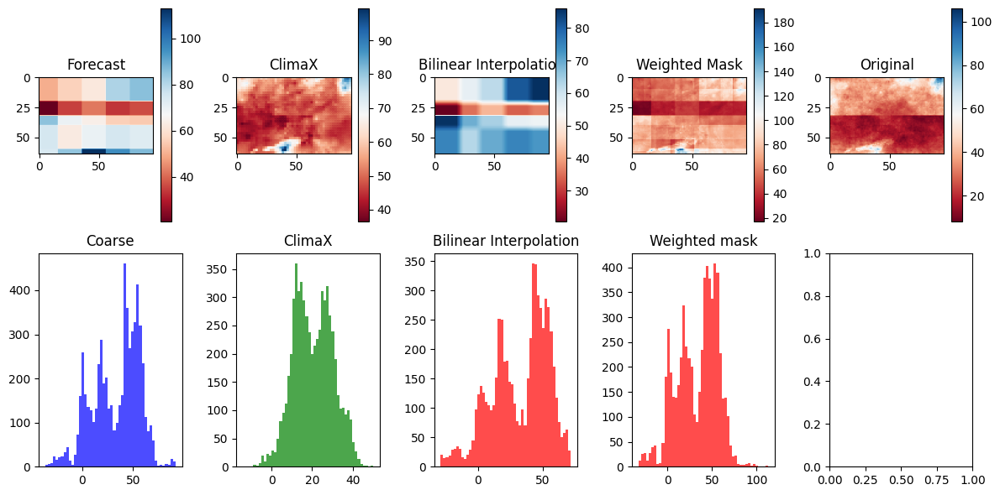

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 1645.323131393612     | 511.8125013479171  | 1519.2092297747452     | 1653.3390576503873    |
| lat_weighted_rmse    | 40.5625828984498      | 22.623273444572895 | 38.97703464573396      | 40.661272208950706    |
| spearman             | -0.07818583282325743  | 0.5856188665581994 | -0.12413808622340654   | -0.050977933527133354 |
| mean_bias            | 33.597895228614405    | 20.507392208402354 | 32.631740142901734     | 33.64218556974083     |
| pearson              | -0.042240765015735024 | 0.6737171792720662 | -0.08581245010838906   | 0.051306246490470664  |
+----------------------+---

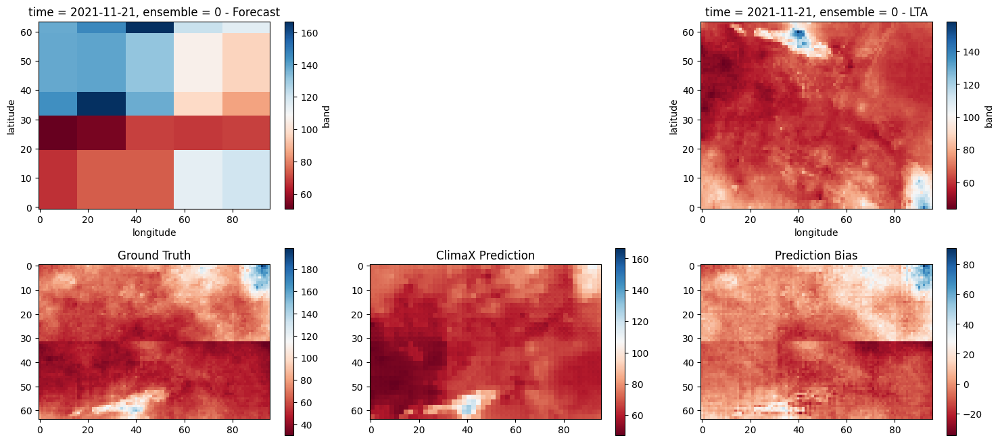

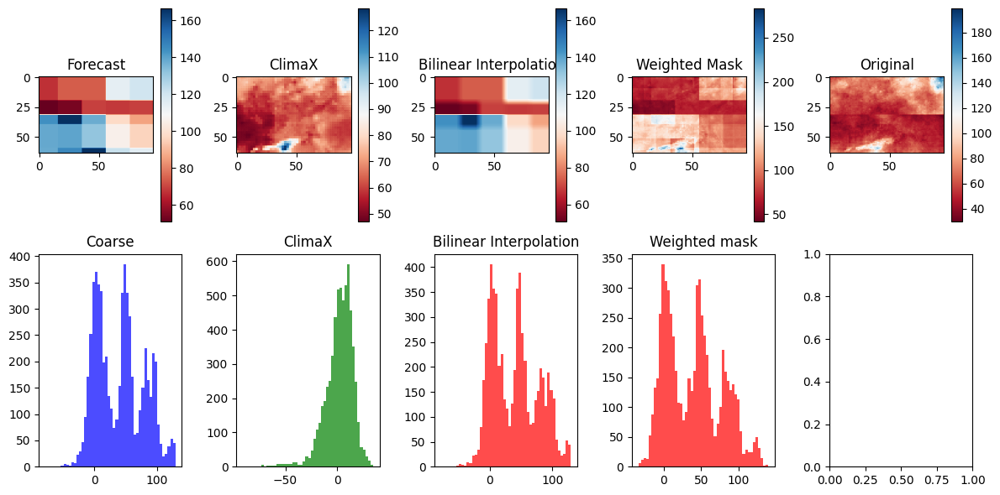

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 3000.4971867466697    | 182.28064020758598 | 2958.1946118636865     | 2986.9980021551855   |
| lat_weighted_rmse    | 54.7767942357589      | 13.501134774810078 | 54.38928765725551      | 54.65343541036726    |
| spearman             | -0.175919667945541    | 0.6558402664228132 | -0.21216845355997552   | -0.10995225665231423 |
| mean_bias            | 40.202425737554826    | 2.2342802093674763 | 39.82517888272802      | 40.23822791626056    |
| pearson              | -0.014807442914858334 | 0.7703441438242513 | -0.053390797681273     | 0.08529650453206727  |
+----------------------+-----------

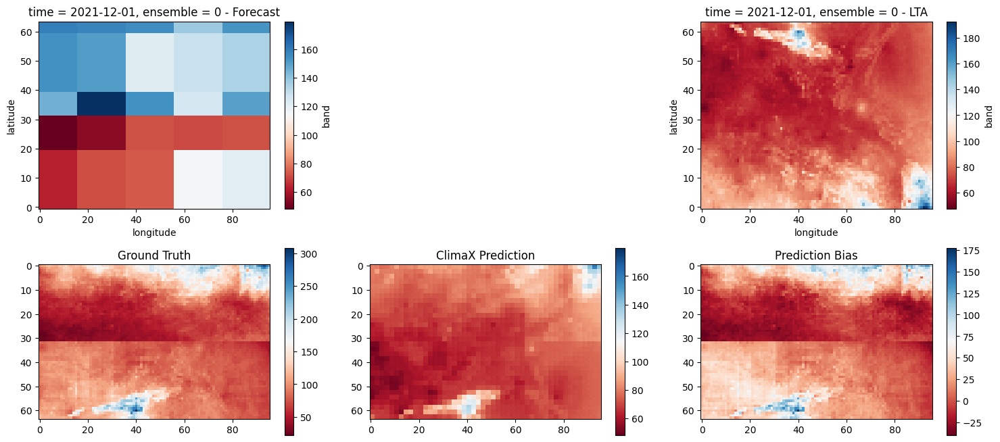

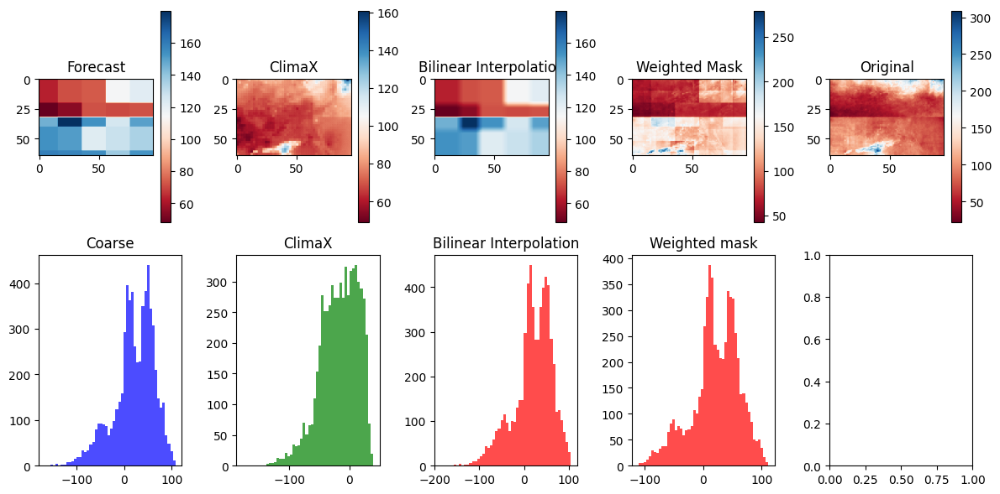

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2202.3133973995805  | 1255.547386419575   | 2200.395170953316      | 2061.3952399918985  |
| lat_weighted_rmse    | 46.92881201777412   | 35.43370410244426   | 46.9083699456005       | 45.4025906748932    |
| spearman             | 0.43568570176423455 | 0.24450876285714596 | 0.40741971818178496    | 0.48286525773393296 |
| mean_bias            | 21.027880517145007  | -16.497903145849705 | 20.204900940259307     | 21.014737458899617  |
| pearson              | 0.3538260350647411  | 0.588156699950781   | 0.3289138769960038     | 0.4307907781721887  |
+----------------------+---------------------+-----

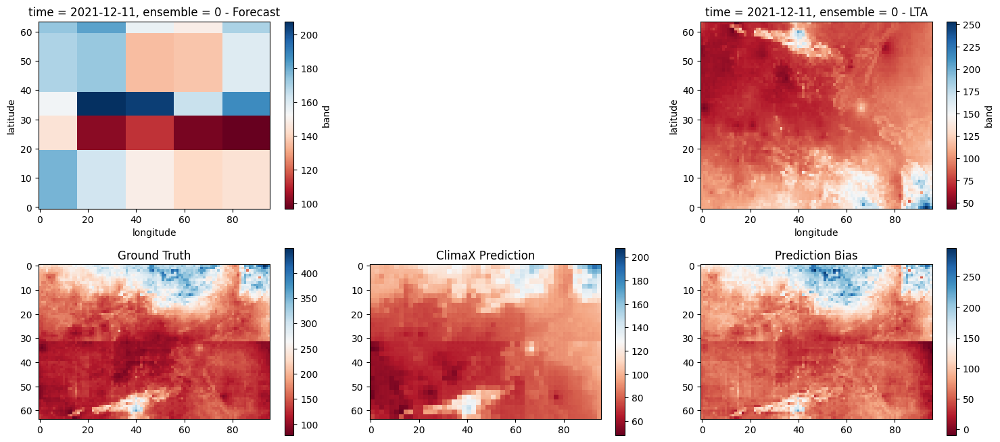


KeyboardInterrupt



In [26]:
for member in range(gt_xarray.shape[1]):
    for t in range(gt_xarray.shape[0]):
        visualize_climax(forecast_xarray, lta_xarray, gt_xarray, pred_xarray, bilinear_xarray, weighted_xarray, t, member)
        compare_results(gt_xarray, forecast_xarray, pred_xarray, bilinear_xarray, weighted_xarray, lat,t,member,denormalize_out)


## check data

We are interseted only in rain months, so we took 6 months between october and March

In [20]:
Rfh_lta = xr.open_dataset("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data/r1h_lta.nc")
R1h = xr.open_dataset("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data/r1h.nc")
r1h_lta = np.load("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data_npz/test/2021_00_inp.npz")['rfh_lta']

In [ ]:

for i in range(len(Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).time)):
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))
    im0 = axs[0].imshow((Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).isel(time=i).band- Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).isel(time=0).band))
    axs[0].set_title(f"Time Step {i}")
    cbar0 = plt.colorbar(im0, ax=axs[0])

    
    im1 = axs[1].imshow(r1h_lta[i,0] - r1h_lta[0,0])
    cbar1 = plt.colorbar(im1, ax=axs[1])

    plt.show()

## seasonality

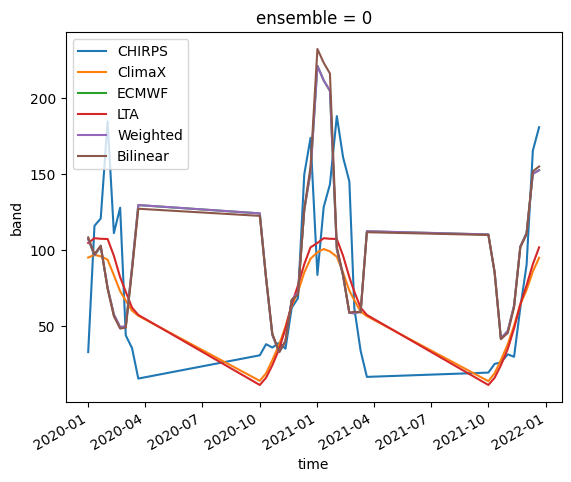

In [27]:

# gt_xarray.isel(ensemble=1,latitude=0,longitude=0).plot.line(label="CHIRPS")
(gt_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="CHIRPS")
(pred_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ClimaX")
(forecast_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ECMWF",)
(lta_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="LTA")
(weighted_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Weighted")
(bilinear_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Bilinear")
# LTA_xarray.isel(ensemble=0,latitude=0,longitude=0).plot.line(label="LTA")
plt.legend()


## Influence of forecast

In [69]:
# Check if GPU is available
if torch.cuda.is_available():
    device = torch.device('cuda:0')
else:
    device = torch.device('cpu')



model.eval()

if torch.cuda.is_available():
     model.cuda()
else:
     model.cpu()


dataloader = datamodule.test_dataloader()

In [83]:
for batch_idx, batch_data in enumerate(dataloader, 1):
    if batch_idx == 2:
        # Process the nth batch (e.g., 10th batch)
        x, y, lead_times, in_vars, out_vars = batch_data

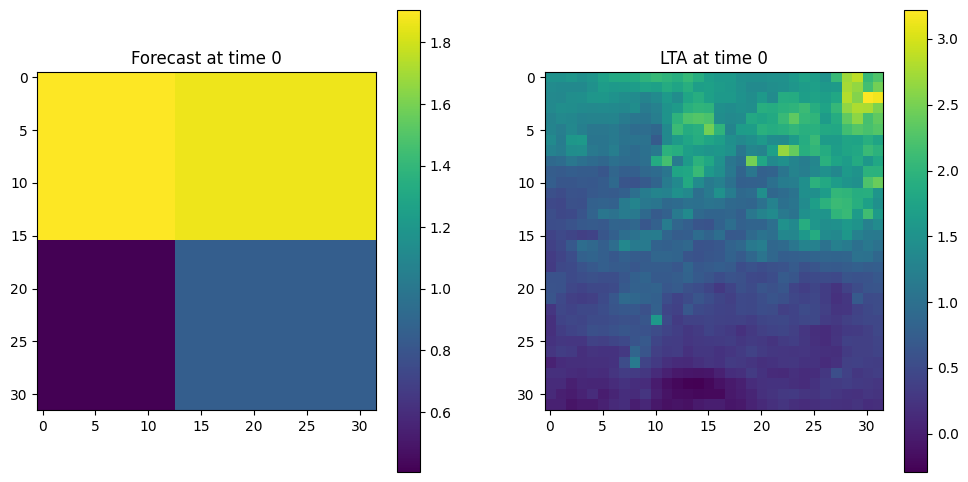

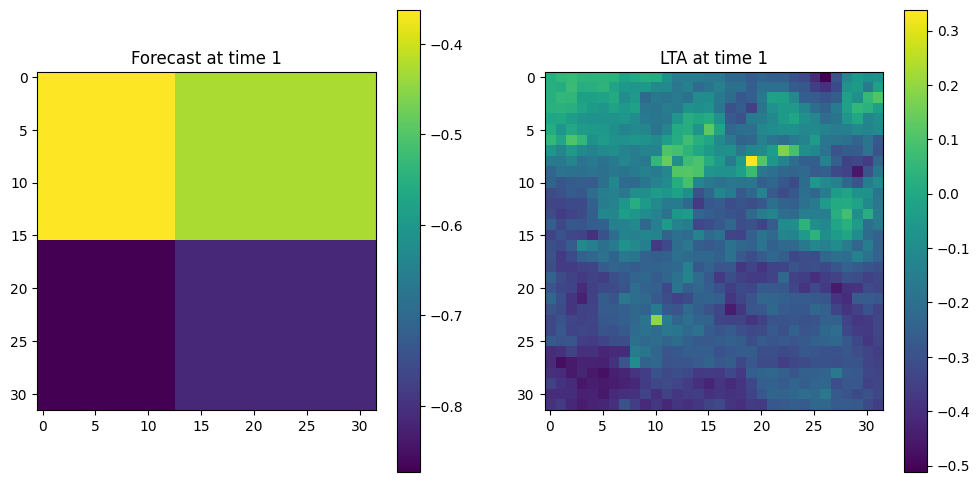

In [88]:
forecast_0 = x[0,0]
lta_0 = x[0,1]


fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

im1 = ax1.imshow(forecast_0)
ax1.set_title('Forecast at time 0')

ax1.grid(False)  # Optional: Turn off grid lines

# Display the second image (lta_0) in the second subplot (ax2)
im2 = ax2.imshow(lta_0)
ax2.set_title('LTA at time 0')

ax2.grid(False)  # Optional: Turn off grid lines


# Add colorbars for both images
cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)

plt.show()

forecast_1 = x[50,0]
lta_1 = x[50,1]

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Display the first image (forecast_0) in the first subplot (ax1)
im1 = ax1.imshow(forecast_1)
ax1.set_title('Forecast at time 1')

ax1.grid(False)  # Optional: Turn off grid lines

# Display the second image (lta_0) in the second subplot (ax2)
im2 = ax2.imshow(lta_1)
ax2.set_title('LTA at time 1')

ax2.grid(False)  # Optional: Turn off grid lines


# Add colorbars for both images
cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)

plt.show()


prediction


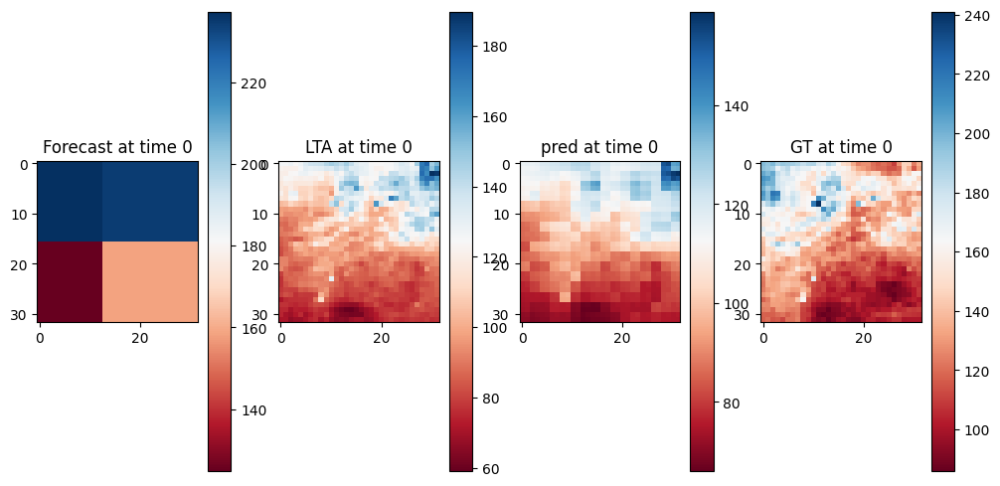

In [138]:
forecast_0 = x[0,0]
lta_0 = x[0,1]

gt_0,pred_0,tensors_0= downscale(forecast_0, lta_0, y = y[:1])

fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(12, 6))

im1 = ax1.imshow(tensors_0[0][0],  cmap=plt.cm.RdBu)
ax1.set_title('Forecast at time 0')

im2 = ax2.imshow(tensors_0[1][0],  cmap=plt.cm.RdBu)
ax2.set_title('LTA at time 0')


im3 = ax3.imshow(pred_0[0,0],  cmap=plt.cm.RdBu)
ax3.set_title('pred at time 0')

im4 = ax4.imshow(gt_0[0,0],  cmap=plt.cm.RdBu)
ax4.set_title('GT at time 0')

cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)
cbar2 = fig.colorbar(im3, ax=ax3)
cbar2 = fig.colorbar(im4, ax=ax4)

plt.show()

prediction


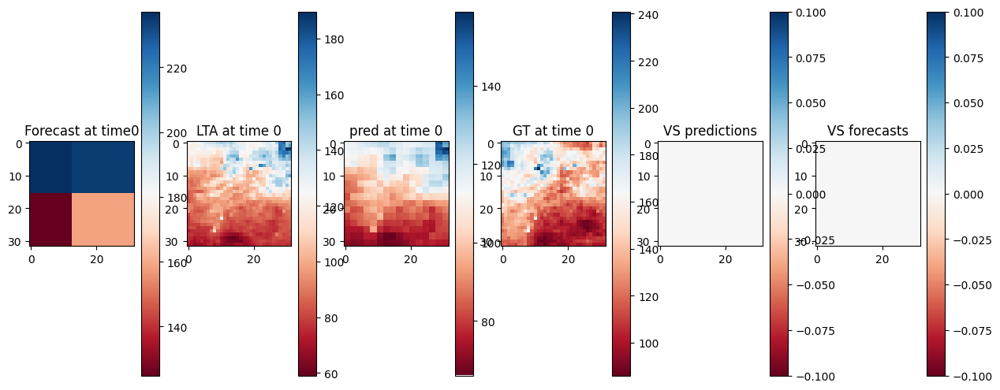

prediction


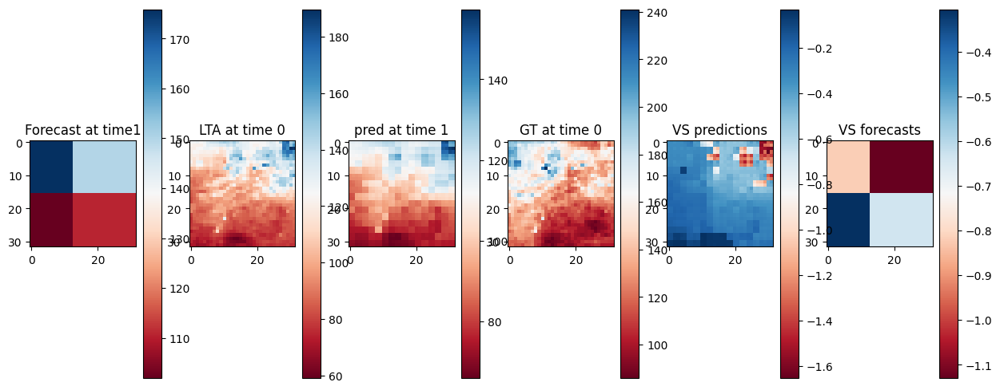

prediction


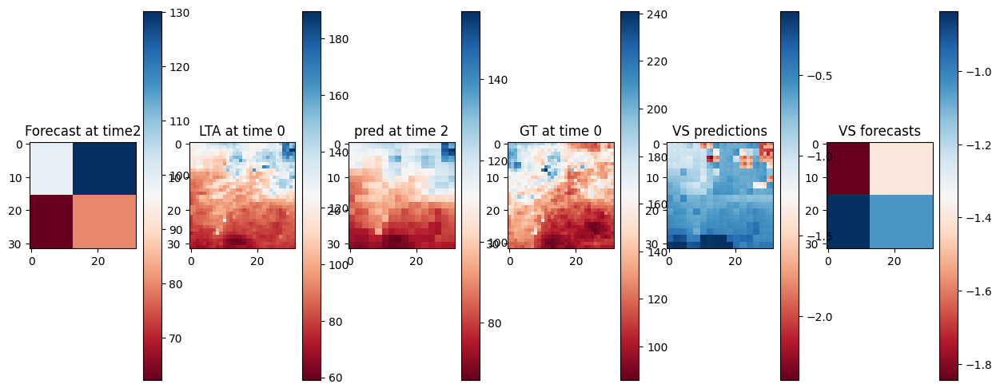

prediction


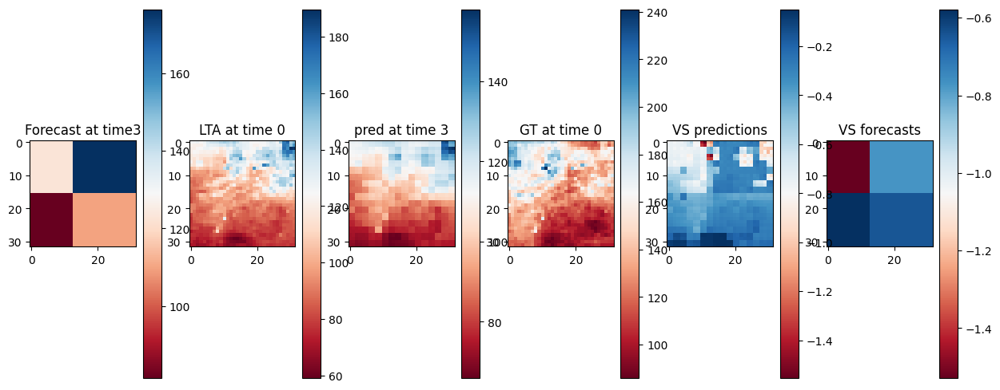

prediction


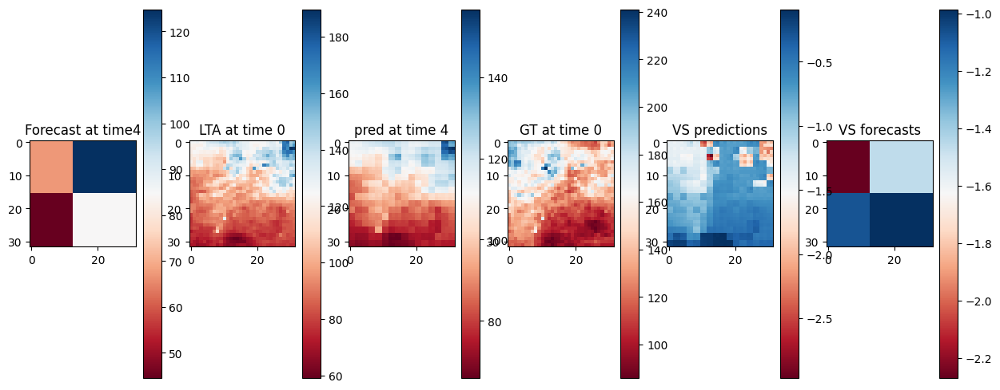

prediction


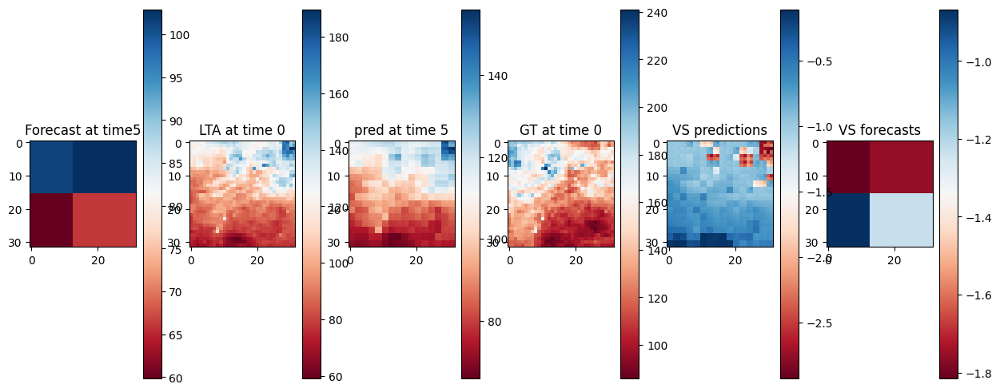

prediction


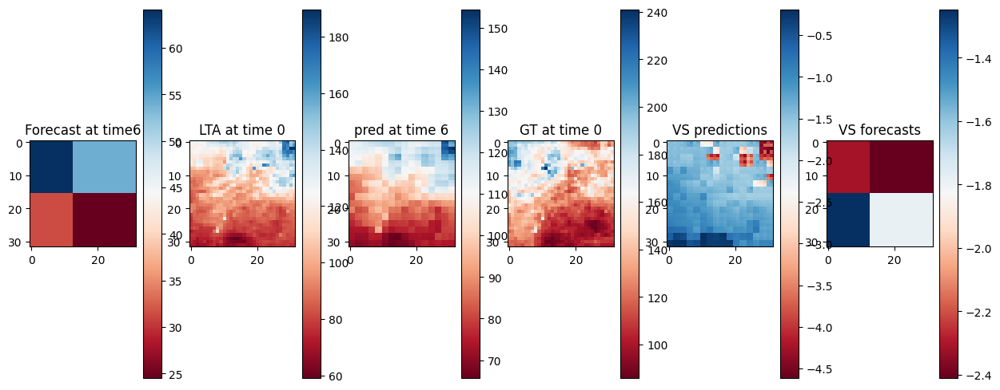

prediction


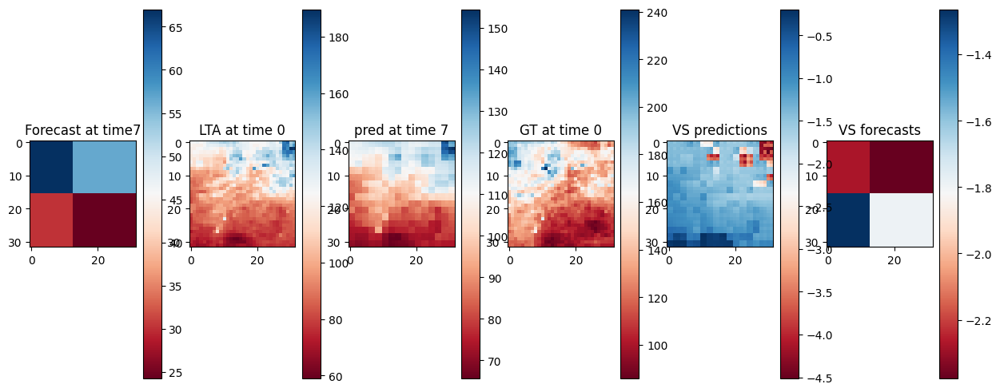

prediction


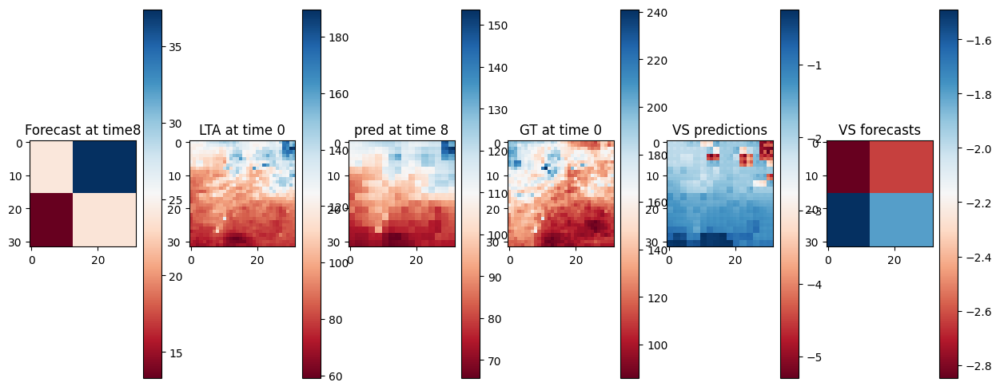

prediction


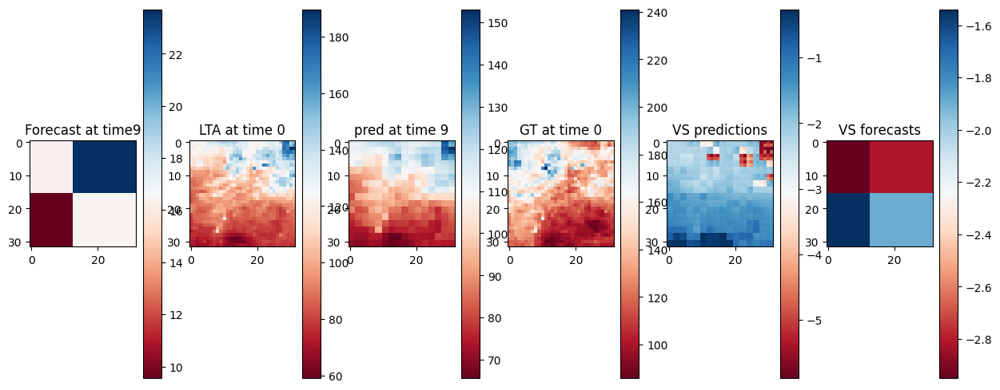

prediction


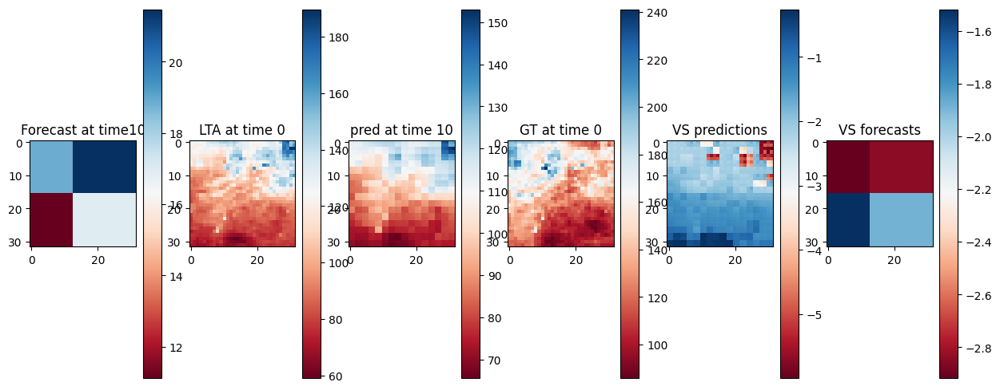

prediction


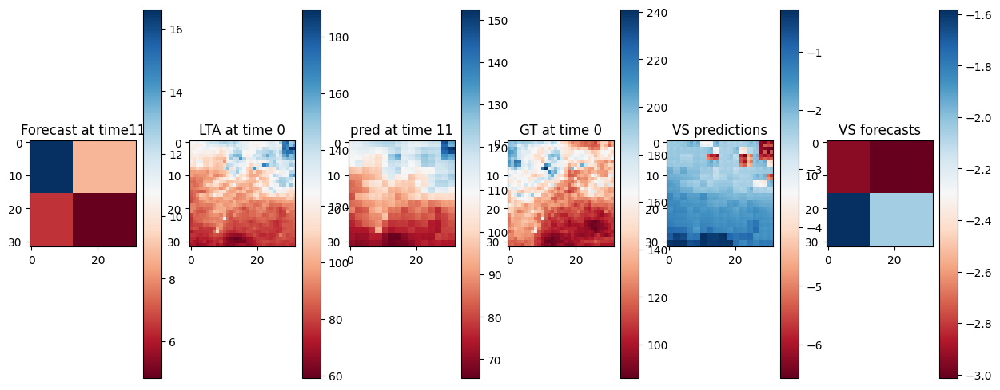

prediction


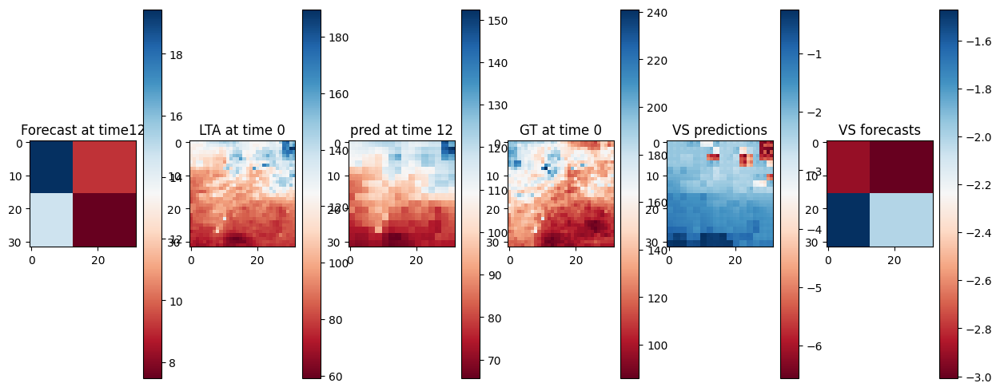

prediction


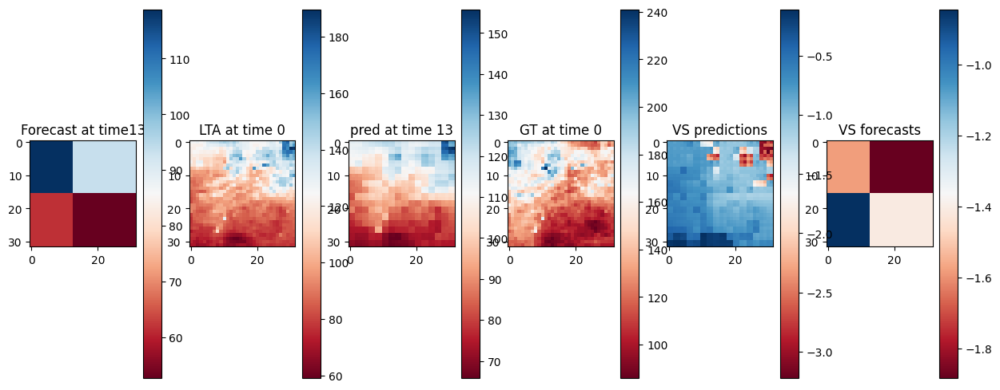

prediction


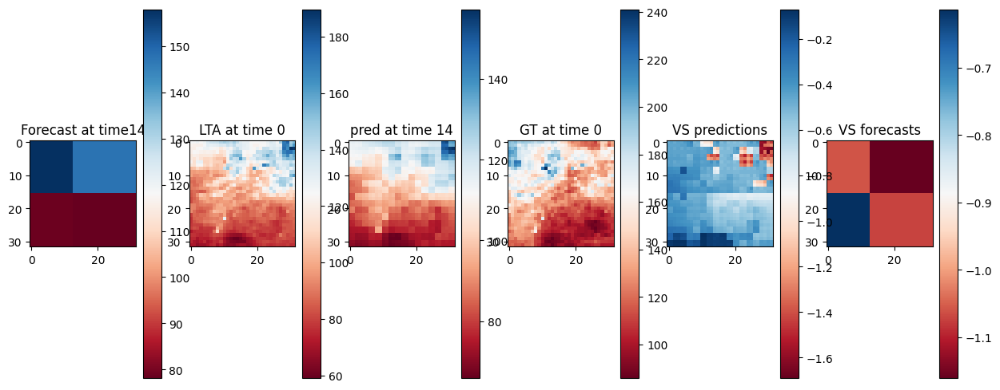

prediction


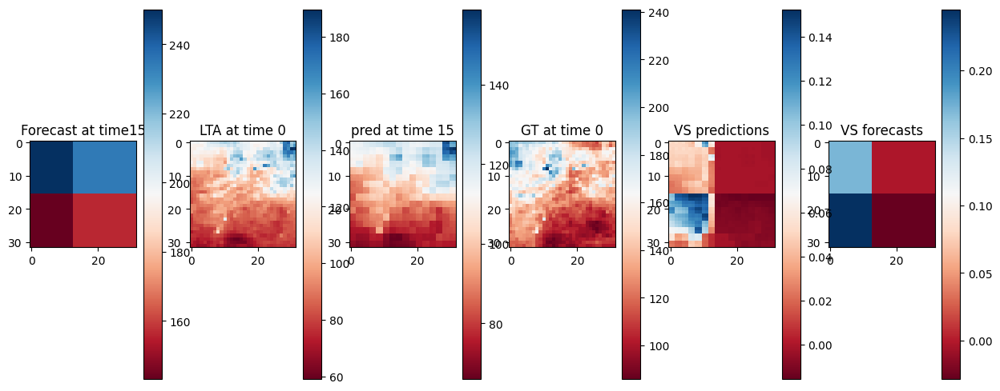

prediction


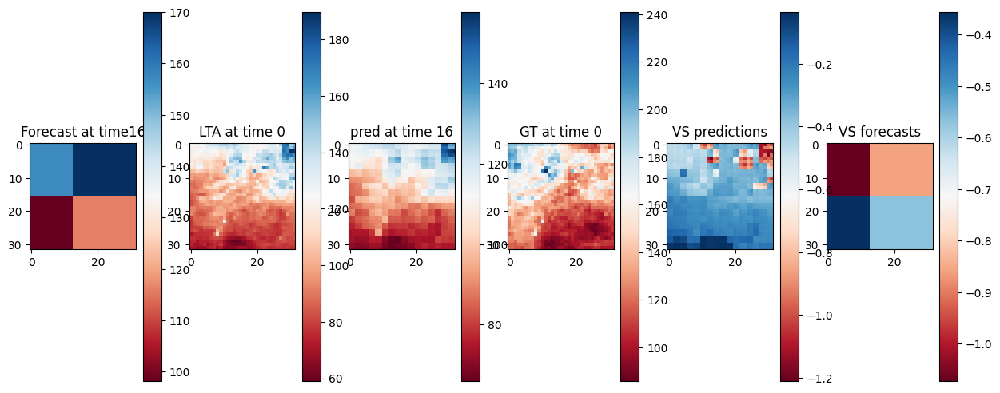

prediction


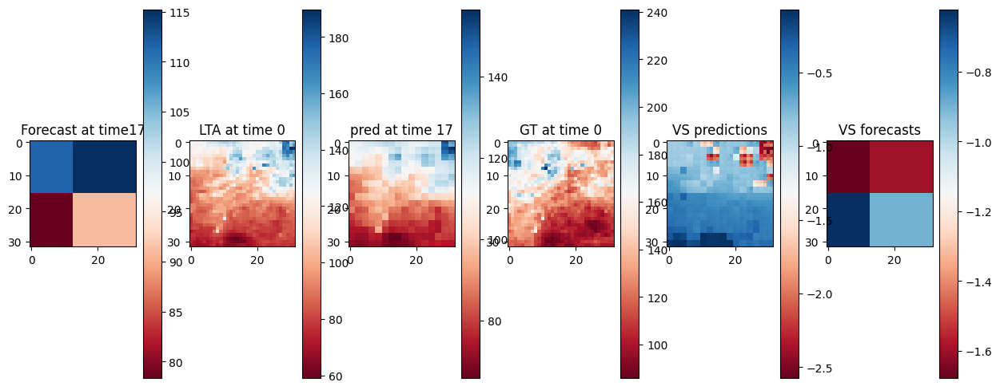

prediction


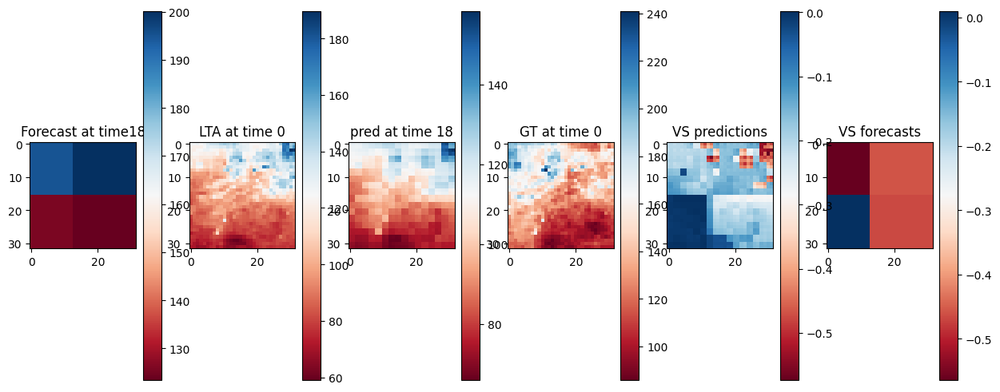

prediction


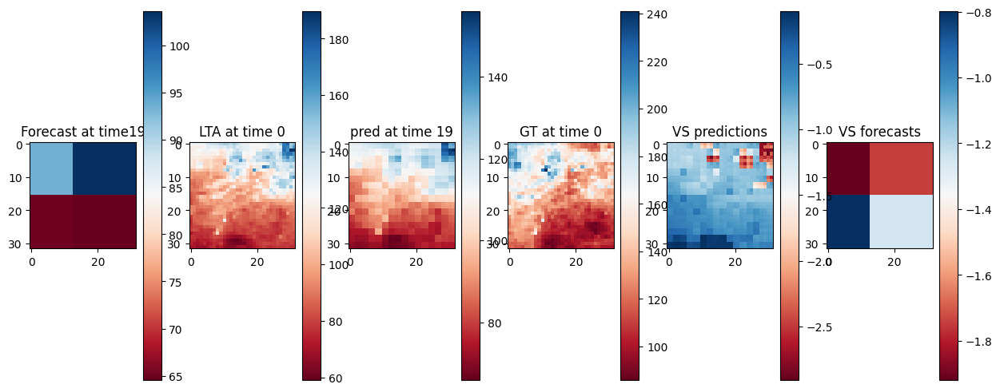

prediction


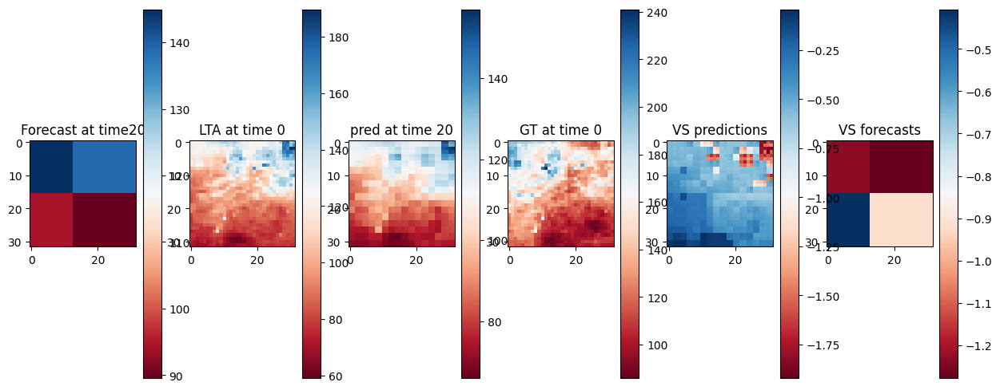

prediction


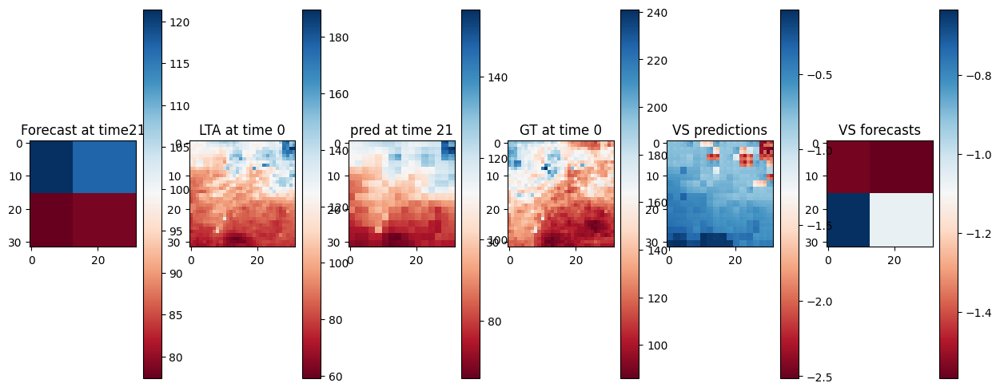

prediction


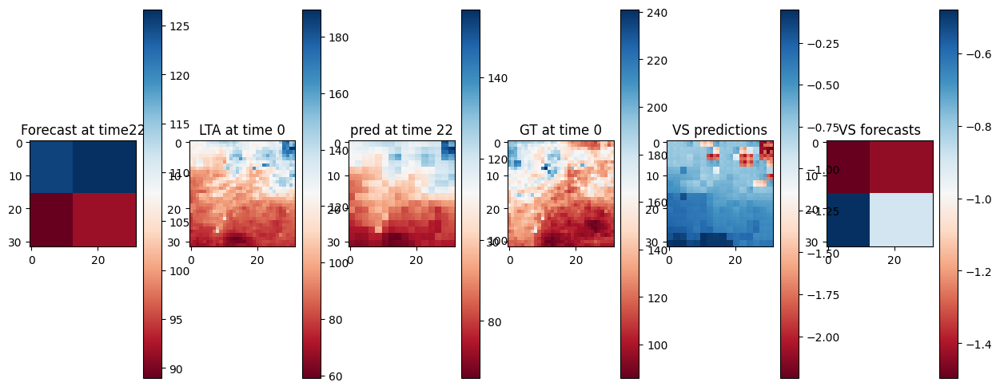

prediction


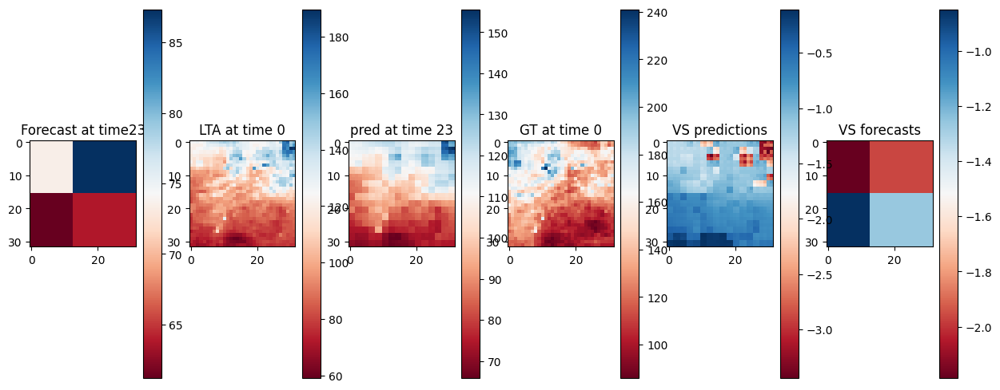

prediction


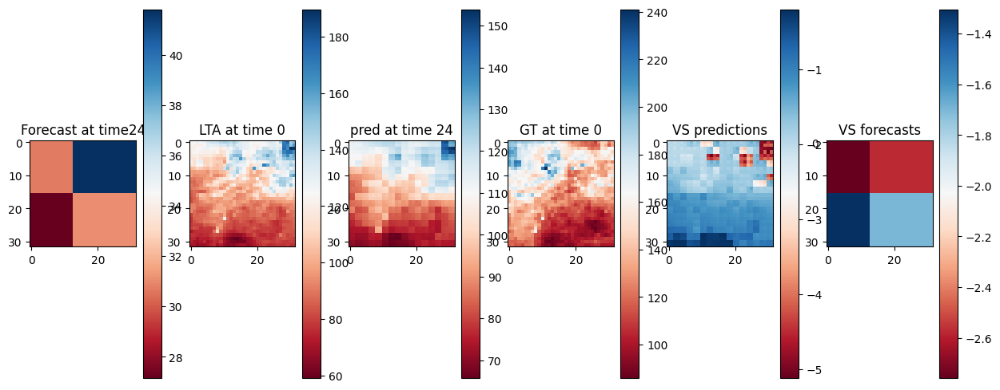

prediction


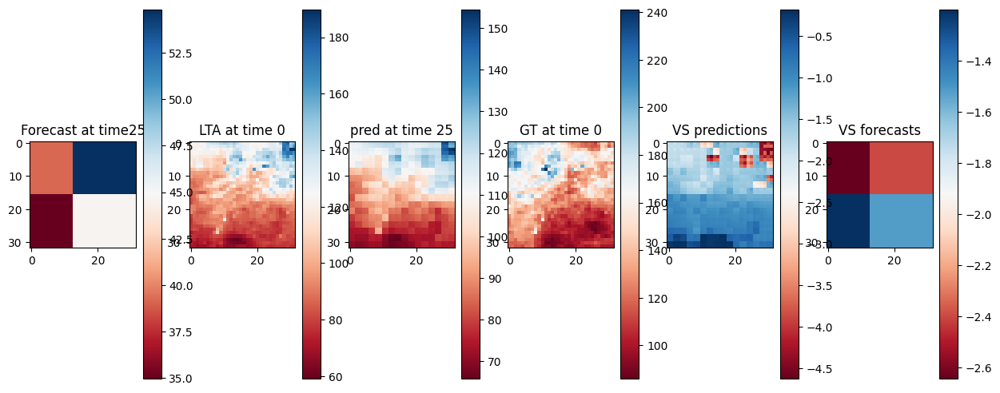

prediction


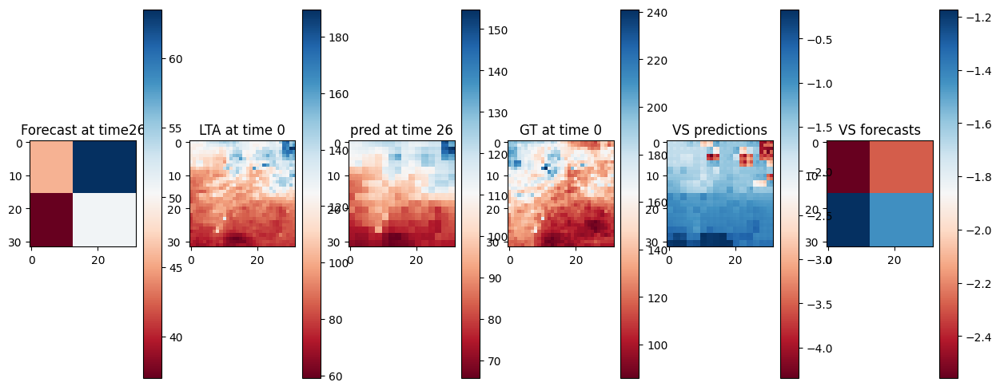

prediction


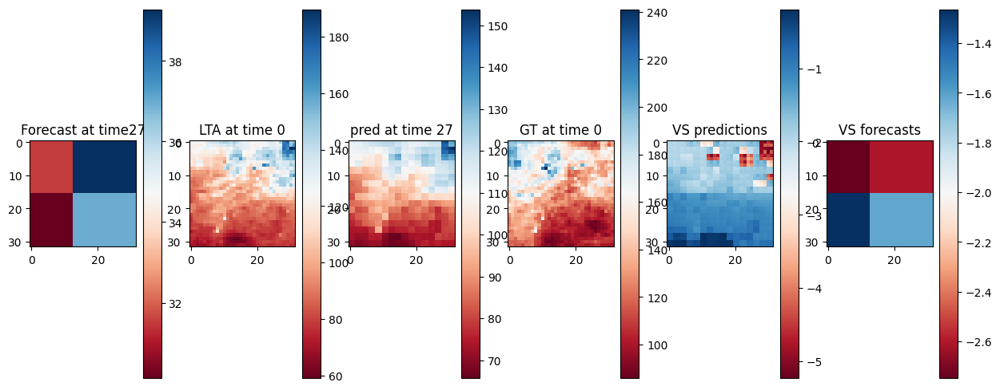

prediction


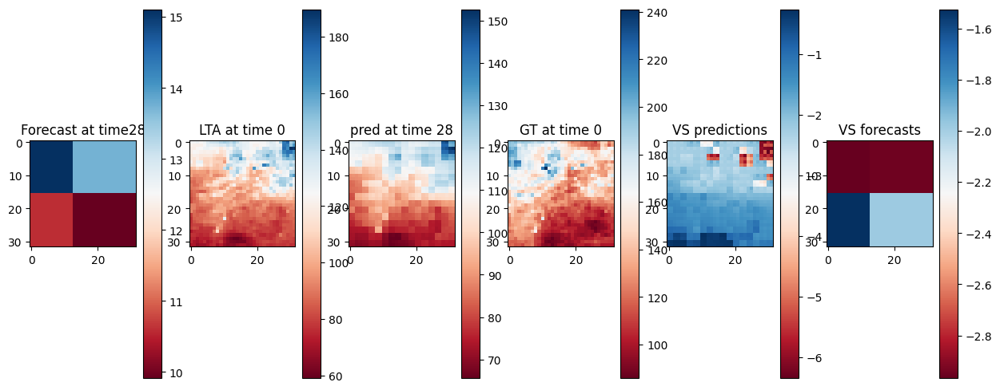

prediction


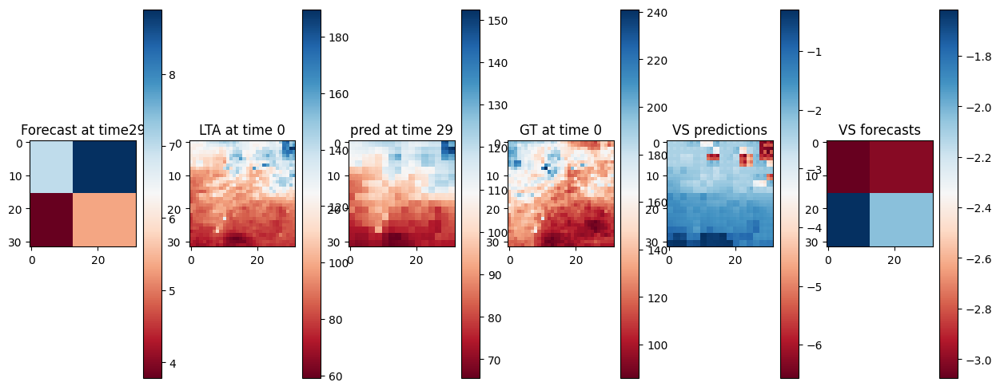

In [145]:
for t in range(30):
    
    forecast_1 = x[t,0]
    lta_0 = x[0,1]

    gt_1,pred_1,tensors_1= downscale(forecast_1, lta_0, y = y[:1])

    fig, (ax1, ax2, ax3, ax4,ax5, ax6) = plt.subplots(1, 6, figsize=(15, 6))

    im1 = ax1.imshow(tensors_1[0][0],  cmap=plt.cm.RdBu)
    ax1.set_title(f'Forecast at time{t}')

    im2 = ax2.imshow(tensors_1[1][0],  cmap=plt.cm.RdBu)
    ax2.set_title('LTA at time 0')


    im3 = ax3.imshow(pred_1[0,0],  cmap=plt.cm.RdBu)
    ax3.set_title(f'pred at time {t}')

    im4 = ax4.imshow(gt_1[0,0],  cmap=plt.cm.RdBu)
    ax4.set_title('GT at time 0')

    im5 = ax5.imshow(pred_1[0,0] - pred_0[0,0],  cmap=plt.cm.RdBu)
    ax5.set_title('VS predictions')
    
    im6 = ax6.imshow(forecast_1  - forecast_0 ,  cmap=plt.cm.RdBu)
    ax6.set_title('VS forecasts')

    cbar1 = fig.colorbar(im1, ax=ax1)
    cbar2 = fig.colorbar(im2, ax=ax2)
    cbar3 = fig.colorbar(im3, ax=ax3)
    cbar4 = fig.colorbar(im4, ax=ax4)
    cbar5 = fig.colorbar(im5, ax=ax5)
    cbar6 = fig.colorbar(im6, ax=ax6)

    plt.show()

In [129]:
def downscale(forecast, lta, y,lead_times = lead_times, in_vars=in_vars, ou_vars=out_vars, model_module = model, data_module = datamodule,mean_norm=mean_norm, std_norm=std_norm, pred_task=pred_range, var_name="R1H", var_id=1,data_path=None, save_path = None, desired_batch_index = 25):
    
    x = torch.stack([forecast, lta], dim=0).unsqueeze(0)
    lead_times = lead_times[:1]
            
    
    if torch.cuda.is_available():
        lead_times = lead_times.cuda()
    else:
        lead_times = lead_times.cpu()
      
    if torch.cuda.is_available():
        x = x.cuda()
        y = y.cuda()
    else:
        x = x.cpu()
        y = y.cpu()
        
    print("prediction")
    
    with torch.no_grad():
        _, pred = model_module.net.forward(x, y, lead_times, in_vars, out_vars, None, model_module.lat)
        
    
    
    inv_normalize = model_module.denormalization
    
    
    tensors=[]
    for i in range(x.shape[1]):
        tensors.append(inv_normalize(x)[:,i])
    init_condition = inv_normalize(x)[:,0]

    
    normalization = data_module.output_transforms
    mean_norm, std_norm = normalization.mean, normalization.std
    x = x[:, var_id,:]
    gt = y * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    pred = pred * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    bias = pred - gt
    tensors_pred = [init_condition, gt, pred, bias]
    

    
        
    del x
    del y
    return gt,pred,tensors

## variability between members

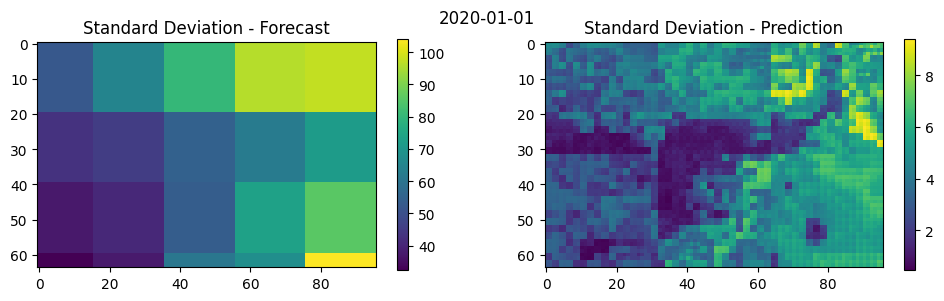

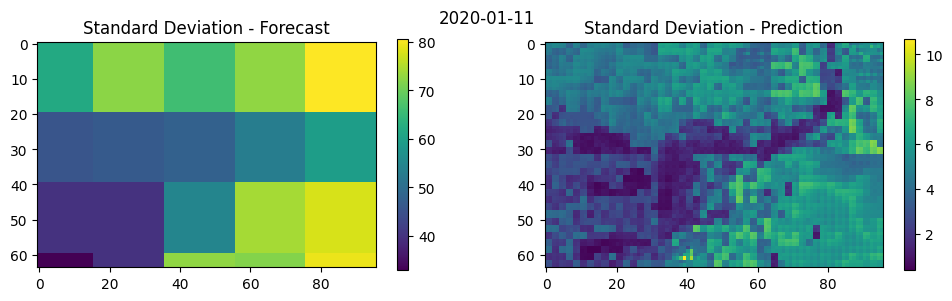

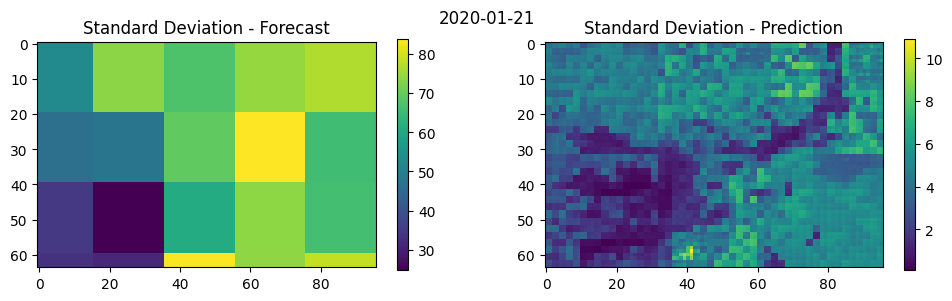

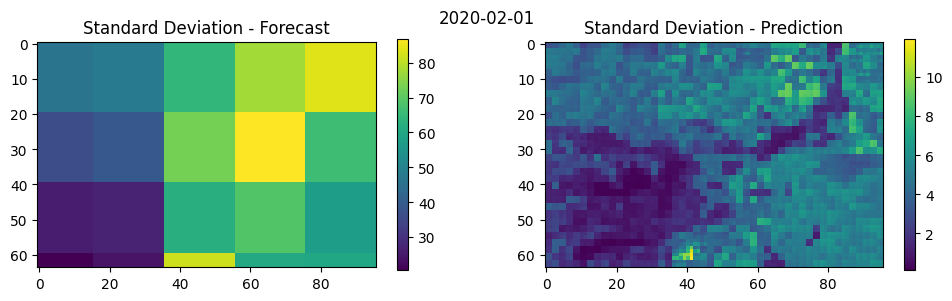

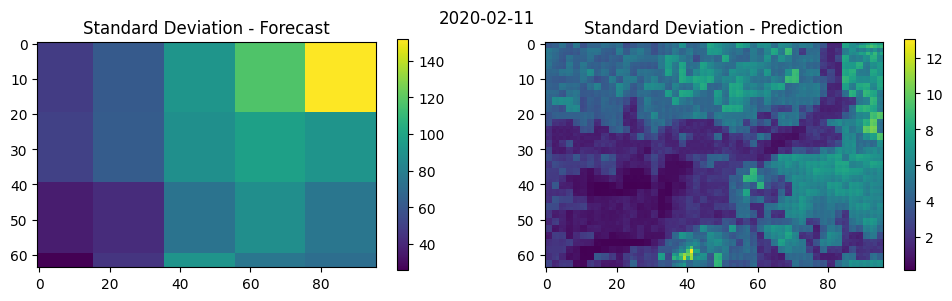

...

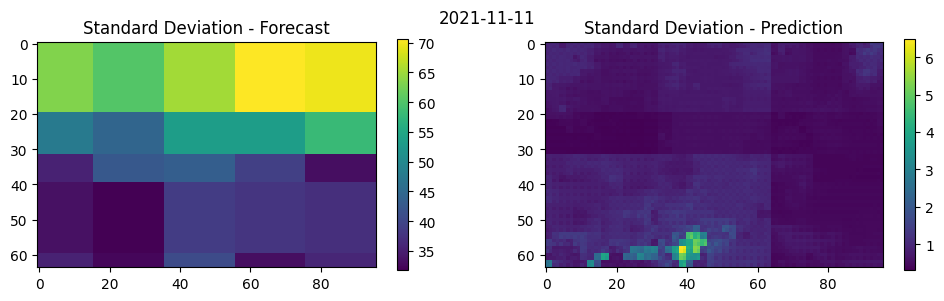

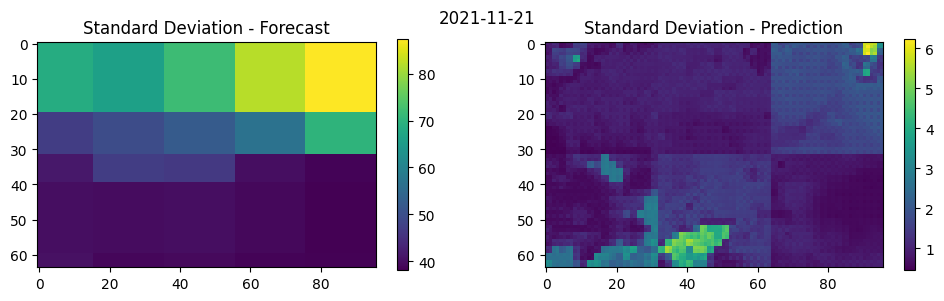

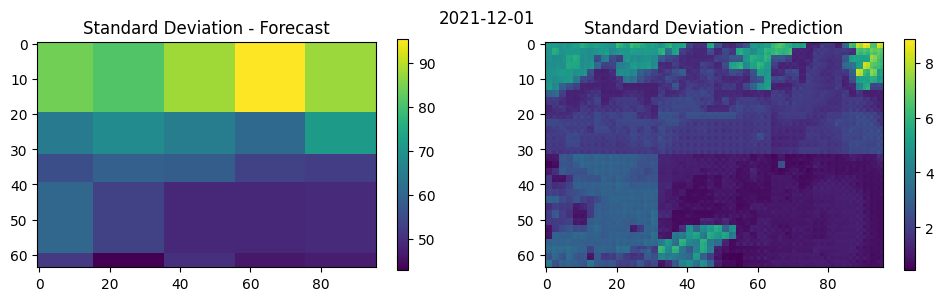

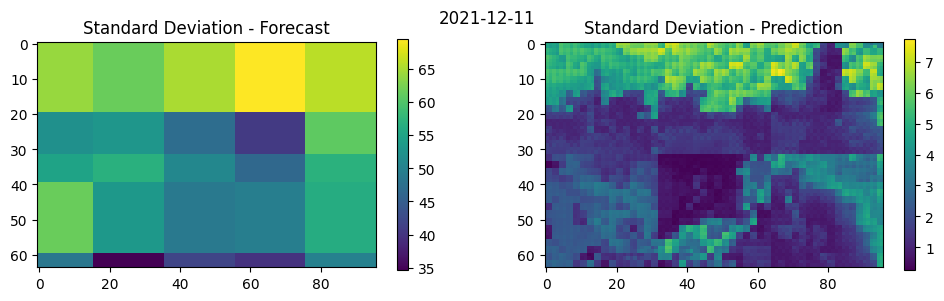

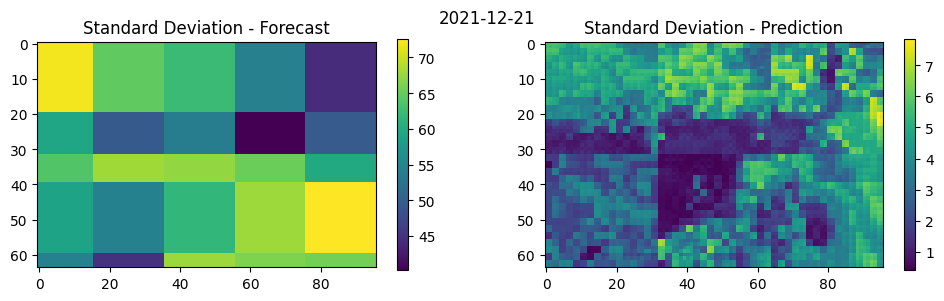

In [172]:
import xarray as xr
import matplotlib.pyplot as plt

# Assuming your data is stored in the 'pred_xarray' variable

for t in range(pred_xarray.shape[0]):
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))
    
    # Plot the standard deviation for the current time step
    std_deviation = forecast_xarray.isel(time=t).std(dim='ensemble')
    im0 = axs[0].imshow(std_deviation)
    axs[0].set_title(f'Standard Deviation - Forecast')
    cbar0 = plt.colorbar(im0, ax=axs[0])  # Add colorbar for the first subplot
    
    # Plot the original data for the current time step (adjust as needed)
    original_data = pred_xarray.isel(time=t).std(dim='ensemble')
    im1 = axs[1].imshow(original_data)
    axs[1].set_title("Standard Deviation - Prediction")
    cbar1 = plt.colorbar(im1, ax=axs[1])  # Add colorbar for the second subplot
    
    # Set the title of the entire figure
    plt.suptitle(pred_xarray.isel(time=t).time.values.astype('datetime64[D]'))
    
    plt.show()


In [ ]:

for t in range(0, init_cond.shape[0], t_step):
    subarray_forecast = init_cond_normalized[t:t + t_step]
    subarray_downscaled = pred_normalized[t:t + t_step, 0]

    std_image_forecast = torch.std(subarray_forecast, dim=0)
    std_image_downscaled = torch.std(subarray_downscaled, dim=0)
    
    # Calculate the mean of std_image_forecast and std_image_downscaled
    mean_std_forecast = std_image_forecast.mean().item()
    mean_std_downscaled = std_image_downscaled.mean().item()

    # Create subplots with two columns
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))

    # Display std_image_forecast on the first subplot
    axs[0].imshow(std_image_forecast)
    axs[0].set_title('Std. Deviation (Forecast)')
    cbar = plt.colorbar(axs[0].imshow(std_image_forecast), ax=axs[0])
    axs[0].text(0.5, 0.95, f"Mean: {mean_std_forecast}", transform=axs[0].transAxes, color='white')
    
    # Display std_image_downscaled on the second subplot
    axs[1].imshow(std_image_downscaled)
    axs[1].set_title('Std. Deviation (Downscaled)')
    cbar = plt.colorbar(axs[1].imshow(std_image_downscaled), ax=axs[1])
    axs[1].text(0.5, 0.95, f"Mean: {mean_std_downscaled}", transform=axs[1].transAxes, color='white')

    plt.tight_layout()
    plt.show()


<h1>Malaysia</h1>

define the model and the dataset of test. The test dataset is between 1st of January 2020 and 2023

In [28]:
batch_size=360
task = "10 days"
pred_range = 0

net_args = {
    'default_vars': [
        'forecast', 'rfh_lta', 'rfh']
    ,"img_size" :  [32, 32],
      "patch_size" :  2,
      "embed_dim":   2048,
      "depth" : 8,
      "decoder_depth" :  2,
      "num_heads": 16,
    "mlp_ratio": 2,
    "drop_path": 0.5,
    "drop_rate": 0.5,
    
}
net = ClimaX(**net_args)

model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_002-v7.ckpt') #Malysia
# model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_001-v1.ckpt') # Mozamnique
# model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_006-v1.ckpt')
# model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_003-v3.ckpt')

datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Malaysia/region_{1}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )
normalization = datamodule.transforms
print(normalization)
mean_norm, std_norm = normalization.mean, normalization.std
mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
model.set_denormalization(mean_denorm, std_denorm)
model.set_lat_lon(*datamodule.get_lat_lon())

denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)
datamodule.setup()


Loading pre-trained checkpoint from: ClimaX/exps/downscale/checkpoints/epoch_002-v7.ckpt
<All keys matched successfully>
Normalize(mean=[308.43711434 384.73586073], std=[80.09031047 64.48521206])


In [5]:
for i in range(1,2):
    print(i)
    datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Malaysia/region_{i}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )
    normalization = datamodule.transforms
    print(normalization)
    mean_norm, std_norm = normalization.mean, normalization.std
    mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
    model.set_denormalization(mean_denorm, std_denorm)
    model.set_lat_lon(*datamodule.get_lat_lon())

    denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)
    datamodule.setup()

    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2020)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Malaysia/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2020.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2020.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2020.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2020.pt'))
    
    
    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2021)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Malaysia/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2021.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2021.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2021.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2021.pt'))
    
    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2022)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Malaysia/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2022.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2022.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2022.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2022.pt'))
    
    


1
Normalize(mean=[308.43711434 384.73586073], std=[80.09031047 64.48521206])


/home/u/wessim.omezzine/.local/lib/python3.10/site-packages/torch/cuda/__init__.py:546: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


Selected device: cpu
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2}
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2}
Selected device: cpu
Selected device: cpu


In [27]:
save_path = f"Data/Downscaling/Rainfall/Malaysia/region_{1}"

gt_2020 = torch.load(os.path.join(save_path, 'ground_truth_2020.pt'))
pred_2020 = torch.load(os.path.join(save_path, 'pred_2020.pt'))
forecast_2020 = torch.load(os.path.join(save_path, 'tensors_2020.pt'))[0].unsqueeze(1)
lta_2020 = torch.load(os.path.join(save_path, 'tensors_2020.pt'))[1].unsqueeze(1)
tensors_2020 = torch.load(os.path.join(save_path, 'tensors_pred_2020.pt'))

gt_2021 = torch.load(os.path.join(save_path, 'ground_truth_2021.pt'))
pred_2021 = torch.load(os.path.join(save_path, 'pred_2021.pt'))
forecast_2021 = torch.load(os.path.join(save_path, 'tensors_2021.pt'))[0].unsqueeze(1)
lta_2021 = torch.load(os.path.join(save_path, 'tensors_2021.pt'))[1].unsqueeze(1)
tensors_pred_2021 = torch.load(os.path.join(save_path, 'tensors_pred_2021.pt'))

gt_2022 = torch.load(os.path.join(save_path, 'ground_truth_2022.pt'))
pred_2022 = torch.load(os.path.join(save_path, 'pred_2022.pt'))
tensors_2022 = torch.load(os.path.join(save_path, 'tensors_2022.pt'))
forecast_2022 = torch.load(os.path.join(save_path, 'tensors_2022.pt'))[0].unsqueeze(1)
lta_2022 = torch.load(os.path.join(save_path, 'tensors_2022.pt'))[1].unsqueeze(1)
tensors_pred_2022 = torch.load(os.path.join(save_path, 'tensors_pred_2022.pt'))

In [28]:
gt = torch.cat([gt_2020,gt_2021, gt_2022],dim=0)
pred = torch.cat([pred_2020,pred_2021, pred_2022],dim=0)
forecast = torch.cat([forecast_2020,forecast_2021, forecast_2022],dim=0)
lta = torch.cat([lta_2020,lta_2021, lta_2022],dim=0)


In [29]:
def bilinear_interpolate (forecast,t,verbose=False):
    new_height = forecast.shape[1]
    new_width = forecast.shape[2]
    forecast_resample=forecast[t]
    image_tensor  = forecast_resample[:30:5,:30:5]
    
    rescaled_image = F.interpolate(image_tensor.unsqueeze(0).unsqueeze(0), size=(new_height, new_width), mode='bilinear', align_corners=False)[0]
    
    if verbose:
        
        plt.imshow(rescaled_image)
        plt.show()
    
    
    
    return rescaled_image

In [30]:
gt.shape

torch.Size([1080, 1, 32, 32])

In [31]:
360*3

1080

In [33]:
bilinear = torch.clone(forecast)
weighted= torch.clone(forecast)
i,j=0,0
for t in range(gt.shape[0]):
    bilinear[t:t+1,0,32*(i):32*(i+1), 32*(j):32*(j+1)] = bilinear_interpolate(forecast[:,0,32*(i):32*(i+1), 32*(j):32*(j+1)],t)
    weighted[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)] = torch.tensor(Downscale_Weight(lta[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)].cpu().numpy(),forecast[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)].cpu().numpy()))

In [34]:
def tensor_to_xarray(tensor, ensemble,batch_size, path_to_data,lat_shape=96, long_shape=64, element_per_year=18, start_year=2020, end_year=2020):
    time = xr.open_dataset(os.path.join(path_to_data,"data/r1h_lta.nc")).time
    time_sorted = time['time'].sortby('time')
    time_axis = time_sorted
    time_axis = np.unique(time_axis.time.values)
    time_axis = time_axis[np.logical_and(time_axis >= np.datetime64(f'{start_year}-01-01'), time_axis < np.datetime64(f'{end_year}-12-31'))]
    
    latitude = np.arange(lat_shape)
    longitude = np.arange(long_shape)
    ensemble_indices =np.arange(ensemble)

    # Create an empty DataArray with the desired dimensions and coordinates
    tensor_xarray = xr.DataArray(
        np.empty((batch_size//ensemble, ensemble, lat_shape, long_shape)),  # Empty array with the desired shape
        coords={
            'time': time_axis,
            'latitude': latitude,
            'longitude': longitude,
            'ensemble': ensemble_indices,
        },
        dims=['time', 'ensemble', 'latitude', 'longitude'],
        name='band'
    )

    # Loop over ensembles and assign the corresponding data from gt
    for i in range(ensemble):
        start_index = i * element_per_year
        end_index = (i + 1) * element_per_year

        data = np.concatenate([tensor[start_index:end_index], tensor[start_index + element_per_year*ensemble:end_index + element_per_year*ensemble]], axis=0)

        # print(start_index, end_index,"        ",  start_index + 180, end_index + 180, "     ", start_index + 360, end_index + 360)
        # data = np.concatenate([gt[start_index:end_index], gt[start_index + 180:end_index + 180], gt[start_index + 360:end_index + 360]], axis=0)
        if len(data.shape) ==4:
            tensor_xarray[:,i] = data[:,0,:,:]
        else:
            tensor_xarray[:,i] = data[:,:,:]
            
    return tensor_xarray

In [37]:
ensemble=20
region = 2
gt2020_xarray = tensor_to_xarray(gt[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
pred2020_xarray = tensor_to_xarray(pred[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
forecast2020_xarray = tensor_to_xarray(forecast[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
lta2020_xarray = tensor_to_xarray(lta[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
bilinear2020_xarray = tensor_to_xarray(bilinear[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
weighted2020_xarray = tensor_to_xarray(weighted[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)



gt2021_xarray = tensor_to_xarray(gt[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
pred2021_xarray = tensor_to_xarray(pred[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
forecast2021_xarray = tensor_to_xarray(forecast[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
lta2021_xarray = tensor_to_xarray(lta[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
bilinear2021_xarray = tensor_to_xarray(bilinear[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
weighted2021_xarray = tensor_to_xarray(weighted[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)


gt2022_xarray = tensor_to_xarray(gt[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
pred2022_xarray = tensor_to_xarray(pred[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
forecast2022_xarray = tensor_to_xarray(forecast[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
lta2022_xarray = tensor_to_xarray(lta[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
bilinear2022_xarray = tensor_to_xarray(bilinear[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
weighted2022_xarray = tensor_to_xarray(weighted[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)


In [40]:
gt_xarray = xr.concat([gt2020_xarray, gt2021_xarray, gt2022_xarray], dim='time')
pred_xarray = xr.concat([pred2020_xarray, pred2021_xarray, pred2022_xarray], dim='time')

forecast_xarray = xr.concat([forecast2020_xarray, forecast2021_xarray, forecast2022_xarray], dim='time')
lta_xarray = xr.concat([lta2020_xarray, lta2021_xarray, lta2022_xarray], dim='time')
bilinear_xarray = xr.concat([bilinear2020_xarray, bilinear2021_xarray, bilinear2022_xarray], dim='time')
weighted_xarray = xr.concat([weighted2020_xarray, weighted2021_xarray, weighted2022_xarray], dim='time')


In [42]:
import shutil
# Define the directory where to save the files
save_dir = f"Data/Downscaling/Rainfall/Malaysia/"

# Remove all files in the directory
for filename in os.listdir(save_dir):
    file_path = os.path.join(save_dir, filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
    except Exception as e:
        print(f'Failed to delete {file_path}. Reason: {e}')

# Ensure the directory exists
os.makedirs(save_dir, exist_ok=True)
gt_xarray.to_netcdf(os.path.join(save_dir, 'gt_xarray.nc'))
pred_xarray.to_netcdf(os.path.join(save_dir, 'pred_xarray.nc'))
forecast_xarray.to_netcdf(os.path.join(save_dir, 'forecast_xarray.nc'))
lta_xarray.to_netcdf(os.path.join(save_dir, 'lta_xarray.nc'))
bilinear_xarray.to_netcdf(os.path.join(save_dir, 'bilinear_xarray.nc'))
weighted_xarray.to_netcdf(os.path.join(save_dir, 'weighted_xarray.nc'))


In [29]:
import xarray as xr

# Define the directory where the files are saved
save_dir = "Data/Downscaling/Rainfall/Malaysia/"

# Create a dictionary to hold the data
data_dict = {}

gt_xarray = xr.open_dataarray(os.path.join(save_dir, f'gt_xarray.nc'))
pred_xarray = xr.open_dataarray(os.path.join(save_dir, f'pred_xarray.nc'))
forecast_xarray = xr.open_dataarray(os.path.join(save_dir, f'forecast_xarray.nc'))
lta_xarray=xr.open_dataarray(os.path.join(save_dir, f'lta_xarray.nc'))
bilinear_xarray=xr.open_dataarray(os.path.join(save_dir, f'bilinear_xarray.nc'))
weighted_xarray = xr.open_dataarray(os.path.join(save_dir, f'weighted_xarray.nc'))



In [30]:
lat = datamodule.get_lat_lon()[0]

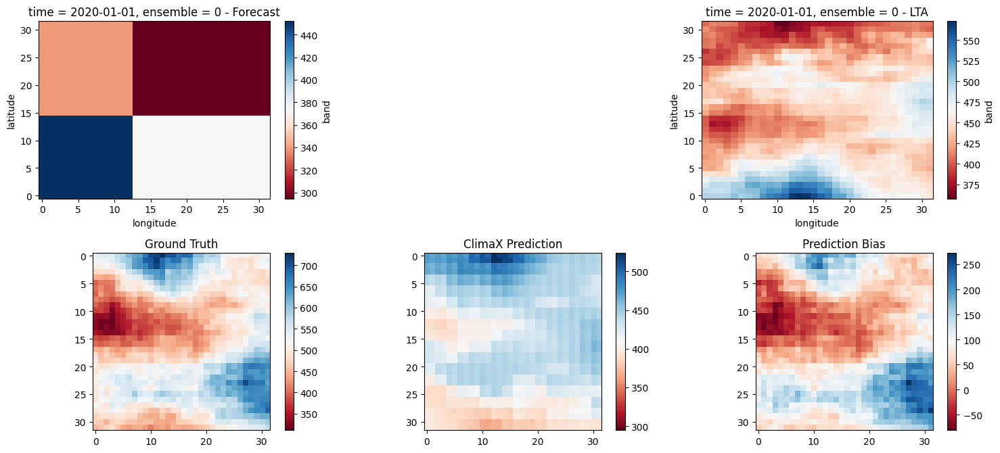

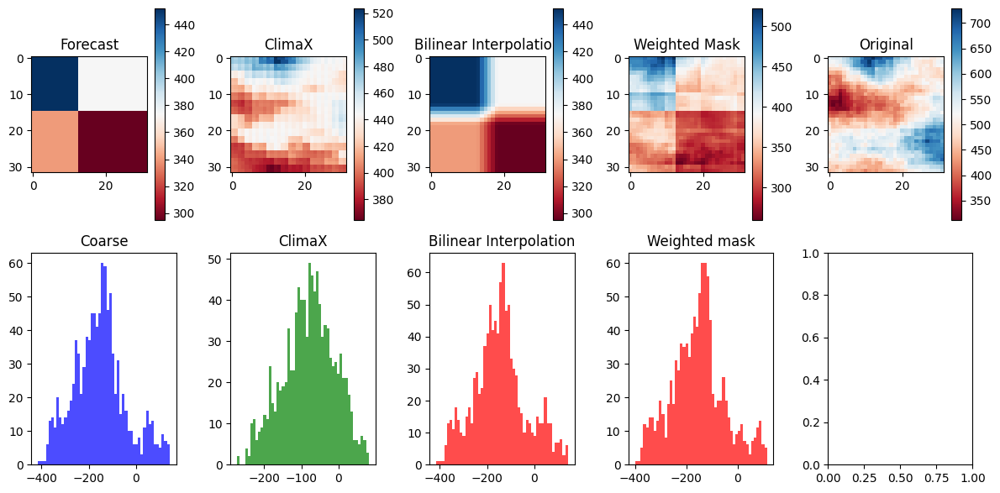

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 35634.070031143754  | 11214.35986982515  | 33171.626110530975     | 34294.675305891455   |
| lat_weighted_rmse    | 188.76988645211333  | 105.89787471816963 | 182.13079396557566     | 185.1882158936995    |
| spearman             | -0.3512194560192437 | 0.401458802895174  | -0.4299166284191187    | -0.23023163554786155 |
| mean_bias            | -153.06938561797142 | -79.83143275976181 | -144.40549638867378    | -153.4134584069252   |
| pearson              | -0.3561793832554746 | 0.4590944704678288 | -0.39694893538188275   | -0.17656802107061426 |
+----------------------+---------------------+-----

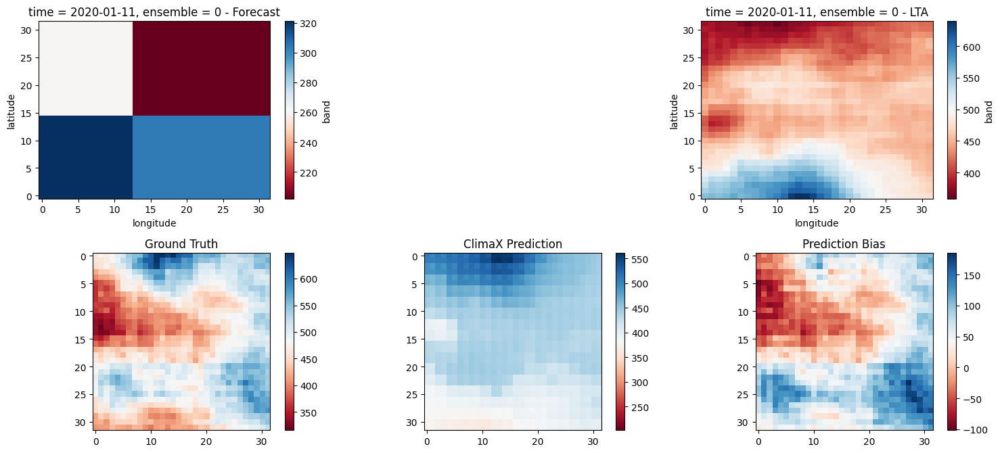

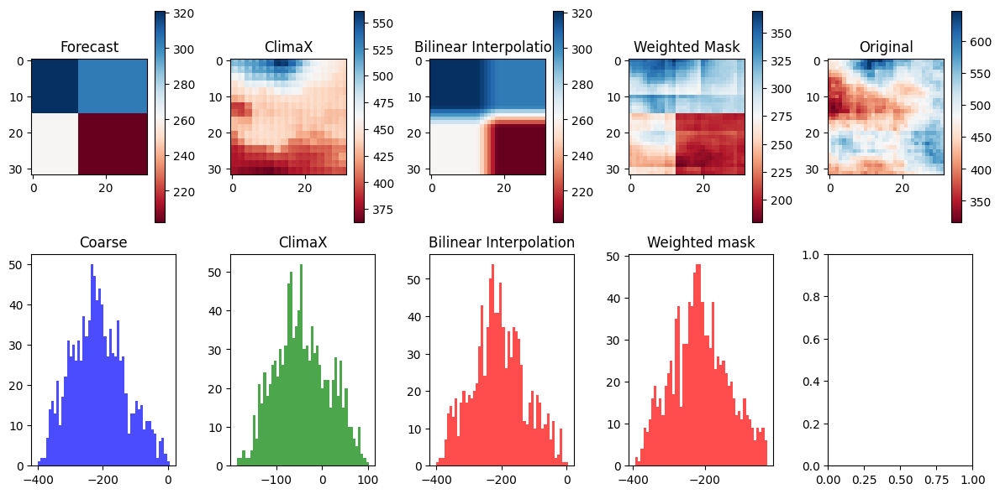

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+---------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 52412.255400325805   | 5252.418628104629   | 49603.764716926366     | 51765.641562175675    |
| lat_weighted_rmse    | 228.9372302626329    | 72.47357192870122   | 222.7190263918338      | 227.5206398597184     |
| spearman             | -0.22473823970859322 | 0.1761372371734578  | -0.26930597342720003   | -0.018494393379060847 |
| mean_bias            | -213.56734128296375  | -42.954079031944275 | -207.3580280840397     | -213.6580062508583    |
| pearson              | -0.205194923870043   | 0.3204812479792417  | -0.267939276939931     | -0.05101378201230572  |
+----------------------+---

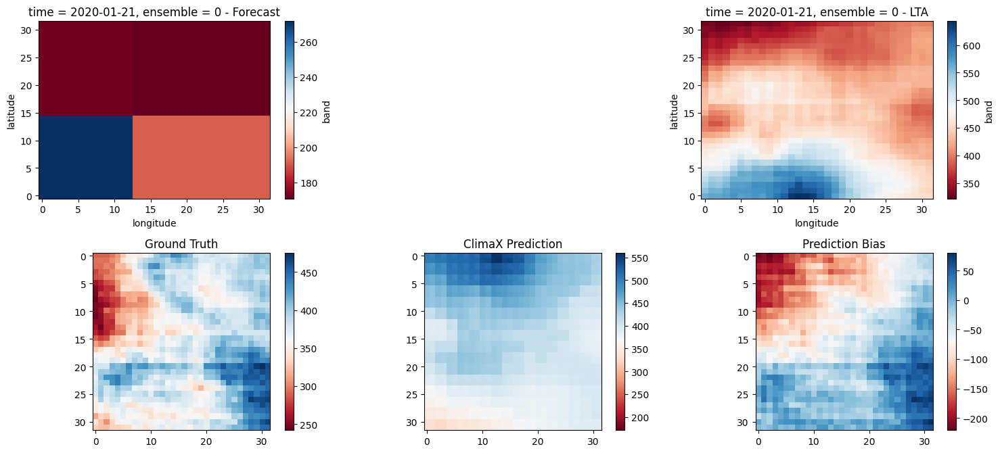

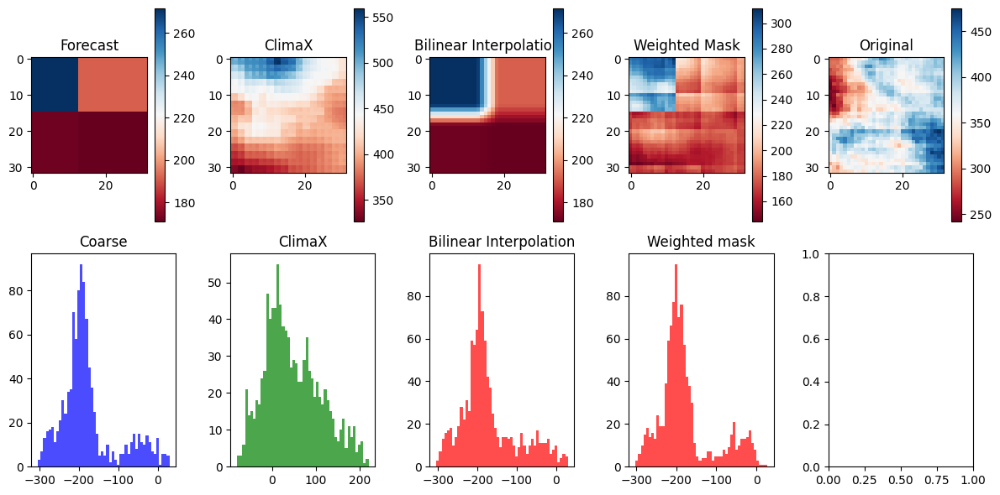

Selected device: cpu
+----------------------+----------------------+----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX               | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 36386.52987969571    | 6337.351826801579    | 34542.43201401812      | 36157.77273201635    |
| lat_weighted_rmse    | 190.7525357097402    | 79.60748599724512    | 185.85594425258        | 190.1519727271225    |
| spearman             | -0.47469421516570837 | -0.13372948140136132 | -0.5154671924063101    | -0.20846247775811724 |
| mean_bias            | -177.09808106720448  | 47.18792110681534    | -171.6230354309082     | -177.15637405216694  |
| pearson              | -0.592475802131052   | -0.1357620468858215  | -0.5813185300294124    | -0.454369294477444   |
+----------------------+---

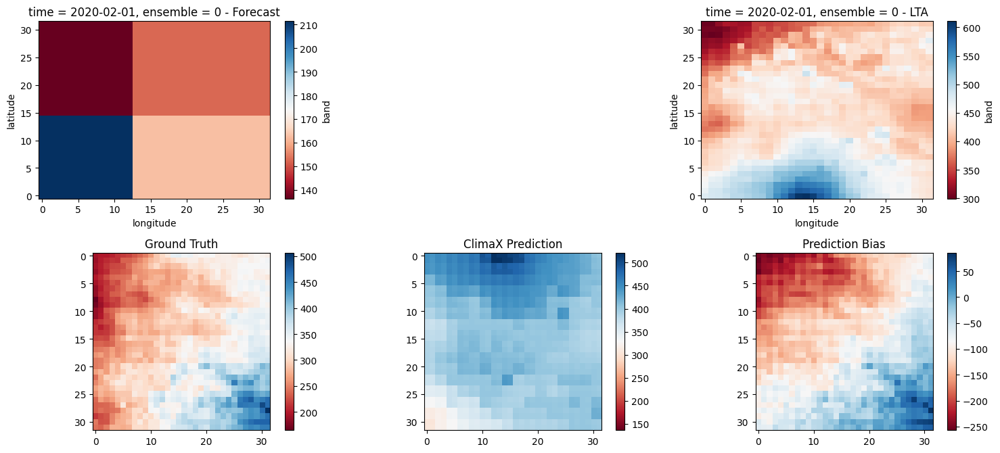

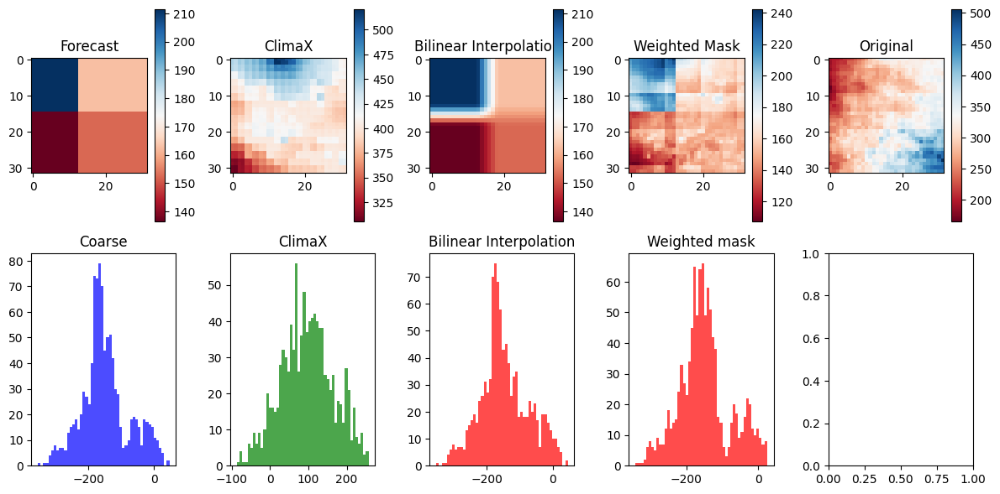

Selected device: cpu
+----------------------+----------------------+----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX               | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 27384.030354500188   | 13972.145461698896   | 26820.497998300067     | 27238.045661005184   |
| lat_weighted_rmse    | 165.48120846337866   | 118.20383014817622   | 163.76964919758504     | 165.03952757144327   |
| spearman             | -0.31369254344560754 | -0.16804785884113269 | -0.43335423157964736   | -0.25194392150826317 |
| mean_bias            | -148.80027003586292  | 96.96329092979431    | -146.12914663553238    | -148.8991089388728   |
| pearson              | -0.46636127926547466 | -0.07488402610749578 | -0.5167744768395692    | -0.3681051179252809  |
+----------------------+---

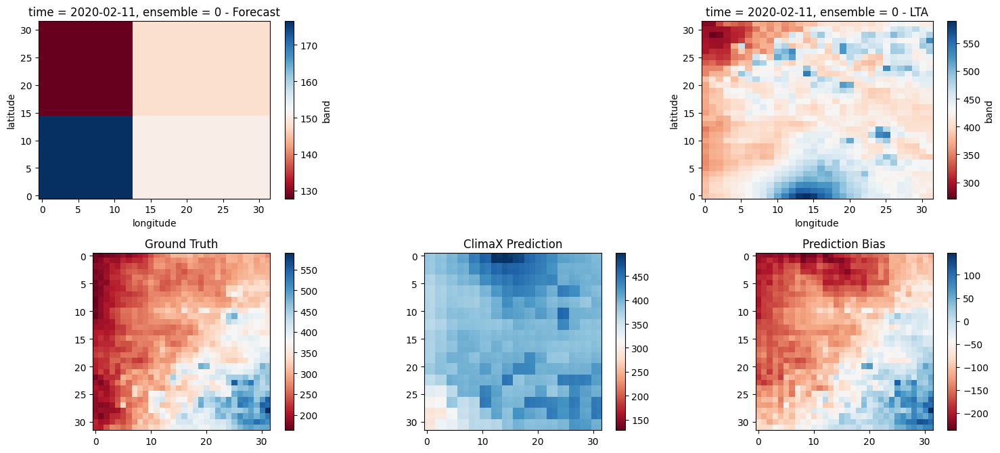

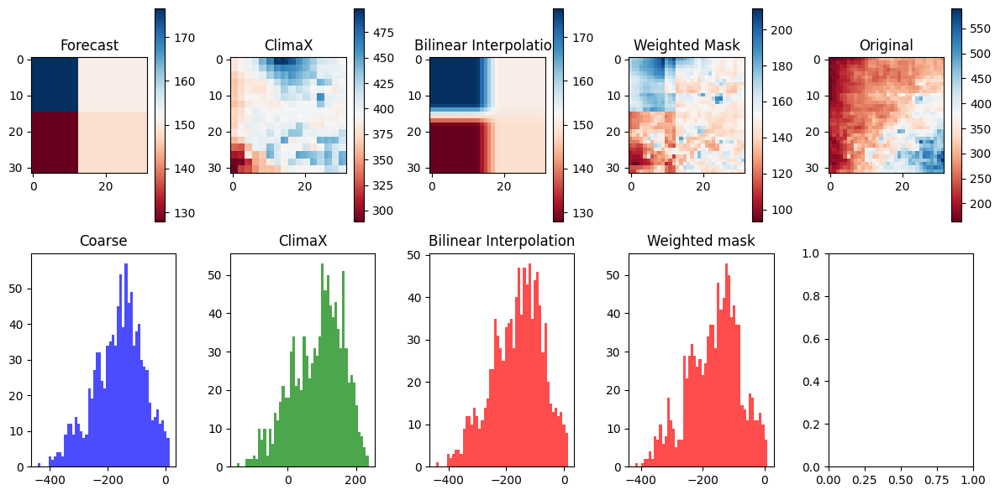

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+-----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+---------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 33647.249753324824  | 13347.65977284179  | 33567.37752343717      | 33320.22554800437     |
| lat_weighted_rmse    | 183.43186678798432  | 115.53207248570325 | 183.21402108855418     | 182.53828515685242    |
| spearman             | -0.2403970693250062 | 0.424010262709784  | -0.29800633669460636   | -0.044420399260007355 |
| mean_bias            | -162.32084603607655 | 88.29394426941872  | -161.40770345926285    | -162.4219462350011    |
| pearson              | -0.1642343706100967 | 0.405526321364688  | -0.23920125696237282   | 0.01133536602925792   |
+----------------------+-------------------

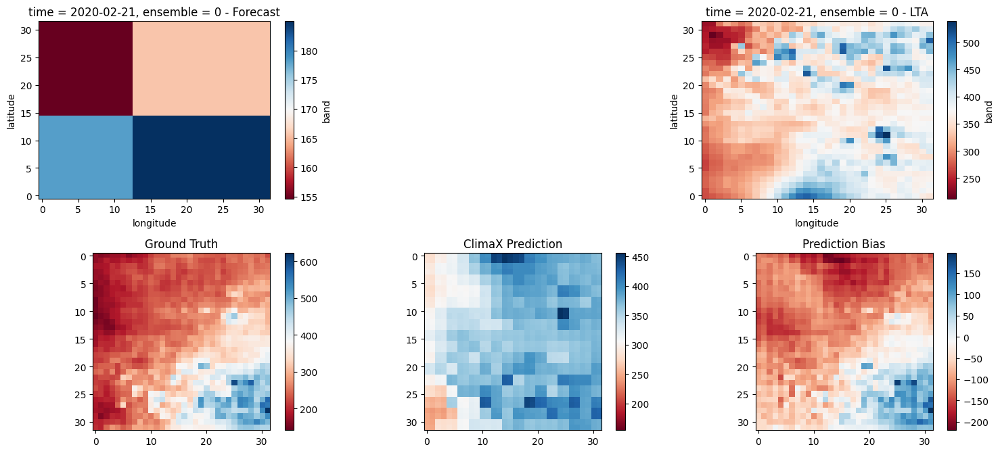

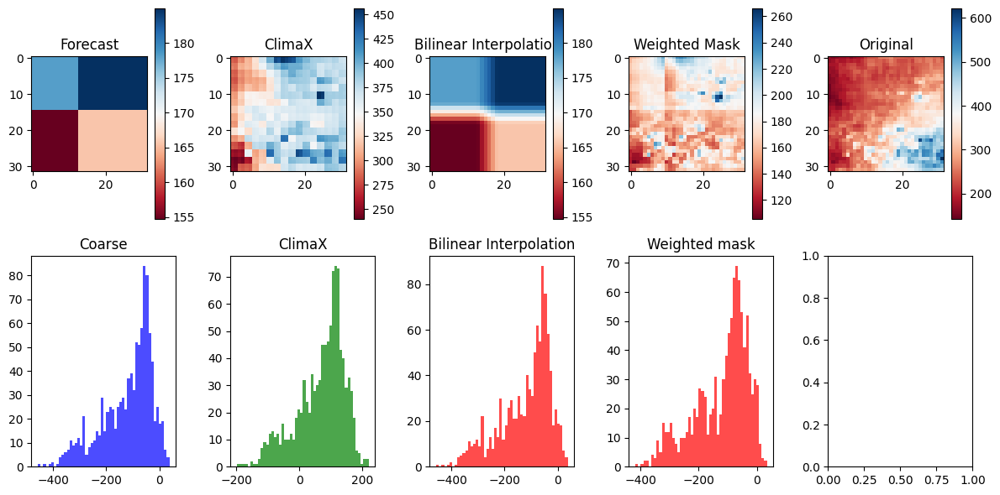

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 23367.576210022686   | 10490.433228076237 | 23411.779484929408     | 22790.972989315997   |
| lat_weighted_rmse    | 152.86456819689343   | 102.4228159546311  | 153.00908301447143     | 150.96679432681876   |
| spearman             | -0.1760673223423765  | 0.62592277351111   | -0.19605924608193612   | 0.033723960841532515 |
| mean_bias            | -119.86687226593494  | 69.45771303772926  | -120.03734186291695    | -119.82784944027662  |
| pearson              | -0.23903306419700804 | 0.5962890795092856 | -0.255909711807909     | 0.09298661483821014  |
+----------------------+-------------------

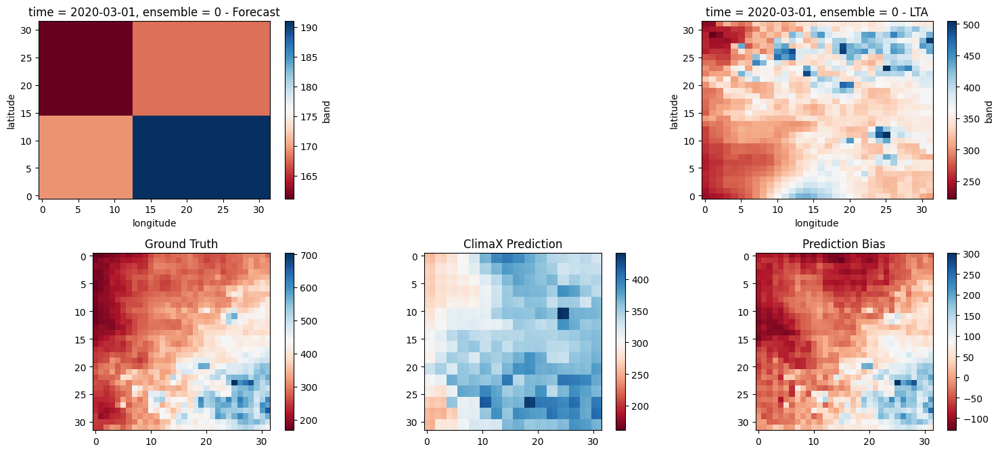

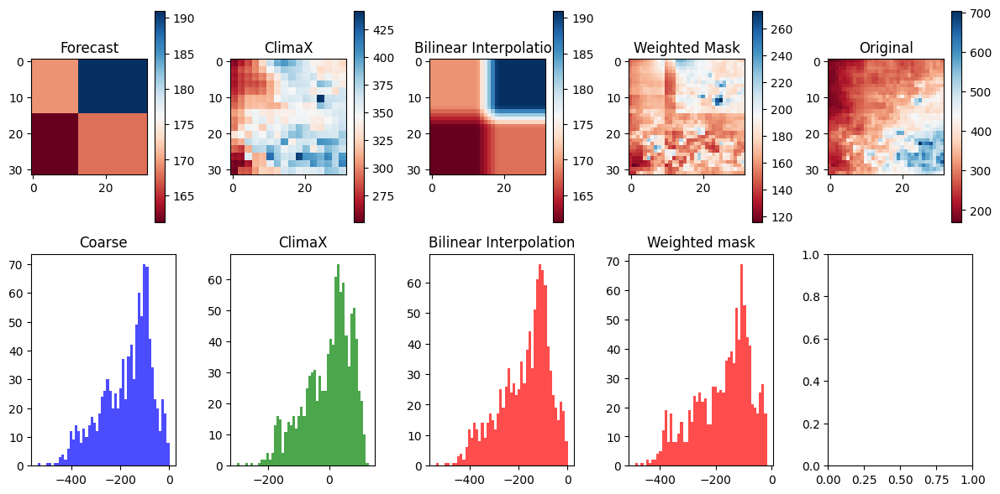

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 40784.64560837068    | 6096.308759432249   | 40935.59272309527      | 40035.32800926373   |
| lat_weighted_rmse    | 201.9520874078074    | 78.0788624368481    | 202.32546236965646     | 200.08830053070002  |
| spearman             | -0.14466983022496074 | 0.7601093837324274  | -0.054368398725336727  | 0.18650491670286082 |
| mean_bias            | -173.77745389938354  | -3.2143353819847107 | -174.57079283893108    | -173.713887155056   |
| pearson              | -0.06555962517700538 | 0.7589183112945038  | -0.022632075530070486  | 0.20770749690386903 |
+----------------------+-------------------

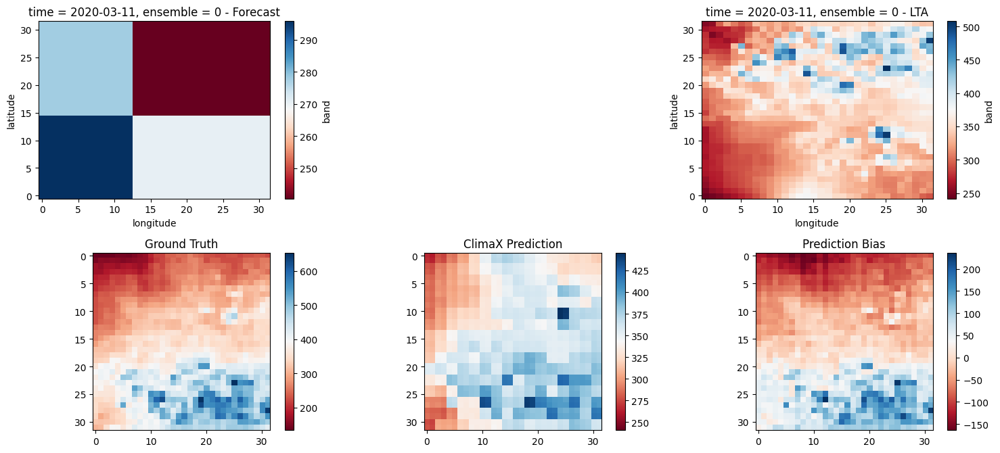

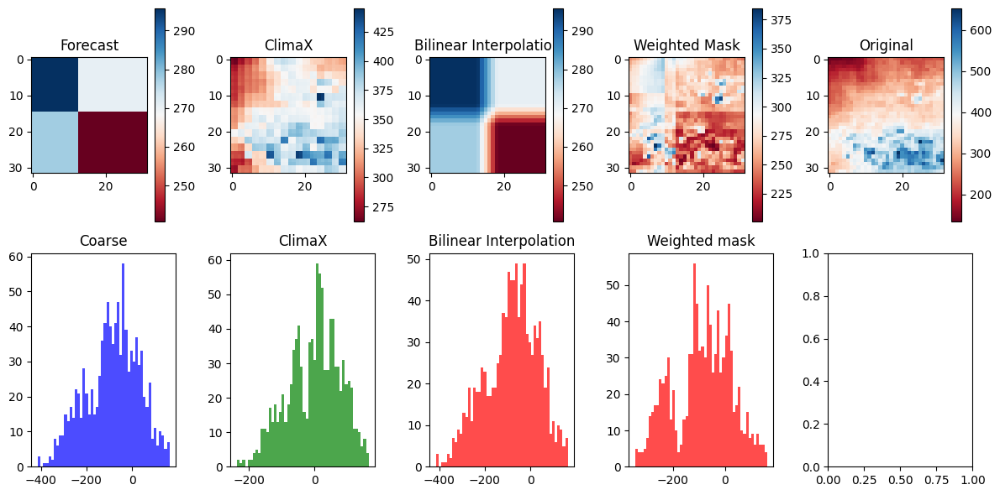

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 20579.247106407256  | 6201.578704174692   | 19780.289556250842     | 19530.493577578407   |
| lat_weighted_rmse    | 143.45468659617663  | 78.75010288358163   | 140.64241734359817     | 139.75154230840675   |
| spearman             | -0.6102571571100839 | 0.7534868162208455  | -0.6736214626832279    | -0.33843659337328363 |
| mean_bias            | -85.90273198485374  | -1.8740105032920837 | -82.19603765010834     | -86.02574287354946   |
| pearson              | -0.697494472946913  | 0.7497945352871211  | -0.717323952628828     | -0.23589512134371401 |
+----------------------+-------------------

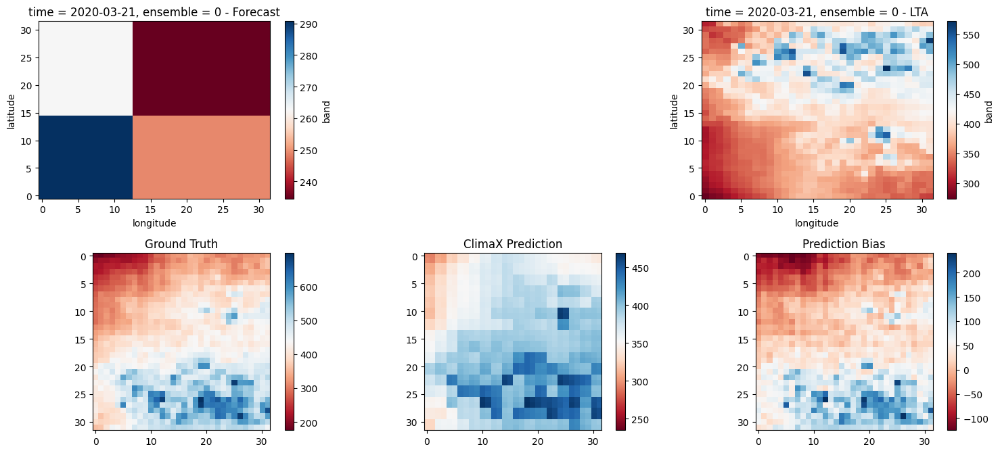

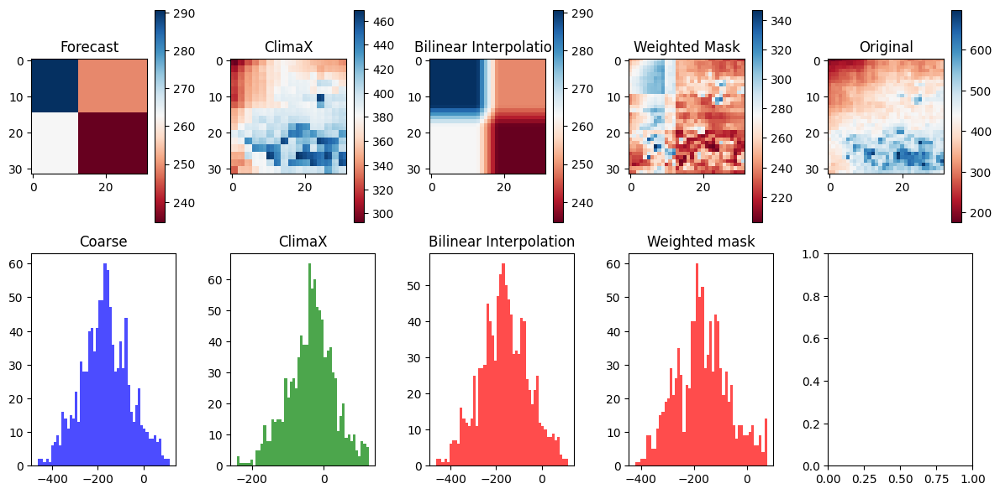

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 39099.78487483942   | 5349.957742940785  | 37824.1114485062       | 37974.7035161941     |
| lat_weighted_rmse    | 197.7366553647538   | 73.1434053277586   | 194.48421902176588     | 194.87099198237306   |
| spearman             | -0.6319574983756021 | 0.8866512395634825 | -0.6643036166477495    | -0.2534865837212137  |
| mean_bias            | -167.11726036667824 | -35.17833012342453 | -163.2248384654522     | -167.29758101701736  |
| pearson              | -0.6555877596302556 | 0.8804870088142434 | -0.6780107670371558    | -0.20288537646290147 |
+----------------------+---------------------+-----

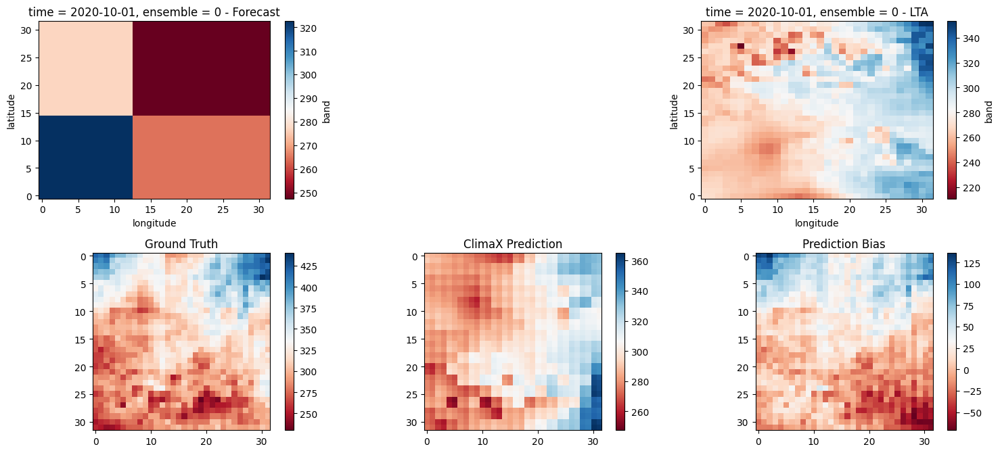

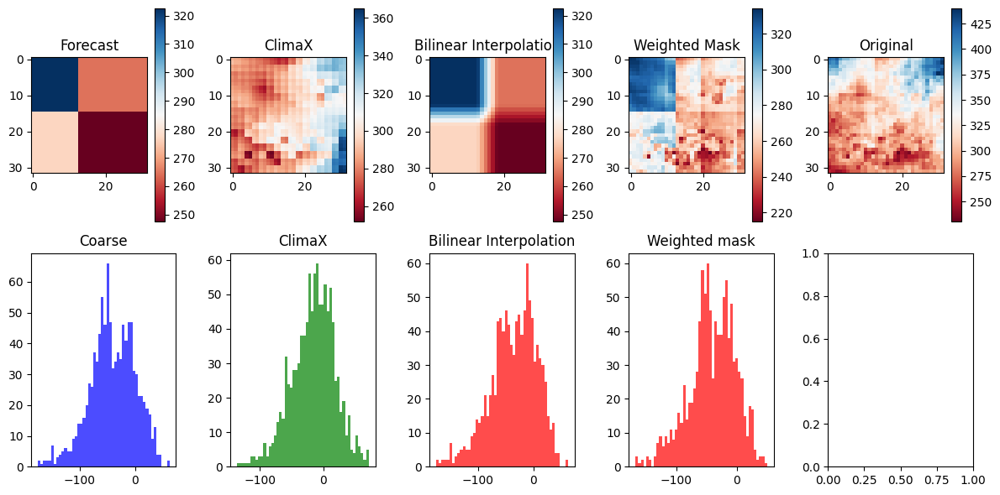

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3299.5672688252657  | 1407.039941086883   | 2981.1556285275883     | 3092.4844519633184  |
| lat_weighted_rmse    | 57.44185990047037   | 37.510531069112886  | 54.59995996818668      | 55.610111058721316  |
| spearman             | 0.11456894688729967 | 0.3647134906951917  | 0.11397077406660087    | 0.2743320100908229  |
| mean_bias            | -40.37380127608776  | -15.984271869063377 | -35.380482241511345    | -40.55212219059467  |
| pearson              | 0.16527339982464467 | 0.3744208978343324  | 0.12839574098096262    | 0.29027533923952953 |
+----------------------+---------------------+-----

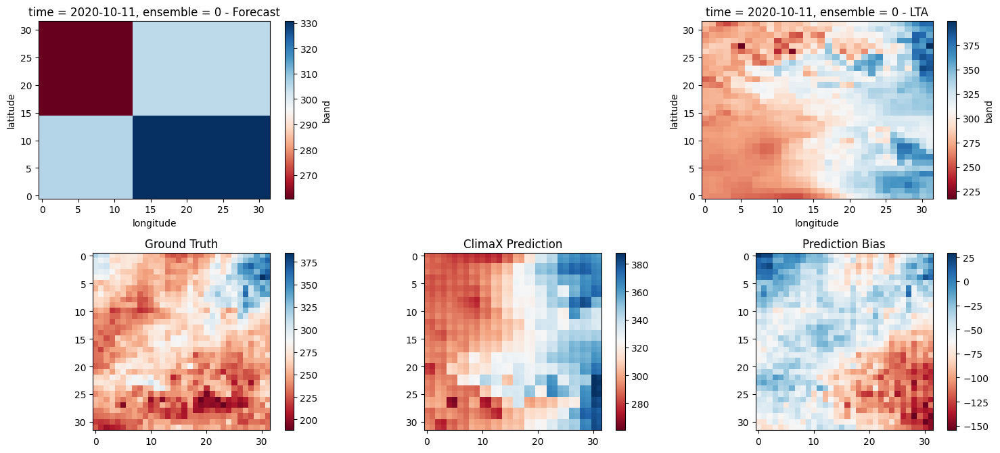

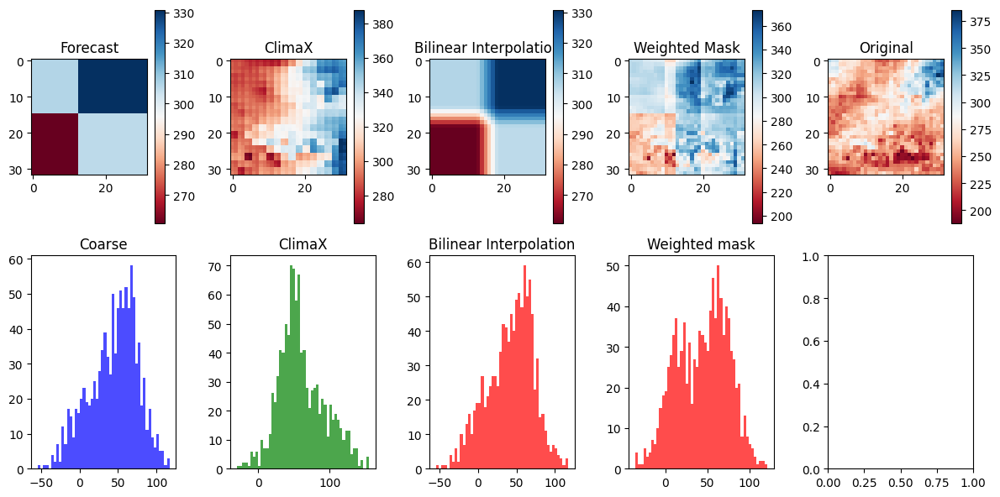

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2952.8669123448644  | 4724.556153846424   | 2674.3396819681025     | 2897.5805792538395  |
| lat_weighted_rmse    | 54.34028811429752   | 68.73540684280864   | 51.714018234595756     | 53.82917962642418   |
| spearman             | 0.4326234222132394  | 0.29170074521507416 | 0.4683985050222482     | 0.44603929512444573 |
| mean_bias            | 44.44653955101967   | 60.74753180146217   | 42.26825764775276      | 44.464041605591774  |
| pearson              | 0.35538319441065713 | 0.3919738259576509  | 0.40313939620004835    | 0.48367339260261033 |
+----------------------+---------------------+-----

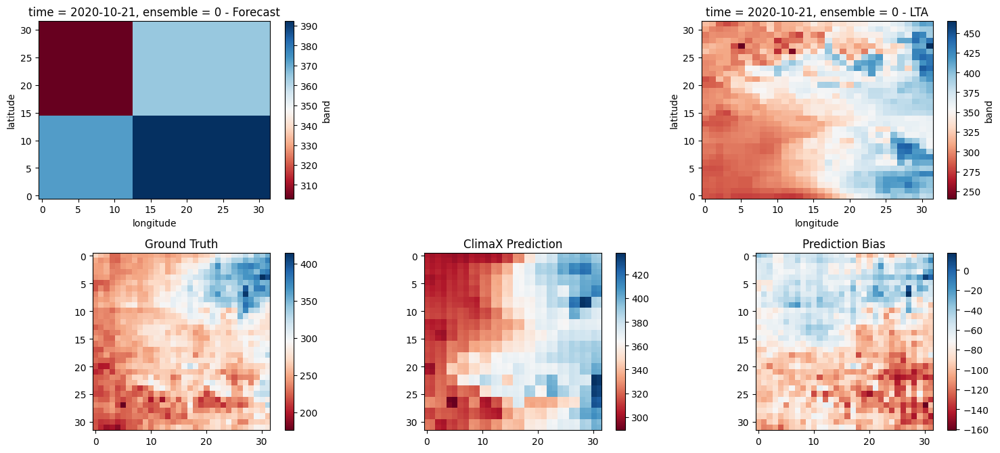

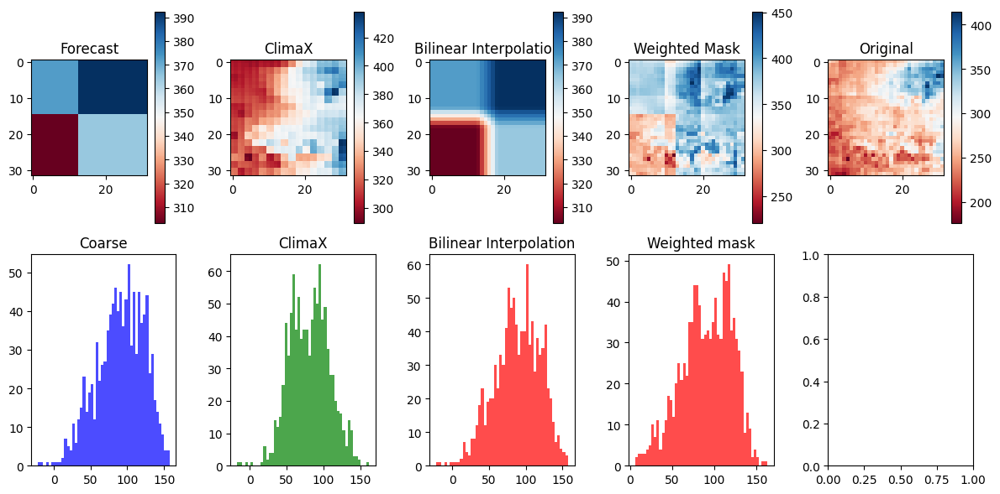

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 9270.734585119708  | 7271.758562662669  | 8766.359705251722      | 9123.153310886177  |
| lat_weighted_rmse    | 96.2846539440201   | 85.27460678691324  | 93.62884013620868      | 95.5151993710225   |
| spearman             | 0.6023032581449882 | 0.730135982600877  | 0.6592395553791289     | 0.7313117818669256 |
| mean_bias            | 90.84789362549782  | 81.0417200922966   | 88.45679521560669      | 90.82584638893604  |
| pearson              | 0.5879752037368511 | 0.7248135668390838 | 0.6141650631243392     | 0.6997365194399038 |
+----------------------+--------------------+--------------------+---------

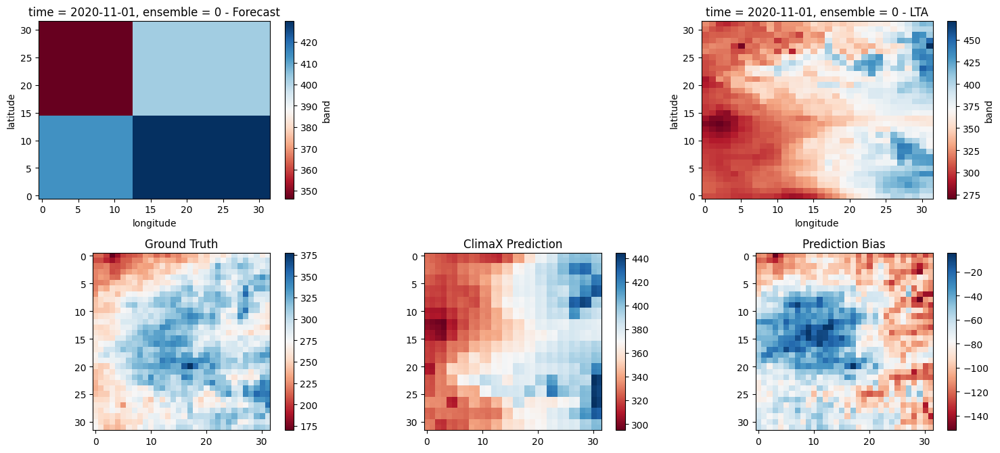

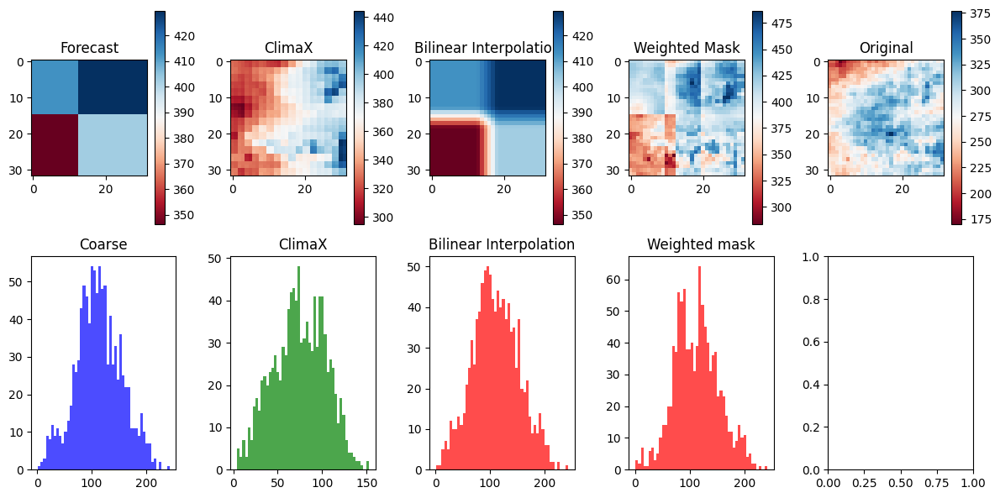

Selected device: cpu
+----------------------+------------------------+--------------------+------------------------+---------------------+
|                      | Coarse                 | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+------------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 14475.327508691174     | 6375.413969220621  | 14047.262743501207     | 14340.246878309244  |
| lat_weighted_rmse    | 120.31345522713232     | 79.84618944709021  | 118.52114892921519     | 119.75076984432812  |
| spearman             | -0.0063277125018050846 | 0.5538935629048233 | 0.006531712348404307   | 0.30595636546153604 |
| mean_bias            | 112.7651654779911      | 74.37760484218597  | 110.72260230779648     | 112.72500425577164  |
| pearson              | 0.05507320428389122    | 0.5761047687246479 | 0.019329379873573006   | 0.2876108012004628  |
+----------------------+-----------

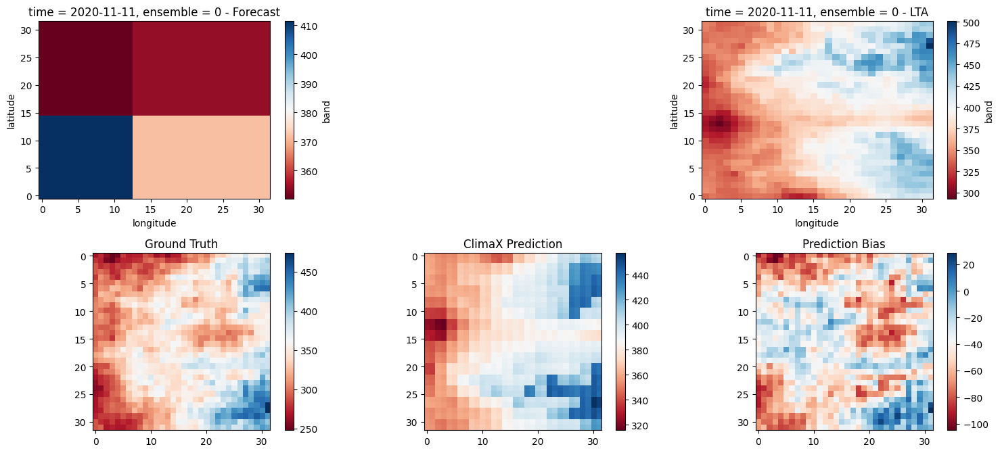

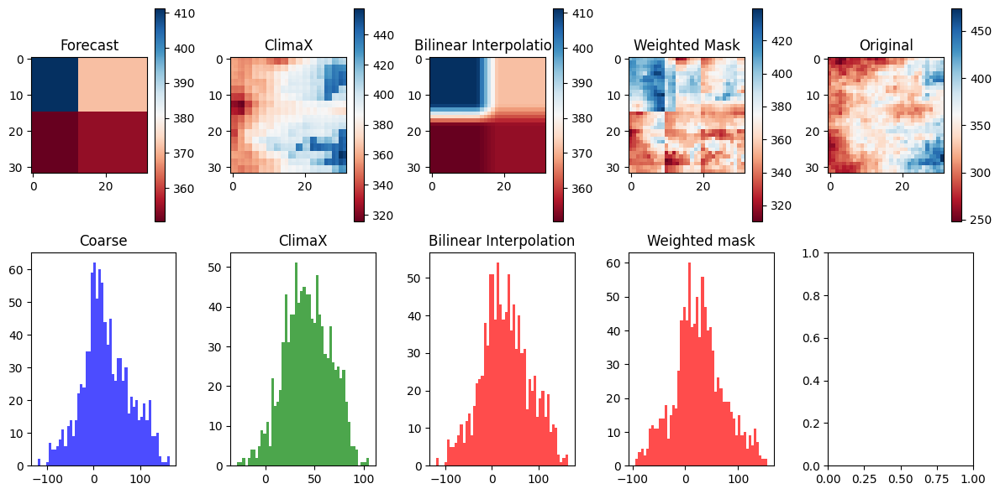

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 3339.314944866941    | 2378.2342089084714 | 3556.2950551581853     | 2931.57482721374     |
| lat_weighted_rmse    | 57.78680597564587    | 48.767142718314666 | 59.63467997028395      | 54.14401931158916    |
| spearman             | -0.11387734656834057 | 0.8214299752493666 | -0.18078228706547053   | 0.023896767348516902 |
| mean_bias            | 26.440959930419922   | 42.885608077049255 | 29.218536019325256     | 26.27511802315712    |
| pearson              | -0.3355920557530527  | 0.8221383198855042 | -0.35307624093343815   | -0.02286288187942588 |
+----------------------+-------------------

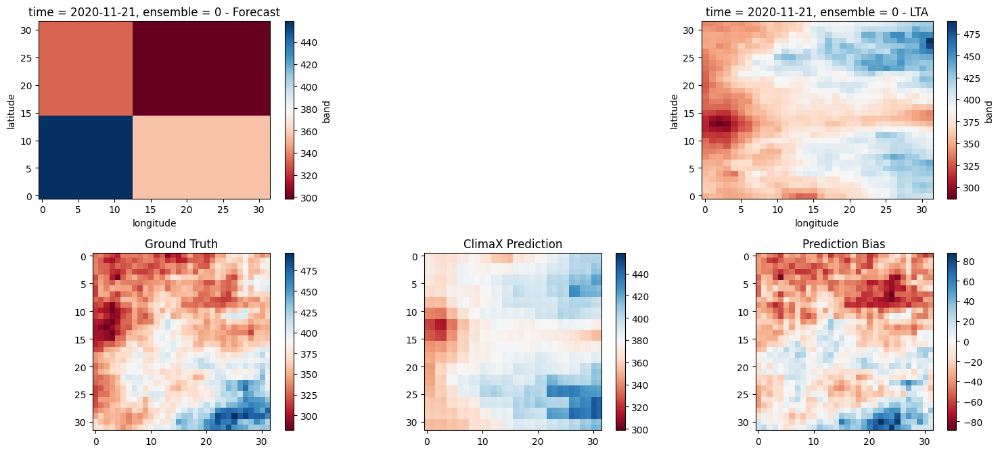

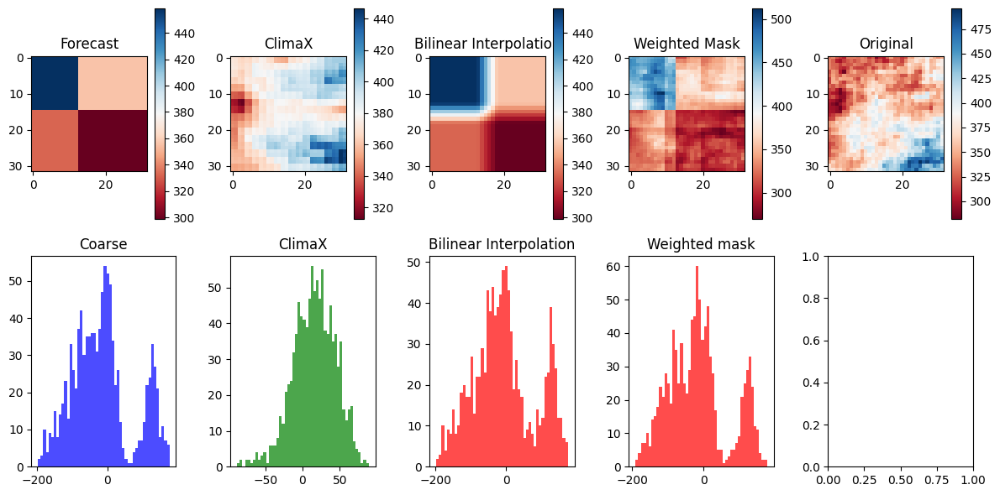

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 7479.593477505111   | 1054.475854884283  | 7380.5154894687585     | 7059.414185836597   |
| lat_weighted_rmse    | 86.48464301542275   | 32.47269398870816  | 85.90992660611903      | 84.02032007697065   |
| spearman             | -0.7135315664495677 | 0.5920580016532304 | -0.7256538008038509    | -0.5658406483642245 |
| mean_bias            | -14.786500215530396 | 15.705961644649506 | -5.7297817170619965    | -15.061769962310791 |
| pearson              | -0.6290894888897791 | 0.6704152154003495 | -0.6520155124533609    | -0.5290788991856624 |
+----------------------+---------------------+-------------

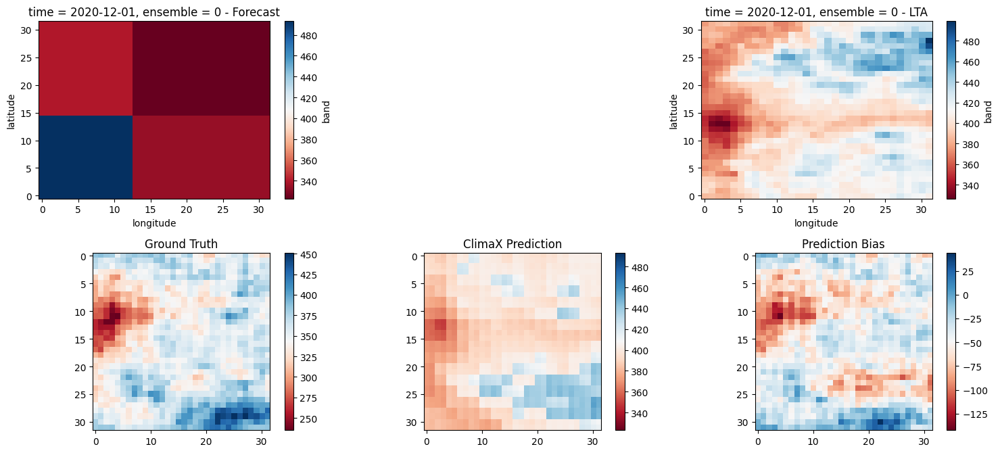

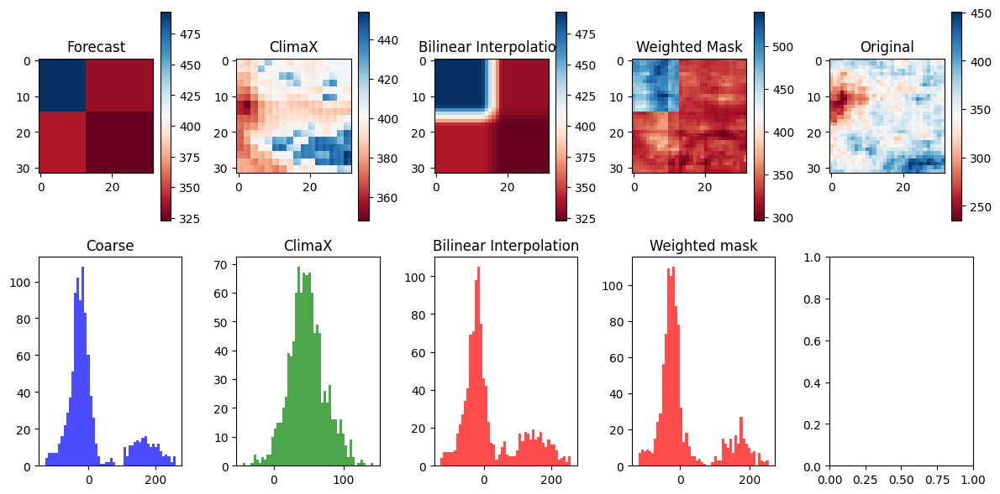

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 7228.02492505591    | 2950.525313307532  | 7806.977331896156      | 6785.689155472922   |
| lat_weighted_rmse    | 85.01779181474846   | 54.31873814170881  | 88.35710119676945      | 82.3752945698704    |
| spearman             | -0.4701103596083496 | 0.5505132478423679 | -0.4841867312180462    | -0.1808065228573601 |
| mean_bias            | 10.05806103348732   | 47.71016180515289  | 20.46497344970703      | 9.773630112409592   |
| pearson              | -0.4778462373018378 | 0.6053201247562195 | -0.49753610595422904   | -0.3932906760057864 |
+----------------------+---------------------+-------------

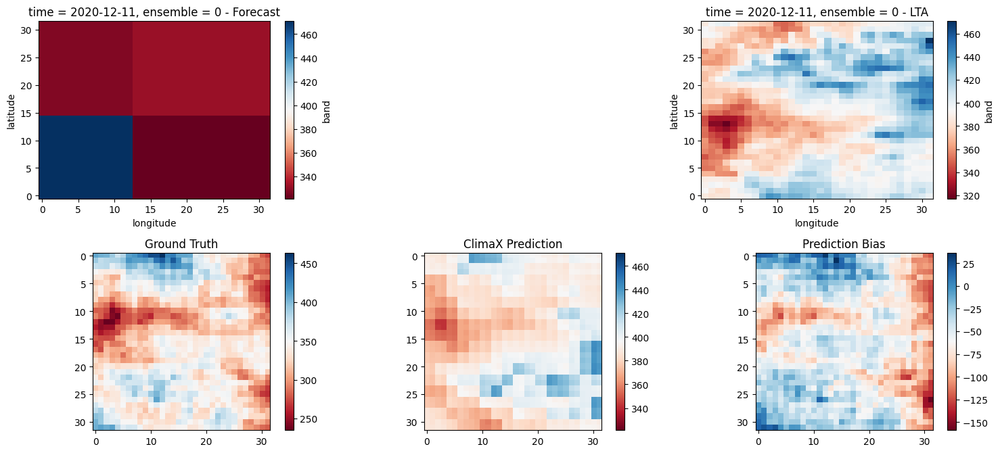

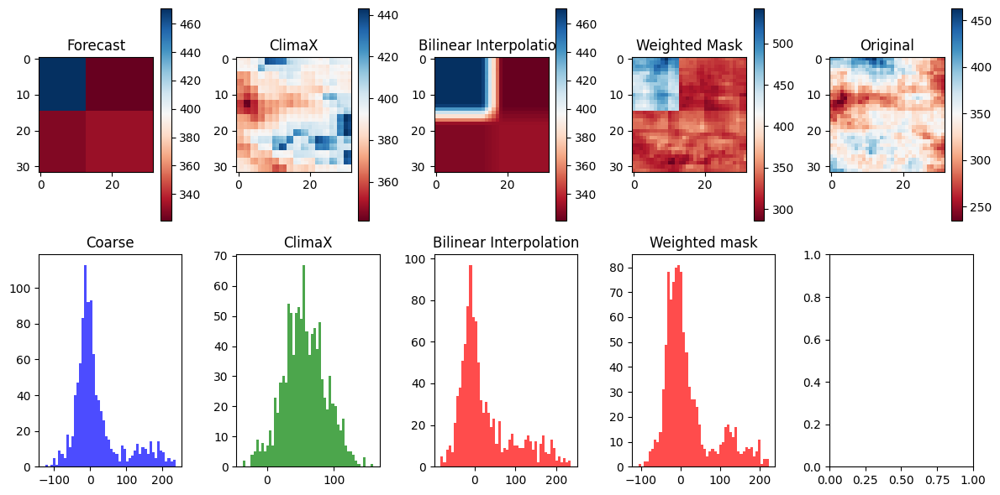

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4979.1226447462905    | 4136.441609259963  | 5349.500792366847      | 4406.262678169906   |
| lat_weighted_rmse    | 70.56289850017707     | 64.31517402028827  | 73.14028159890313      | 66.3796857341906    |
| spearman             | 0.05790620116527963   | 0.4051023414534307 | 0.026097459918806725   | 0.19684017512125657 |
| mean_bias            | 19.19287747144699     | 56.18535000085831  | 27.62806710600853      | 18.87004777789116   |
| pearson              | -0.051428880085737164 | 0.4310788912992294 | -0.0139194594204212    | 0.07913439726714867 |
+----------------------+-------------------

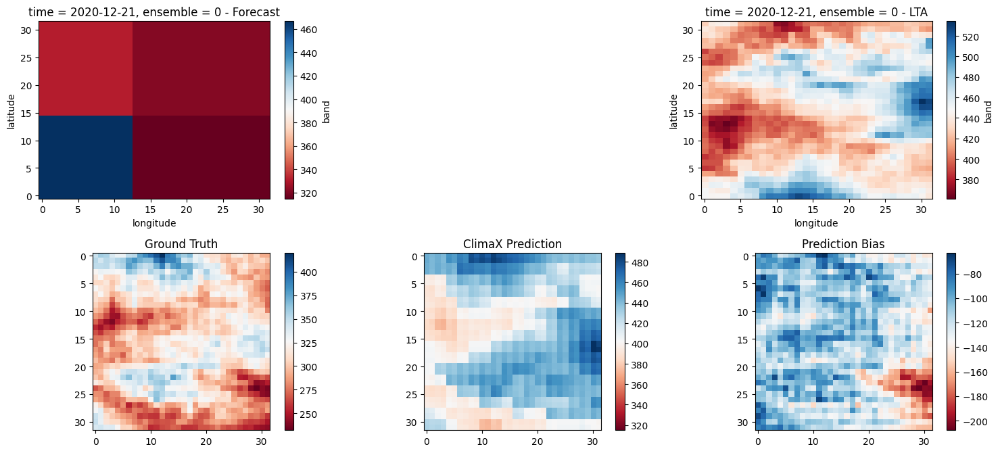

KeyboardInterrupt: 

In [31]:
for member in range(gt_xarray.shape[1]):
    for t in range(gt_xarray.shape[0]):
        visualize_climax(forecast_xarray, lta_xarray, gt_xarray, pred_xarray, bilinear_xarray, weighted_xarray, t, member)
        compare_results(gt_xarray, forecast_xarray, pred_xarray, bilinear_xarray, weighted_xarray, lat,t,member,denormalize_out)


## check data

We are interseted only in rain months, so we took 6 months between october and March

In [20]:
Rfh_lta = xr.open_dataset("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data/r1h_lta.nc")
R1h = xr.open_dataset("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data/r1h.nc")
r1h_lta = np.load("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data_npz/test/2021_00_inp.npz")['rfh_lta']

In [ ]:

for i in range(len(Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).time)):
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))
    im0 = axs[0].imshow((Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).isel(time=i).band- Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).isel(time=0).band))
    axs[0].set_title(f"Time Step {i}")
    cbar0 = plt.colorbar(im0, ax=axs[0])

    
    im1 = axs[1].imshow(r1h_lta[i,0] - r1h_lta[0,0])
    cbar1 = plt.colorbar(im1, ax=axs[1])

    plt.show()

## seasonality

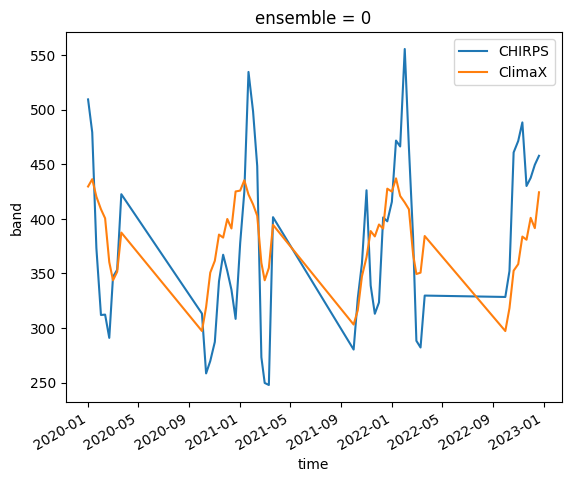

In [34]:

# gt_xarray.isel(ensemble=1,latitude=0,longitude=0).plot.line(label="CHIRPS")
(gt_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="CHIRPS")
(pred_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ClimaX")
# (forecast_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ECMWF",)
# (lta_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="LTA")
# (weighted_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Weighted")
# (bilinear_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Bilinear")
# LTA_xarray.isel(ensemble=0,latitude=0,longitude=0).plot.line(label="LTA")
plt.legend()


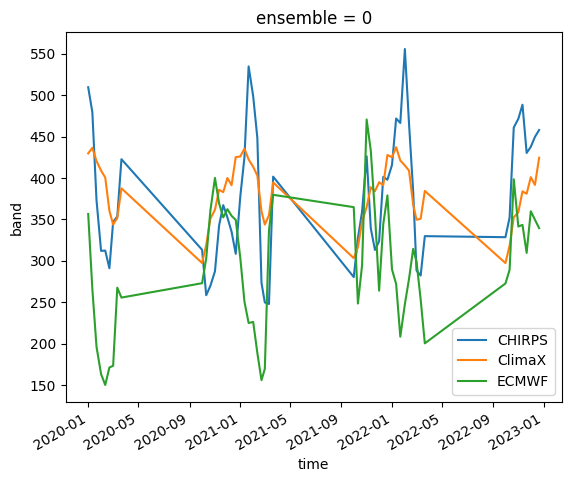

In [33]:

# gt_xarray.isel(ensemble=1,latitude=0,longitude=0).plot.line(label="CHIRPS")
(gt_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="CHIRPS")
(pred_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ClimaX")
(forecast_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ECMWF",)
# (lta_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="LTA")
# (weighted_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Weighted")
# (bilinear_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Bilinear")
# LTA_xarray.isel(ensemble=0,latitude=0,longitude=0).plot.line(label="LTA")
plt.legend()


In [ ]:

# gt_xarray.isel(ensemble=1,latitude=0,longitude=0).plot.line(label="CHIRPS")
(gt_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="CHIRPS")
(pred_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ClimaX")
(forecast_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ECMWF",)
(lta_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="LTA")
(weighted_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Weighted")
# (bilinear_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Bilinear")
# LTA_xarray.isel(ensemble=0,latitude=0,longitude=0).plot.line(label="LTA")
plt.legend()


## Influence of forecast

In [69]:
# Check if GPU is available
if torch.cuda.is_available():
    device = torch.device('cuda:0')
else:
    device = torch.device('cpu')



model.eval()

if torch.cuda.is_available():
     model.cuda()
else:
     model.cpu()


dataloader = datamodule.test_dataloader()

In [83]:
for batch_idx, batch_data in enumerate(dataloader, 1):
    if batch_idx == 2:
        # Process the nth batch (e.g., 10th batch)
        x, y, lead_times, in_vars, out_vars = batch_data

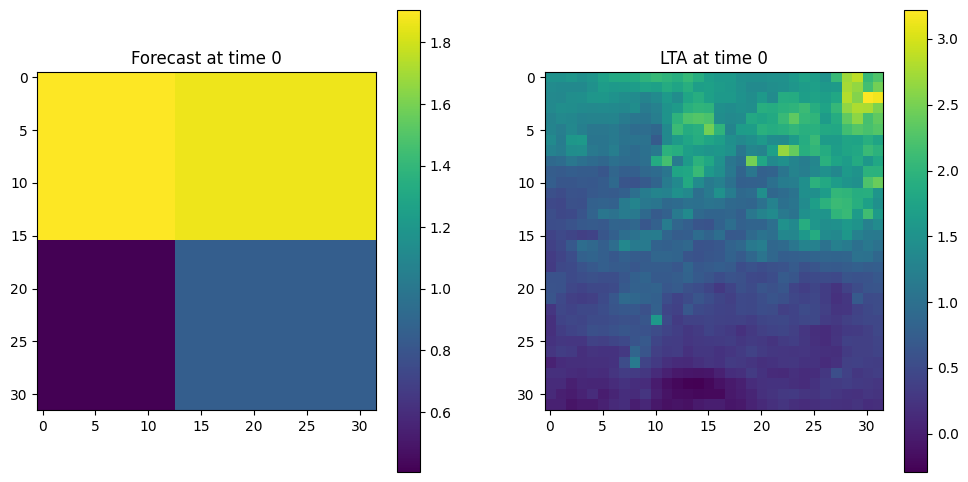

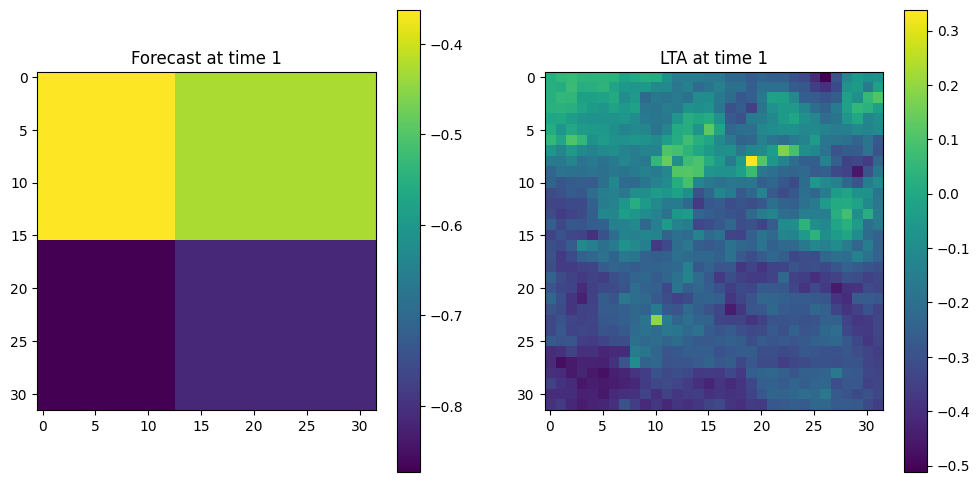

In [88]:
forecast_0 = x[0,0]
lta_0 = x[0,1]


fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

im1 = ax1.imshow(forecast_0)
ax1.set_title('Forecast at time 0')

ax1.grid(False)  # Optional: Turn off grid lines

# Display the second image (lta_0) in the second subplot (ax2)
im2 = ax2.imshow(lta_0)
ax2.set_title('LTA at time 0')

ax2.grid(False)  # Optional: Turn off grid lines


# Add colorbars for both images
cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)

plt.show()

forecast_1 = x[50,0]
lta_1 = x[50,1]

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Display the first image (forecast_0) in the first subplot (ax1)
im1 = ax1.imshow(forecast_1)
ax1.set_title('Forecast at time 1')

ax1.grid(False)  # Optional: Turn off grid lines

# Display the second image (lta_0) in the second subplot (ax2)
im2 = ax2.imshow(lta_1)
ax2.set_title('LTA at time 1')

ax2.grid(False)  # Optional: Turn off grid lines


# Add colorbars for both images
cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)

plt.show()


prediction


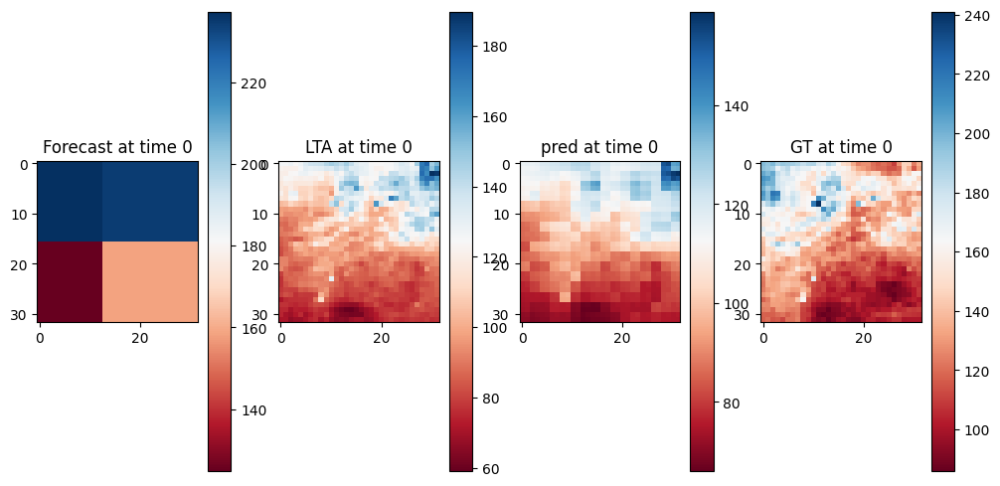

In [138]:
forecast_0 = x[0,0]
lta_0 = x[0,1]

gt_0,pred_0,tensors_0= downscale(forecast_0, lta_0, y = y[:1])

fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(12, 6))

im1 = ax1.imshow(tensors_0[0][0],  cmap=plt.cm.RdBu)
ax1.set_title('Forecast at time 0')

im2 = ax2.imshow(tensors_0[1][0],  cmap=plt.cm.RdBu)
ax2.set_title('LTA at time 0')


im3 = ax3.imshow(pred_0[0,0],  cmap=plt.cm.RdBu)
ax3.set_title('pred at time 0')

im4 = ax4.imshow(gt_0[0,0],  cmap=plt.cm.RdBu)
ax4.set_title('GT at time 0')

cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)
cbar2 = fig.colorbar(im3, ax=ax3)
cbar2 = fig.colorbar(im4, ax=ax4)

plt.show()

prediction


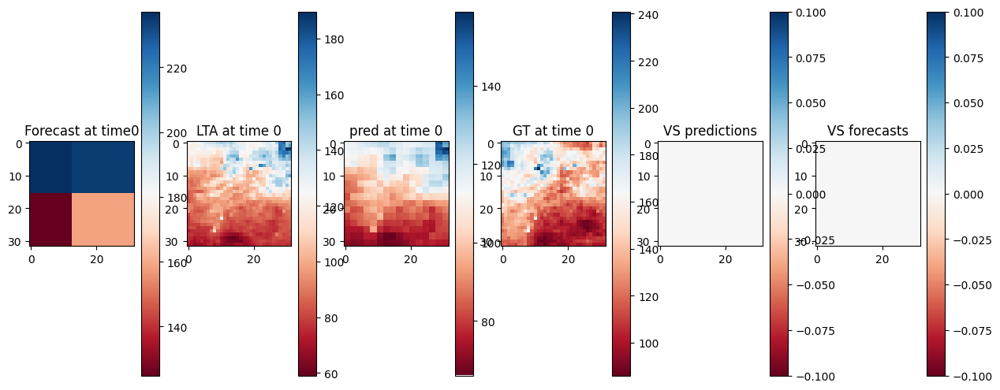

prediction


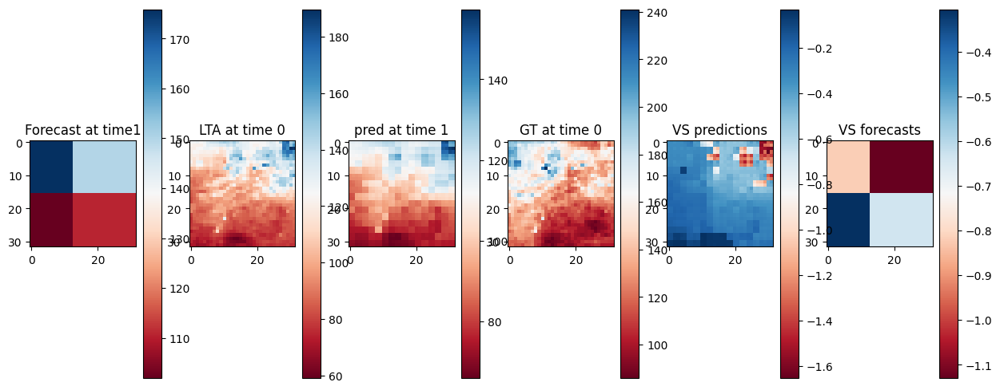

prediction


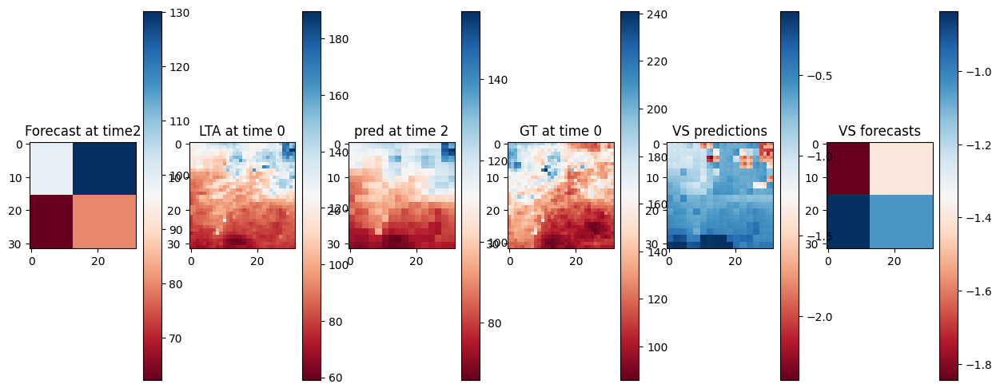

prediction


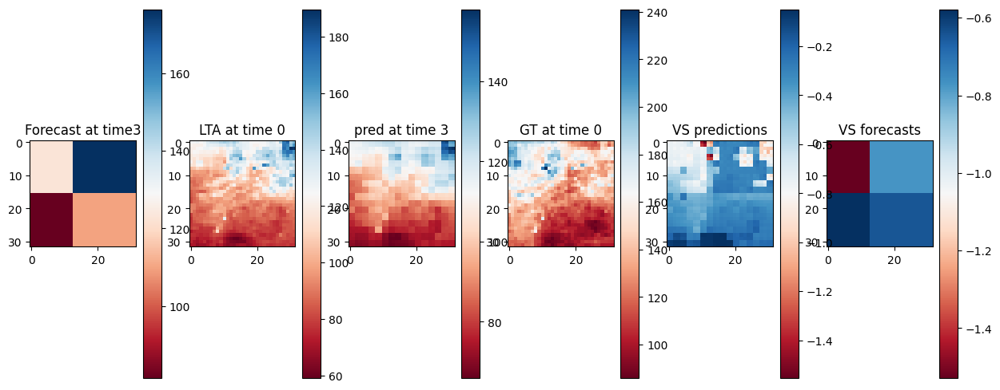

prediction


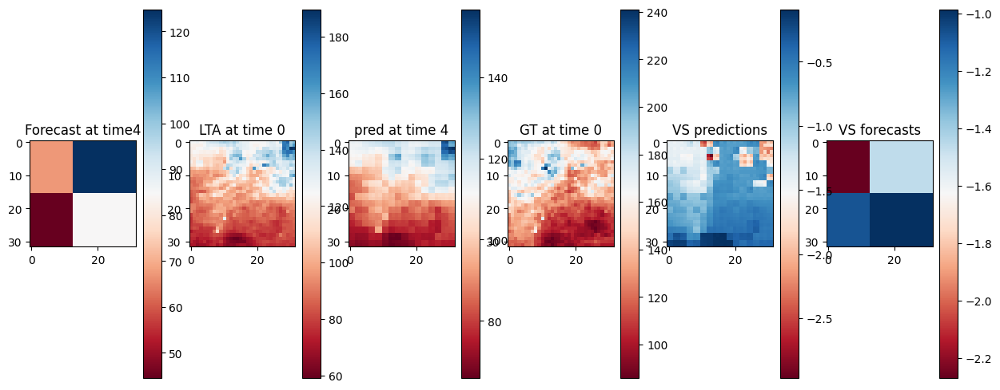

prediction


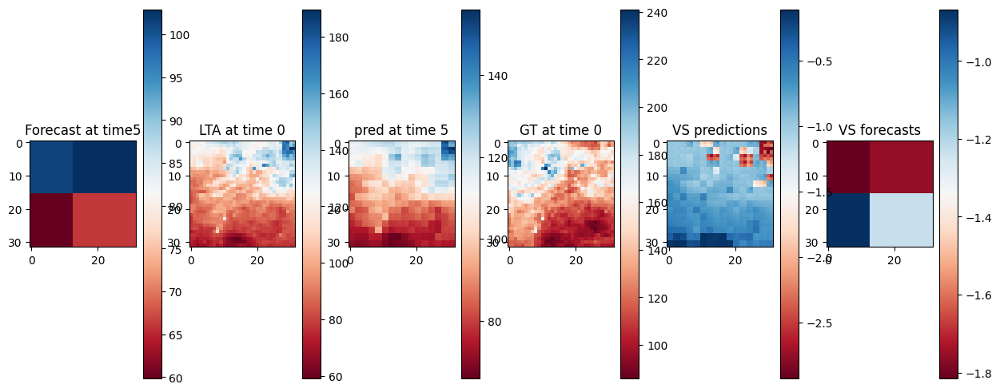

prediction


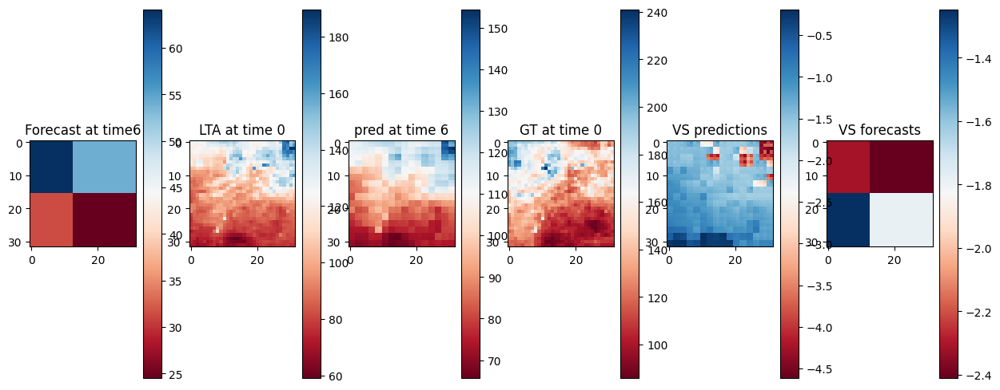

prediction


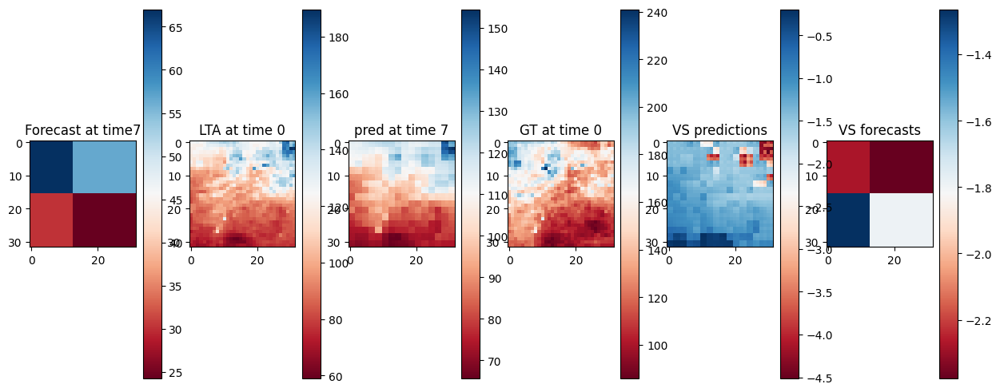

prediction


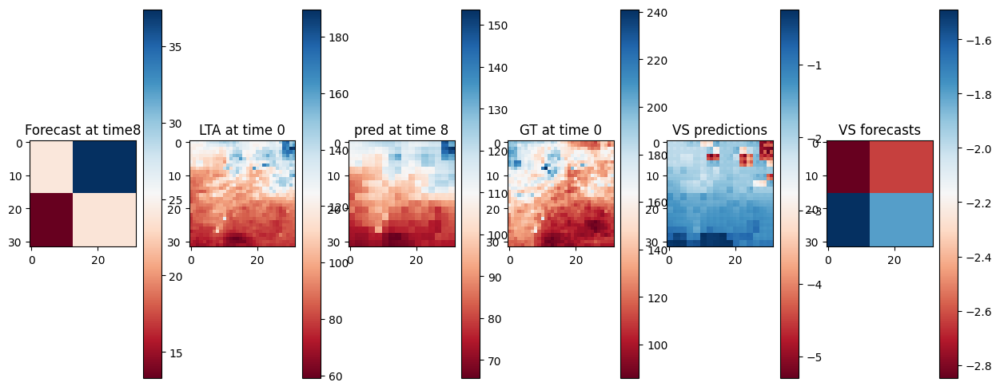

prediction


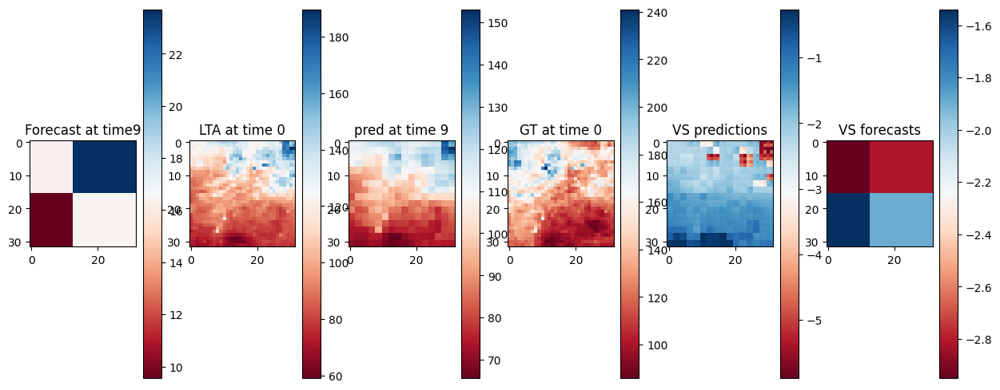

prediction


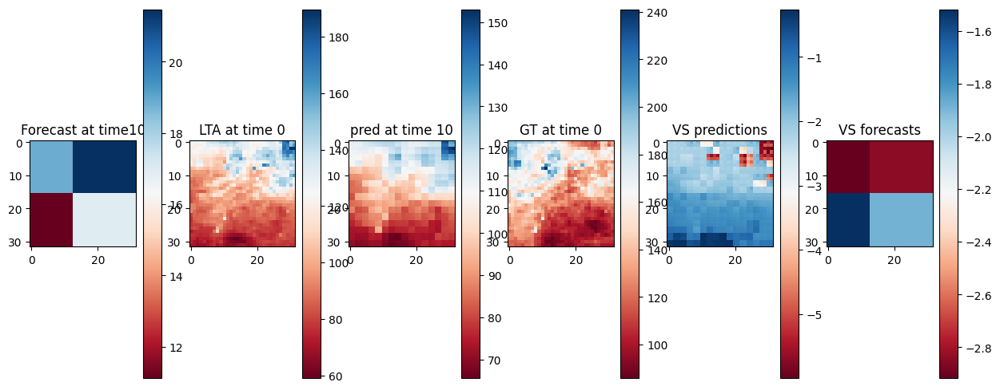

prediction


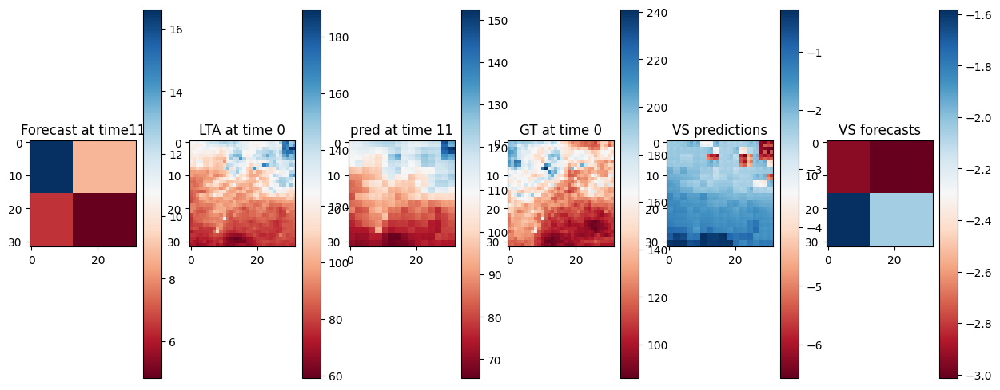

prediction


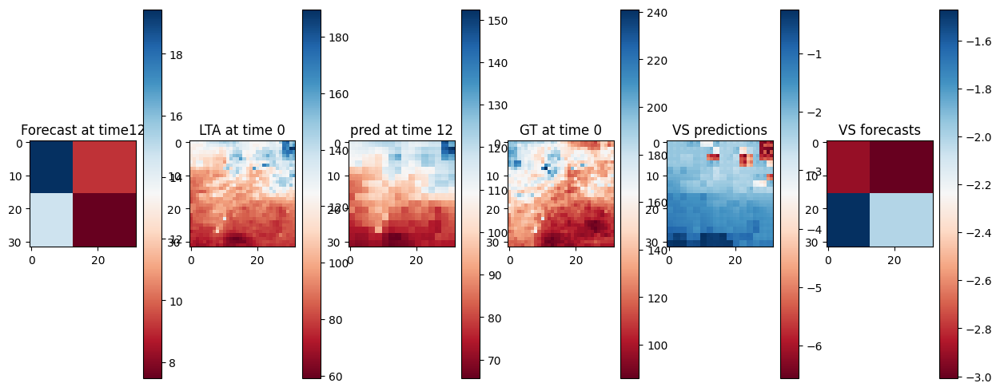

prediction


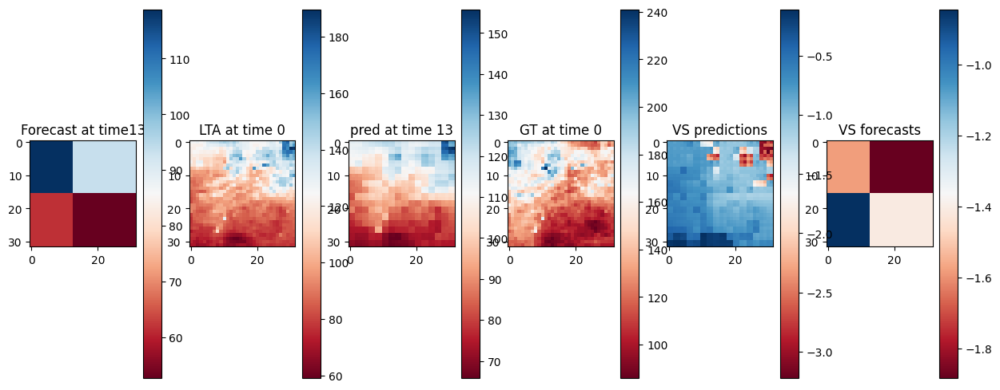

prediction


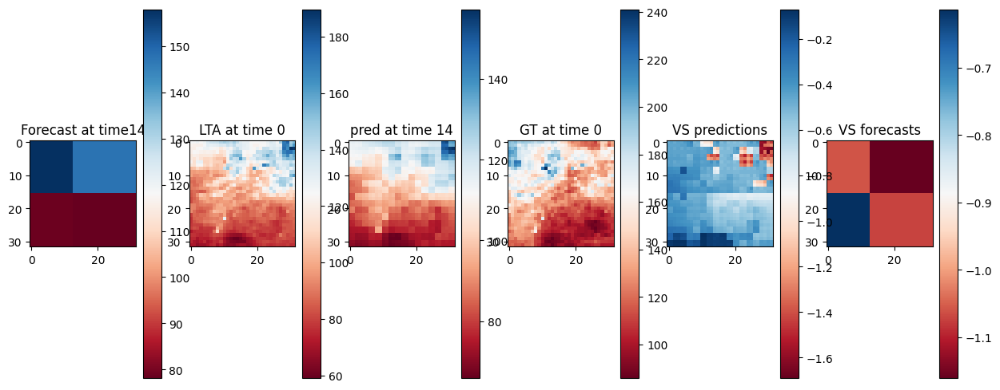

prediction


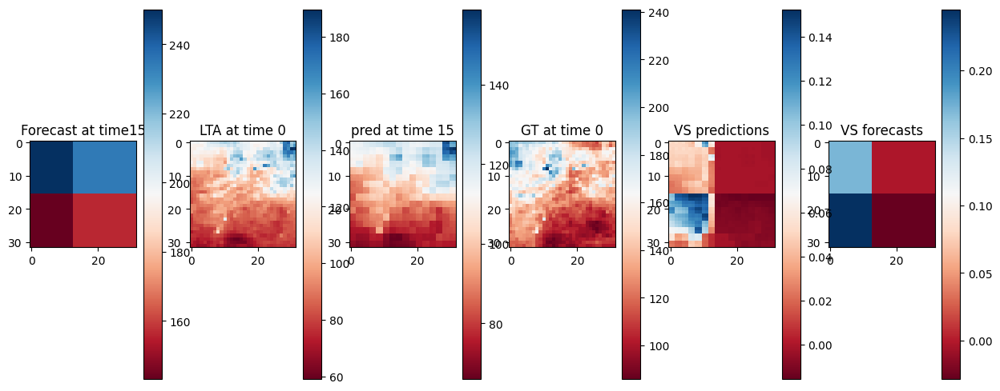

prediction


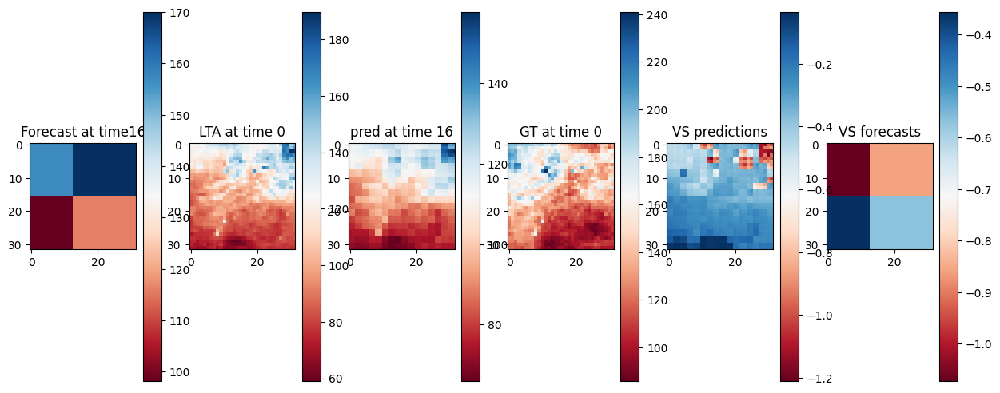

prediction


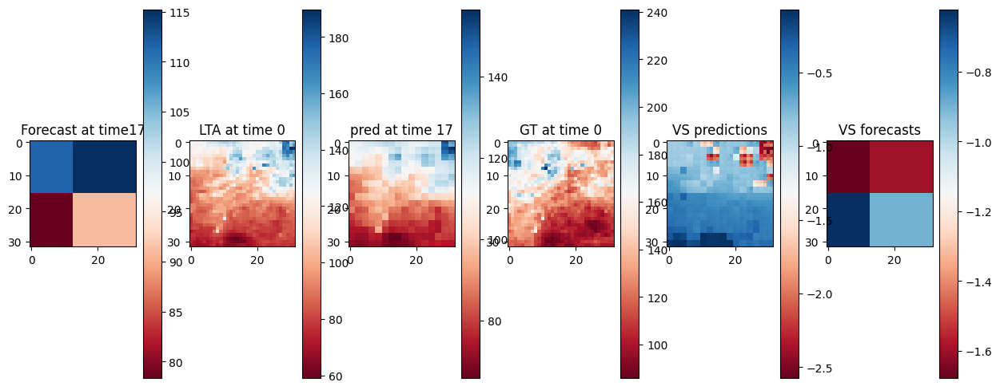

prediction


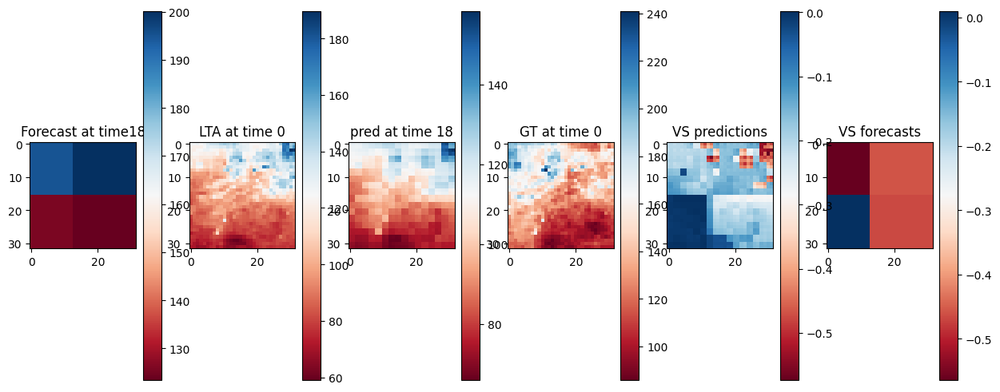

prediction


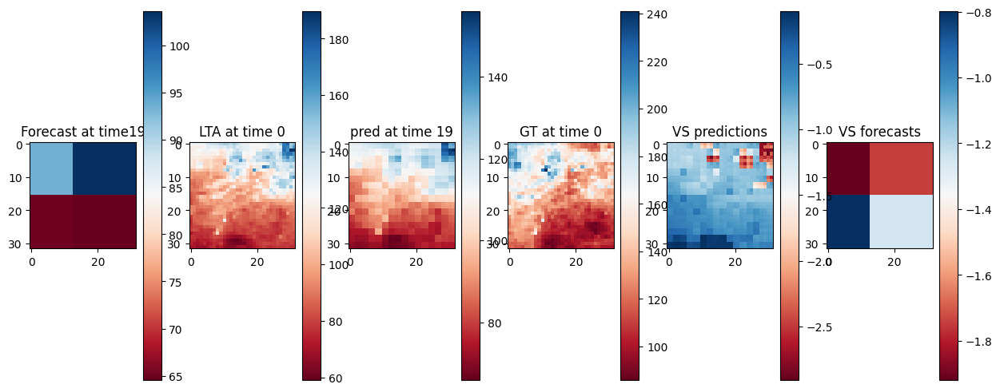

prediction


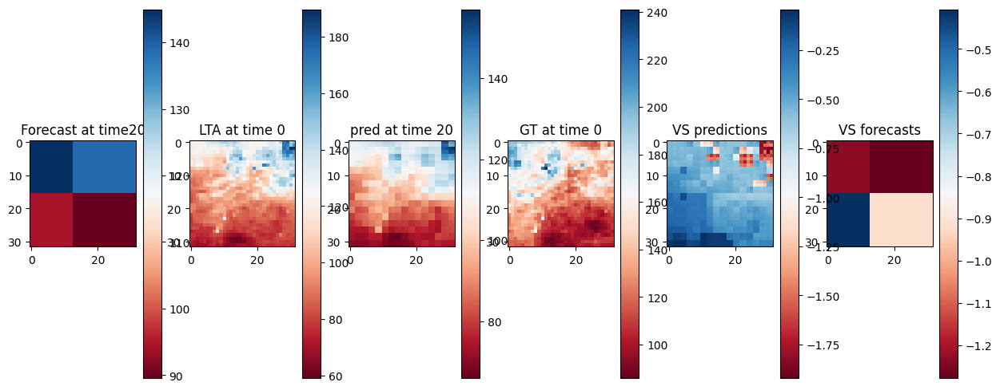

prediction


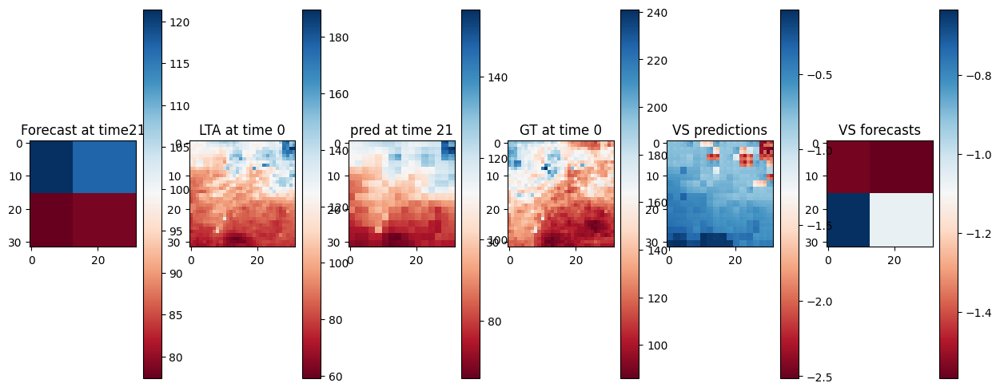

prediction


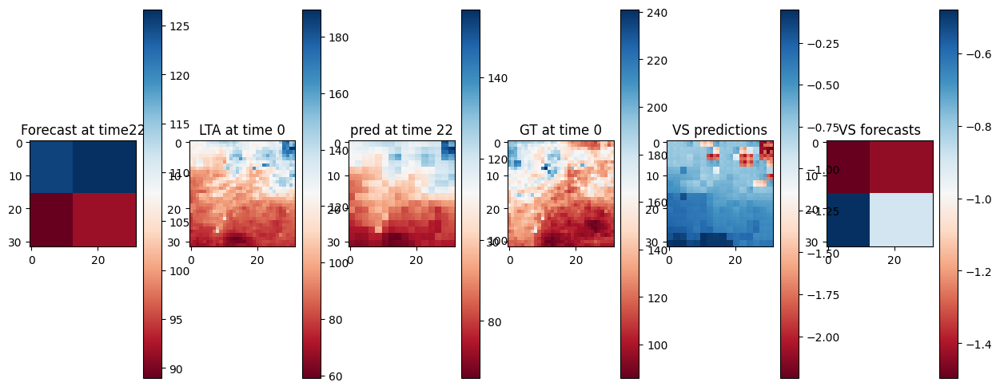

prediction


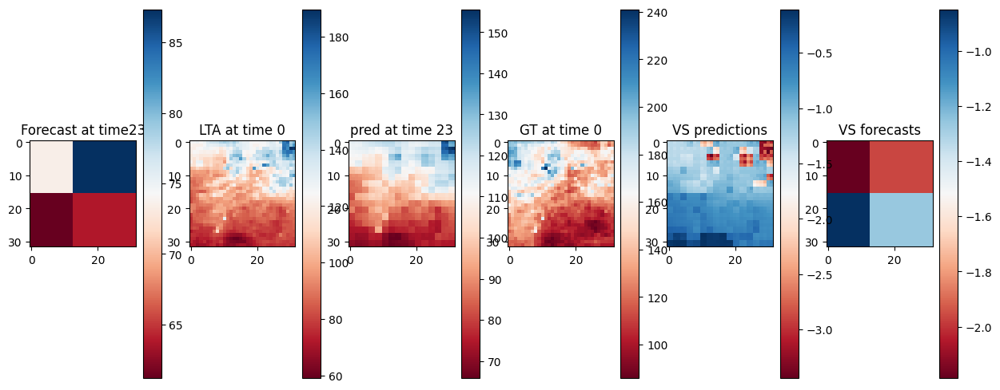

prediction


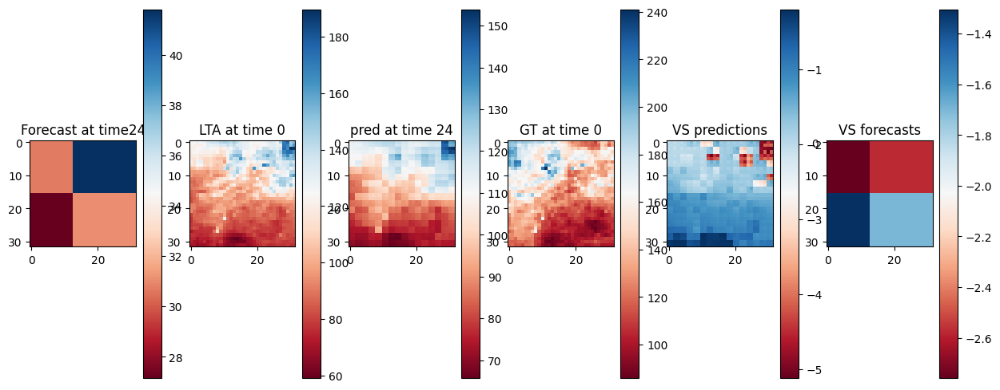

prediction


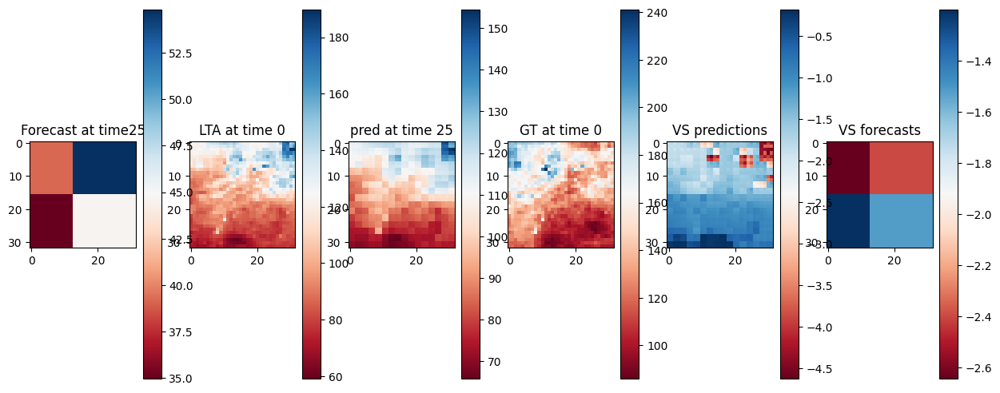

prediction


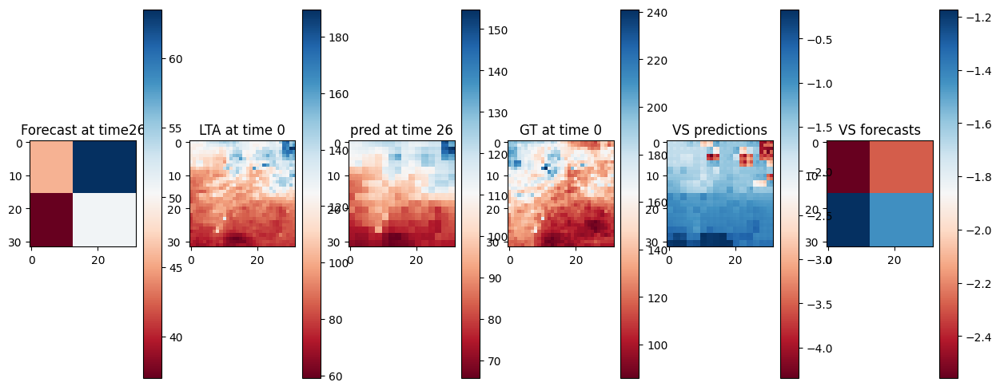

prediction


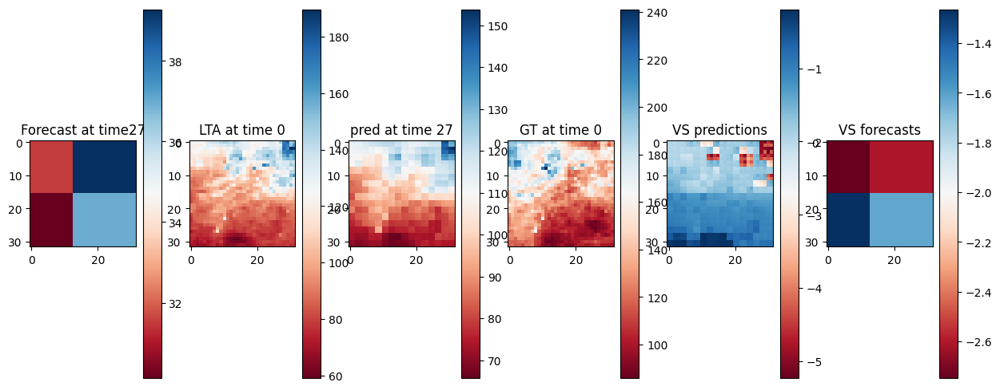

prediction


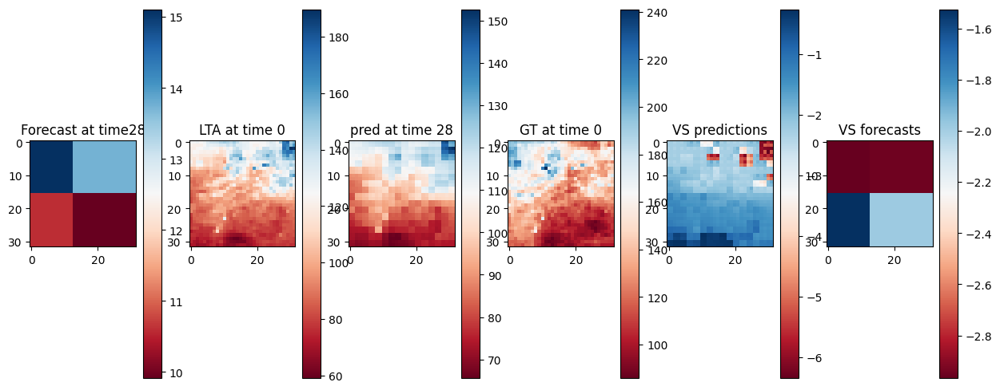

prediction


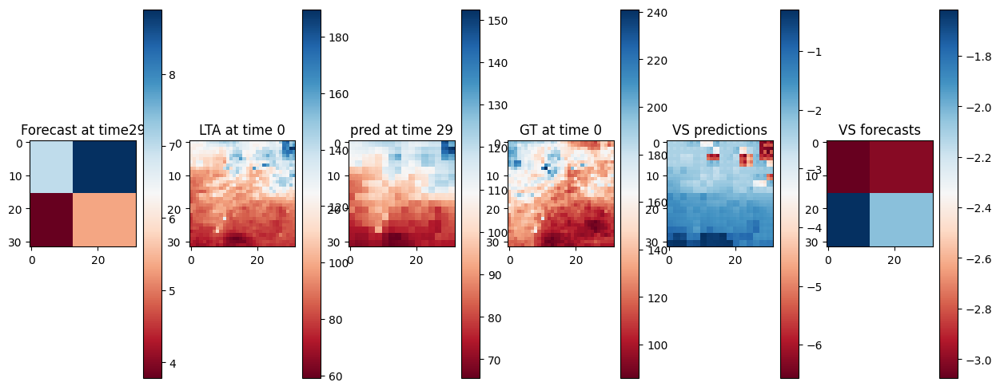

In [145]:
for t in range(30):
    
    forecast_1 = x[t,0]
    lta_0 = x[0,1]

    gt_1,pred_1,tensors_1= downscale(forecast_1, lta_0, y = y[:1])

    fig, (ax1, ax2, ax3, ax4,ax5, ax6) = plt.subplots(1, 6, figsize=(15, 6))

    im1 = ax1.imshow(tensors_1[0][0],  cmap=plt.cm.RdBu)
    ax1.set_title(f'Forecast at time{t}')

    im2 = ax2.imshow(tensors_1[1][0],  cmap=plt.cm.RdBu)
    ax2.set_title('LTA at time 0')


    im3 = ax3.imshow(pred_1[0,0],  cmap=plt.cm.RdBu)
    ax3.set_title(f'pred at time {t}')

    im4 = ax4.imshow(gt_1[0,0],  cmap=plt.cm.RdBu)
    ax4.set_title('GT at time 0')

    im5 = ax5.imshow(pred_1[0,0] - pred_0[0,0],  cmap=plt.cm.RdBu)
    ax5.set_title('VS predictions')
    
    im6 = ax6.imshow(forecast_1  - forecast_0 ,  cmap=plt.cm.RdBu)
    ax6.set_title('VS forecasts')

    cbar1 = fig.colorbar(im1, ax=ax1)
    cbar2 = fig.colorbar(im2, ax=ax2)
    cbar3 = fig.colorbar(im3, ax=ax3)
    cbar4 = fig.colorbar(im4, ax=ax4)
    cbar5 = fig.colorbar(im5, ax=ax5)
    cbar6 = fig.colorbar(im6, ax=ax6)

    plt.show()

In [129]:
def downscale(forecast, lta, y,lead_times = lead_times, in_vars=in_vars, ou_vars=out_vars, model_module = model, data_module = datamodule,mean_norm=mean_norm, std_norm=std_norm, pred_task=pred_range, var_name="R1H", var_id=1,data_path=None, save_path = None, desired_batch_index = 25):
    
    x = torch.stack([forecast, lta], dim=0).unsqueeze(0)
    lead_times = lead_times[:1]
            
    
    if torch.cuda.is_available():
        lead_times = lead_times.cuda()
    else:
        lead_times = lead_times.cpu()
      
    if torch.cuda.is_available():
        x = x.cuda()
        y = y.cuda()
    else:
        x = x.cpu()
        y = y.cpu()
        
    print("prediction")
    
    with torch.no_grad():
        _, pred = model_module.net.forward(x, y, lead_times, in_vars, out_vars, None, model_module.lat)
        
    
    
    inv_normalize = model_module.denormalization
    
    
    tensors=[]
    for i in range(x.shape[1]):
        tensors.append(inv_normalize(x)[:,i])
    init_condition = inv_normalize(x)[:,0]

    
    normalization = data_module.output_transforms
    mean_norm, std_norm = normalization.mean, normalization.std
    x = x[:, var_id,:]
    gt = y * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    pred = pred * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    bias = pred - gt
    tensors_pred = [init_condition, gt, pred, bias]
    

    
        
    del x
    del y
    return gt,pred,tensors

## variability between members

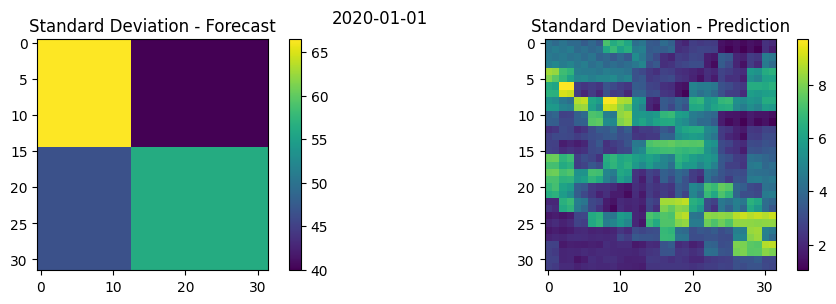

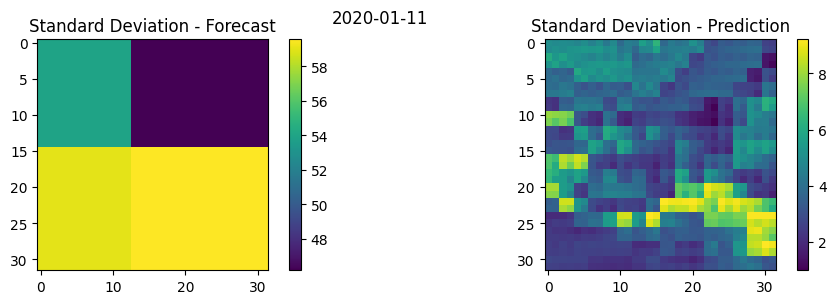

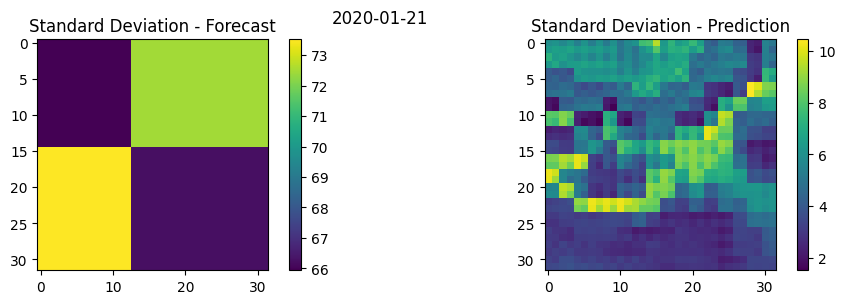

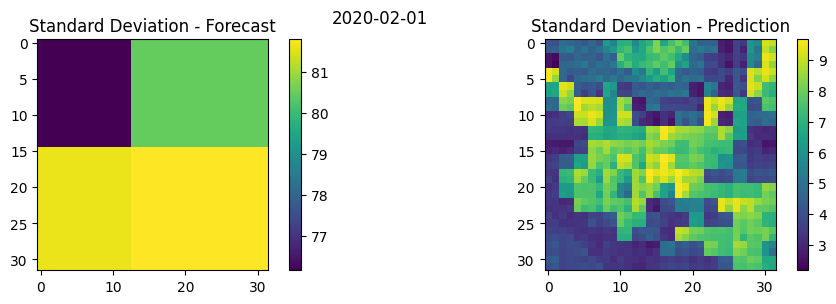

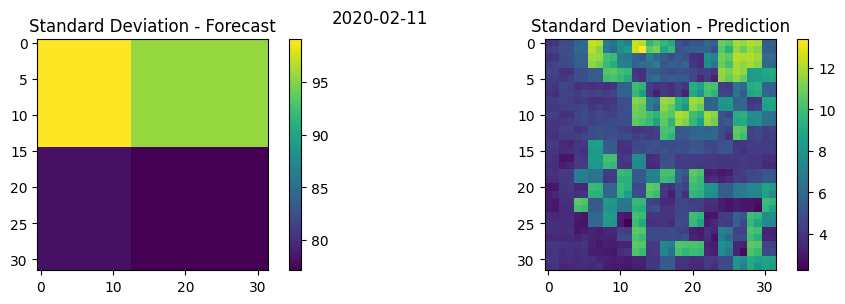

...

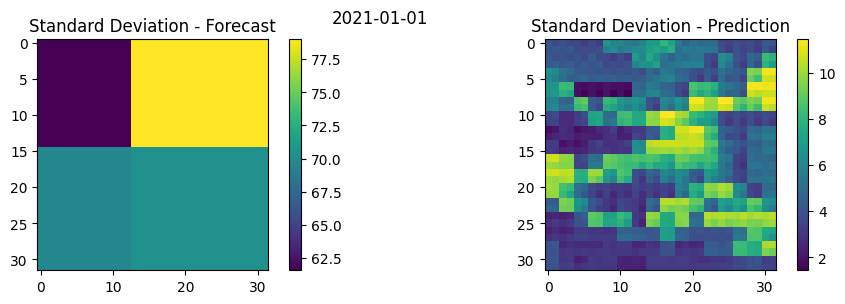

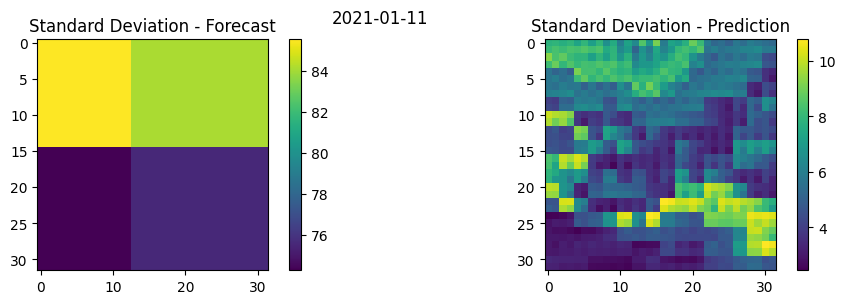

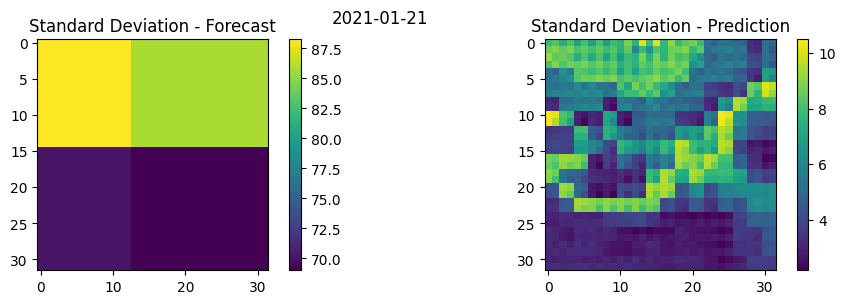

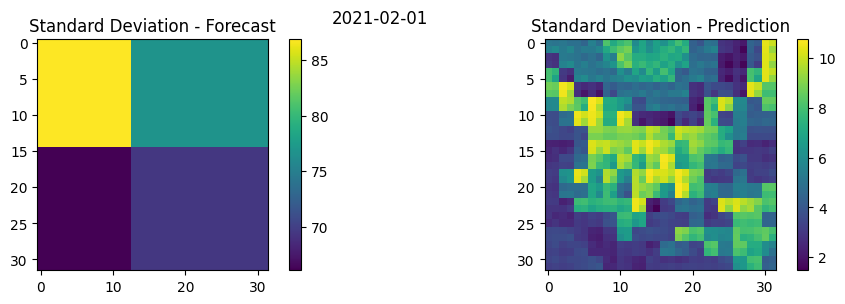

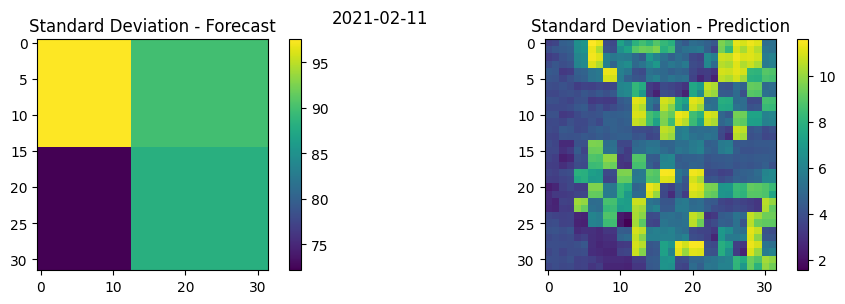

KeyboardInterrupt: 

In [14]:
import xarray as xr
import matplotlib.pyplot as plt

# Assuming your data is stored in the 'pred_xarray' variable

for t in range(pred_xarray.shape[0]):
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))
    
    # Plot the standard deviation for the current time step
    std_deviation = forecast_xarray.isel(time=t).std(dim='ensemble')
    im0 = axs[0].imshow(std_deviation)
    axs[0].set_title(f'Standard Deviation - Forecast')
    cbar0 = plt.colorbar(im0, ax=axs[0])  # Add colorbar for the first subplot
    
    # Plot the original data for the current time step (adjust as needed)
    original_data = pred_xarray.isel(time=t).std(dim='ensemble')
    im1 = axs[1].imshow(original_data)
    axs[1].set_title("Standard Deviation - Prediction")
    cbar1 = plt.colorbar(im1, ax=axs[1])  # Add colorbar for the second subplot
    
    # Set the title of the entire figure
    plt.suptitle(pred_xarray.isel(time=t).time.values.astype('datetime64[D]'))
    
    plt.show()


In [ ]:

for t in range(0, init_cond.shape[0], t_step):
    subarray_forecast = init_cond_normalized[t:t + t_step]
    subarray_downscaled = pred_normalized[t:t + t_step, 0]

    std_image_forecast = torch.std(subarray_forecast, dim=0)
    std_image_downscaled = torch.std(subarray_downscaled, dim=0)
    
    # Calculate the mean of std_image_forecast and std_image_downscaled
    mean_std_forecast = std_image_forecast.mean().item()
    mean_std_downscaled = std_image_downscaled.mean().item()

    # Create subplots with two columns
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))

    # Display std_image_forecast on the first subplot
    axs[0].imshow(std_image_forecast)
    axs[0].set_title('Std. Deviation (Forecast)')
    cbar = plt.colorbar(axs[0].imshow(std_image_forecast), ax=axs[0])
    axs[0].text(0.5, 0.95, f"Mean: {mean_std_forecast}", transform=axs[0].transAxes, color='white')
    
    # Display std_image_downscaled on the second subplot
    axs[1].imshow(std_image_downscaled)
    axs[1].set_title('Std. Deviation (Downscaled)')
    cbar = plt.colorbar(axs[1].imshow(std_image_downscaled), ax=axs[1])
    axs[1].text(0.5, 0.95, f"Mean: {mean_std_downscaled}", transform=axs[1].transAxes, color='white')

    plt.tight_layout()
    plt.show()


# Jordan

define the model and the dataset of test. The test dataset is between 1st of January 2020 and 2023

In [6]:
batch_size=360
task = "10 days"
pred_range = 0

net_args = {
    'default_vars': [
        'forecast', 'rfh_lta', 'rfh']
    ,"img_size" :  [32, 32],
      "patch_size" :  2,
      "embed_dim":   2048,
      "depth" : 8,
      "decoder_depth" :  2,
      "num_heads": 16,
    "mlp_ratio": 2,
    "drop_path": 0.5,
    "drop_rate": 0.5,
    
}
net = ClimaX(**net_args)

model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_002-v7.ckpt') #Malysia

datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Jordan/region_{1}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )
normalization = datamodule.transforms
print(normalization)
mean_norm, std_norm = normalization.mean, normalization.std
mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
model.set_denormalization(mean_denorm, std_denorm)
model.set_lat_lon(*datamodule.get_lat_lon())

denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)
datamodule.setup()


Loading pre-trained checkpoint from: ClimaX/exps/downscale/checkpoints/epoch_002-v7.ckpt
<All keys matched successfully>
Normalize(mean=[19.48584113 25.9895367 ], std=[17.58248031 16.78152851])


In [5]:
for i in range(1,2):
    print(i)
    datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Malaysia/region_{i}/data_npz/',
            variables=['forecast', 'rfh_lta'],
            out_variables=['rfh'],
            buffer_size= 2000,
            batch_size= batch_size
        )
    normalization = datamodule.transforms
    print(normalization)
    mean_norm, std_norm = normalization.mean, normalization.std
    mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
    model.set_denormalization(mean_denorm, std_denorm)
    model.set_lat_lon(*datamodule.get_lat_lon())

    denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)
    datamodule.setup()

    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2020)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Malaysia/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2020.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2020.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2020.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2020.pt'))
    
    
    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2021)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Malaysia/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2021.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2021.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2021.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2021.pt'))
    
    gt,pred,tensors,tensors_pred = climax_downscale(model, datamodule,mean_norm, std_norm, var_id = 1,year_to_select=2022)
    forecast, rfh_lta = tensors[0], tensors[1]
    
    save_path=  f"Data/Downscaling/Rainfall/Malaysia/region_{i}"

    torch.save(gt, os.path.join(save_path, 'ground_truth_2022.pt'))
    torch.save(pred, os.path.join(save_path, 'pred_2022.pt'))
    torch.save(tensors, os.path.join(save_path, 'tensors_2022.pt'))
    torch.save(tensors_pred, os.path.join(save_path, 'tensors_pred_2022.pt'))
    
    


1
Normalize(mean=[308.43711434 384.73586073], std=[80.09031047 64.48521206])


/home/u/wessim.omezzine/.local/lib/python3.10/site-packages/torch/cuda/__init__.py:546: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


Selected device: cpu
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2}
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2}
Selected device: cpu
Selected device: cpu


In [27]:
save_path = f"Data/Downscaling/Rainfall/Malaysia/region_{1}"

gt_2020 = torch.load(os.path.join(save_path, 'ground_truth_2020.pt'))
pred_2020 = torch.load(os.path.join(save_path, 'pred_2020.pt'))
forecast_2020 = torch.load(os.path.join(save_path, 'tensors_2020.pt'))[0].unsqueeze(1)
lta_2020 = torch.load(os.path.join(save_path, 'tensors_2020.pt'))[1].unsqueeze(1)
tensors_2020 = torch.load(os.path.join(save_path, 'tensors_pred_2020.pt'))

gt_2021 = torch.load(os.path.join(save_path, 'ground_truth_2021.pt'))
pred_2021 = torch.load(os.path.join(save_path, 'pred_2021.pt'))
forecast_2021 = torch.load(os.path.join(save_path, 'tensors_2021.pt'))[0].unsqueeze(1)
lta_2021 = torch.load(os.path.join(save_path, 'tensors_2021.pt'))[1].unsqueeze(1)
tensors_pred_2021 = torch.load(os.path.join(save_path, 'tensors_pred_2021.pt'))

gt_2022 = torch.load(os.path.join(save_path, 'ground_truth_2022.pt'))
pred_2022 = torch.load(os.path.join(save_path, 'pred_2022.pt'))
tensors_2022 = torch.load(os.path.join(save_path, 'tensors_2022.pt'))
forecast_2022 = torch.load(os.path.join(save_path, 'tensors_2022.pt'))[0].unsqueeze(1)
lta_2022 = torch.load(os.path.join(save_path, 'tensors_2022.pt'))[1].unsqueeze(1)
tensors_pred_2022 = torch.load(os.path.join(save_path, 'tensors_pred_2022.pt'))

In [28]:
gt = torch.cat([gt_2020,gt_2021, gt_2022],dim=0)
pred = torch.cat([pred_2020,pred_2021, pred_2022],dim=0)
forecast = torch.cat([forecast_2020,forecast_2021, forecast_2022],dim=0)
lta = torch.cat([lta_2020,lta_2021, lta_2022],dim=0)


In [29]:
def bilinear_interpolate (forecast,t,verbose=False):
    new_height = forecast.shape[1]
    new_width = forecast.shape[2]
    forecast_resample=forecast[t]
    image_tensor  = forecast_resample[:30:5,:30:5]
    
    rescaled_image = F.interpolate(image_tensor.unsqueeze(0).unsqueeze(0), size=(new_height, new_width), mode='bilinear', align_corners=False)[0]
    
    if verbose:
        
        plt.imshow(rescaled_image)
        plt.show()
    
    
    
    return rescaled_image

In [30]:
gt.shape

torch.Size([1080, 1, 32, 32])

In [31]:
360*3

1080

In [33]:
bilinear = torch.clone(forecast)
weighted= torch.clone(forecast)
i,j=0,0
for t in range(gt.shape[0]):
    bilinear[t:t+1,0,32*(i):32*(i+1), 32*(j):32*(j+1)] = bilinear_interpolate(forecast[:,0,32*(i):32*(i+1), 32*(j):32*(j+1)],t)
    weighted[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)] = torch.tensor(Downscale_Weight(lta[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)].cpu().numpy(),forecast[t,0,32*(i):32*(i+1), 32*(j):32*(j+1)].cpu().numpy()))

In [34]:
def tensor_to_xarray(tensor, ensemble,batch_size, path_to_data,lat_shape=96, long_shape=64, element_per_year=18, start_year=2020, end_year=2020):
    time = xr.open_dataset(os.path.join(path_to_data,"data/r1h_lta.nc")).time
    time_sorted = time['time'].sortby('time')
    time_axis = time_sorted
    time_axis = np.unique(time_axis.time.values)
    time_axis = time_axis[np.logical_and(time_axis >= np.datetime64(f'{start_year}-01-01'), time_axis < np.datetime64(f'{end_year}-12-31'))]
    
    latitude = np.arange(lat_shape)
    longitude = np.arange(long_shape)
    ensemble_indices =np.arange(ensemble)

    # Create an empty DataArray with the desired dimensions and coordinates
    tensor_xarray = xr.DataArray(
        np.empty((batch_size//ensemble, ensemble, lat_shape, long_shape)),  # Empty array with the desired shape
        coords={
            'time': time_axis,
            'latitude': latitude,
            'longitude': longitude,
            'ensemble': ensemble_indices,
        },
        dims=['time', 'ensemble', 'latitude', 'longitude'],
        name='band'
    )

    # Loop over ensembles and assign the corresponding data from gt
    for i in range(ensemble):
        start_index = i * element_per_year
        end_index = (i + 1) * element_per_year

        data = np.concatenate([tensor[start_index:end_index], tensor[start_index + element_per_year*ensemble:end_index + element_per_year*ensemble]], axis=0)

        # print(start_index, end_index,"        ",  start_index + 180, end_index + 180, "     ", start_index + 360, end_index + 360)
        # data = np.concatenate([gt[start_index:end_index], gt[start_index + 180:end_index + 180], gt[start_index + 360:end_index + 360]], axis=0)
        if len(data.shape) ==4:
            tensor_xarray[:,i] = data[:,0,:,:]
        else:
            tensor_xarray[:,i] = data[:,:,:]
            
    return tensor_xarray

In [37]:
ensemble=20
region = 2
gt2020_xarray = tensor_to_xarray(gt[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
pred2020_xarray = tensor_to_xarray(pred[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
forecast2020_xarray = tensor_to_xarray(forecast[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
lta2020_xarray = tensor_to_xarray(lta[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
bilinear2020_xarray = tensor_to_xarray(bilinear[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)
weighted2020_xarray = tensor_to_xarray(weighted[:360],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2020, end_year=2020)



gt2021_xarray = tensor_to_xarray(gt[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
pred2021_xarray = tensor_to_xarray(pred[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
forecast2021_xarray = tensor_to_xarray(forecast[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
lta2021_xarray = tensor_to_xarray(lta[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
bilinear2021_xarray = tensor_to_xarray(bilinear[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)
weighted2021_xarray = tensor_to_xarray(weighted[360:720],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2021, end_year=2021)


gt2022_xarray = tensor_to_xarray(gt[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
pred2022_xarray = tensor_to_xarray(pred[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
forecast2022_xarray = tensor_to_xarray(forecast[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
lta2022_xarray = tensor_to_xarray(lta[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
bilinear2022_xarray = tensor_to_xarray(bilinear[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)
weighted2022_xarray = tensor_to_xarray(weighted[720:],ensemble,batch_size,path_to_data=f"Data/Downscaling/Rainfall/Mozambique/Regions/region_{region}", lat_shape=32, long_shape=32, start_year=2022, end_year=2022)


In [40]:
gt_xarray = xr.concat([gt2020_xarray, gt2021_xarray, gt2022_xarray], dim='time')
pred_xarray = xr.concat([pred2020_xarray, pred2021_xarray, pred2022_xarray], dim='time')

forecast_xarray = xr.concat([forecast2020_xarray, forecast2021_xarray, forecast2022_xarray], dim='time')
lta_xarray = xr.concat([lta2020_xarray, lta2021_xarray, lta2022_xarray], dim='time')
bilinear_xarray = xr.concat([bilinear2020_xarray, bilinear2021_xarray, bilinear2022_xarray], dim='time')
weighted_xarray = xr.concat([weighted2020_xarray, weighted2021_xarray, weighted2022_xarray], dim='time')


In [42]:
import shutil
# Define the directory where to save the files
save_dir = f"Data/Downscaling/Rainfall/Malaysia/"

# Remove all files in the directory
for filename in os.listdir(save_dir):
    file_path = os.path.join(save_dir, filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
    except Exception as e:
        print(f'Failed to delete {file_path}. Reason: {e}')

# Ensure the directory exists
os.makedirs(save_dir, exist_ok=True)
gt_xarray.to_netcdf(os.path.join(save_dir, 'gt_xarray.nc'))
pred_xarray.to_netcdf(os.path.join(save_dir, 'pred_xarray.nc'))
forecast_xarray.to_netcdf(os.path.join(save_dir, 'forecast_xarray.nc'))
lta_xarray.to_netcdf(os.path.join(save_dir, 'lta_xarray.nc'))
bilinear_xarray.to_netcdf(os.path.join(save_dir, 'bilinear_xarray.nc'))
weighted_xarray.to_netcdf(os.path.join(save_dir, 'weighted_xarray.nc'))


In [29]:
import xarray as xr

# Define the directory where the files are saved
save_dir = "Data/Downscaling/Rainfall/Malaysia/"

# Create a dictionary to hold the data
data_dict = {}

gt_xarray = xr.open_dataarray(os.path.join(save_dir, f'gt_xarray.nc'))
pred_xarray = xr.open_dataarray(os.path.join(save_dir, f'pred_xarray.nc'))
forecast_xarray = xr.open_dataarray(os.path.join(save_dir, f'forecast_xarray.nc'))
lta_xarray=xr.open_dataarray(os.path.join(save_dir, f'lta_xarray.nc'))
bilinear_xarray=xr.open_dataarray(os.path.join(save_dir, f'bilinear_xarray.nc'))
weighted_xarray = xr.open_dataarray(os.path.join(save_dir, f'weighted_xarray.nc'))



In [30]:
lat = datamodule.get_lat_lon()[0]

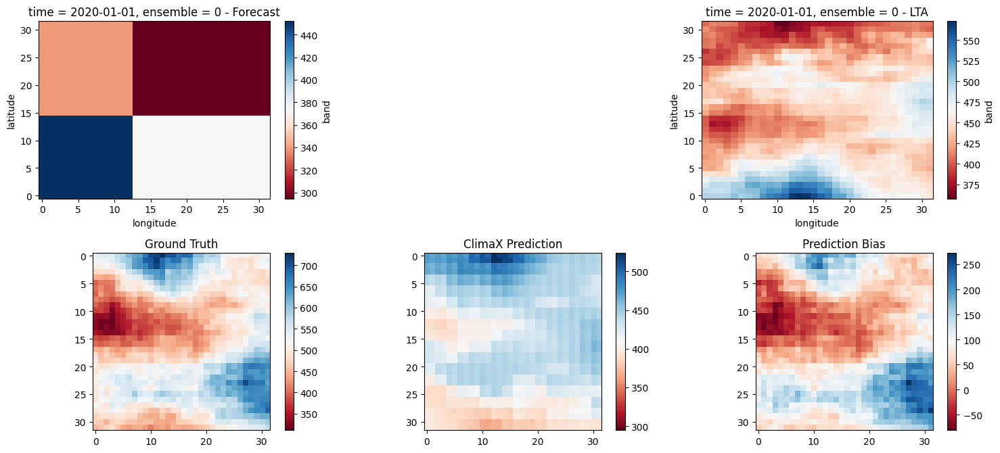

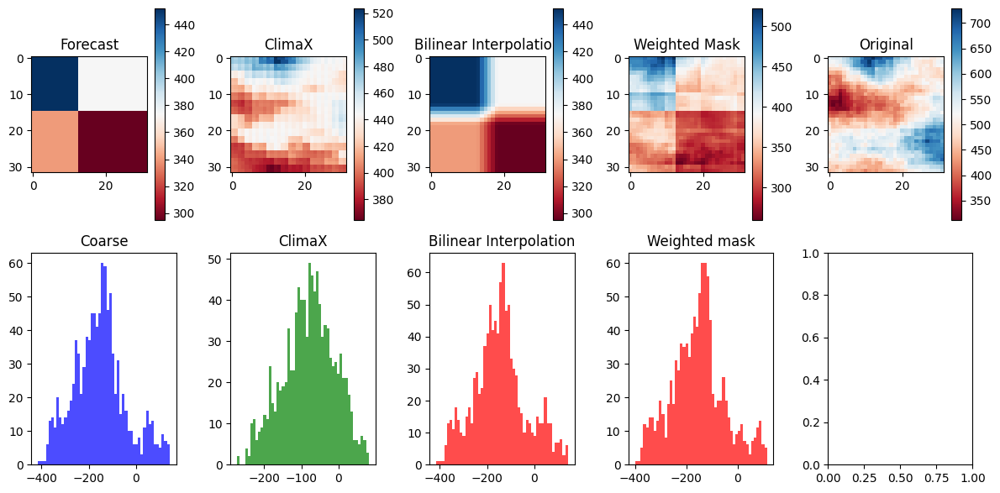

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 35634.070031143754  | 11214.35986982515  | 33171.626110530975     | 34294.675305891455   |
| lat_weighted_rmse    | 188.76988645211333  | 105.89787471816963 | 182.13079396557566     | 185.1882158936995    |
| spearman             | -0.3512194560192437 | 0.401458802895174  | -0.4299166284191187    | -0.23023163554786155 |
| mean_bias            | -153.06938561797142 | -79.83143275976181 | -144.40549638867378    | -153.4134584069252   |
| pearson              | -0.3561793832554746 | 0.4590944704678288 | -0.39694893538188275   | -0.17656802107061426 |
+----------------------+---------------------+-----

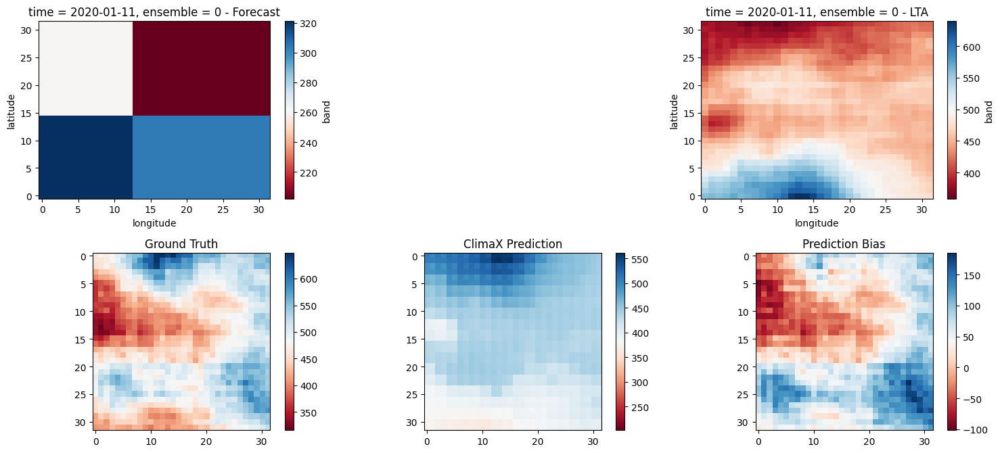

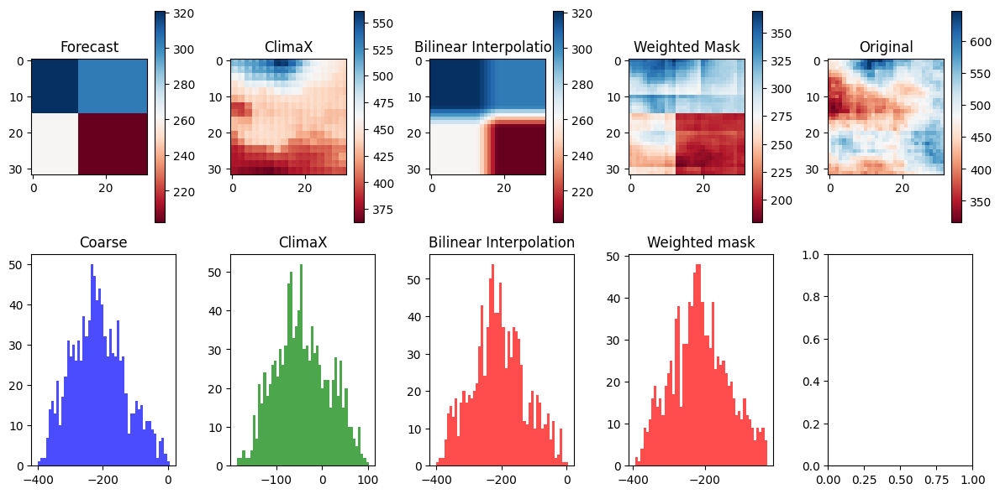

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+---------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 52412.255400325805   | 5252.418628104629   | 49603.764716926366     | 51765.641562175675    |
| lat_weighted_rmse    | 228.9372302626329    | 72.47357192870122   | 222.7190263918338      | 227.5206398597184     |
| spearman             | -0.22473823970859322 | 0.1761372371734578  | -0.26930597342720003   | -0.018494393379060847 |
| mean_bias            | -213.56734128296375  | -42.954079031944275 | -207.3580280840397     | -213.6580062508583    |
| pearson              | -0.205194923870043   | 0.3204812479792417  | -0.267939276939931     | -0.05101378201230572  |
+----------------------+---

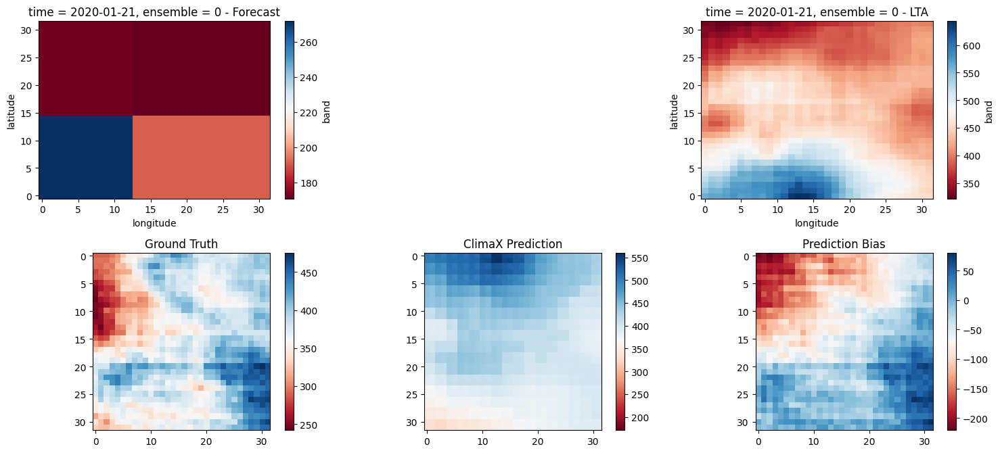

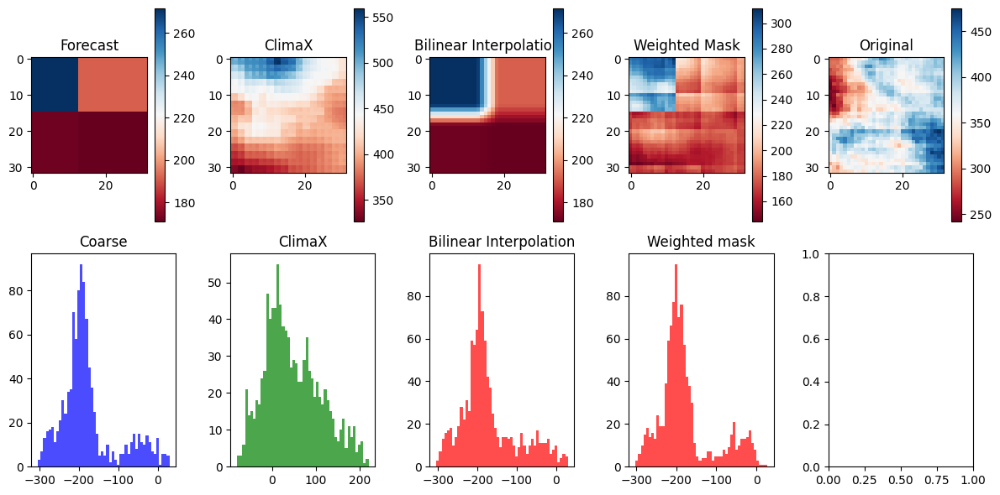

Selected device: cpu
+----------------------+----------------------+----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX               | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 36386.52987969571    | 6337.351826801579    | 34542.43201401812      | 36157.77273201635    |
| lat_weighted_rmse    | 190.7525357097402    | 79.60748599724512    | 185.85594425258        | 190.1519727271225    |
| spearman             | -0.47469421516570837 | -0.13372948140136132 | -0.5154671924063101    | -0.20846247775811724 |
| mean_bias            | -177.09808106720448  | 47.18792110681534    | -171.6230354309082     | -177.15637405216694  |
| pearson              | -0.592475802131052   | -0.1357620468858215  | -0.5813185300294124    | -0.454369294477444   |
+----------------------+---

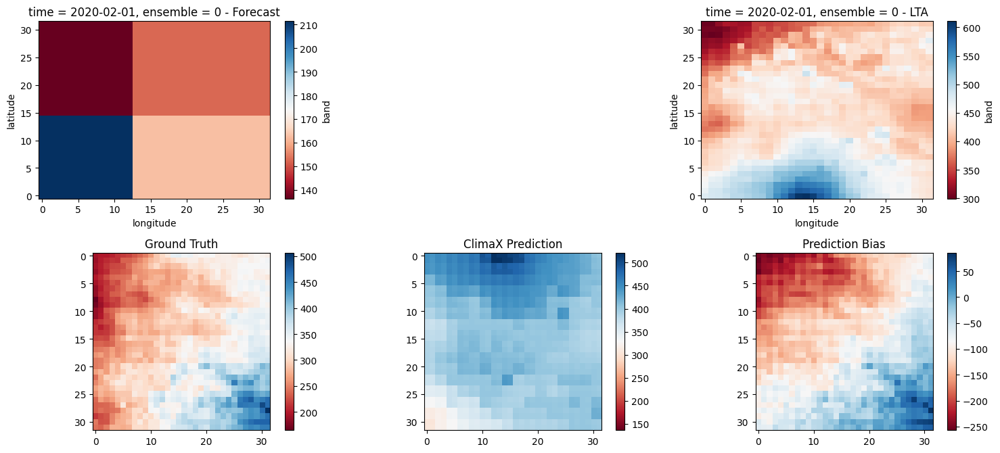

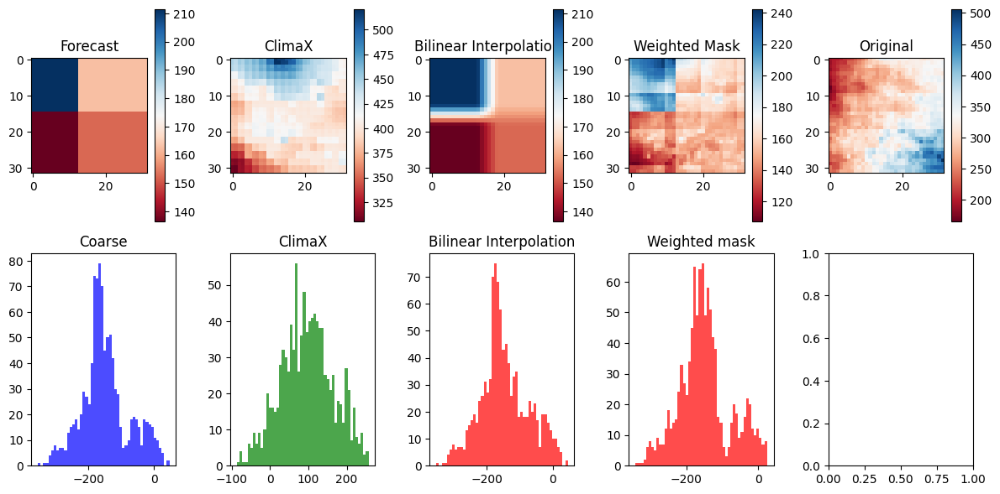

Selected device: cpu
+----------------------+----------------------+----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX               | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 27384.030354500188   | 13972.145461698896   | 26820.497998300067     | 27238.045661005184   |
| lat_weighted_rmse    | 165.48120846337866   | 118.20383014817622   | 163.76964919758504     | 165.03952757144327   |
| spearman             | -0.31369254344560754 | -0.16804785884113269 | -0.43335423157964736   | -0.25194392150826317 |
| mean_bias            | -148.80027003586292  | 96.96329092979431    | -146.12914663553238    | -148.8991089388728   |
| pearson              | -0.46636127926547466 | -0.07488402610749578 | -0.5167744768395692    | -0.3681051179252809  |
+----------------------+---

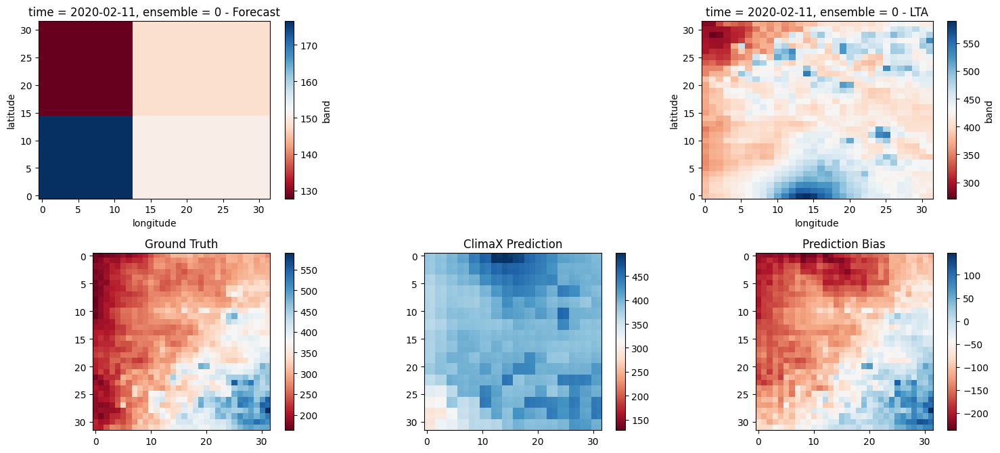

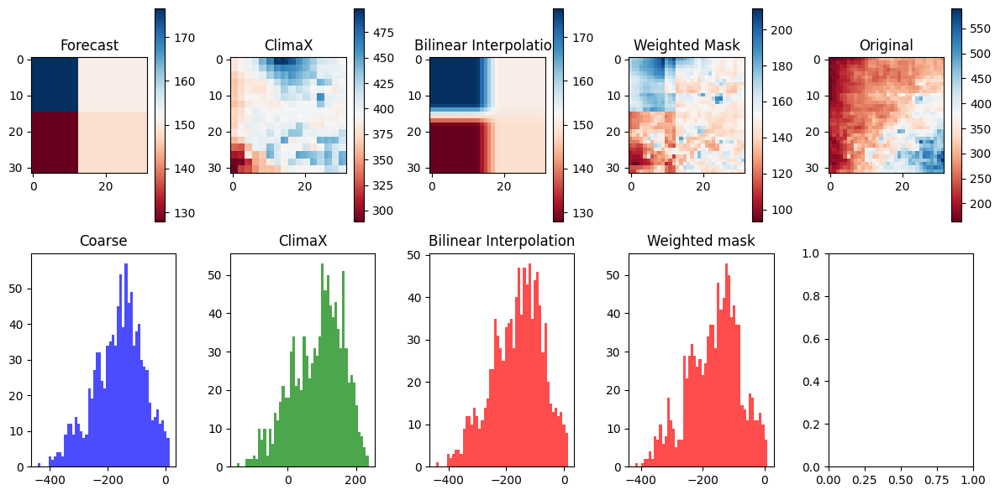

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+-----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+---------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 33647.249753324824  | 13347.65977284179  | 33567.37752343717      | 33320.22554800437     |
| lat_weighted_rmse    | 183.43186678798432  | 115.53207248570325 | 183.21402108855418     | 182.53828515685242    |
| spearman             | -0.2403970693250062 | 0.424010262709784  | -0.29800633669460636   | -0.044420399260007355 |
| mean_bias            | -162.32084603607655 | 88.29394426941872  | -161.40770345926285    | -162.4219462350011    |
| pearson              | -0.1642343706100967 | 0.405526321364688  | -0.23920125696237282   | 0.01133536602925792   |
+----------------------+-------------------

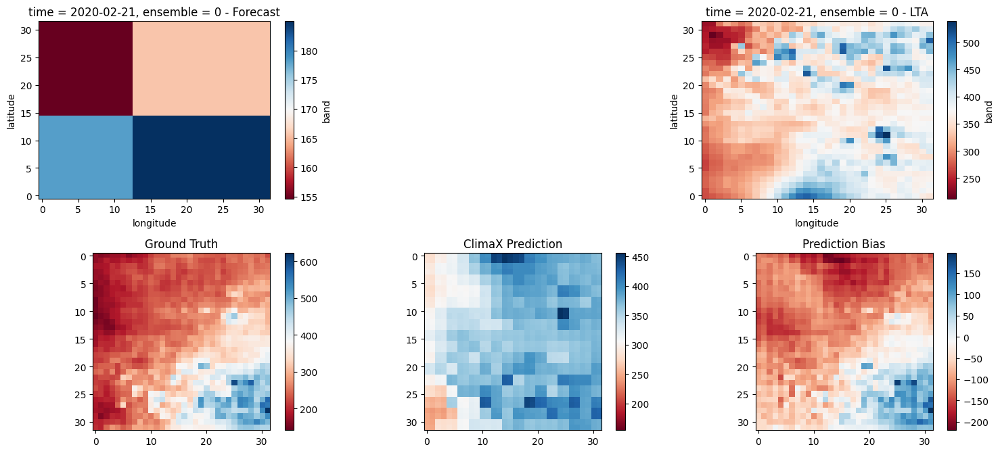

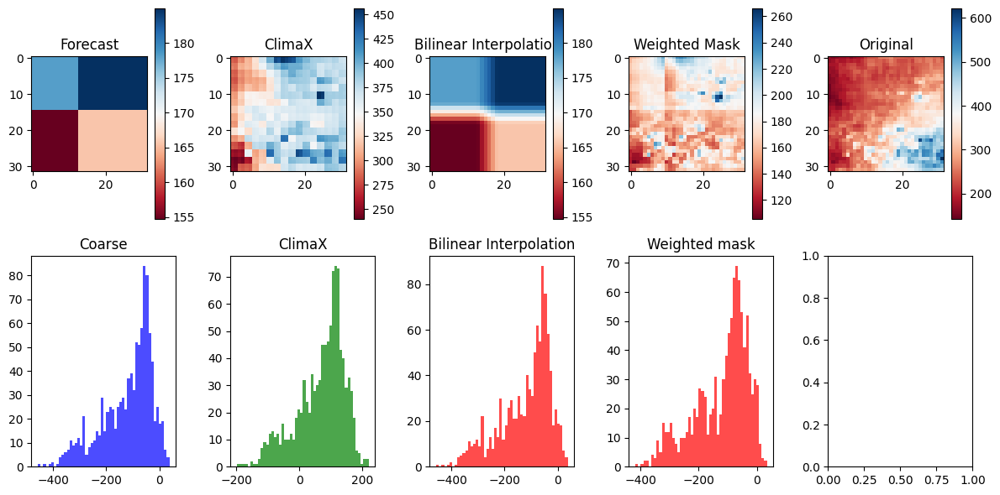

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 23367.576210022686   | 10490.433228076237 | 23411.779484929408     | 22790.972989315997   |
| lat_weighted_rmse    | 152.86456819689343   | 102.4228159546311  | 153.00908301447143     | 150.96679432681876   |
| spearman             | -0.1760673223423765  | 0.62592277351111   | -0.19605924608193612   | 0.033723960841532515 |
| mean_bias            | -119.86687226593494  | 69.45771303772926  | -120.03734186291695    | -119.82784944027662  |
| pearson              | -0.23903306419700804 | 0.5962890795092856 | -0.255909711807909     | 0.09298661483821014  |
+----------------------+-------------------

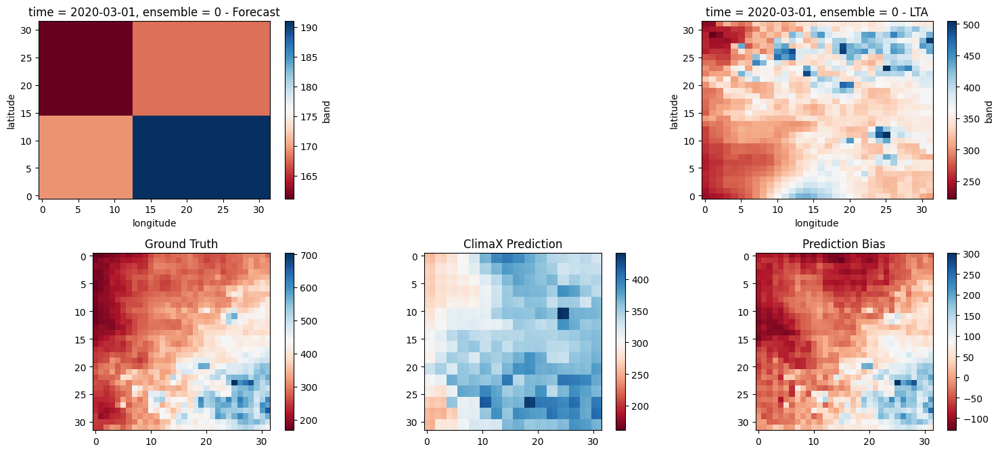

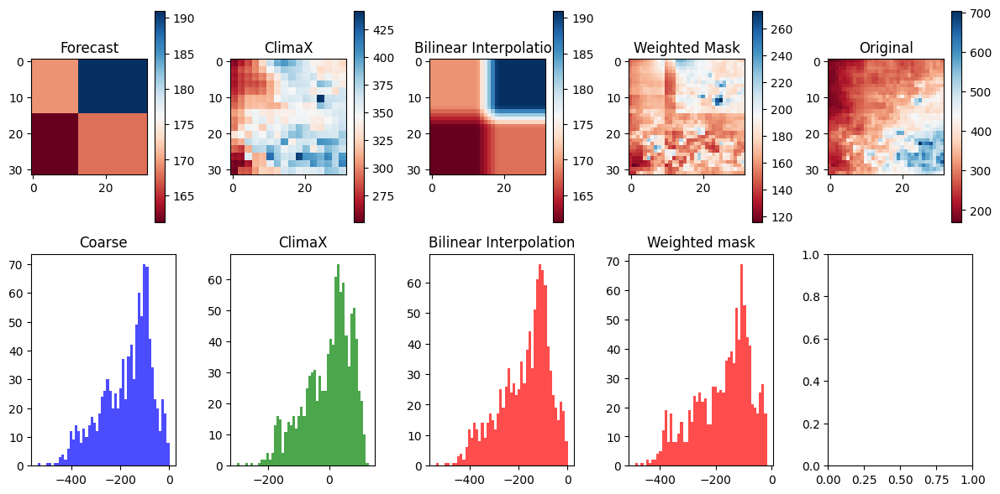

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 40784.64560837068    | 6096.308759432249   | 40935.59272309527      | 40035.32800926373   |
| lat_weighted_rmse    | 201.9520874078074    | 78.0788624368481    | 202.32546236965646     | 200.08830053070002  |
| spearman             | -0.14466983022496074 | 0.7601093837324274  | -0.054368398725336727  | 0.18650491670286082 |
| mean_bias            | -173.77745389938354  | -3.2143353819847107 | -174.57079283893108    | -173.713887155056   |
| pearson              | -0.06555962517700538 | 0.7589183112945038  | -0.022632075530070486  | 0.20770749690386903 |
+----------------------+-------------------

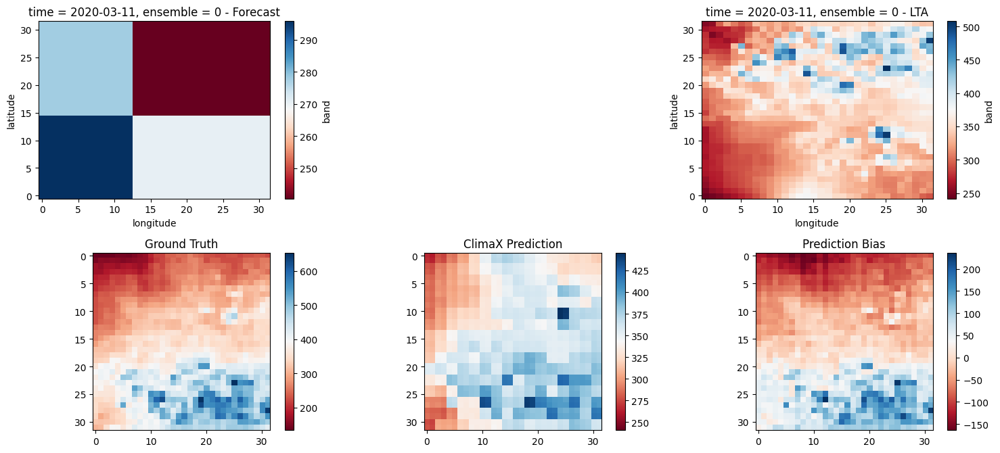

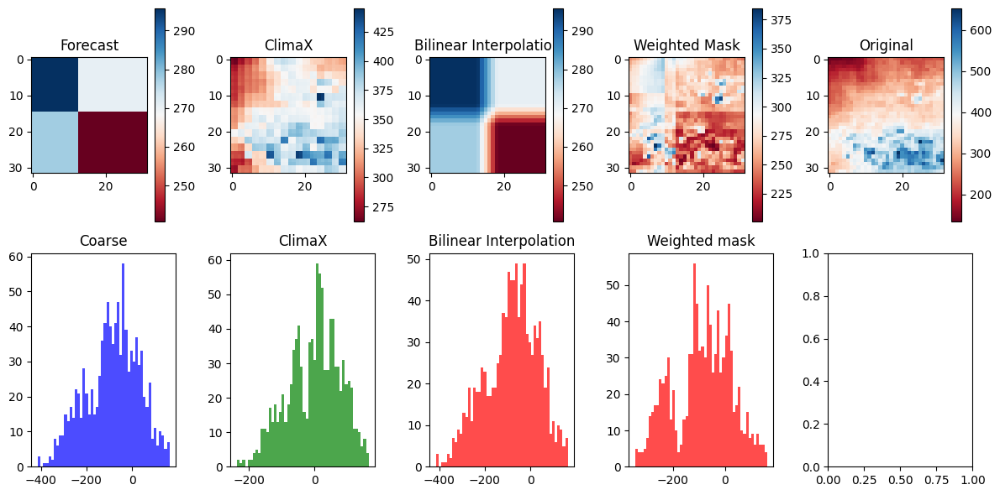

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 20579.247106407256  | 6201.578704174692   | 19780.289556250842     | 19530.493577578407   |
| lat_weighted_rmse    | 143.45468659617663  | 78.75010288358163   | 140.64241734359817     | 139.75154230840675   |
| spearman             | -0.6102571571100839 | 0.7534868162208455  | -0.6736214626832279    | -0.33843659337328363 |
| mean_bias            | -85.90273198485374  | -1.8740105032920837 | -82.19603765010834     | -86.02574287354946   |
| pearson              | -0.697494472946913  | 0.7497945352871211  | -0.717323952628828     | -0.23589512134371401 |
+----------------------+-------------------

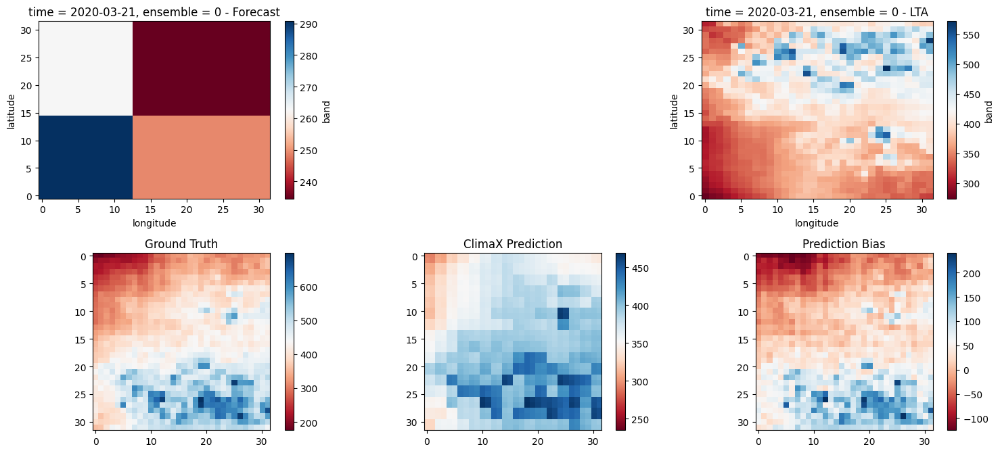

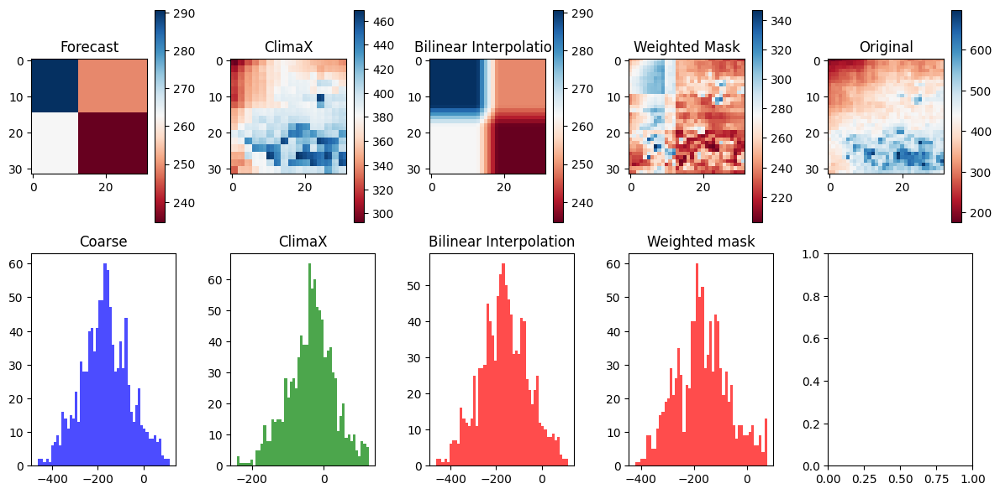

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 39099.78487483942   | 5349.957742940785  | 37824.1114485062       | 37974.7035161941     |
| lat_weighted_rmse    | 197.7366553647538   | 73.1434053277586   | 194.48421902176588     | 194.87099198237306   |
| spearman             | -0.6319574983756021 | 0.8866512395634825 | -0.6643036166477495    | -0.2534865837212137  |
| mean_bias            | -167.11726036667824 | -35.17833012342453 | -163.2248384654522     | -167.29758101701736  |
| pearson              | -0.6555877596302556 | 0.8804870088142434 | -0.6780107670371558    | -0.20288537646290147 |
+----------------------+---------------------+-----

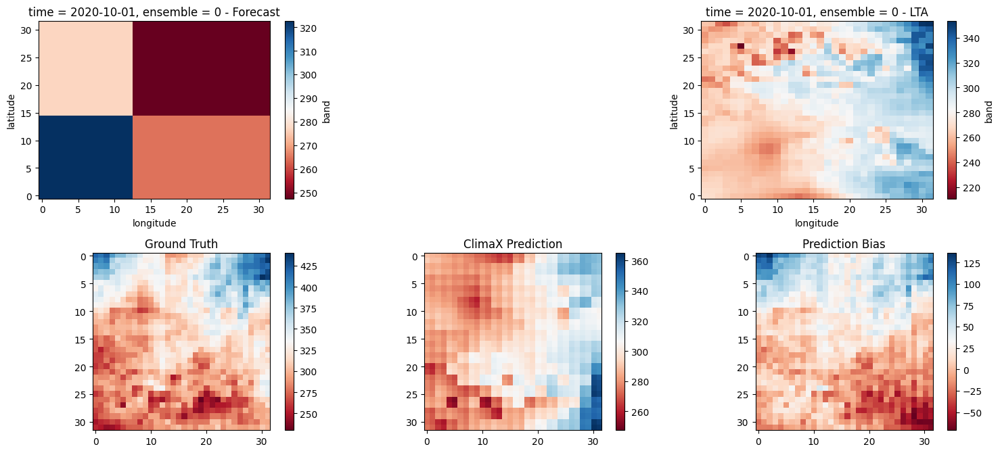

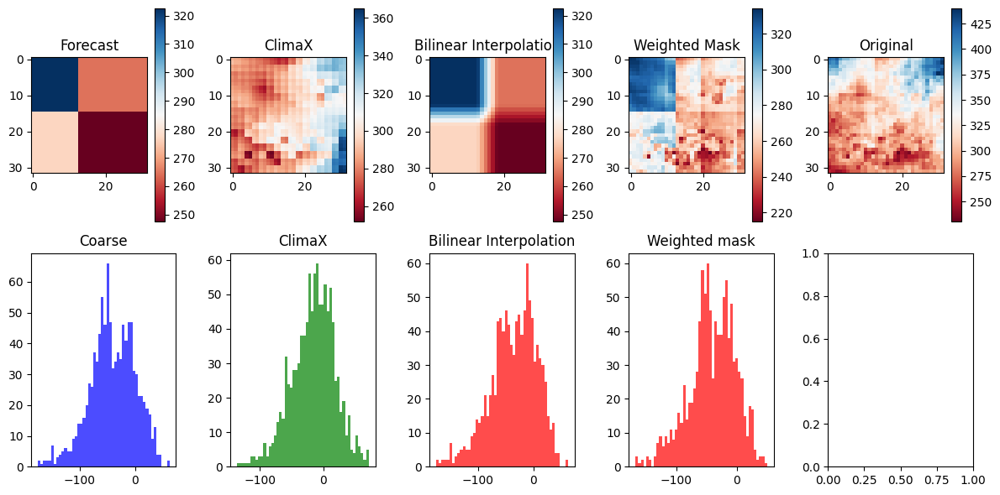

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3299.5672688252657  | 1407.039941086883   | 2981.1556285275883     | 3092.4844519633184  |
| lat_weighted_rmse    | 57.44185990047037   | 37.510531069112886  | 54.59995996818668      | 55.610111058721316  |
| spearman             | 0.11456894688729967 | 0.3647134906951917  | 0.11397077406660087    | 0.2743320100908229  |
| mean_bias            | -40.37380127608776  | -15.984271869063377 | -35.380482241511345    | -40.55212219059467  |
| pearson              | 0.16527339982464467 | 0.3744208978343324  | 0.12839574098096262    | 0.29027533923952953 |
+----------------------+---------------------+-----

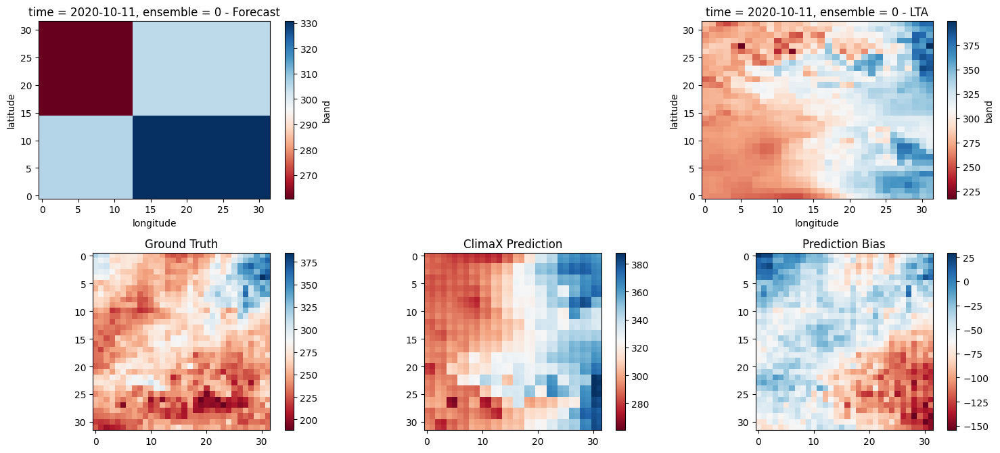

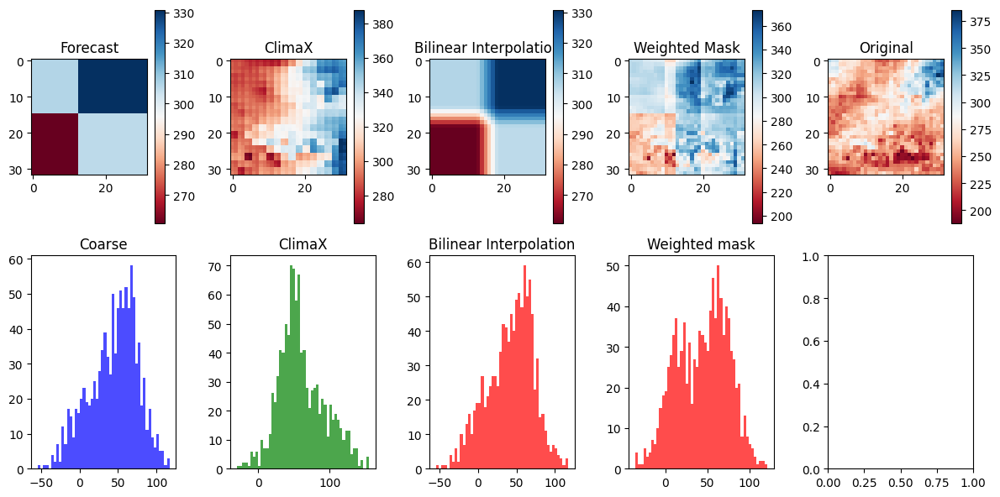

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2952.8669123448644  | 4724.556153846424   | 2674.3396819681025     | 2897.5805792538395  |
| lat_weighted_rmse    | 54.34028811429752   | 68.73540684280864   | 51.714018234595756     | 53.82917962642418   |
| spearman             | 0.4326234222132394  | 0.29170074521507416 | 0.4683985050222482     | 0.44603929512444573 |
| mean_bias            | 44.44653955101967   | 60.74753180146217   | 42.26825764775276      | 44.464041605591774  |
| pearson              | 0.35538319441065713 | 0.3919738259576509  | 0.40313939620004835    | 0.48367339260261033 |
+----------------------+---------------------+-----

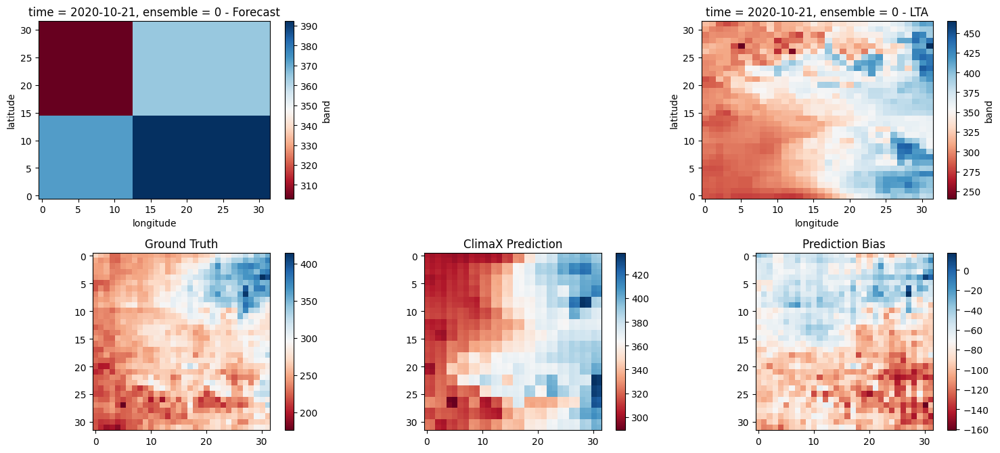

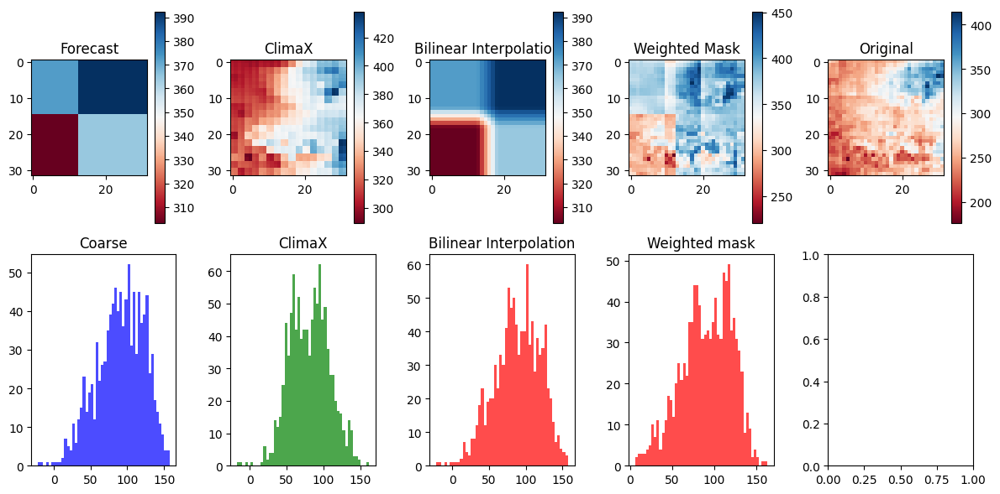

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 9270.734585119708  | 7271.758562662669  | 8766.359705251722      | 9123.153310886177  |
| lat_weighted_rmse    | 96.2846539440201   | 85.27460678691324  | 93.62884013620868      | 95.5151993710225   |
| spearman             | 0.6023032581449882 | 0.730135982600877  | 0.6592395553791289     | 0.7313117818669256 |
| mean_bias            | 90.84789362549782  | 81.0417200922966   | 88.45679521560669      | 90.82584638893604  |
| pearson              | 0.5879752037368511 | 0.7248135668390838 | 0.6141650631243392     | 0.6997365194399038 |
+----------------------+--------------------+--------------------+---------

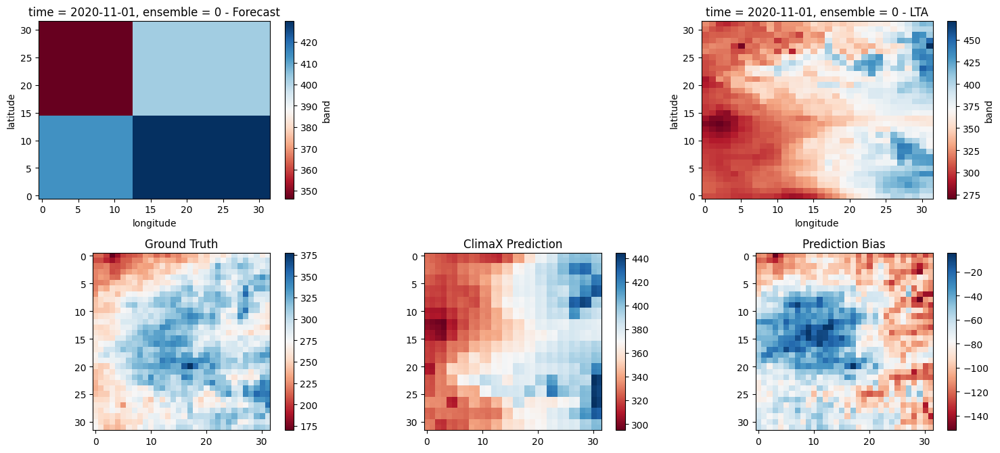

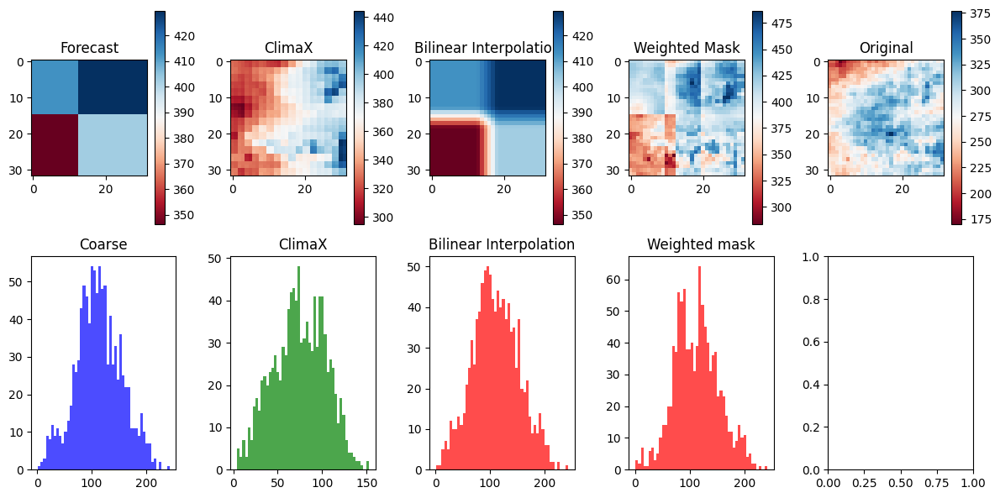

Selected device: cpu
+----------------------+------------------------+--------------------+------------------------+---------------------+
|                      | Coarse                 | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+------------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 14475.327508691174     | 6375.413969220621  | 14047.262743501207     | 14340.246878309244  |
| lat_weighted_rmse    | 120.31345522713232     | 79.84618944709021  | 118.52114892921519     | 119.75076984432812  |
| spearman             | -0.0063277125018050846 | 0.5538935629048233 | 0.006531712348404307   | 0.30595636546153604 |
| mean_bias            | 112.7651654779911      | 74.37760484218597  | 110.72260230779648     | 112.72500425577164  |
| pearson              | 0.05507320428389122    | 0.5761047687246479 | 0.019329379873573006   | 0.2876108012004628  |
+----------------------+-----------

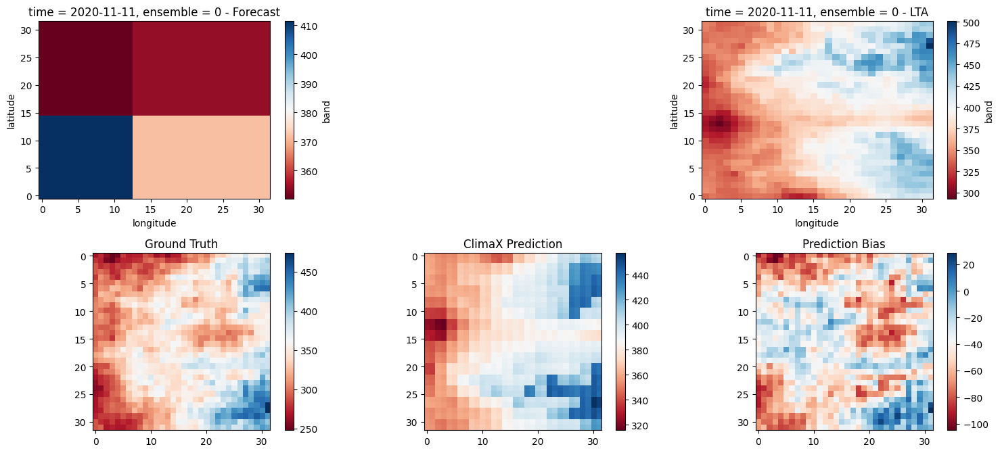

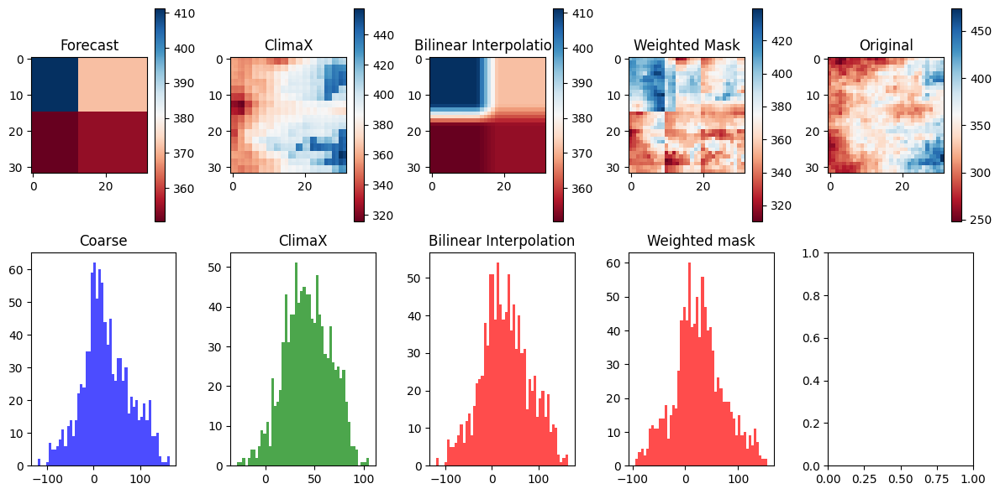

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 3339.314944866941    | 2378.2342089084714 | 3556.2950551581853     | 2931.57482721374     |
| lat_weighted_rmse    | 57.78680597564587    | 48.767142718314666 | 59.63467997028395      | 54.14401931158916    |
| spearman             | -0.11387734656834057 | 0.8214299752493666 | -0.18078228706547053   | 0.023896767348516902 |
| mean_bias            | 26.440959930419922   | 42.885608077049255 | 29.218536019325256     | 26.27511802315712    |
| pearson              | -0.3355920557530527  | 0.8221383198855042 | -0.35307624093343815   | -0.02286288187942588 |
+----------------------+-------------------

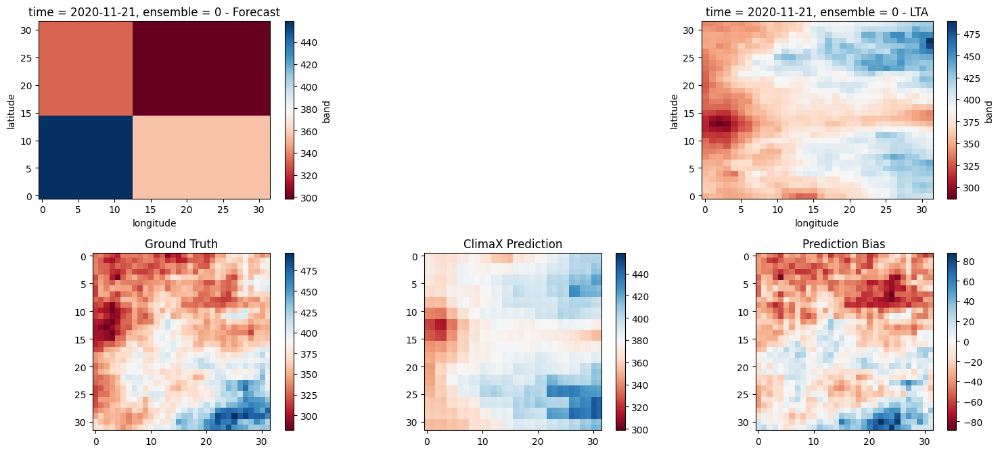

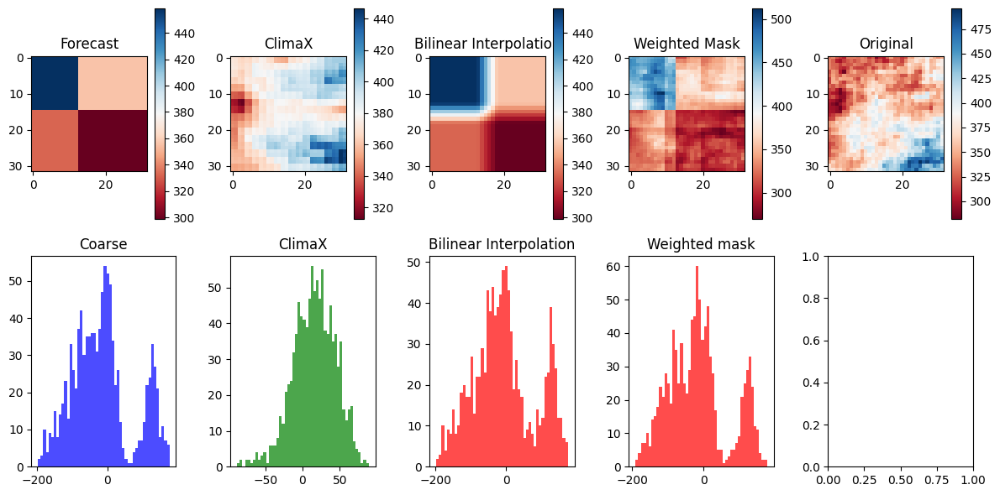

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 7479.593477505111   | 1054.475854884283  | 7380.5154894687585     | 7059.414185836597   |
| lat_weighted_rmse    | 86.48464301542275   | 32.47269398870816  | 85.90992660611903      | 84.02032007697065   |
| spearman             | -0.7135315664495677 | 0.5920580016532304 | -0.7256538008038509    | -0.5658406483642245 |
| mean_bias            | -14.786500215530396 | 15.705961644649506 | -5.7297817170619965    | -15.061769962310791 |
| pearson              | -0.6290894888897791 | 0.6704152154003495 | -0.6520155124533609    | -0.5290788991856624 |
+----------------------+---------------------+-------------

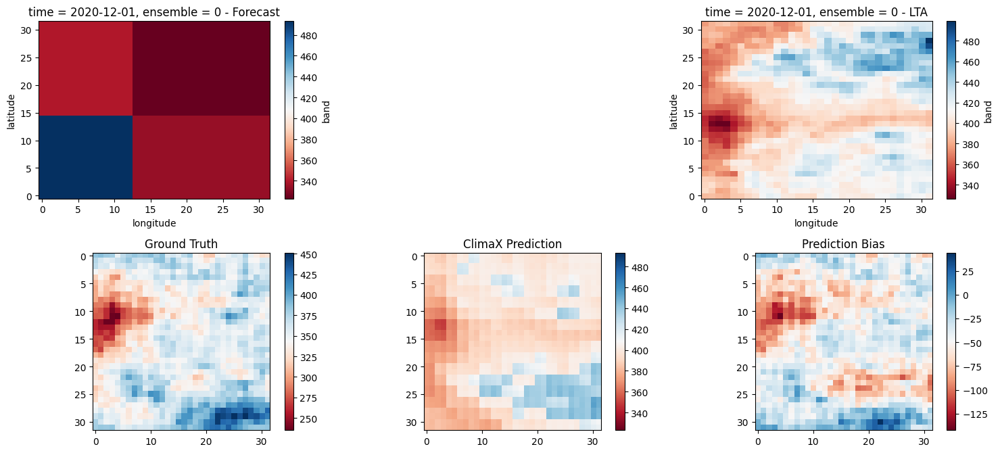

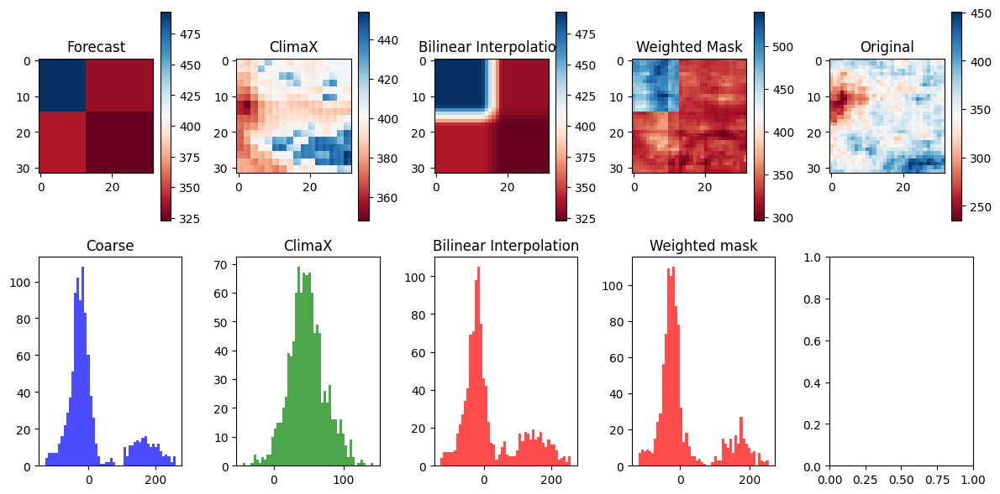

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 7228.02492505591    | 2950.525313307532  | 7806.977331896156      | 6785.689155472922   |
| lat_weighted_rmse    | 85.01779181474846   | 54.31873814170881  | 88.35710119676945      | 82.3752945698704    |
| spearman             | -0.4701103596083496 | 0.5505132478423679 | -0.4841867312180462    | -0.1808065228573601 |
| mean_bias            | 10.05806103348732   | 47.71016180515289  | 20.46497344970703      | 9.773630112409592   |
| pearson              | -0.4778462373018378 | 0.6053201247562195 | -0.49753610595422904   | -0.3932906760057864 |
+----------------------+---------------------+-------------

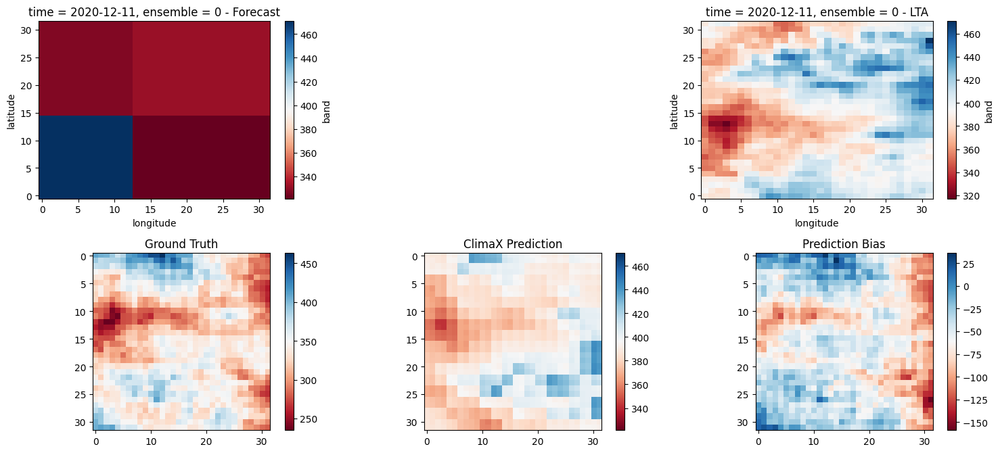

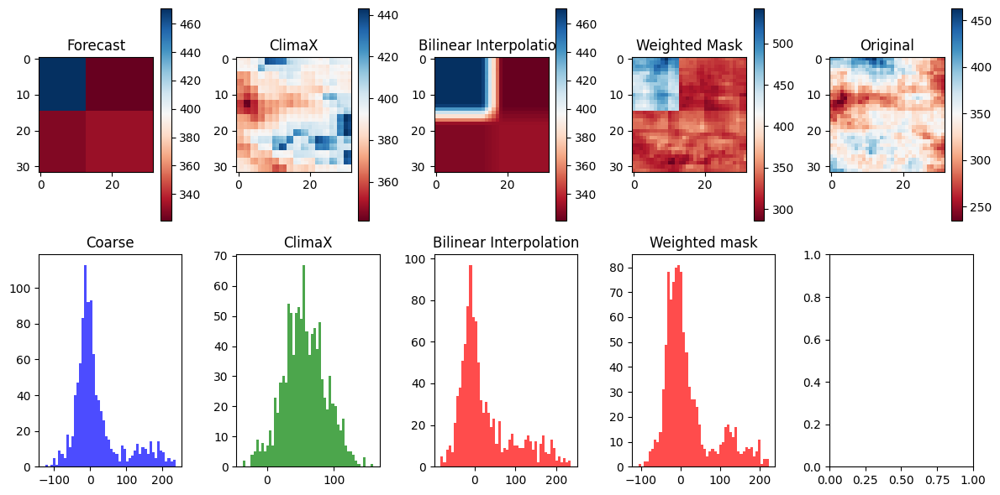

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4979.1226447462905    | 4136.441609259963  | 5349.500792366847      | 4406.262678169906   |
| lat_weighted_rmse    | 70.56289850017707     | 64.31517402028827  | 73.14028159890313      | 66.3796857341906    |
| spearman             | 0.05790620116527963   | 0.4051023414534307 | 0.026097459918806725   | 0.19684017512125657 |
| mean_bias            | 19.19287747144699     | 56.18535000085831  | 27.62806710600853      | 18.87004777789116   |
| pearson              | -0.051428880085737164 | 0.4310788912992294 | -0.0139194594204212    | 0.07913439726714867 |
+----------------------+-------------------

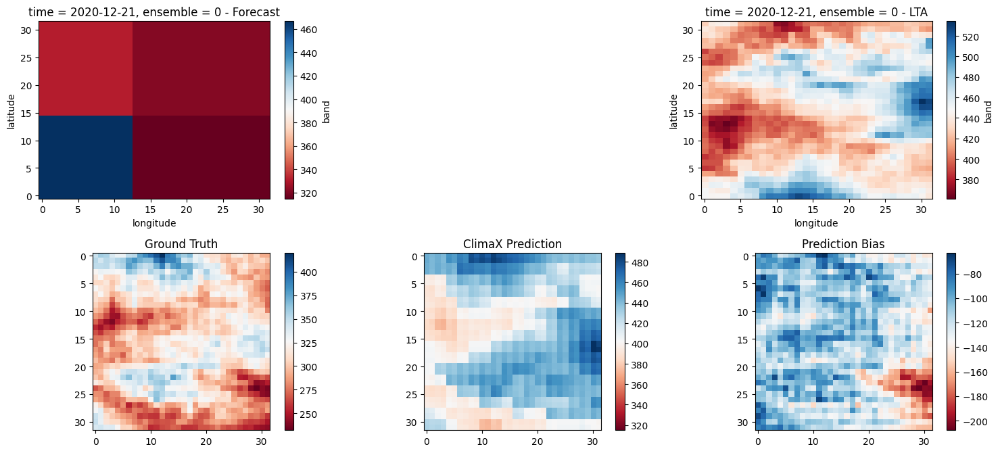

KeyboardInterrupt: 

In [31]:
for member in range(gt_xarray.shape[1]):
    for t in range(gt_xarray.shape[0]):
        visualize_climax(forecast_xarray, lta_xarray, gt_xarray, pred_xarray, bilinear_xarray, weighted_xarray, t, member)
        compare_results(gt_xarray, forecast_xarray, pred_xarray, bilinear_xarray, weighted_xarray, lat,t,member,denormalize_out)


## check data

We are interseted only in rain months, so we took 6 months between october and March

In [20]:
Rfh_lta = xr.open_dataset("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data/r1h_lta.nc")
R1h = xr.open_dataset("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data/r1h.nc")
r1h_lta = np.load("Data/Downscaling/Rainfall/Mozambique/Members/region_1/data_npz/test/2021_00_inp.npz")['rfh_lta']

In [ ]:

for i in range(len(Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).time)):
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))
    im0 = axs[0].imshow((Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).isel(time=i).band- Rfh_lta.sel(time=Rfh_lta.time.dt.year == 2021).isel(time=0).band))
    axs[0].set_title(f"Time Step {i}")
    cbar0 = plt.colorbar(im0, ax=axs[0])

    
    im1 = axs[1].imshow(r1h_lta[i,0] - r1h_lta[0,0])
    cbar1 = plt.colorbar(im1, ax=axs[1])

    plt.show()

## seasonality

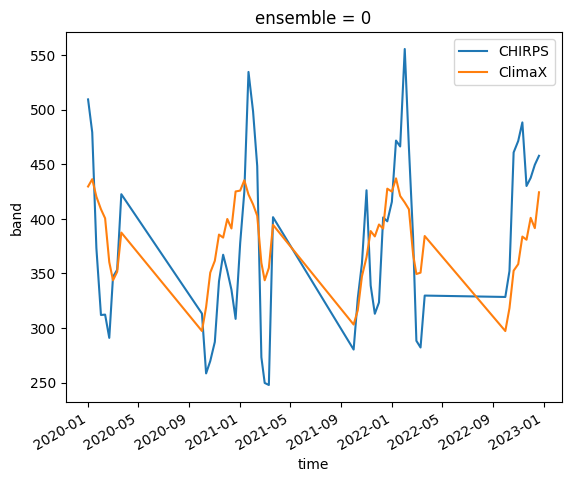

In [34]:

# gt_xarray.isel(ensemble=1,latitude=0,longitude=0).plot.line(label="CHIRPS")
(gt_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="CHIRPS")
(pred_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ClimaX")
# (forecast_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ECMWF",)
# (lta_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="LTA")
# (weighted_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Weighted")
# (bilinear_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Bilinear")
# LTA_xarray.isel(ensemble=0,latitude=0,longitude=0).plot.line(label="LTA")
plt.legend()


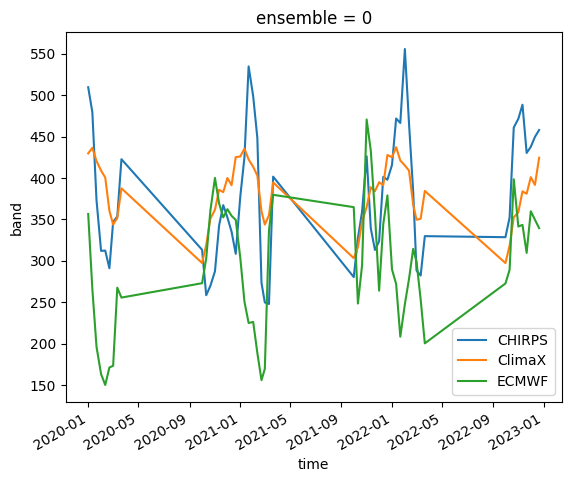

In [33]:

# gt_xarray.isel(ensemble=1,latitude=0,longitude=0).plot.line(label="CHIRPS")
(gt_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="CHIRPS")
(pred_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ClimaX")
(forecast_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ECMWF",)
# (lta_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="LTA")
# (weighted_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Weighted")
# (bilinear_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Bilinear")
# LTA_xarray.isel(ensemble=0,latitude=0,longitude=0).plot.line(label="LTA")
plt.legend()


In [ ]:

# gt_xarray.isel(ensemble=1,latitude=0,longitude=0).plot.line(label="CHIRPS")
(gt_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="CHIRPS")
(pred_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ClimaX")
(forecast_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="ECMWF",)
(lta_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="LTA")
(weighted_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Weighted")
# (bilinear_xarray.isel(ensemble=0).mean(dim=['latitude', 'longitude'])).plot.line(label="Bilinear")
# LTA_xarray.isel(ensemble=0,latitude=0,longitude=0).plot.line(label="LTA")
plt.legend()


## Influence of forecast

In [69]:
# Check if GPU is available
if torch.cuda.is_available():
    device = torch.device('cuda:0')
else:
    device = torch.device('cpu')



model.eval()

if torch.cuda.is_available():
     model.cuda()
else:
     model.cpu()


dataloader = datamodule.test_dataloader()

In [83]:
for batch_idx, batch_data in enumerate(dataloader, 1):
    if batch_idx == 2:
        # Process the nth batch (e.g., 10th batch)
        x, y, lead_times, in_vars, out_vars = batch_data

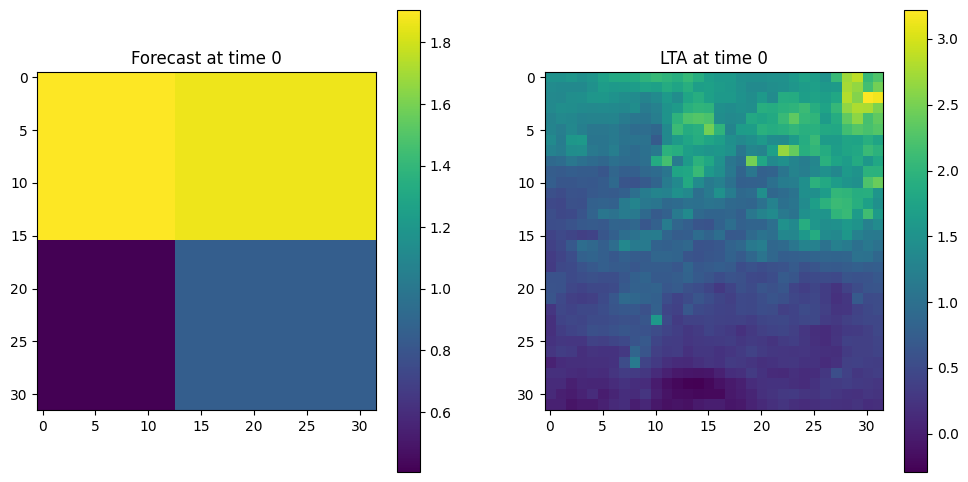

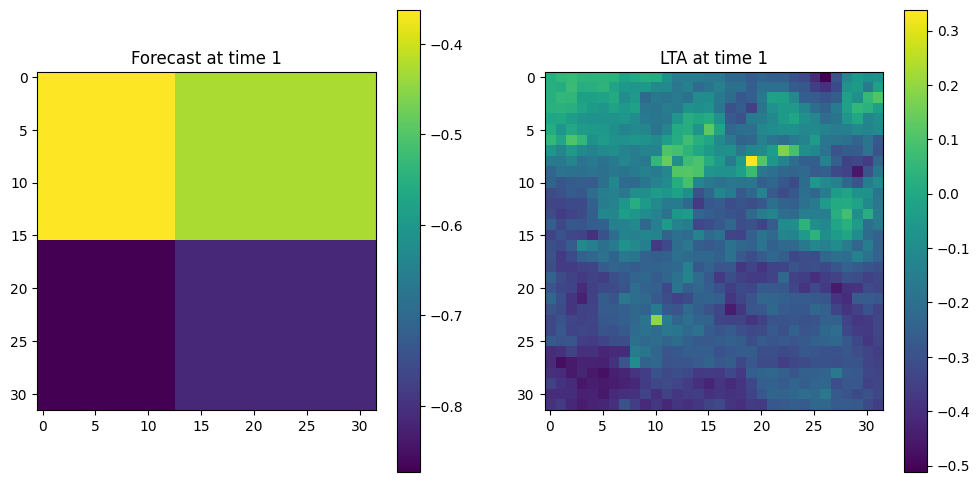

In [88]:
forecast_0 = x[0,0]
lta_0 = x[0,1]


fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

im1 = ax1.imshow(forecast_0)
ax1.set_title('Forecast at time 0')

ax1.grid(False)  # Optional: Turn off grid lines

# Display the second image (lta_0) in the second subplot (ax2)
im2 = ax2.imshow(lta_0)
ax2.set_title('LTA at time 0')

ax2.grid(False)  # Optional: Turn off grid lines


# Add colorbars for both images
cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)

plt.show()

forecast_1 = x[50,0]
lta_1 = x[50,1]

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Display the first image (forecast_0) in the first subplot (ax1)
im1 = ax1.imshow(forecast_1)
ax1.set_title('Forecast at time 1')

ax1.grid(False)  # Optional: Turn off grid lines

# Display the second image (lta_0) in the second subplot (ax2)
im2 = ax2.imshow(lta_1)
ax2.set_title('LTA at time 1')

ax2.grid(False)  # Optional: Turn off grid lines


# Add colorbars for both images
cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)

plt.show()


prediction


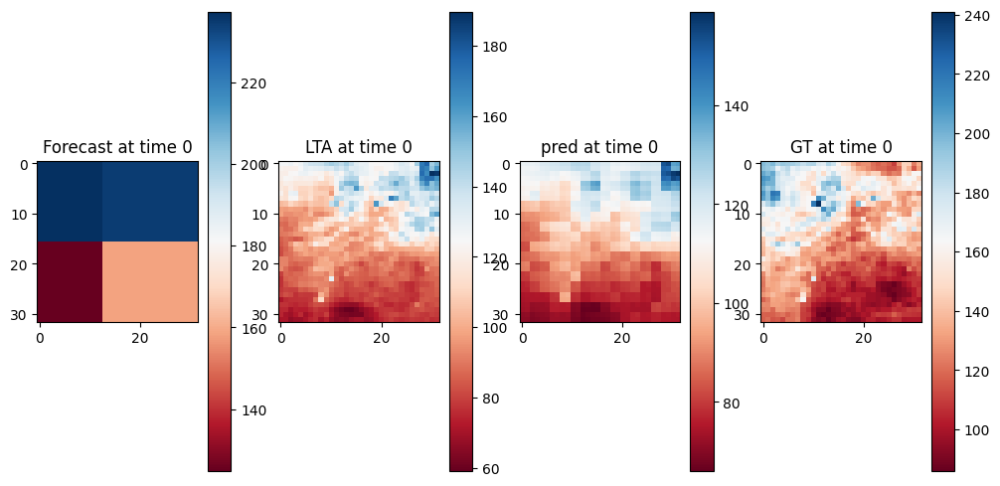

In [138]:
forecast_0 = x[0,0]
lta_0 = x[0,1]

gt_0,pred_0,tensors_0= downscale(forecast_0, lta_0, y = y[:1])

fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(12, 6))

im1 = ax1.imshow(tensors_0[0][0],  cmap=plt.cm.RdBu)
ax1.set_title('Forecast at time 0')

im2 = ax2.imshow(tensors_0[1][0],  cmap=plt.cm.RdBu)
ax2.set_title('LTA at time 0')


im3 = ax3.imshow(pred_0[0,0],  cmap=plt.cm.RdBu)
ax3.set_title('pred at time 0')

im4 = ax4.imshow(gt_0[0,0],  cmap=plt.cm.RdBu)
ax4.set_title('GT at time 0')

cbar1 = fig.colorbar(im1, ax=ax1)
cbar2 = fig.colorbar(im2, ax=ax2)
cbar2 = fig.colorbar(im3, ax=ax3)
cbar2 = fig.colorbar(im4, ax=ax4)

plt.show()

prediction


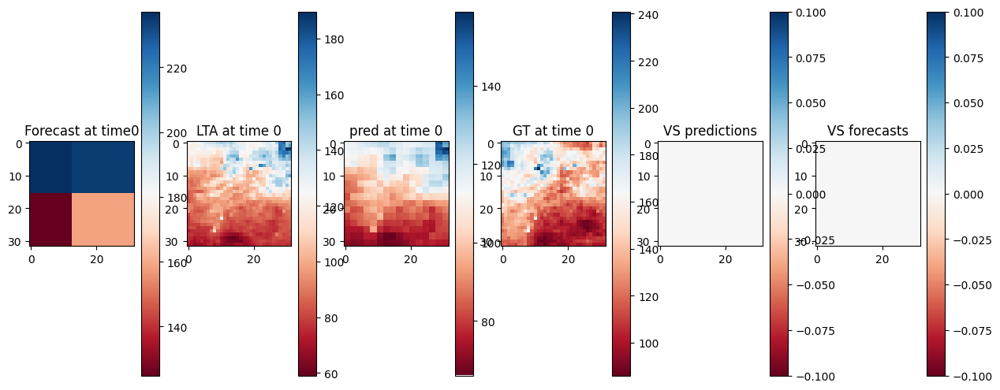

prediction


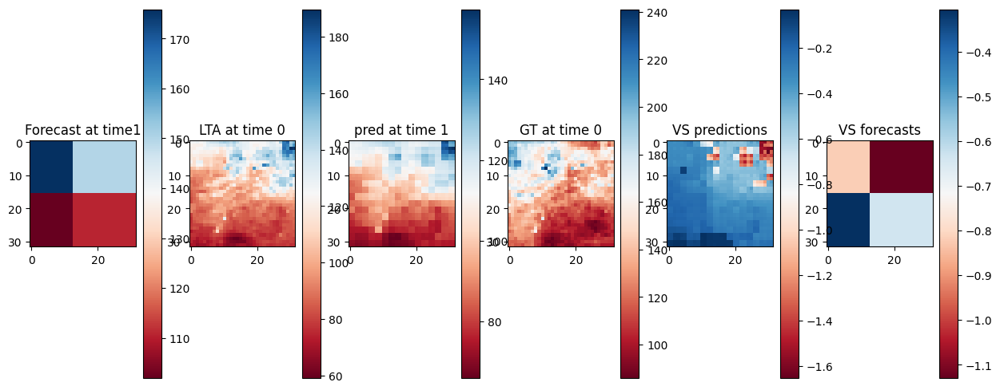

prediction


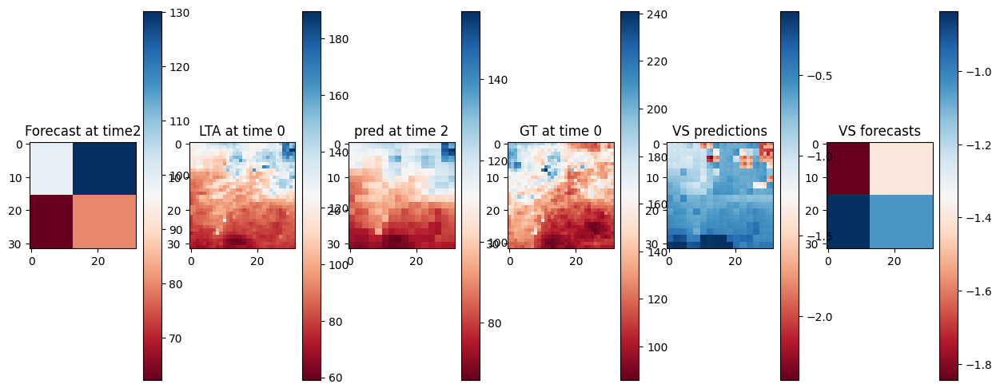

prediction


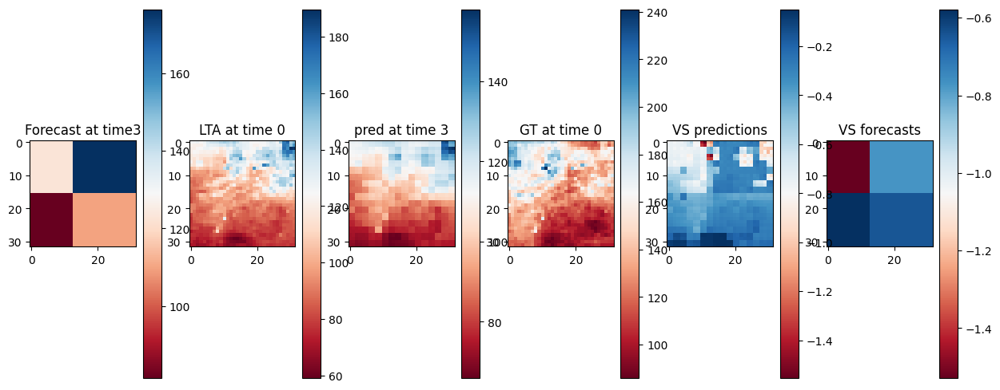

prediction


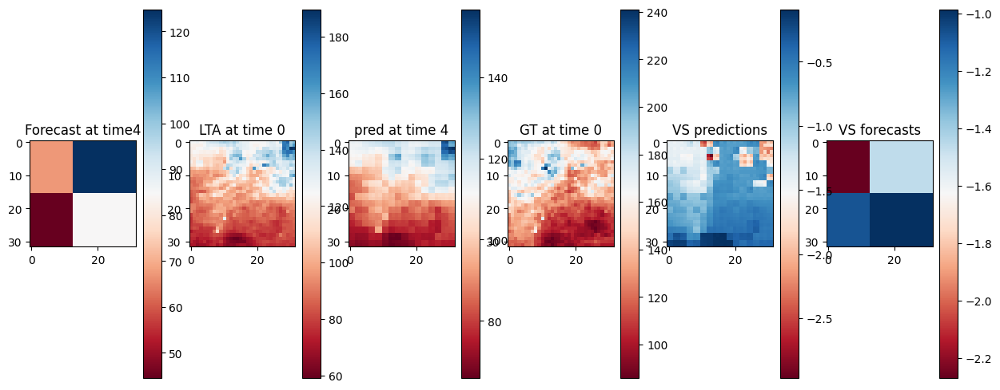

prediction


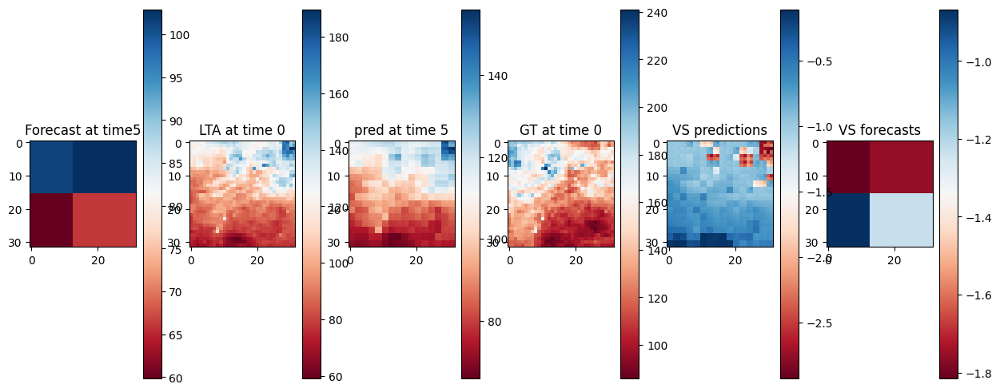

prediction


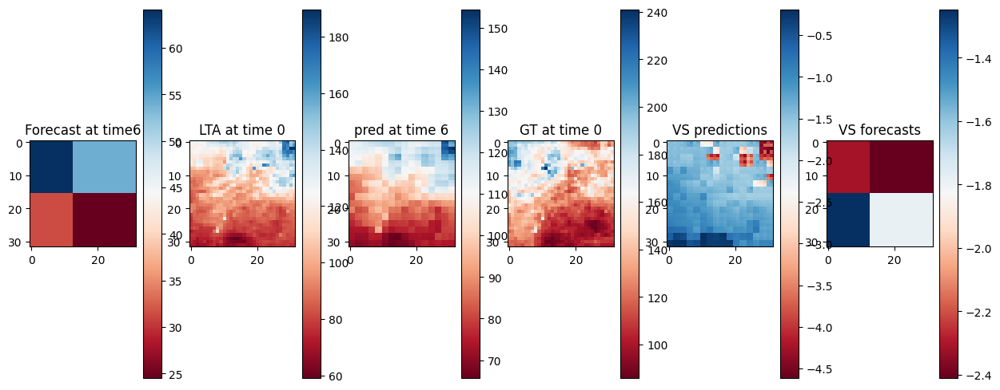

prediction


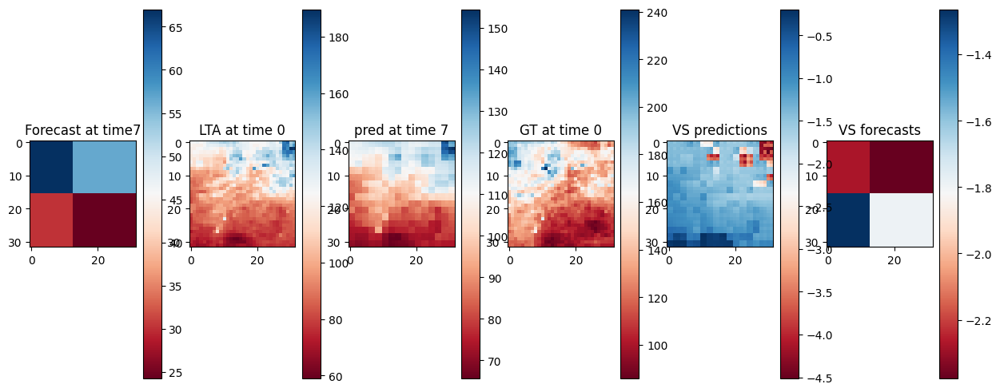

prediction


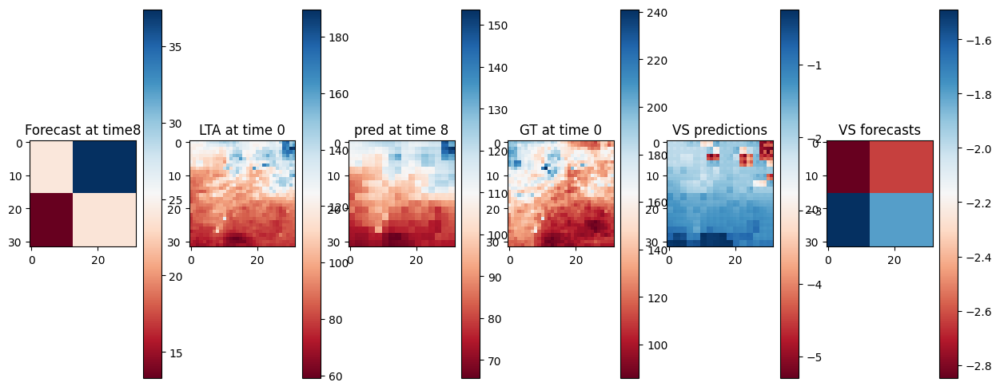

prediction


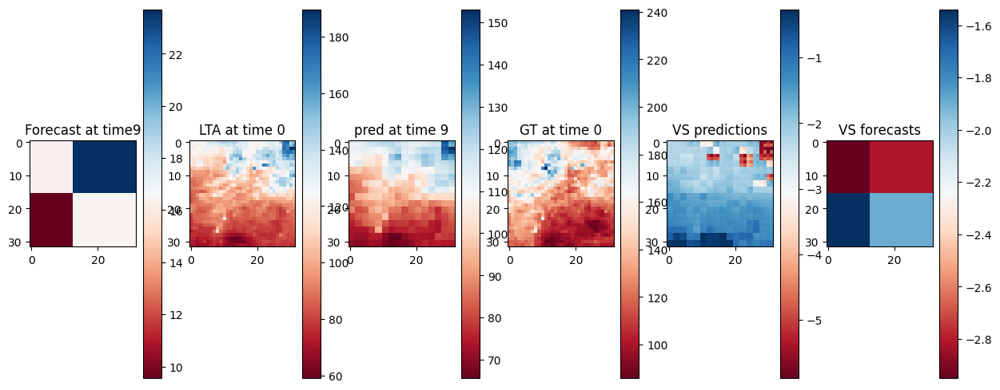

prediction


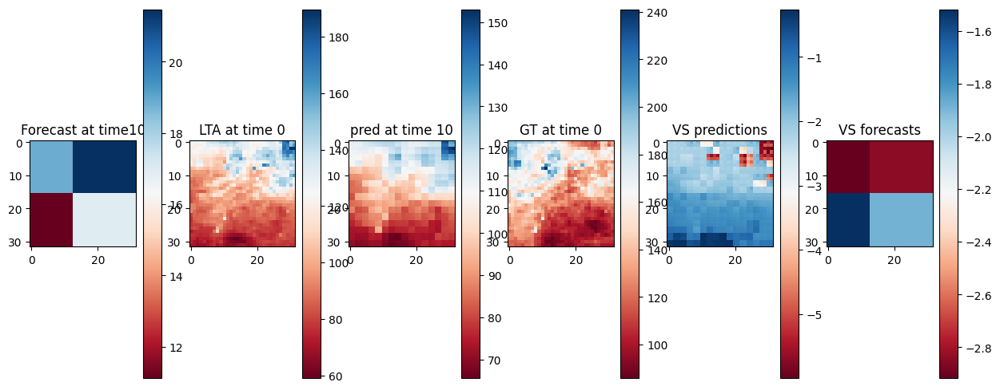

prediction


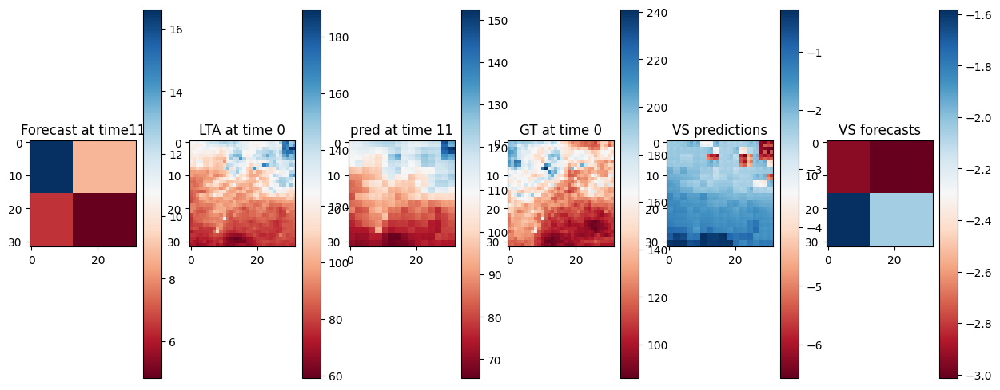

prediction


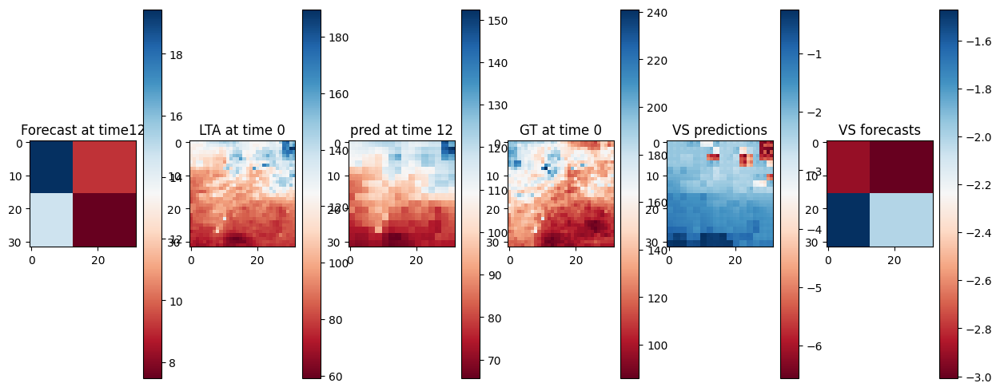

prediction


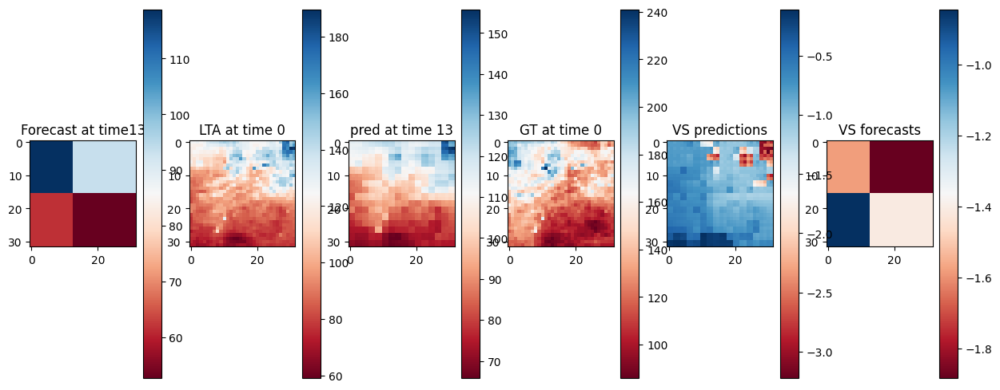

prediction


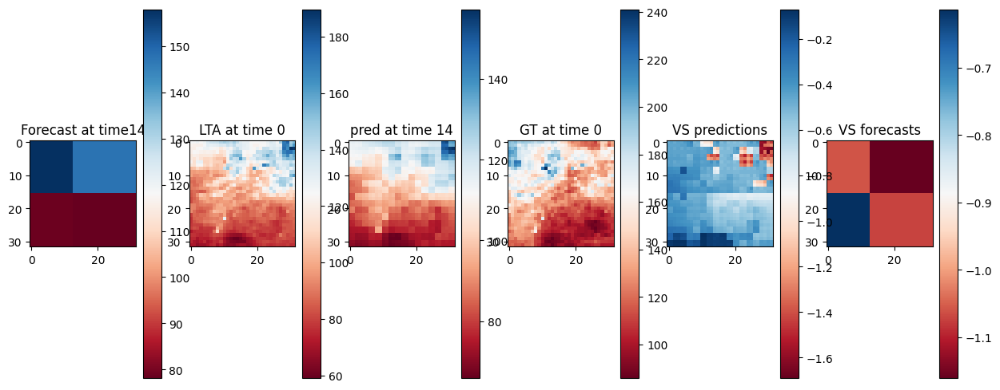

prediction


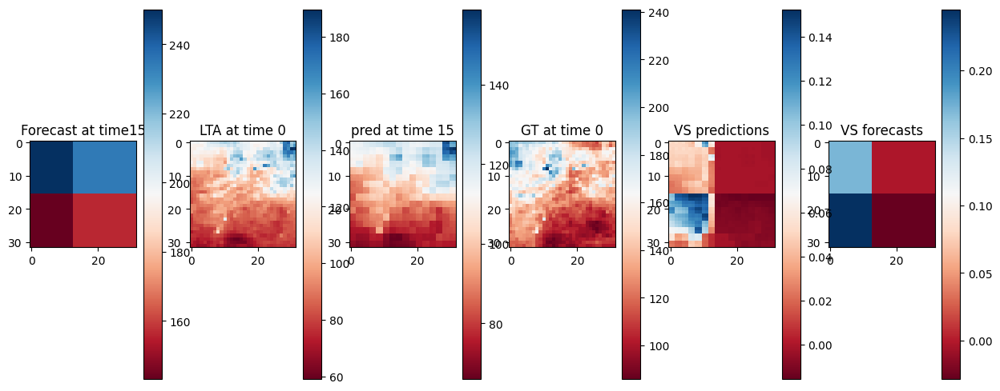

prediction


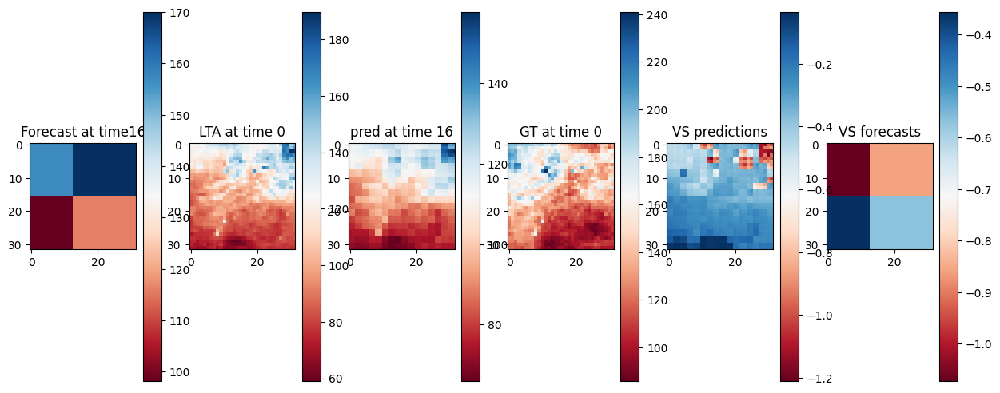

prediction


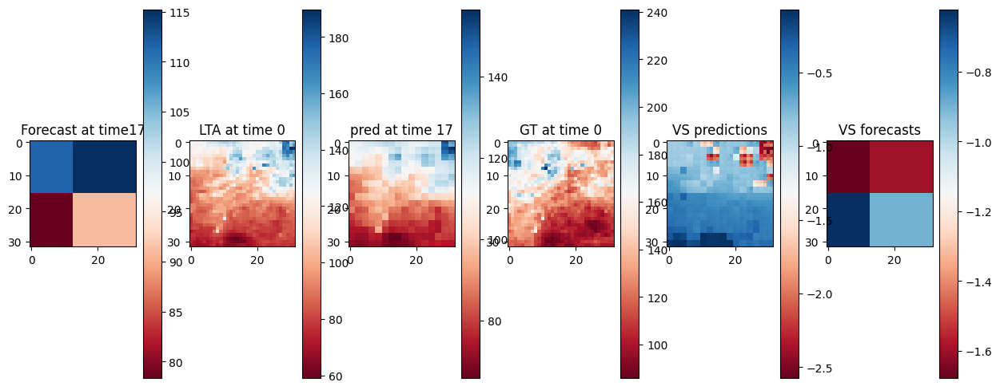

prediction


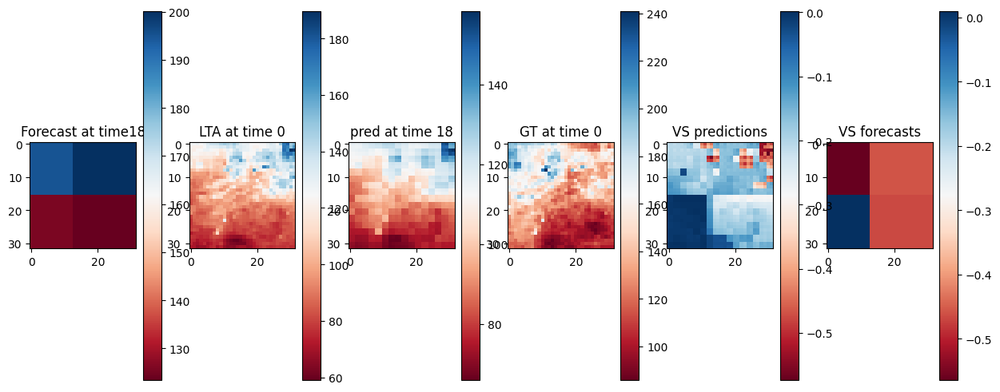

prediction


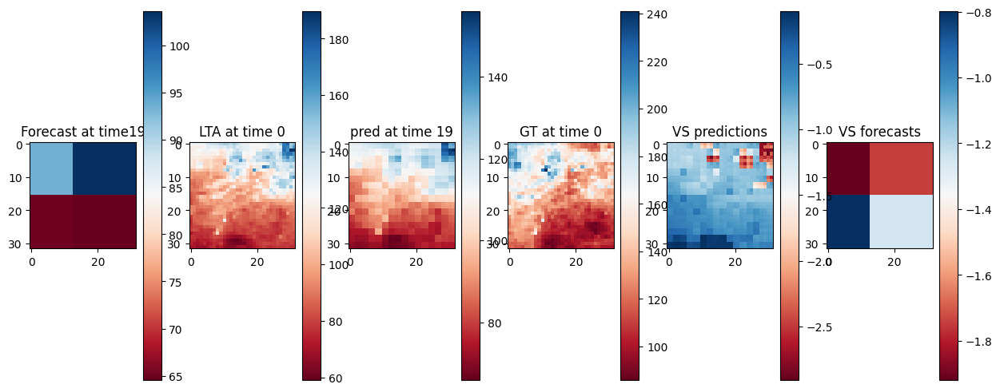

prediction


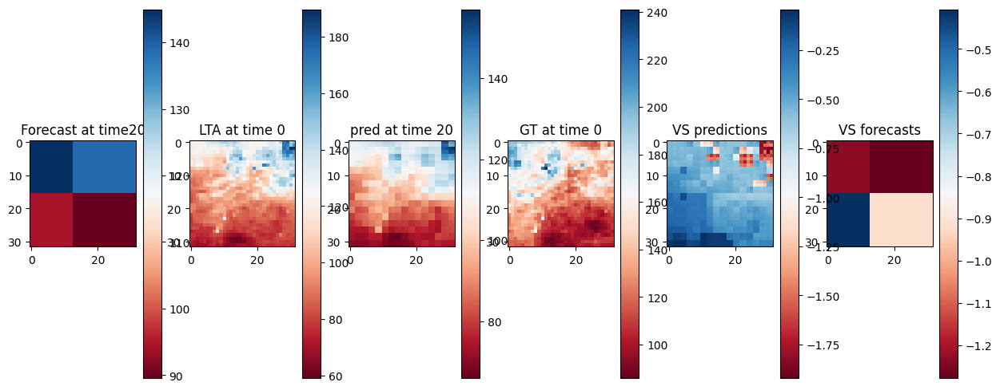

prediction


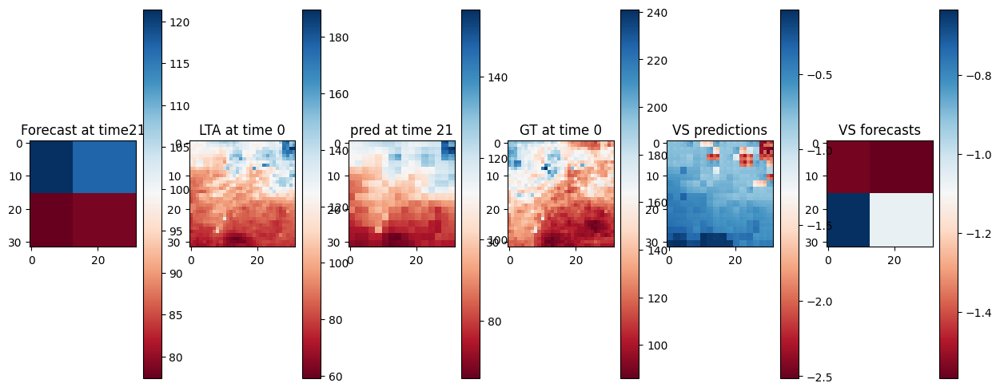

prediction


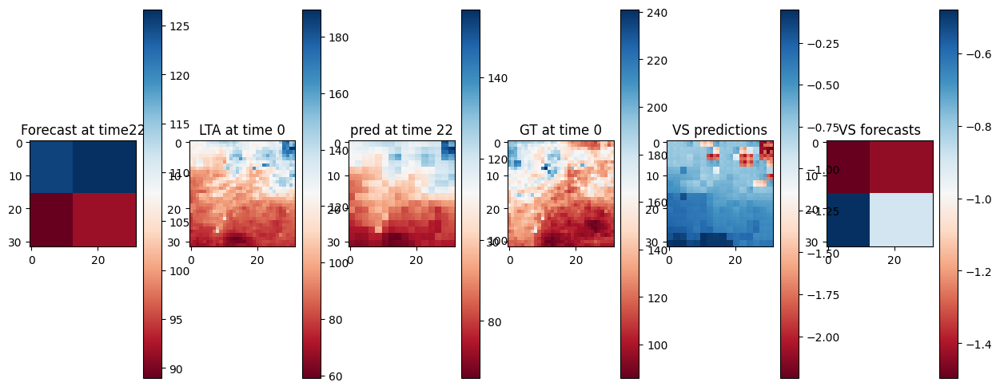

prediction


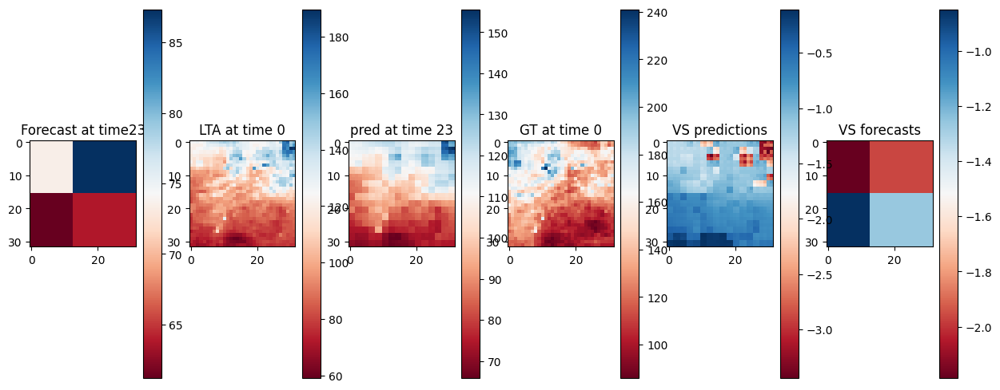

prediction


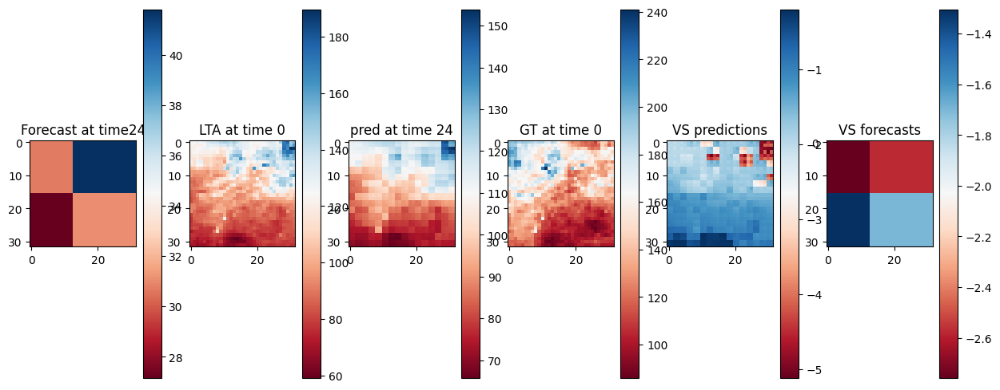

prediction


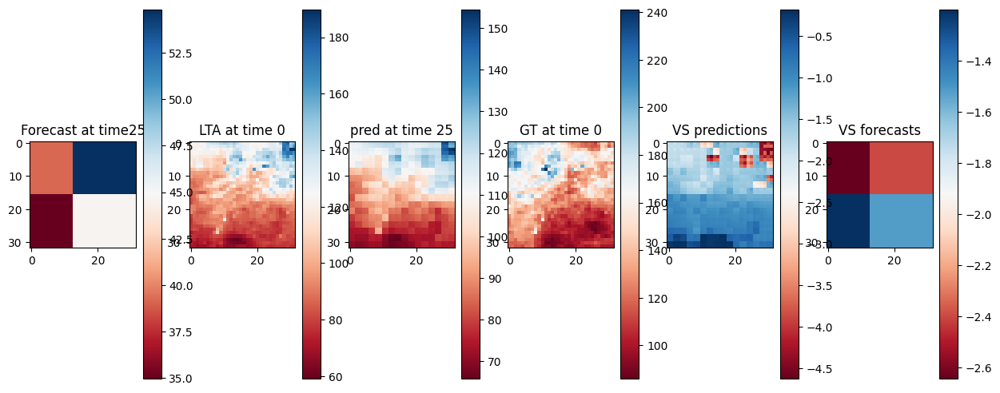

prediction


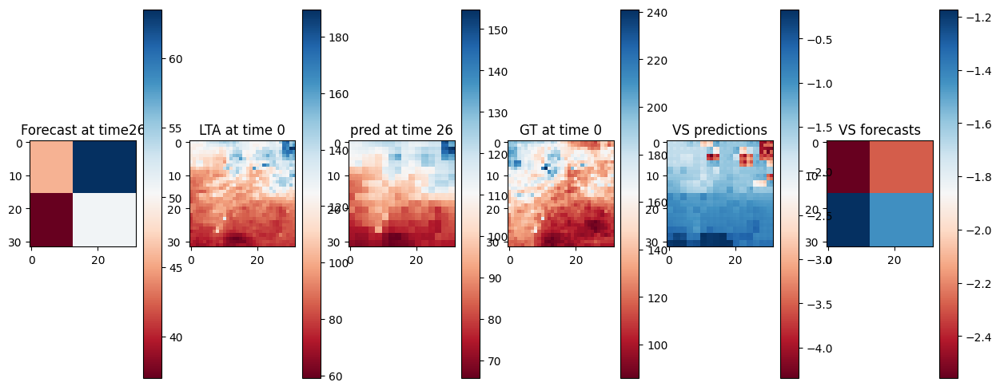

prediction


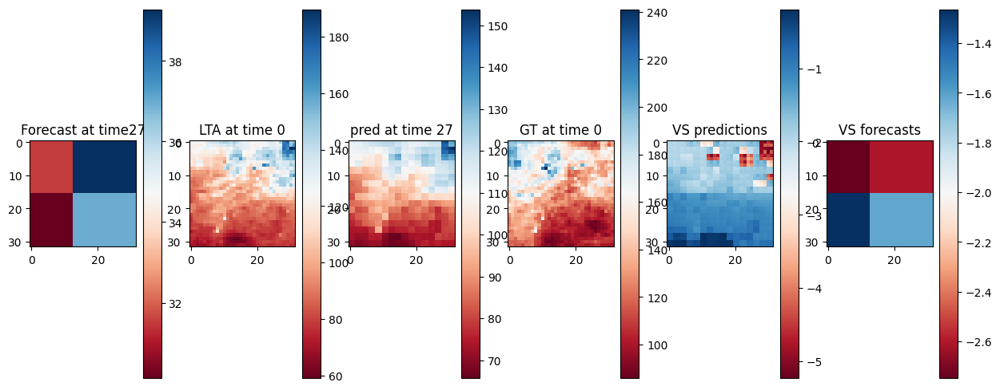

prediction


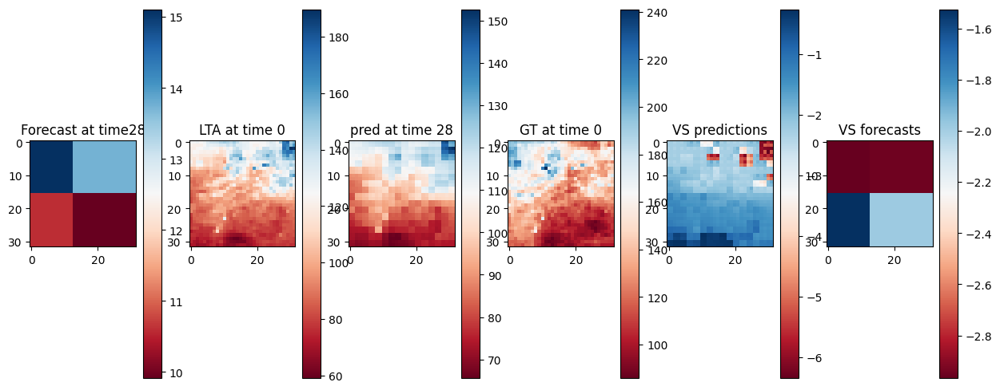

prediction


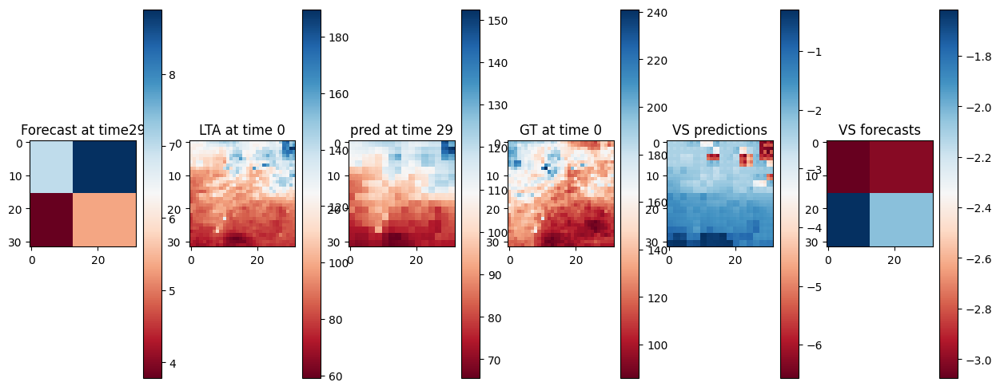

In [145]:
for t in range(30):
    
    forecast_1 = x[t,0]
    lta_0 = x[0,1]

    gt_1,pred_1,tensors_1= downscale(forecast_1, lta_0, y = y[:1])

    fig, (ax1, ax2, ax3, ax4,ax5, ax6) = plt.subplots(1, 6, figsize=(15, 6))

    im1 = ax1.imshow(tensors_1[0][0],  cmap=plt.cm.RdBu)
    ax1.set_title(f'Forecast at time{t}')

    im2 = ax2.imshow(tensors_1[1][0],  cmap=plt.cm.RdBu)
    ax2.set_title('LTA at time 0')


    im3 = ax3.imshow(pred_1[0,0],  cmap=plt.cm.RdBu)
    ax3.set_title(f'pred at time {t}')

    im4 = ax4.imshow(gt_1[0,0],  cmap=plt.cm.RdBu)
    ax4.set_title('GT at time 0')

    im5 = ax5.imshow(pred_1[0,0] - pred_0[0,0],  cmap=plt.cm.RdBu)
    ax5.set_title('VS predictions')
    
    im6 = ax6.imshow(forecast_1  - forecast_0 ,  cmap=plt.cm.RdBu)
    ax6.set_title('VS forecasts')

    cbar1 = fig.colorbar(im1, ax=ax1)
    cbar2 = fig.colorbar(im2, ax=ax2)
    cbar3 = fig.colorbar(im3, ax=ax3)
    cbar4 = fig.colorbar(im4, ax=ax4)
    cbar5 = fig.colorbar(im5, ax=ax5)
    cbar6 = fig.colorbar(im6, ax=ax6)

    plt.show()

In [129]:
def downscale(forecast, lta, y,lead_times = lead_times, in_vars=in_vars, ou_vars=out_vars, model_module = model, data_module = datamodule,mean_norm=mean_norm, std_norm=std_norm, pred_task=pred_range, var_name="R1H", var_id=1,data_path=None, save_path = None, desired_batch_index = 25):
    
    x = torch.stack([forecast, lta], dim=0).unsqueeze(0)
    lead_times = lead_times[:1]
            
    
    if torch.cuda.is_available():
        lead_times = lead_times.cuda()
    else:
        lead_times = lead_times.cpu()
      
    if torch.cuda.is_available():
        x = x.cuda()
        y = y.cuda()
    else:
        x = x.cpu()
        y = y.cpu()
        
    print("prediction")
    
    with torch.no_grad():
        _, pred = model_module.net.forward(x, y, lead_times, in_vars, out_vars, None, model_module.lat)
        
    
    
    inv_normalize = model_module.denormalization
    
    
    tensors=[]
    for i in range(x.shape[1]):
        tensors.append(inv_normalize(x)[:,i])
    init_condition = inv_normalize(x)[:,0]

    
    normalization = data_module.output_transforms
    mean_norm, std_norm = normalization.mean, normalization.std
    x = x[:, var_id,:]
    gt = y * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    pred = pred * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    bias = pred - gt
    tensors_pred = [init_condition, gt, pred, bias]
    

    
        
    del x
    del y
    return gt,pred,tensors

## variability between members

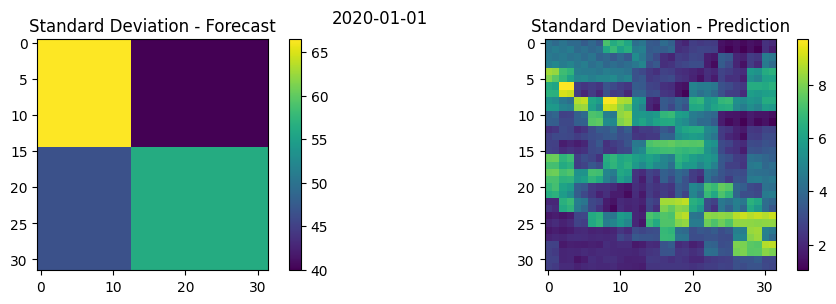

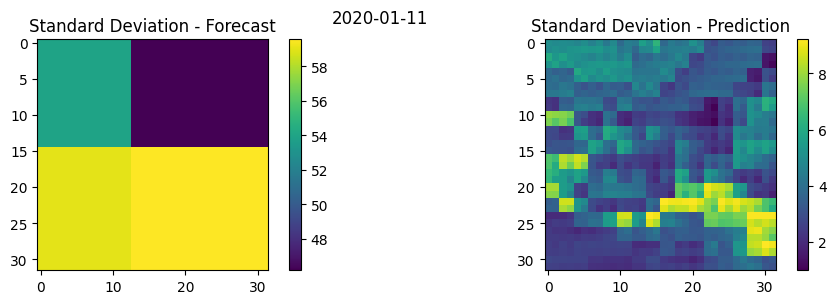

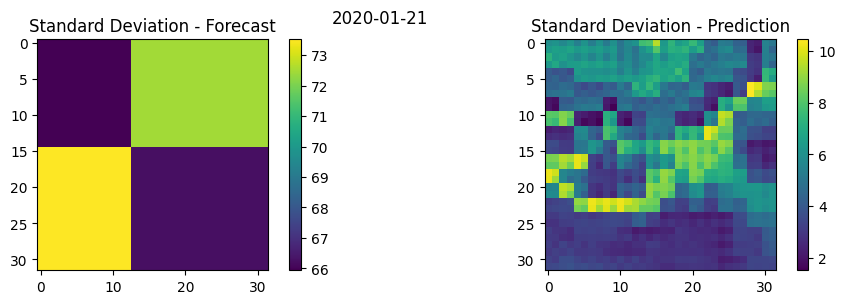

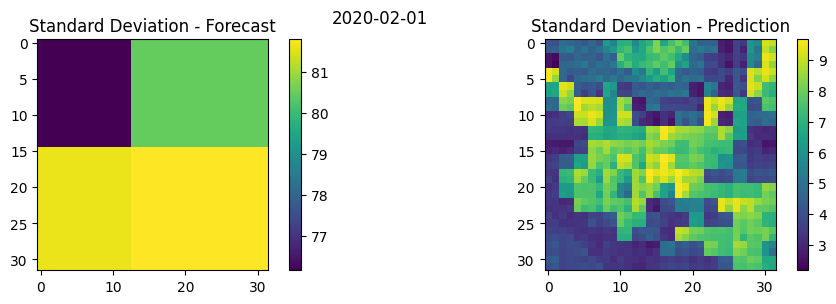

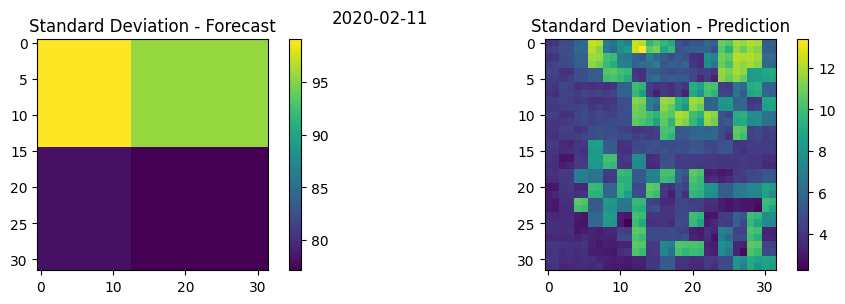

...

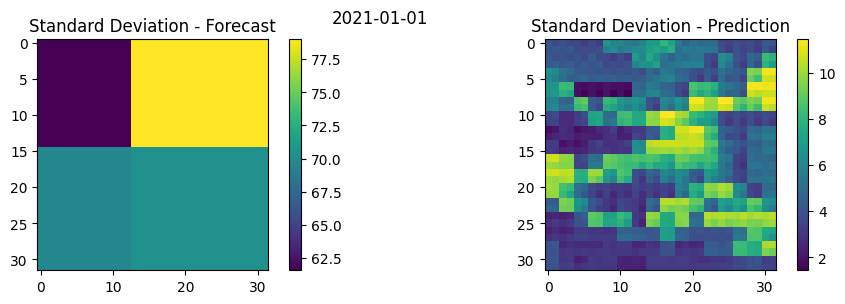

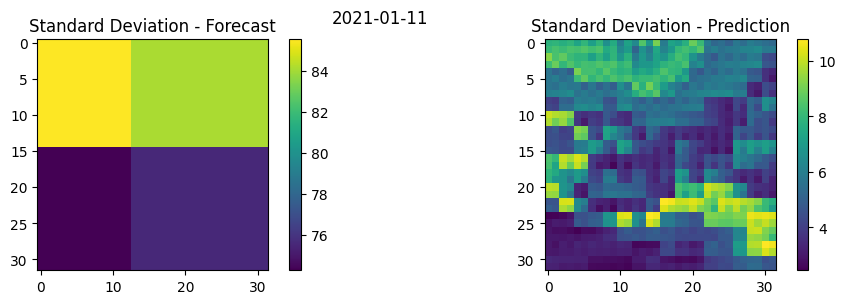

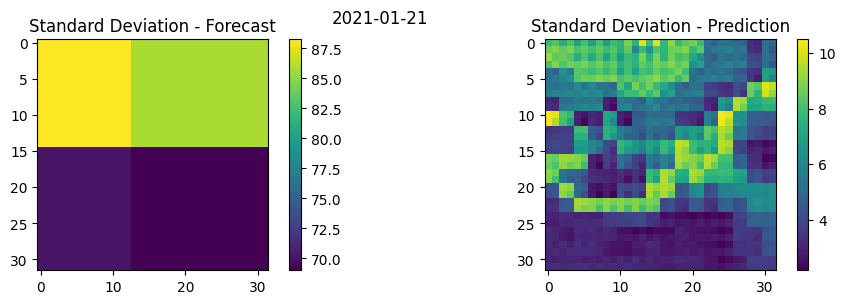

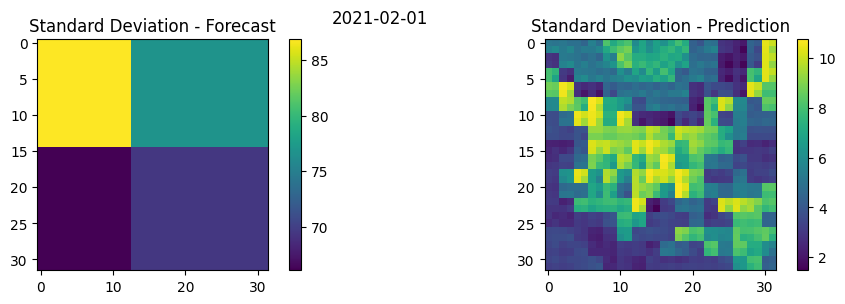

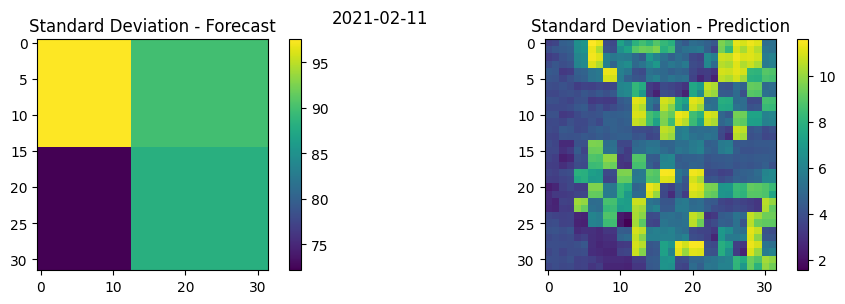

KeyboardInterrupt: 

In [14]:
import xarray as xr
import matplotlib.pyplot as plt

# Assuming your data is stored in the 'pred_xarray' variable

for t in range(pred_xarray.shape[0]):
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))
    
    # Plot the standard deviation for the current time step
    std_deviation = forecast_xarray.isel(time=t).std(dim='ensemble')
    im0 = axs[0].imshow(std_deviation)
    axs[0].set_title(f'Standard Deviation - Forecast')
    cbar0 = plt.colorbar(im0, ax=axs[0])  # Add colorbar for the first subplot
    
    # Plot the original data for the current time step (adjust as needed)
    original_data = pred_xarray.isel(time=t).std(dim='ensemble')
    im1 = axs[1].imshow(original_data)
    axs[1].set_title("Standard Deviation - Prediction")
    cbar1 = plt.colorbar(im1, ax=axs[1])  # Add colorbar for the second subplot
    
    # Set the title of the entire figure
    plt.suptitle(pred_xarray.isel(time=t).time.values.astype('datetime64[D]'))
    
    plt.show()


In [ ]:

for t in range(0, init_cond.shape[0], t_step):
    subarray_forecast = init_cond_normalized[t:t + t_step]
    subarray_downscaled = pred_normalized[t:t + t_step, 0]

    std_image_forecast = torch.std(subarray_forecast, dim=0)
    std_image_downscaled = torch.std(subarray_downscaled, dim=0)
    
    # Calculate the mean of std_image_forecast and std_image_downscaled
    mean_std_forecast = std_image_forecast.mean().item()
    mean_std_downscaled = std_image_downscaled.mean().item()

    # Create subplots with two columns
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))

    # Display std_image_forecast on the first subplot
    axs[0].imshow(std_image_forecast)
    axs[0].set_title('Std. Deviation (Forecast)')
    cbar = plt.colorbar(axs[0].imshow(std_image_forecast), ax=axs[0])
    axs[0].text(0.5, 0.95, f"Mean: {mean_std_forecast}", transform=axs[0].transAxes, color='white')
    
    # Display std_image_downscaled on the second subplot
    axs[1].imshow(std_image_downscaled)
    axs[1].set_title('Std. Deviation (Downscaled)')
    cbar = plt.colorbar(axs[1].imshow(std_image_downscaled), ax=axs[1])
    axs[1].text(0.5, 0.95, f"Mean: {mean_std_downscaled}", transform=axs[1].transAxes, color='white')

    plt.tight_layout()
    plt.show()
